In [10]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import time
from collections import deque

# Load and prepare data

In [11]:
# Mesh size
nl = 10
nc = 10
print('Grid: ', nl, 'x',nc)

Grid:  10 x 10


In [12]:
import joblib
#...
pca_compress = joblib.load("pca_compress_15.pkl") 
X_train_compressed = np.loadtxt('X_train_pca.csv', delimiter=',') 

# Train data
#X_train_1D = np.loadtxt('X_train_1D.csv', delimiter=',') 
#R0s  = np.loadtxt('R0s.csv', delimiter=',') 
#nrun = int(X_train_1D.shape[0]/len(times))
times  = np.loadtxt('times.csv', delimiter=',') 
with open('groups.txt') as f:
    groups = [g.strip() for g in f.readlines()]

# PCA recovered
X_recovered = pca_compress.inverse_transform(X_train_compressed)

# Test data
X_test_compressed = np.loadtxt('X_test_pca.csv', delimiter=',') 
X_test_1D = np.loadtxt('X_test_1D.csv', delimiter=',') 
X_test_recovered = pca_compress.inverse_transform(X_test_compressed)
R0s_test  = np.loadtxt('R0s_test.csv', delimiter=',') 

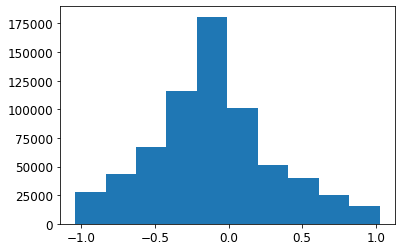

(38520, 10, 17)


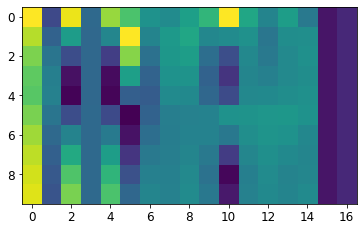

In [13]:
## Prepare data

pca_size = X_test_compressed.shape[1]

X_test_R0s = R0s_test.repeat(len(times), axis=0)

X_test_compressedplus = np.concatenate((X_test_compressed, X_test_R0s), axis=1) 
codings_size = X_test_compressedplus.shape[1]

scaler = joblib.load("scaler.pkl")
X_test_scaled = scaler.transform(X_test_compressedplus)
np.allclose(X_test_compressedplus, scaler.inverse_transform(X_test_scaled))

plt.hist(X_test_scaled.flatten())
plt.show()

def concat_timesteps(X_train, ntimes, step, times):
    X_train_concat = []
    for j in range(len(X_train)//len(times)):
        for i in range(j*len(times), j*len(times)+(len(times)-ntimes*step)):
            X_train_concat.append(X_train[i:i+ntimes*step:step])
    return np.array(X_train_concat)

ntimes = 10 # Consecutive times for the GAN
step = 2 # step between times

X_test_concat = concat_timesteps(X_test_scaled, ntimes, step, times)
X_test_concat_flatten = X_test_concat.reshape(X_test_concat.shape[0], codings_size*ntimes )

print(X_test_concat.shape)
plt.imshow(X_test_concat[0, :, :])
plt.show()

# Load model

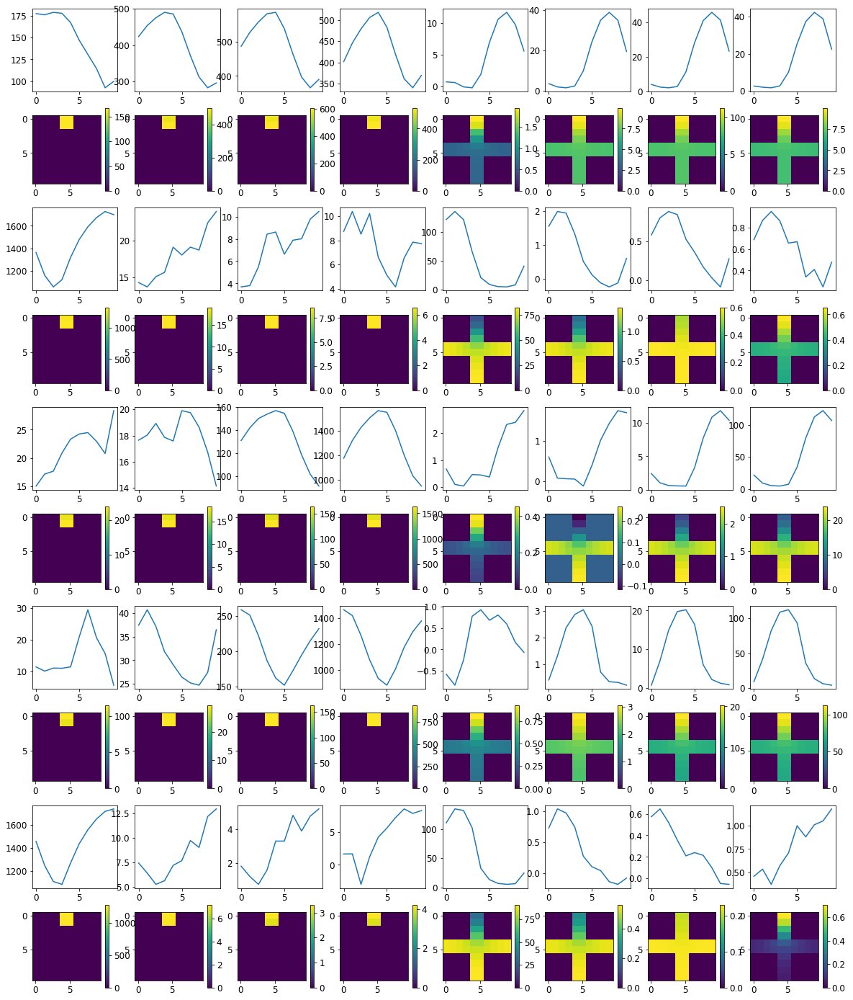

In [14]:
from tensorflow.keras.models import load_model
generator, discriminator = load_model('gan-tfex-DCGAN-5kernel.h5').layers

np.random.seed(0)
tf.random.set_seed(0)

npredict = 5
latent_size = 100
noise = tf.random.normal(shape=[npredict, latent_size])
X_generated = scaler.inverse_transform(generator.predict(noise).reshape(npredict*ntimes,codings_size))
R0_generated = X_generated[:,pca_size:]
X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
X_generated = X_generated.reshape(npredict, ntimes, len(groups)*nl*nc)
fig, ax = plt.subplots(npredict*2,len(groups), figsize=[20,npredict*5])
for j in range(npredict):
    for i, group in enumerate(groups):
        for k in range(0,10,10): 
            ax.flatten()[i+2*j*len(groups)].plot(X_generated[j][:,i*nl*nc+4+10*k], '-')
    for i, group in enumerate(groups):
        im = ax.flatten()[i+(2*j+1)*len(groups)].imshow(X_generated[j].reshape(ntimes,len(groups),nl,nc)[4,i,:,:])
        fig.colorbar(im, ax=ax.flatten()[i+(2*j+1)*len(groups)])

# Assimilate data with the GAN

In [15]:
# PCA and scaler variables for obs_sse_loss 
data_range_ = tf.constant(scaler.data_range_, dtype=tf.float32)
data_min_ = tf.constant(scaler.data_min_, dtype=tf.float32)
components_ = tf.constant(pca_compress.components_, dtype=tf.float32)
pca_mean_ = tf.constant(pca_compress.mean_, dtype=tf.float32)

# Set optimization tolerances
tol = 1e-6 # relative loss function difference 
tol_cv = 1e-4 # relative latent vector norm difference

def pod_sse_loss(real_coding, gen_output):
    # -- POD coefficients --
    #
    # apply weights
    inp = tf.reshape(real_coding, [-1, codings_size])[:,:pca_size]
    out = tf.reshape(gen_output, [-1, codings_size])[:,:pca_size]
    
    pod_loss = tf.reduce_sum(tf.math.squared_difference(inp, out)*weight_pod)
    return pod_loss

def r0_sse_loss(real_coding, gen_output):
    # -- R0s --
    #
    # apply weights
    inp = tf.reshape(real_coding, [-1, codings_size])[:,pca_size:]
    out = tf.reshape(gen_output, [-1, codings_size])[:,pca_size:]
    
    r0_loss = tf.reduce_sum(tf.math.squared_difference(inp, out)*weight_R0)
    return r0_loss

def obs_sse_loss(gen_output, obs_data, obs_points_inrange): 
    # -- Observed data --
    # 
    if obs_data.shape[0]>0:
        # scaler.inverse_transform
        gen_output_scaled = ((tf.reshape(gen_output, [-1, codings_size])+1)/2)*data_range_ + data_min_  
        # pca_compress.inverse_transform
        X_generated = tf.reshape(gen_output_scaled[:,:pca_size]@components_+pca_mean_, (len(gen_output_scaled), len(groups), nl, nc))
        # get the data points
        sim_data = tf.gather_nd(X_generated, obs_points_inrange)
        
        obs_loss = tf.reduce_sum(tf.math.squared_difference(obs_data, sim_data))*weight_obs/tf.size(obs_data, out_type=tf.float32) 
    else:
        obs_loss = 0
        
    return obs_loss

def optimize_coding_forward_noObs(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000):
    
    optimizer = tf.keras.optimizers.Adam(1e-2)
    
    @tf.function
    def opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange):
        with tf.GradientTape() as tape:
            tape.watch(latent_values)
            gen_output = generator(latent_values, training=False) 

            pod_loss = pod_sse_loss(real_coding, gen_output[:,:(ntimes - 1),:,:])   
            r0_loss = r0_sse_loss(real_coding, gen_output[:,:(ntimes - 1),:,:])   
            obs_loss = obs_sse_loss(gen_output[:,:(ntimes - 1),:,:], obs_data, obs_points_inrange)
            loss = pod_loss + r0_loss 

        gradient = tape.gradient(loss, latent_values)  
        optimizer.apply_gradients(zip([gradient], [latent_values]))  

        return loss, pod_loss, r0_loss, obs_loss  
    
    loss = []
    loss.append(opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
    latent_values_old = latent_values.numpy()
        
    for epoch in range(epochs):
        loss.append(opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
        
        err = abs(loss[-1][0]-loss[-2][0])/loss[-2][0]
        err_cv = np.linalg.norm(latent_values.numpy() - latent_values_old)/np.linalg.norm(latent_values_old)
        if err < tol and err_cv < tol_cv:
            break
        latent_values_old = latent_values.numpy()          
        
    return latent_values, loss[-1]  #returns the optimized input that generates the desired output

def optimize_coding_forward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000):
    
    optimizer = tf.keras.optimizers.Adam(1e-2)
    
    @tf.function
    def opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange):
        with tf.GradientTape() as tape:
            tape.watch(latent_values)
            gen_output = generator(latent_values, training=False) 

            pod_loss = pod_sse_loss(real_coding, gen_output[:,:(ntimes - 1),:,:])   
            r0_loss = r0_sse_loss(real_coding, gen_output[:,:(ntimes - 1),:,:])   
            obs_loss = obs_sse_loss(gen_output[:,:(ntimes - 1),:,:], obs_data, obs_points_inrange)
            loss = pod_loss + r0_loss + obs_loss 

        gradient = tape.gradient(loss, latent_values)  
        optimizer.apply_gradients(zip([gradient], [latent_values]))  

        return loss, pod_loss, r0_loss, obs_loss
    
    loss = []
    loss.append(opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
    latent_values_old = latent_values.numpy()
        
    for epoch in range(epochs):
        loss.append(opt_step_forward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
        
        err = abs(loss[-1][0]-loss[-2][0])/loss[-2][0]
        err_cv = np.linalg.norm(latent_values.numpy() - latent_values_old)/np.linalg.norm(latent_values_old)
        if err < tol and err_cv < tol_cv:
            break
        latent_values_old = latent_values.numpy()          
       
    return latent_values, loss[-1]  #returns the optimized input that generates the desired output

def optimize_coding_backward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000):
    
    optimizer = tf.keras.optimizers.Adam(1e-2)
    
    @tf.function
    def opt_step_backward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange):
        with tf.GradientTape() as tape:
            tape.watch(latent_values)
            gen_output = generator(latent_values, training=False) 

            pod_loss = pod_sse_loss(real_coding, gen_output[:,1:,:,:])   
            r0_loss = r0_sse_loss(real_coding, gen_output[:,1:,:,:])   
            obs_loss = obs_sse_loss(gen_output[:,1:,:,:], obs_data, obs_points_inrange)
            loss = pod_loss + r0_loss + obs_loss 

        gradient = tape.gradient(loss, latent_values)  
        optimizer.apply_gradients(zip([gradient], [latent_values]))  

        return loss, pod_loss, r0_loss, obs_loss 
    
    loss = []
    loss.append(opt_step_backward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
    latent_values_old = latent_values.numpy()
        
    for epoch in range(epochs):
        loss.append(opt_step_backward(optimizer, latent_values, real_coding, obs_data, obs_points_inrange))
        
        err = abs(loss[-1][0]-loss[-2][0])/loss[-2][0]
        err_cv = np.linalg.norm(latent_values.numpy() - latent_values_old)/np.linalg.norm(latent_values_old)
        if err < tol and err_cv < tol_cv:
            break
        latent_values_old = latent_values.numpy()          
        
    return latent_values, loss[-1]  #returns the optimized input that generates the desired output

def process_obs_data(march_range, X_obs, obs_points):
    # Process the observed data to be in the range of the forward/backward march
    
    X_obs_inrange = X_obs[march_range]
    obs_points_inrange = np.array([x-np.array([march_range[0], 0, 0, 0]) for x in obs_points if x[0] in march_range])
    if obs_points_inrange.size>0:
        obs_data = tf.gather_nd(X_obs_inrange, obs_points_inrange)
    else:
        obs_data = []

    obs_points_inrange = tf.constant(obs_points_inrange)
    obs_points_inrange = tf.cast(obs_points_inrange, dtype=tf.int32)
    obs_data = tf.constant(obs_data)
    obs_data = tf.cast(obs_data, dtype=tf.float32)
    
    return obs_data, obs_points_inrange

def plot_data(X_predict, nx, ny, obs_times=[], X_obs=[], grid_points=[], R0s_obs=[], R0_ax='', X_ax='', label='', mark='-'):
    X_generated = scaler.inverse_transform(X_predict)
    R0_generated = X_generated[:,pca_size:]
    X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
    X_generated = X_generated.reshape(len(X_predict), len(groups), nl, nc)
    X_generated[X_generated<0] = 0 
    
    # Plot R
    xp = len(R0_generated)
    if R0_ax: 
        R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), R0_generated[:,0], 'b'+mark, label='Home '+label)
        R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), R0_generated[:,1], 'r'+mark, label='Mobile '+label)
        if len(R0s_obs):
            R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), [R0s_obs[0]]*xp, 'bo', markevery=1, fillstyle='none', markersize = 10, label='Home truth')
            R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), [R0s_obs[1]]*xp, 'ro', markevery=1, fillstyle='none', markersize = 10, label='Mobile truth')    
        if len(label):
        #    R0_ax.legend()
            R0_ax.set_xlabel('Time (days)')
            R0_ax.set_ylabel('Reproduction number')
        plt.tight_layout()
        #plt.grid()
        #plt.show()

    
    # Plot groups 
    if len(X_ax): 
        for i, group in enumerate(groups):
            X_ax.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_generated[:,i, nx, ny], mark, label=label)
            if len(X_obs):
                if [i, nx, ny] in grid_points:
                    X_ax.flatten()[i].plot(np.array(obs_times)*8000/86400, X_obs[:, i, nx, ny], 'o', markevery=1, fillstyle='none', markersize = 8, label='Observed data')
                else:
                    X_ax.flatten()[i].plot([],[])
            X_ax.flatten()[i].set_title(group)
            if len(label):
            #    X_ax.flatten()[i].legend()
                X_ax.flatten()[i].set_xlabel('Time (days)')
                X_ax.flatten()[i].set_ylabel('Number of People')
        plt.tight_layout()
        #plt.grid()
        #plt.show()

## Test case 1

### Generate data

In [16]:
run = 2
lag = 400
nobs = len(times)*run + lag
length = 10 # length + (ntimes-1) -> len of X_obs

# Get the observed data
X_obs = X_test_1D[nobs:nobs+((ntimes-1)+length)*step:step,:].reshape(-1,len(groups),nl,nc)
R0s_obs = R0s_test[run]
R0s_obs_scaled = X_test_scaled[nobs][-2:]

# Add noise
np.random.seed(0)
noise = 0.05
X_obs = X_obs + np.random.standard_normal(X_obs.shape)*noise*X_obs

# Print values
print('X_obs.shape', X_obs.shape)
print('R0s_obs', R0s_obs)
print('R0s_obs_scaled', R0s_obs_scaled)

# Times of X_obs to be considered for data assimilation
obs_times = list(range(0,len(X_obs[:])))

# grid points: used to populate the obs_points
#[[group, line, column], 
# [group, line, column], 
# ...                 ]
grid_points = [
               [0,0,4],[1,0,4],[2,0,4],[3,0,4],[4,0,4],[5,0,4],[6,0,4],[7,0,4],
               [0,9,4],[1,9,4],[2,9,4],[3,9,4],[4,9,4],[5,9,4],[6,9,4],[7,9,4],
               [0,4,4],[1,4,4],[2,4,4],[3,4,4],[4,4,4],[5,4,4],[6,4,4],[7,4,4],
               [0,4,0],[1,4,0],[2,4,0],[3,4,0],[4,4,0],[5,4,0],[6,4,0],[7,4,0],
               [0,4,9],[1,4,9],[2,4,9],[3,4,9],[4,4,9],[5,4,9],[6,4,9],[7,4,9],
              ]
# obs_points:
#[[time, group, line, column], 
# [time, group, line, column], 
# ...                       ]
obs_points = []
for p in grid_points:
    for t in obs_times:
        obs_points.append([t]+p)
obs_points = np.array(obs_points)
print('obs_points: \n', obs_points)

X_obs.shape (19, 8, 10, 10)
R0s_obs [ 7.72820859 17.37615382]
R0s_obs_scaled [-0.24019399  0.75509446]
obs_points: 
 [[ 0  0  0  4]
 [ 1  0  0  4]
 [ 2  0  0  4]
 ...
 [16  7  4  9]
 [17  7  4  9]
 [18  7  4  9]]


In [17]:
# Initial condition
run = 26
lag = 400
n = len(times)*run - ntimes*step*run + lag
nplot = n + run*ntimes*step 
forward_steps = length
time_steps = forward_steps + (ntimes-1)

# Calculate the weights
# Delta variables 
delta_obs = 1200
delta_pod = 2
delta_r0 = 2

# POD coeficients
weight_pod = pca_compress.singular_values_/pca_compress.singular_values_.sum()
weight_pod = tf.constant(weight_pod, dtype=tf.float32)
print('weight_pod: ', weight_pod, end='\n\n')

# R0s
weight_R0_p = 0.01*((delta_pod/delta_r0)**2)/2
weight_R0_p = tf.constant([weight_R0_p]*2, dtype=tf.float32)
print('weight_R0_p: ', weight_R0_p, end='\n\n')
weight_R0_da = 0.0001*((delta_pod/delta_r0)**2)/2
weight_R0_da = tf.constant([weight_R0_da]*2, dtype=tf.float32)
print('weight_R0_da: ', weight_R0_da, end='\n\n')
weight_R0 = tf.Variable(weight_R0_p, dtype=tf.float32)

# Observed data
weight_obs = 10.0*((delta_pod/delta_obs)**2)*ntimes
weight_obs = tf.constant(weight_obs, dtype=tf.float32)
print('weight_obs', weight_obs, end='\n\n')

weight_pod:  tf.Tensor(
[5.56196868e-01 2.03024685e-01 8.77208859e-02 4.96064164e-02
 4.05909568e-02 1.79590061e-02 1.43773295e-02 1.33153498e-02
 4.74109687e-03 3.75490240e-03 3.47938458e-03 2.55672471e-03
 1.36965106e-03 9.87468055e-04 3.19285289e-04], shape=(15,), dtype=float32)

weight_R0_p:  tf.Tensor([0.005 0.005], shape=(2,), dtype=float32)

weight_R0_da:  tf.Tensor([5.e-05 5.e-05], shape=(2,), dtype=float32)

weight_obs tf.Tensor(0.00027777778, shape=(), dtype=float32)



### Run data assimilation


Iteration 0: forward and backward
-- Forward March --
Initial point losses: 
['3.78e-03', '4.80e-04', '3.30e-03', '4.99e+00']
['4.11e-04', '3.09e-04', '1.02e-04', '4.97e+00']
['3.61e-03', '4.79e-04', '3.13e-03', '4.99e+00']
['3.78e-03', '4.81e-04', '3.30e-03', '4.99e+00']
['3.82e-03', '4.92e-04', '3.33e-03', '4.98e+00']
['3.76e-04', '3.45e-04', '3.13e-05', '4.97e+00']
['3.78e-03', '4.80e-04', '3.30e-03', '4.99e+00']
['4.85e-04', '3.01e-04', '1.84e-04', '4.97e+00']
['3.79e-03', '4.83e-04', '3.31e-03', '4.99e+00']
['3.78e-03', '4.83e-04', '3.29e-03', '4.99e+00']

Loss iteration 0: ['3.76e-04', '3.45e-04', '3.13e-05', '4.97e+00']
Loss iteration 1: ['7.24e-04', '7.00e-04', '2.44e-05', '4.87e+00'] - 4s
Loss iteration 2: ['4.18e-04', '3.90e-04', '2.85e-05', '4.90e+00'] - 4s
Loss iteration 3: ['3.72e-04', '3.56e-04', '1.62e-05', '4.92e+00'] - 1s
Loss iteration 4: ['5.55e-04', '5.32e-04', '2.35e-05', '4.98e+00'] - 4s
Loss iteration 5: ['5.07e-04', '4.73e-04', '3.35e-05', '5.03e+00'] - 3s
Loss

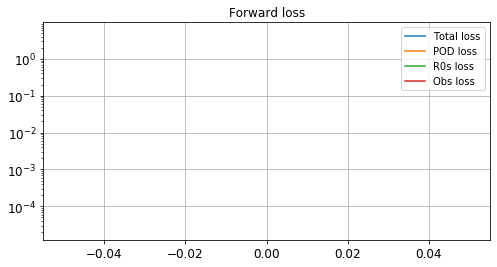

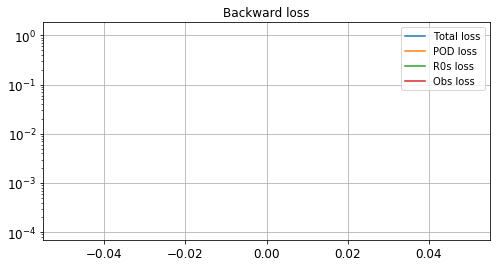

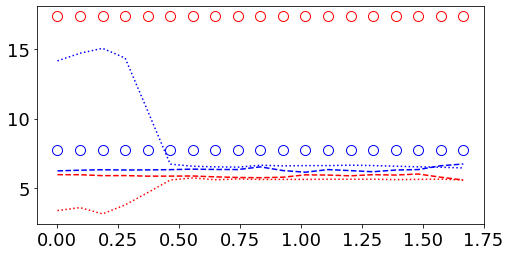

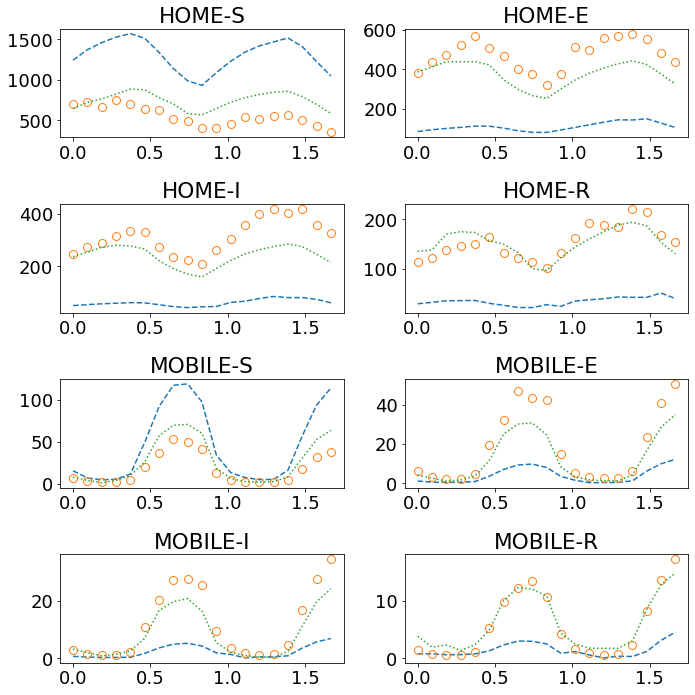

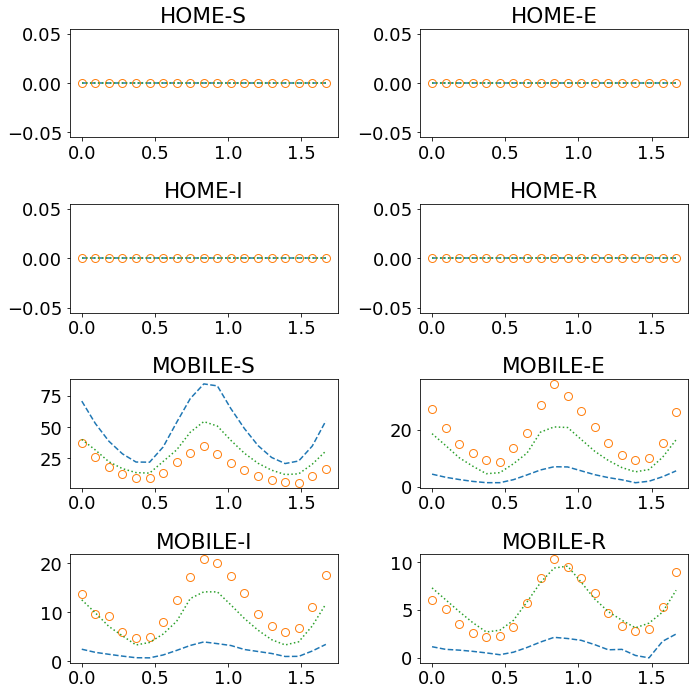

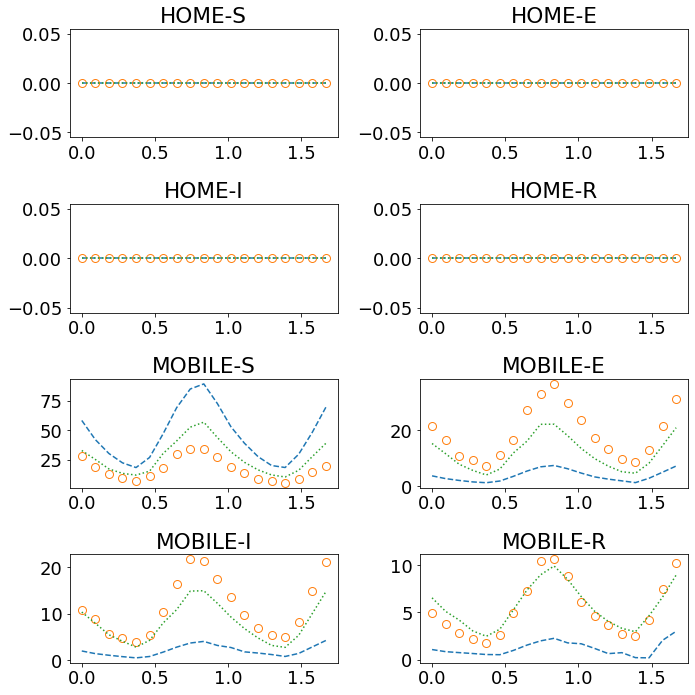

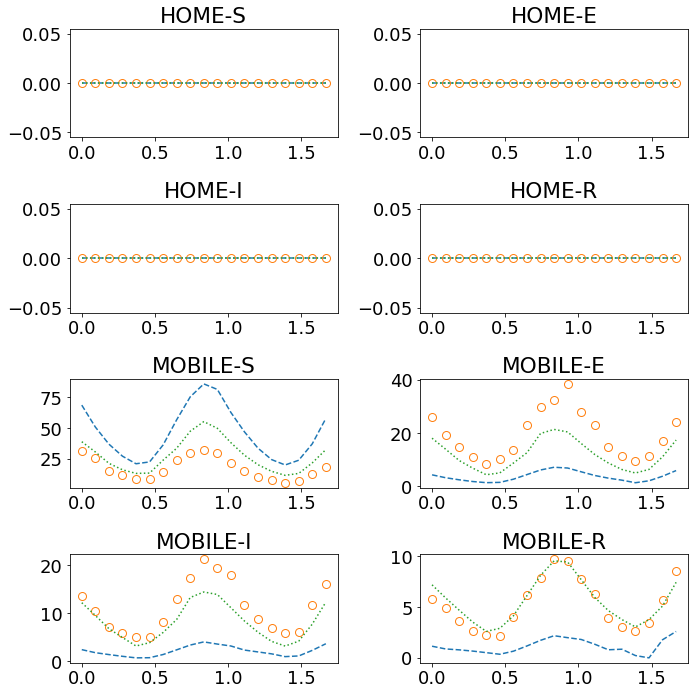

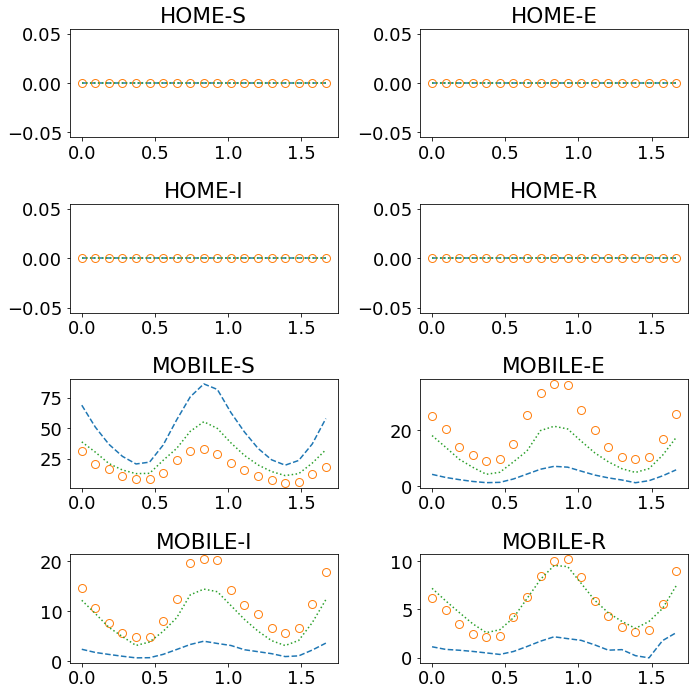


Iteration 1: forward and backward
-- Forward March --
Loss iteration 0: ['8.96e-02', '4.81e-02', '1.81e-04', '4.13e-02']
Loss iteration 1: ['8.57e-02', '5.25e-02', '1.24e-04', '3.31e-02'] - 4s
Loss iteration 2: ['9.27e-02', '5.60e-02', '1.48e-04', '3.65e-02'] - 1s
Loss iteration 3: ['1.04e-01', '6.31e-02', '1.39e-04', '4.11e-02'] - 1s
Loss iteration 4: ['1.01e-01', '6.43e-02', '1.24e-04', '3.64e-02'] - 1s
Loss iteration 5: ['9.76e-02', '6.06e-02', '9.59e-05', '3.69e-02'] - 1s
Loss iteration 6: ['7.54e-02', '4.82e-02', '7.06e-05', '2.72e-02'] - 1s
Loss iteration 7: ['5.54e-02', '3.44e-02', '6.02e-05', '2.09e-02'] - 4s
Loss iteration 8: ['3.92e-02', '2.07e-02', '3.14e-05', '1.84e-02'] - 1s
Loss iteration 9: ['2.41e-02', '9.75e-03', '1.90e-05', '1.43e-02'] - 1s
Loss iteration mean: ['7.65e-02', '4.58e-02', '9.94e-05', '3.06e-02']
-- Backward March --
Loss iteration 0: ['2.42e-02', '1.02e-02', '1.42e-05', '1.40e-02']
Loss iteration 1: ['2.18e-02', '7.13e-03', '1.60e-05', '1.47e-02'] - 4s


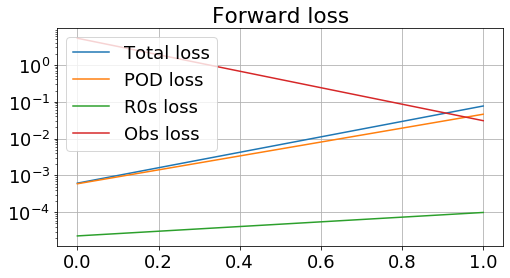

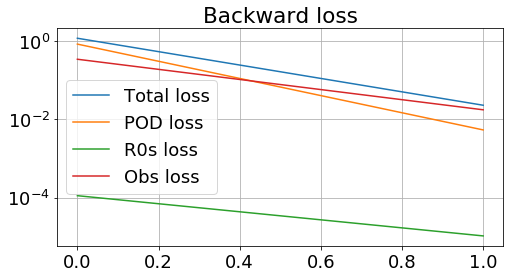

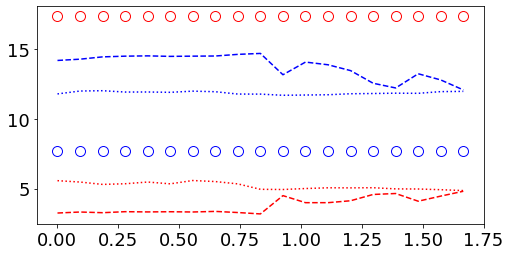

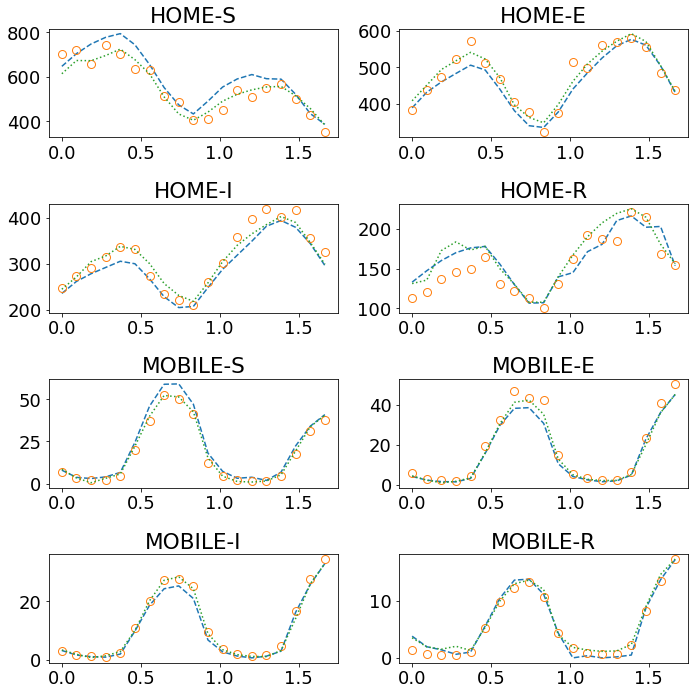

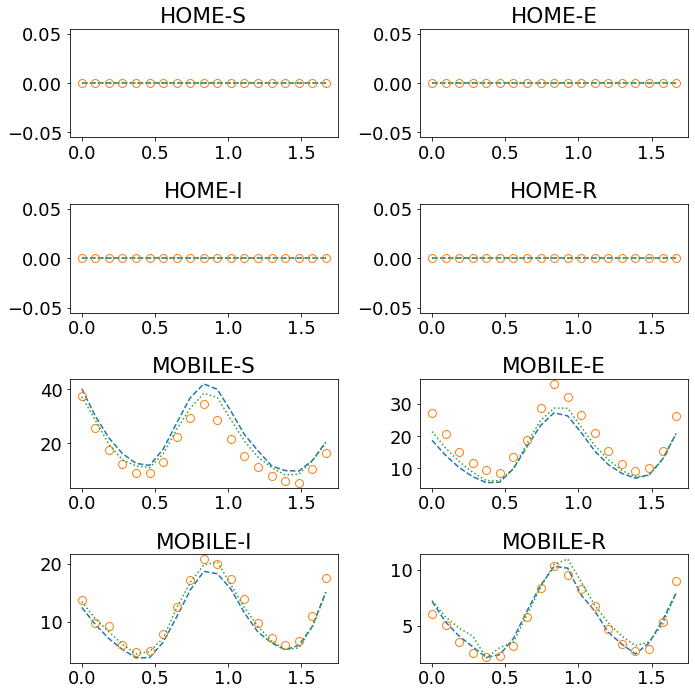

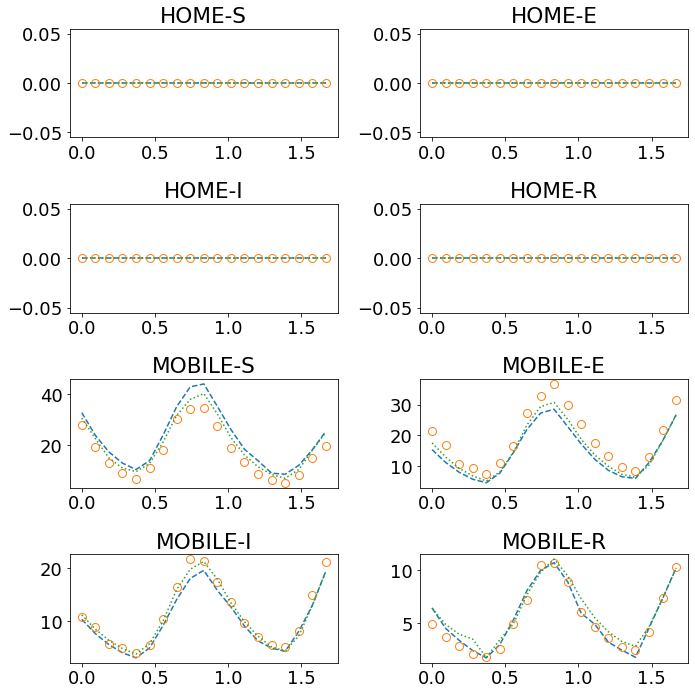

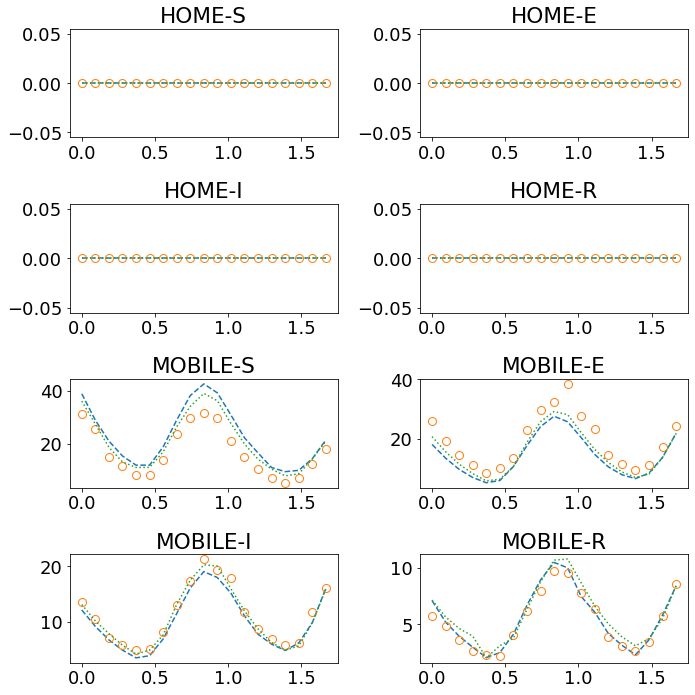

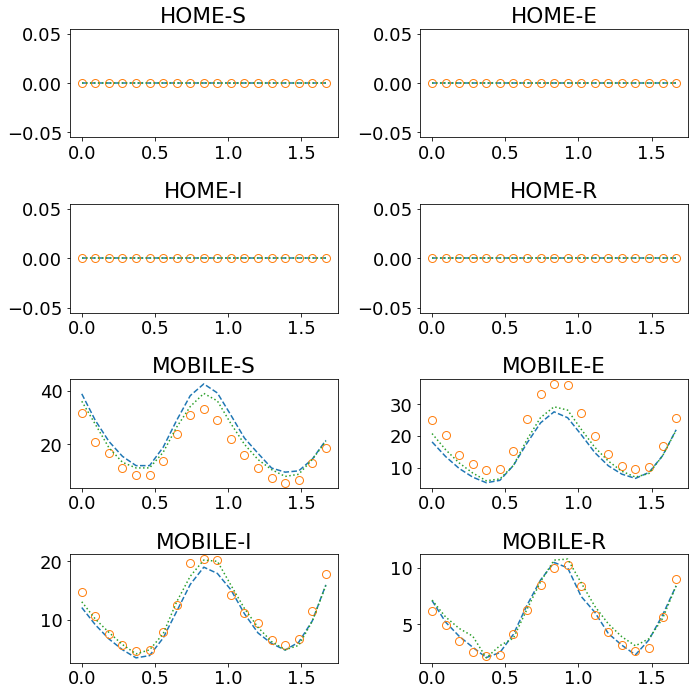


Iteration 2: forward and backward
-- Forward March --
Loss iteration 0: ['2.34e-02', '2.46e-03', '2.25e-07', '2.09e-02']
Loss iteration 1: ['1.60e-02', '1.95e-03', '1.46e-07', '1.41e-02'] - 1s
Loss iteration 2: ['1.68e-02', '1.40e-03', '4.96e-07', '1.54e-02'] - 4s
Loss iteration 3: ['1.95e-02', '1.87e-03', '1.30e-05', '1.76e-02'] - 4s
Loss iteration 4: ['1.74e-02', '1.30e-03', '5.95e-05', '1.60e-02'] - 1s
Loss iteration 5: ['2.25e-02', '2.02e-03', '6.74e-06', '2.05e-02'] - 4s
Loss iteration 6: ['1.70e-02', '1.89e-03', '8.63e-06', '1.52e-02'] - 1s
Loss iteration 7: ['1.54e-02', '2.23e-03', '1.01e-05', '1.31e-02'] - 4s
Loss iteration 8: ['1.49e-02', '1.42e-03', '1.11e-05', '1.35e-02'] - 1s
Loss iteration 9: ['1.31e-02', '2.51e-03', '1.14e-05', '1.06e-02'] - 4s
Loss iteration mean: ['1.76e-02', '1.90e-03', '1.21e-05', '1.57e-02']
-- Backward March --
Loss iteration 0: ['1.32e-02', '2.63e-03', '1.10e-05', '1.06e-02']
Loss iteration 1: ['1.32e-02', '1.43e-03', '2.29e-05', '1.17e-02'] - 1s


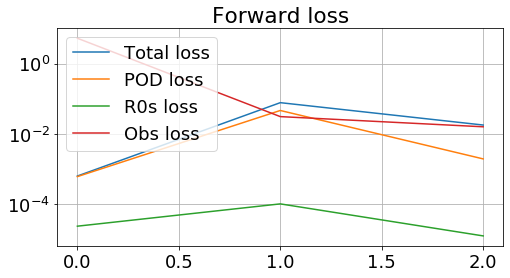

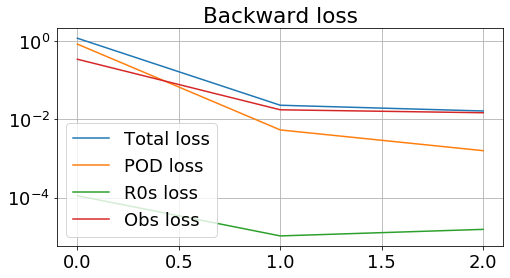

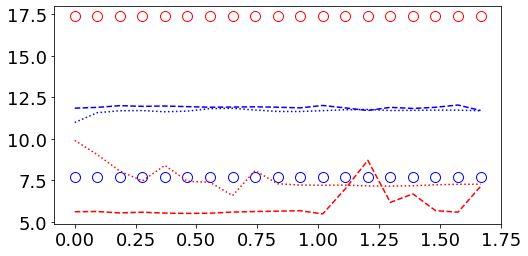

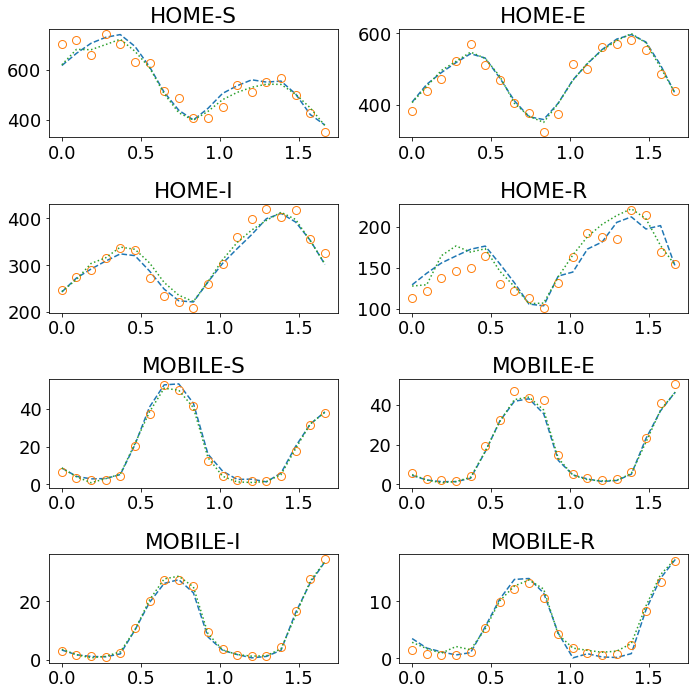

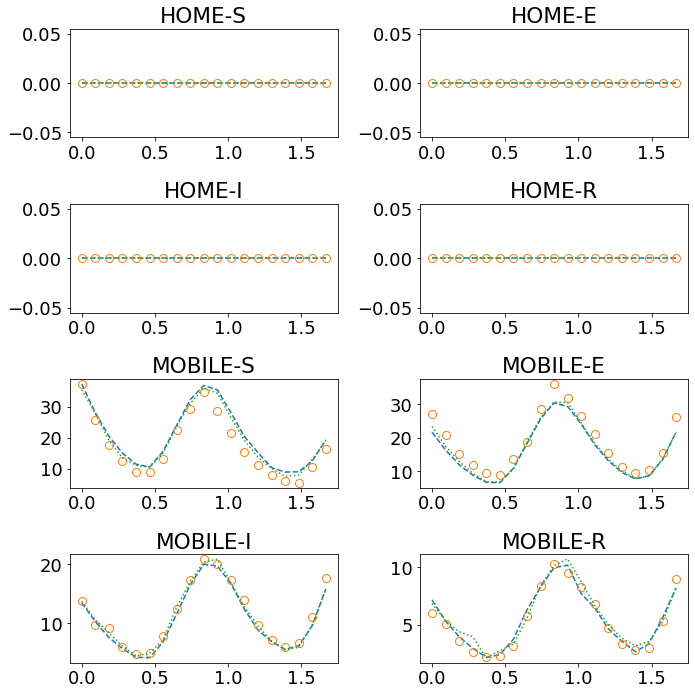

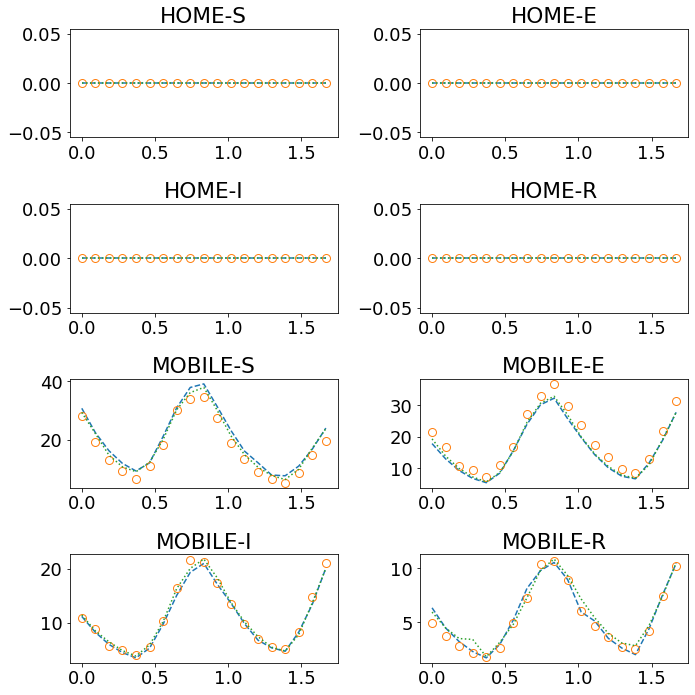

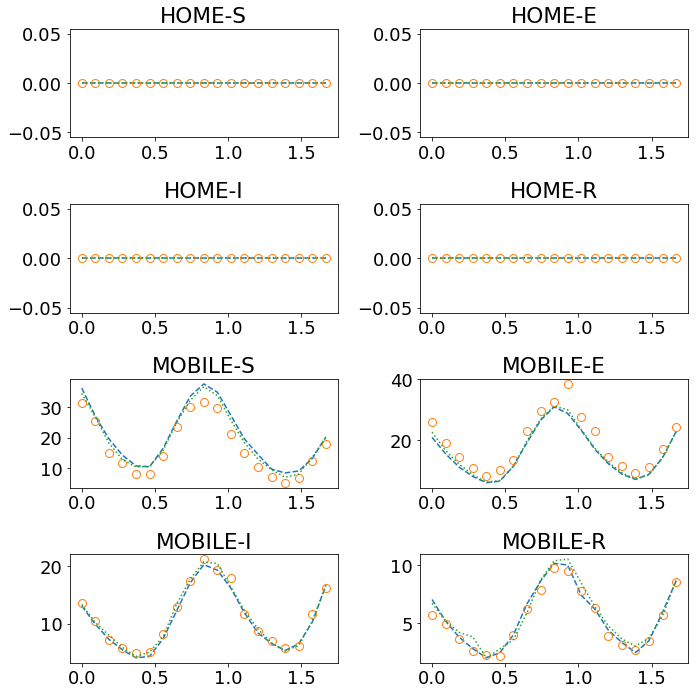

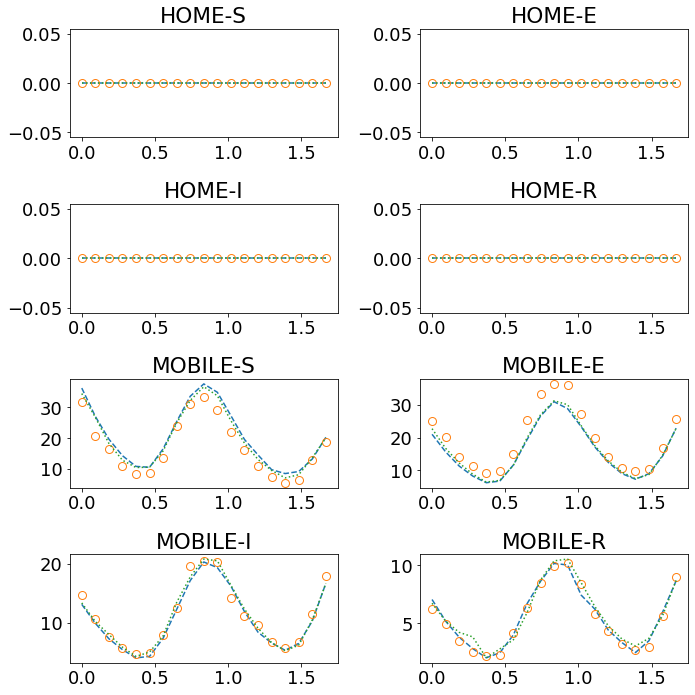


Iteration 3: forward and backward
-- Forward March --
Loss iteration 0: ['2.10e-02', '2.25e-03', '3.54e-05', '1.87e-02']
Loss iteration 1: ['1.47e-02', '1.81e-03', '4.61e-05', '1.29e-02'] - 4s
Loss iteration 2: ['1.53e-02', '1.20e-03', '2.88e-05', '1.41e-02'] - 1s
Loss iteration 3: ['1.74e-02', '1.45e-03', '2.23e-05', '1.59e-02'] - 1s
Loss iteration 4: ['1.60e-02', '9.08e-04', '2.71e-05', '1.50e-02'] - 1s
Loss iteration 5: ['2.09e-02', '1.47e-03', '1.68e-05', '1.94e-02'] - 4s
Loss iteration 6: ['1.52e-02', '1.48e-03', '1.62e-05', '1.37e-02'] - 4s
Loss iteration 7: ['1.43e-02', '2.10e-03', '1.24e-05', '1.22e-02'] - 3s
Loss iteration 8: ['1.37e-02', '1.22e-03', '4.45e-06', '1.25e-02'] - 2s
Loss iteration 9: ['1.20e-02', '2.20e-03', '5.11e-06', '9.76e-03'] - 4s
Loss iteration mean: ['1.60e-02', '1.61e-03', '2.15e-05', '1.44e-02']
-- Backward March --
Loss iteration 0: ['1.22e-02', '2.23e-03', '5.46e-06', '1.00e-02']
Loss iteration 1: ['1.23e-02', '1.22e-03', '8.46e-06', '1.11e-02'] - 2s


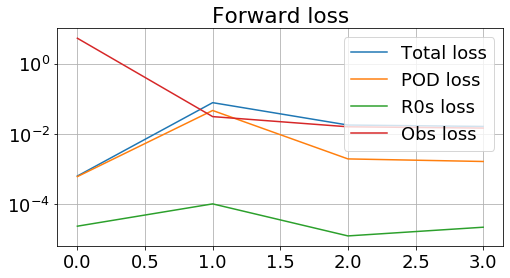

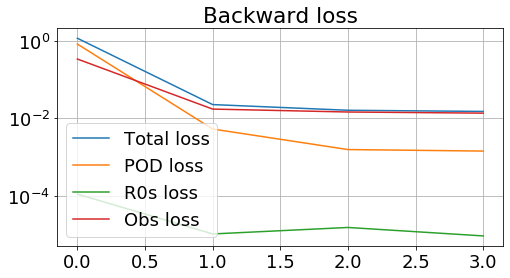

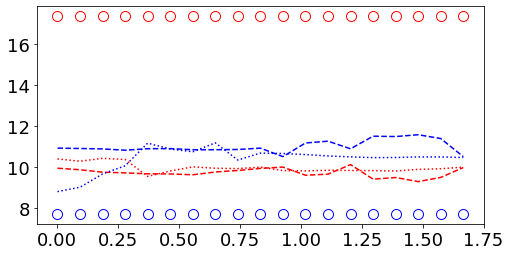

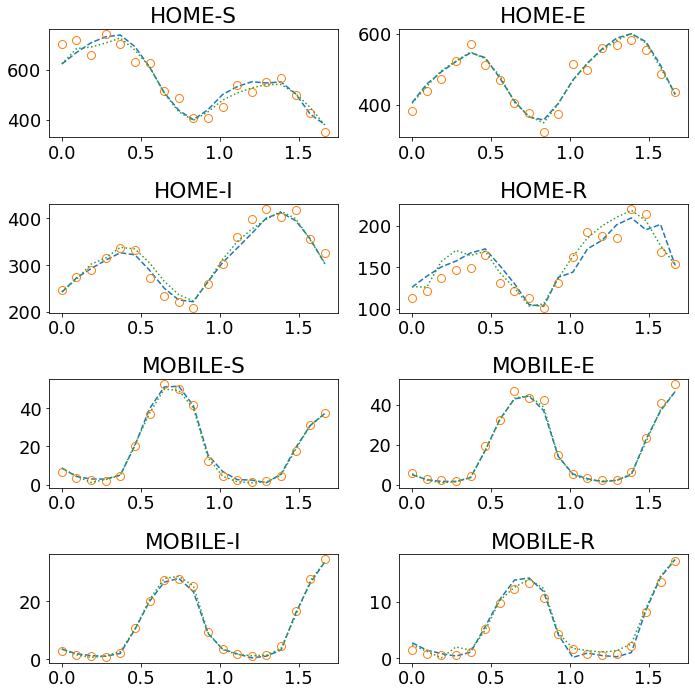

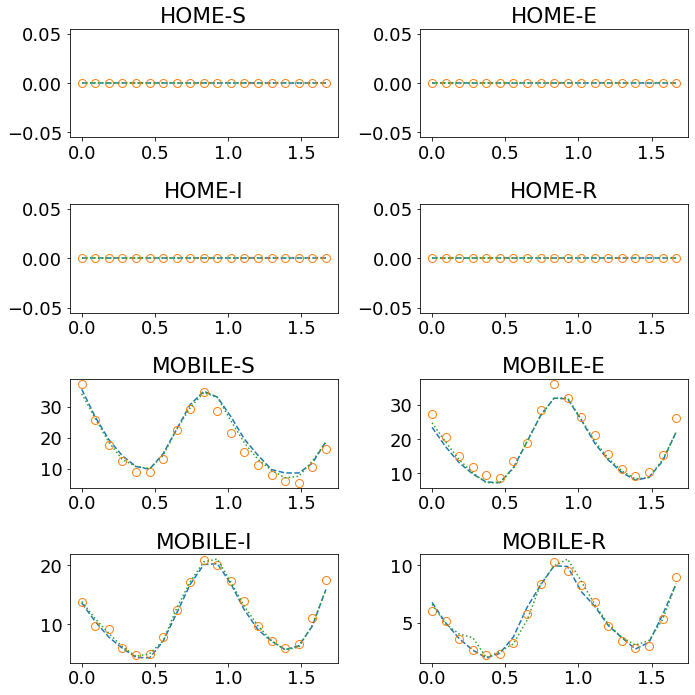

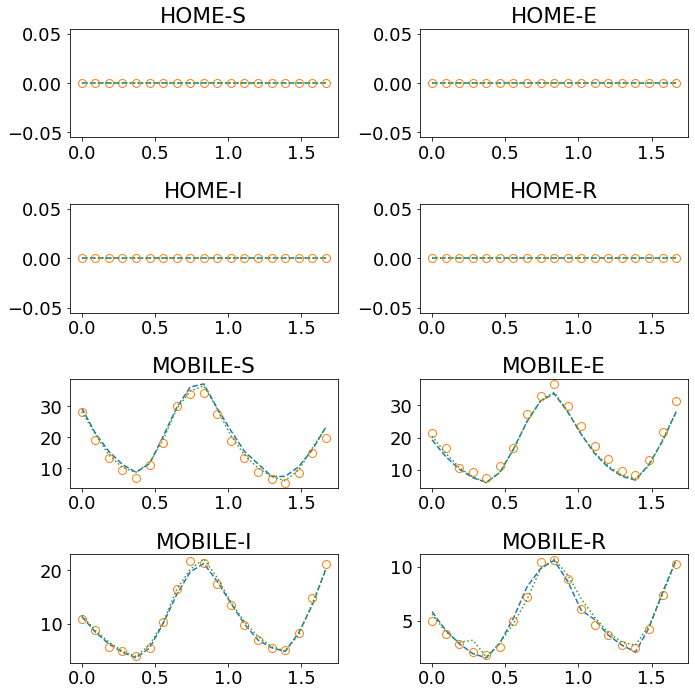

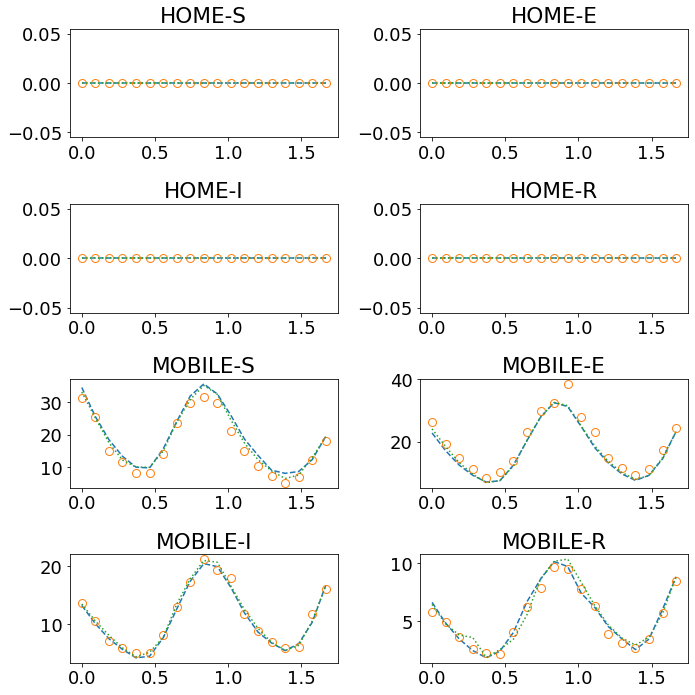

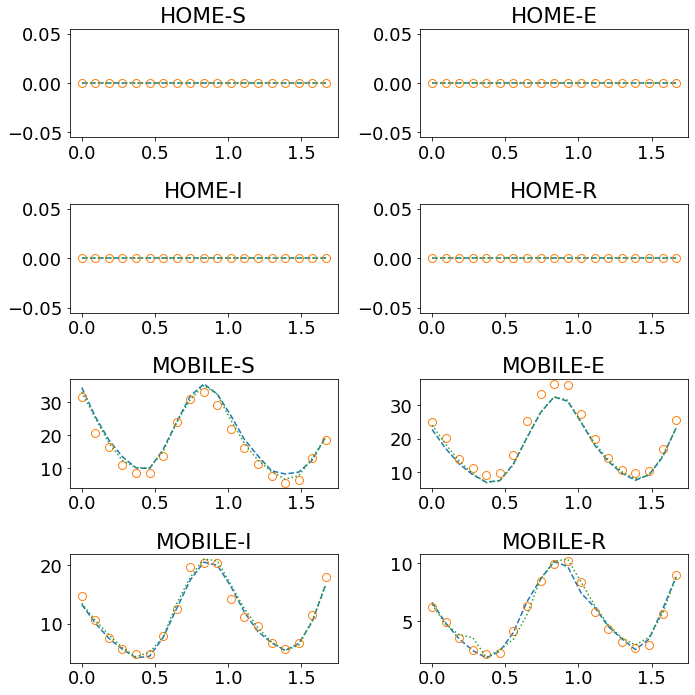


Iteration 4: forward and backward
-- Forward March --
Loss iteration 0: ['1.95e-02', '1.82e-03', '2.71e-05', '1.77e-02']
Loss iteration 1: ['1.39e-02', '1.47e-03', '2.88e-05', '1.24e-02'] - 4s
Loss iteration 2: ['1.44e-02', '9.50e-04', '2.35e-05', '1.35e-02'] - 1s
Loss iteration 3: ['1.57e-02', '1.50e-03', '2.74e-05', '1.42e-02'] - 4s
Loss iteration 4: ['1.56e-02', '9.90e-04', '1.86e-05', '1.46e-02'] - 4s
Loss iteration 5: ['2.03e-02', '1.81e-03', '9.60e-06', '1.85e-02'] - 4s
Loss iteration 6: ['1.47e-02', '1.52e-03', '8.64e-06', '1.32e-02'] - 1s
Loss iteration 7: ['1.44e-02', '2.28e-03', '5.75e-06', '1.21e-02'] - 1s
Loss iteration 8: ['1.32e-02', '1.26e-03', '8.39e-06', '1.19e-02'] - 3s
Loss iteration 9: ['1.15e-02', '2.08e-03', '2.78e-06', '9.41e-03'] - 3s
Loss iteration mean: ['1.53e-02', '1.57e-03', '1.61e-05', '1.37e-02']
-- Backward March --
Loss iteration 0: ['1.19e-02', '2.13e-03', '2.95e-06', '9.75e-03']
Loss iteration 1: ['1.19e-02', '1.33e-03', '1.07e-05', '1.06e-02'] - 2s


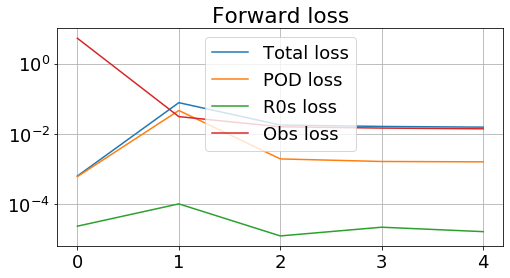

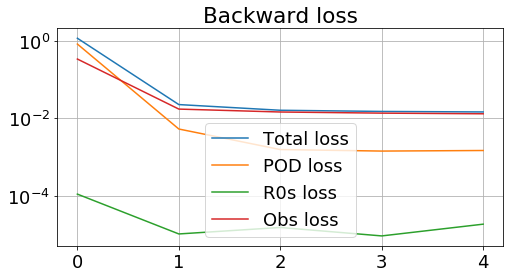

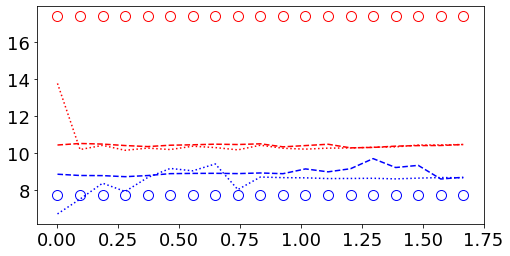

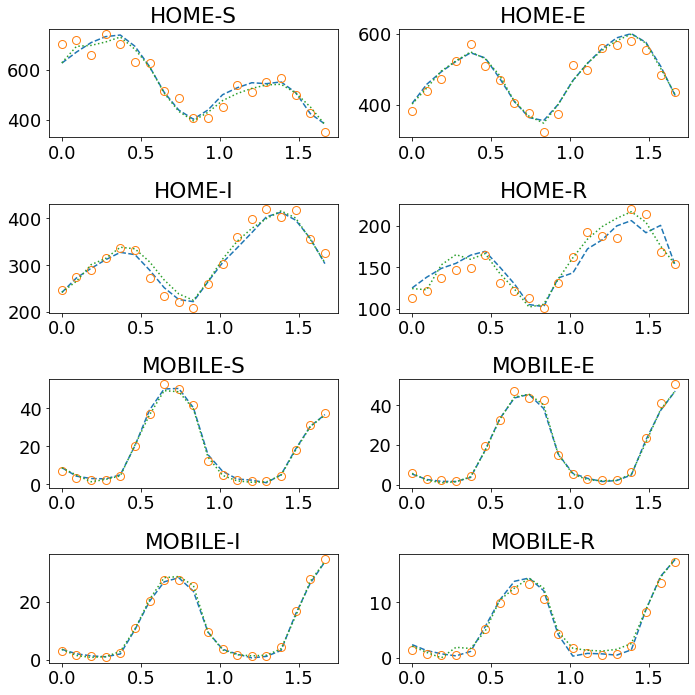

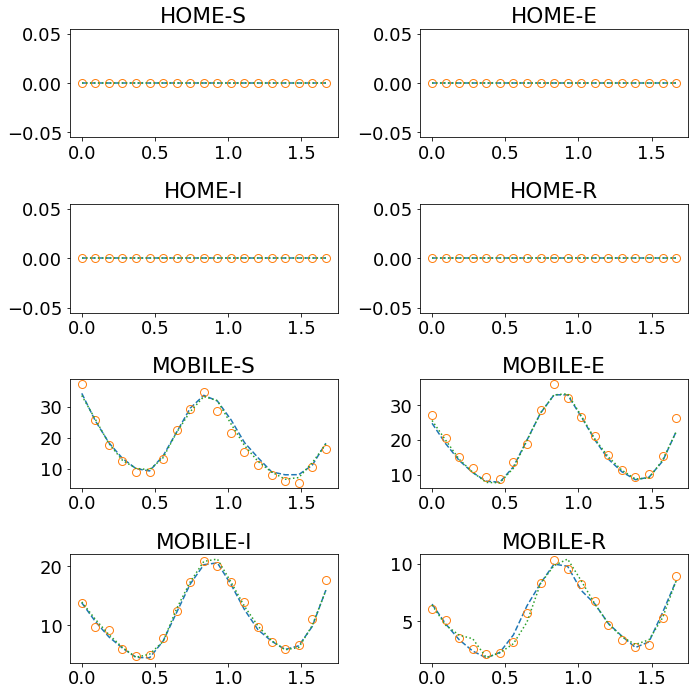

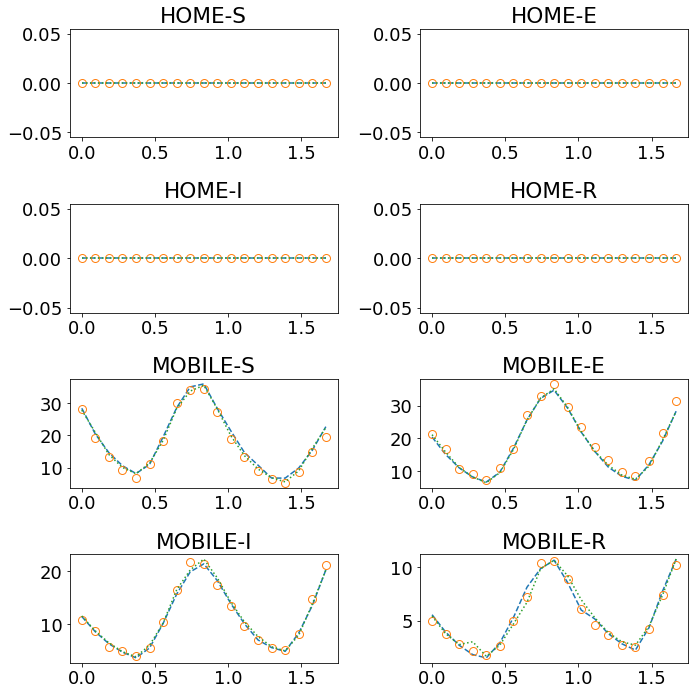

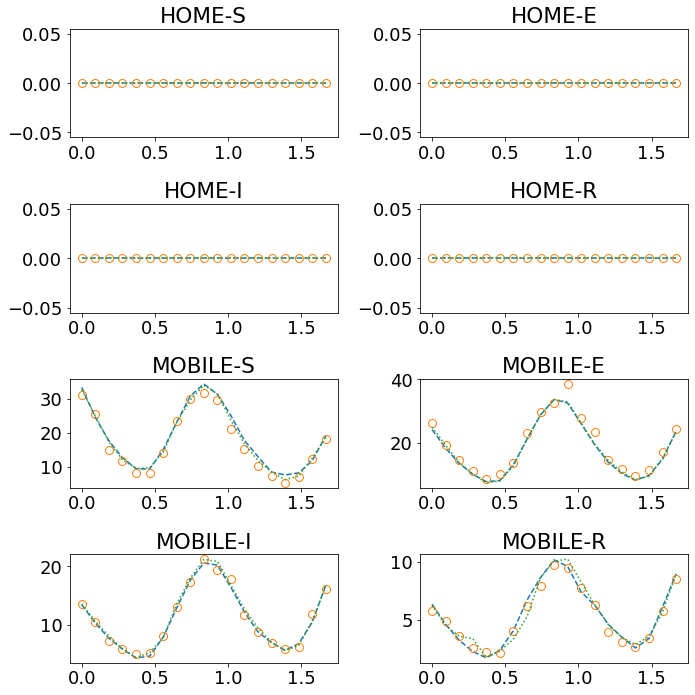

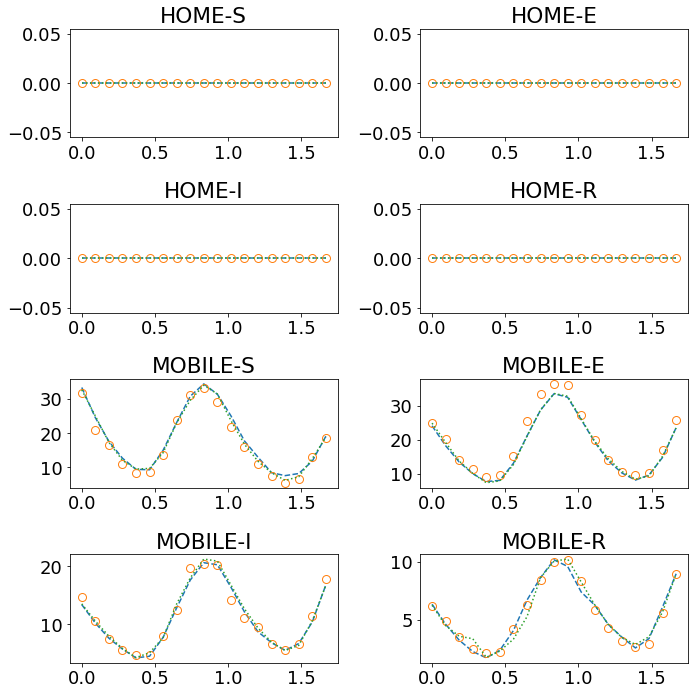


Iteration 5: forward and backward
-- Forward March --
Loss iteration 0: ['1.88e-02', '1.84e-03', '1.00e-04', '1.69e-02']
Loss iteration 1: ['1.38e-02', '1.31e-03', '2.31e-05', '1.25e-02'] - 1s
Loss iteration 2: ['1.41e-02', '8.31e-04', '2.13e-05', '1.32e-02'] - 1s
Loss iteration 3: ['1.49e-02', '1.51e-03', '2.07e-05', '1.34e-02'] - 1s
Loss iteration 4: ['1.54e-02', '9.66e-04', '2.05e-05', '1.44e-02'] - 2s
Loss iteration 5: ['1.96e-02', '1.89e-03', '2.29e-05', '1.76e-02'] - 4s
Loss iteration 6: ['1.40e-02', '1.31e-03', '1.67e-05', '1.27e-02'] - 1s
Loss iteration 7: ['1.41e-02', '2.18e-03', '1.71e-05', '1.19e-02'] - 1s
Loss iteration 8: ['1.30e-02', '1.34e-03', '2.32e-05', '1.16e-02'] - 4s
Loss iteration 9: ['1.13e-02', '1.96e-03', '1.42e-05', '9.34e-03'] - 5s
Loss iteration mean: ['1.49e-02', '1.51e-03', '2.80e-05', '1.34e-02']
-- Backward March --
Loss iteration 0: ['1.16e-02', '1.94e-03', '5.19e-06', '9.68e-03']
Loss iteration 1: ['1.19e-02', '1.32e-03', '2.15e-05', '1.06e-02'] - 4s


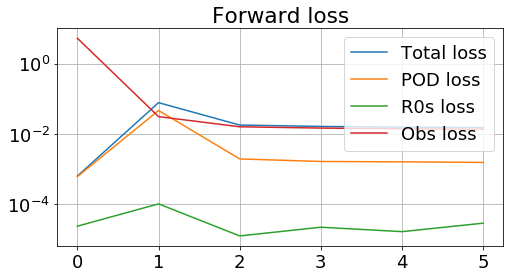

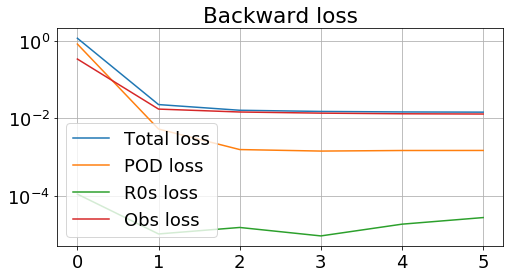

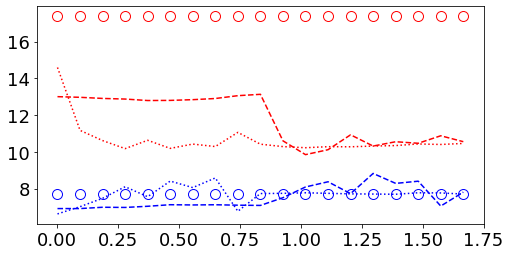

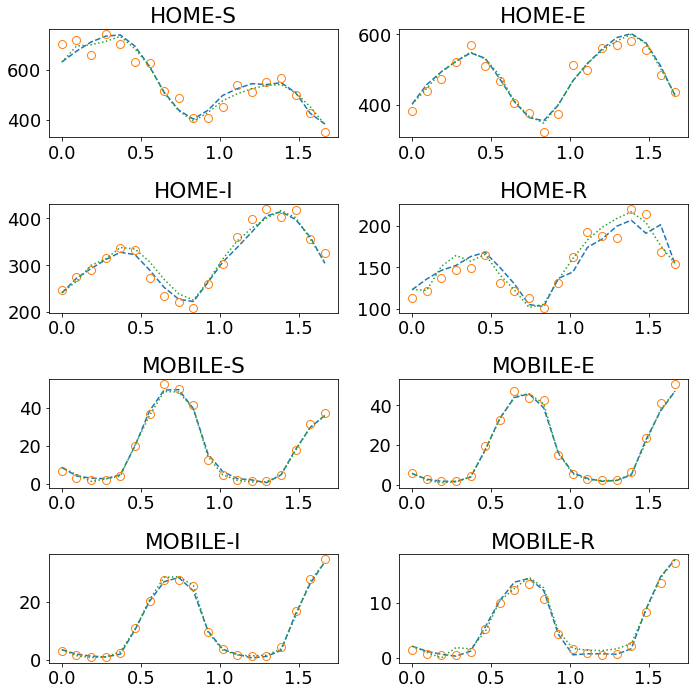

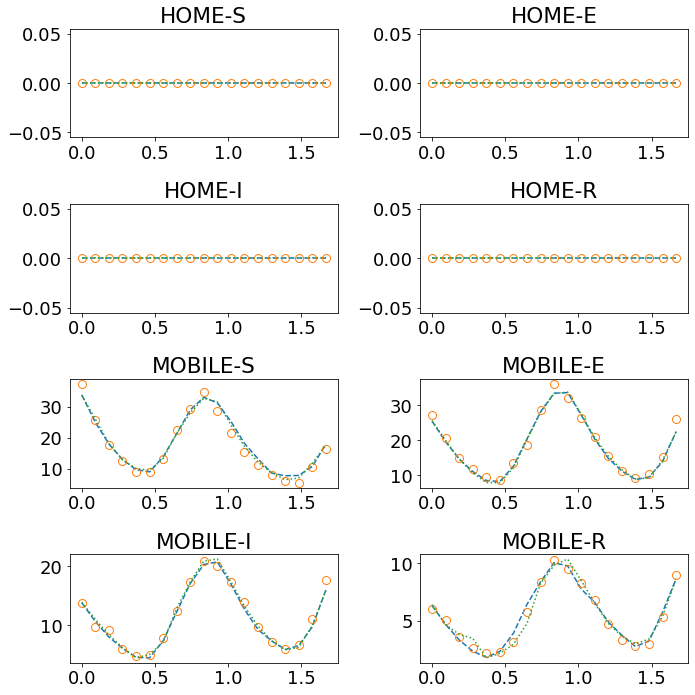

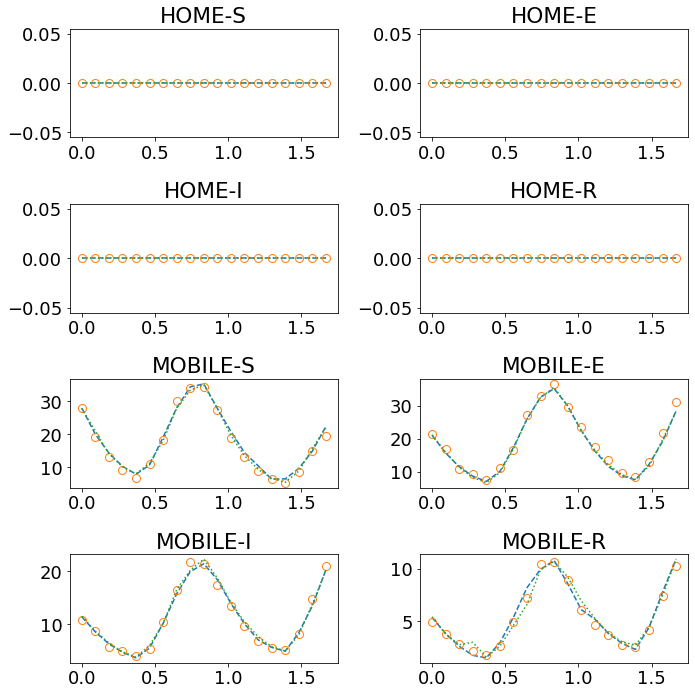

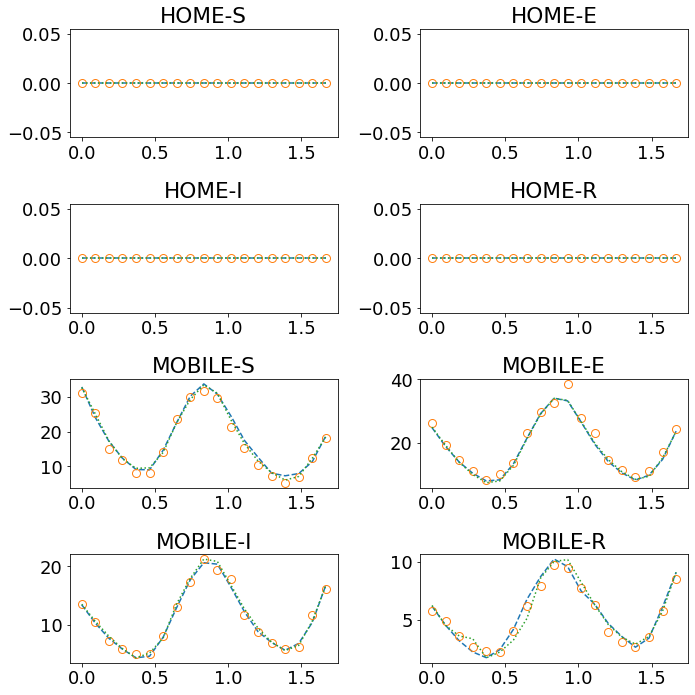

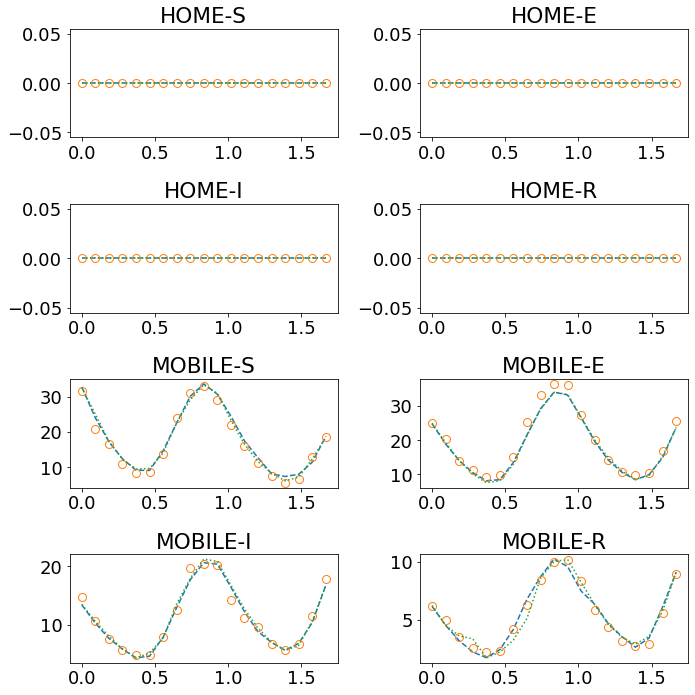


Iteration 6: forward and backward
-- Forward March --
Loss iteration 0: ['1.85e-02', '1.85e-03', '7.01e-05', '1.66e-02']
Loss iteration 1: ['1.39e-02', '1.27e-03', '1.43e-05', '1.26e-02'] - 1s
Loss iteration 2: ['1.40e-02', '8.58e-04', '2.16e-05', '1.31e-02'] - 1s
Loss iteration 3: ['1.46e-02', '1.63e-03', '3.03e-05', '1.29e-02'] - 4s
Loss iteration 4: ['1.55e-02', '1.02e-03', '1.86e-05', '1.44e-02'] - 2s
Loss iteration 5: ['1.91e-02', '2.07e-03', '3.49e-05', '1.70e-02'] - 4s
Loss iteration 6: ['1.33e-02', '1.15e-03', '2.77e-05', '1.22e-02'] - 4s
Loss iteration 7: ['1.37e-02', '2.09e-03', '3.32e-05', '1.16e-02'] - 1s
Loss iteration 8: ['1.30e-02', '1.37e-03', '2.28e-05', '1.16e-02'] - 2s
Loss iteration 9: ['1.13e-02', '1.95e-03', '2.08e-05', '9.37e-03'] - 2s
Loss iteration mean: ['1.47e-02', '1.52e-03', '2.94e-05', '1.31e-02']
-- Backward March --
Loss iteration 0: ['1.14e-02', '1.82e-03', '1.26e-05', '9.53e-03']
Loss iteration 1: ['1.24e-02', '1.38e-03', '2.78e-05', '1.09e-02'] - 4s


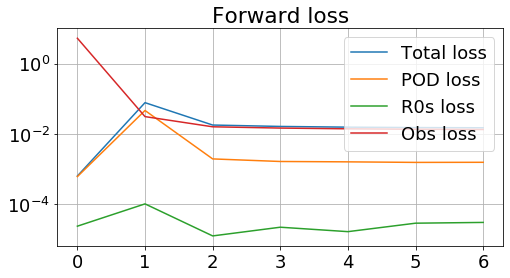

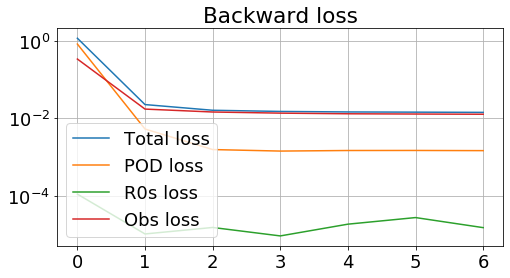

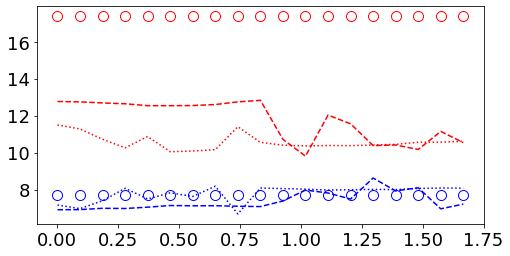

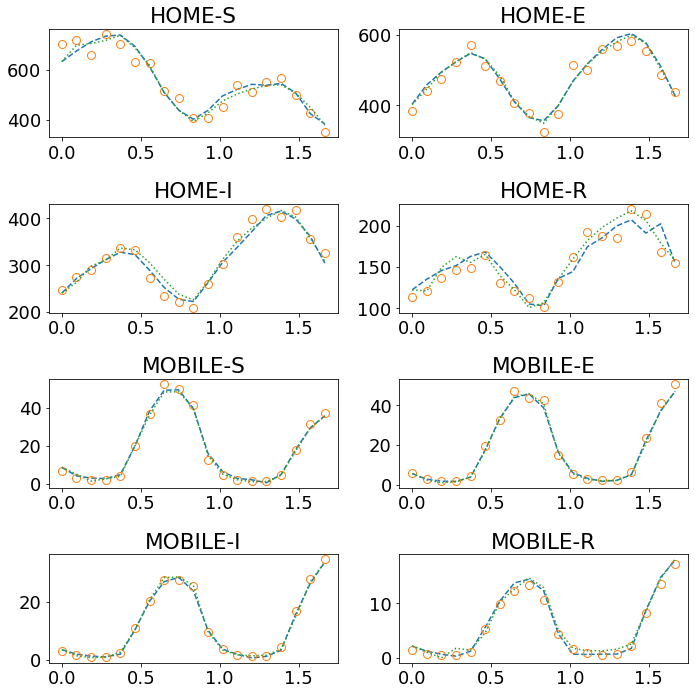

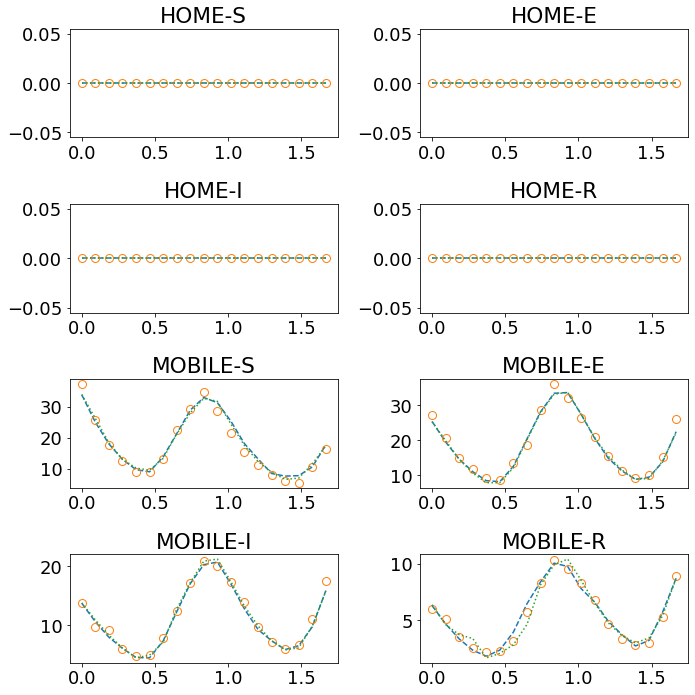

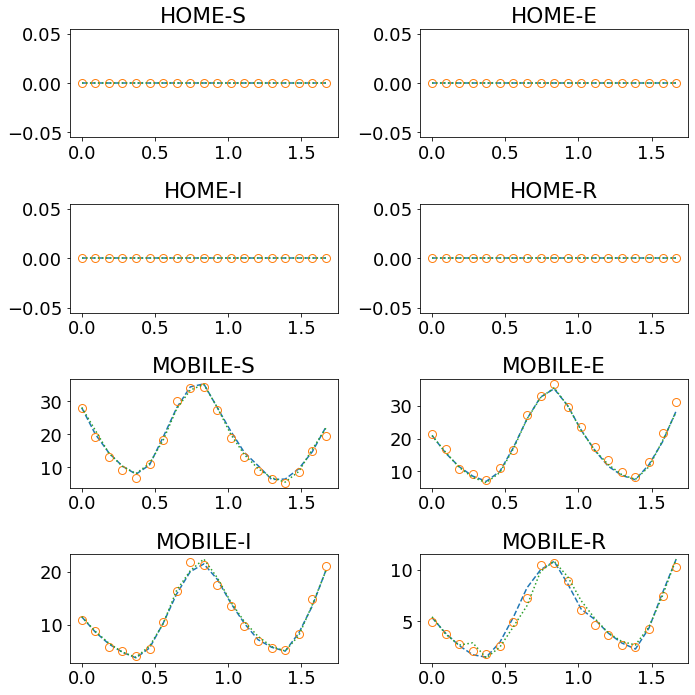

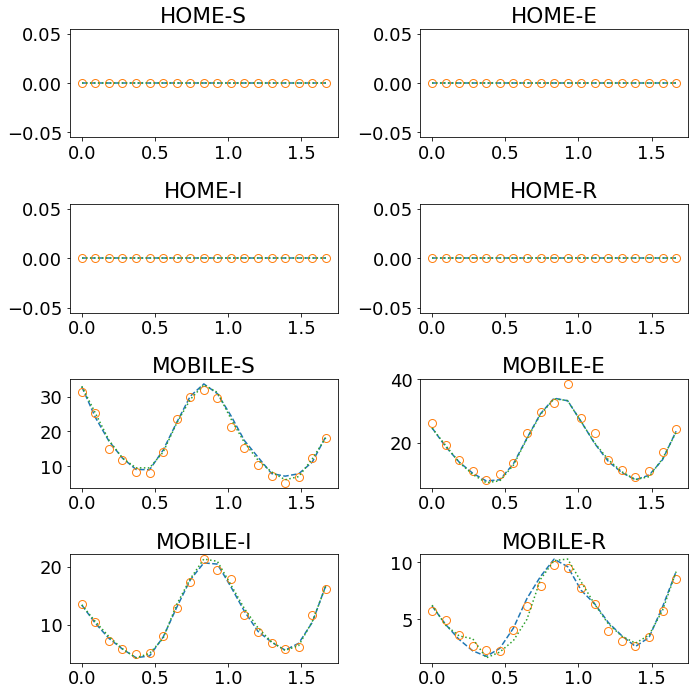

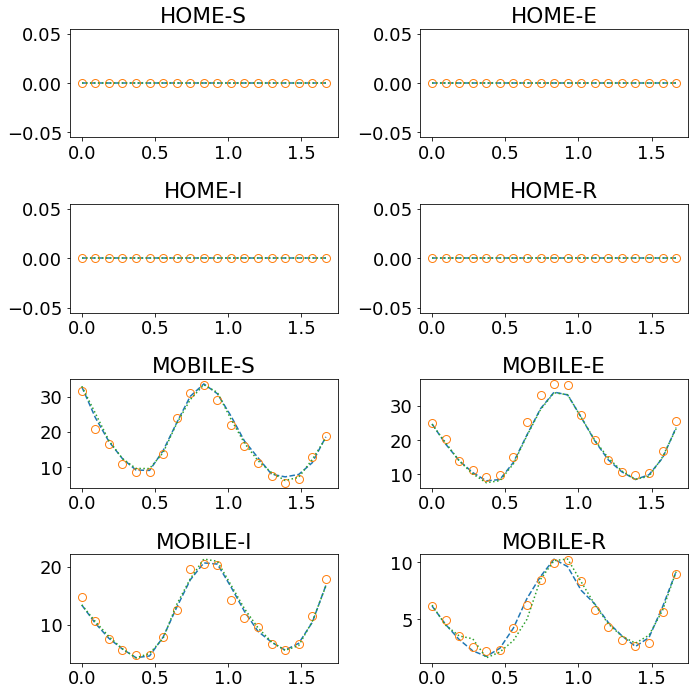


Iteration 7: forward and backward
-- Forward March --
Loss iteration 0: ['1.80e-02', '1.82e-03', '2.34e-05', '1.62e-02']
Loss iteration 1: ['1.40e-02', '1.26e-03', '1.62e-05', '1.27e-02'] - 4s
Loss iteration 2: ['1.40e-02', '8.35e-04', '1.89e-05', '1.31e-02'] - 1s
Loss iteration 3: ['1.43e-02', '1.71e-03', '2.82e-05', '1.26e-02'] - 4s
Loss iteration 4: ['1.56e-02', '9.78e-04', '1.53e-05', '1.46e-02'] - 2s
Loss iteration 5: ['1.88e-02', '2.27e-03', '2.18e-05', '1.65e-02'] - 4s
Loss iteration 6: ['1.29e-02', '1.06e-03', '1.41e-05', '1.19e-02'] - 4s
Loss iteration 7: ['1.35e-02', '2.10e-03', '1.24e-05', '1.14e-02'] - 1s
Loss iteration 8: ['1.31e-02', '1.47e-03', '2.00e-05', '1.17e-02'] - 1s
Loss iteration 9: ['1.13e-02', '1.93e-03', '1.40e-05', '9.36e-03'] - 4s
Loss iteration mean: ['1.46e-02', '1.54e-03', '1.84e-05', '1.30e-02']
-- Backward March --
Loss iteration 0: ['1.14e-02', '1.81e-03', '1.38e-05', '9.56e-03']
Loss iteration 1: ['1.28e-02', '1.51e-03', '4.29e-05', '1.13e-02'] - 1s


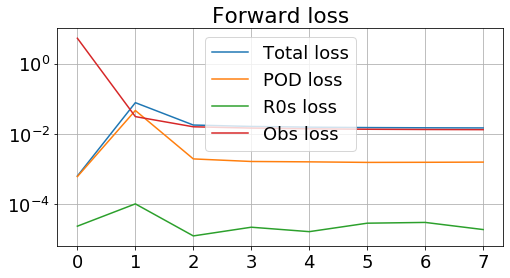

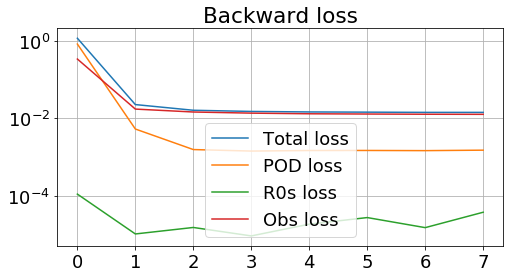

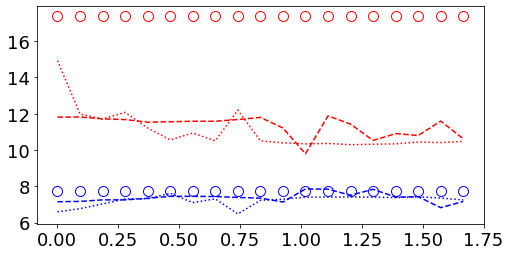

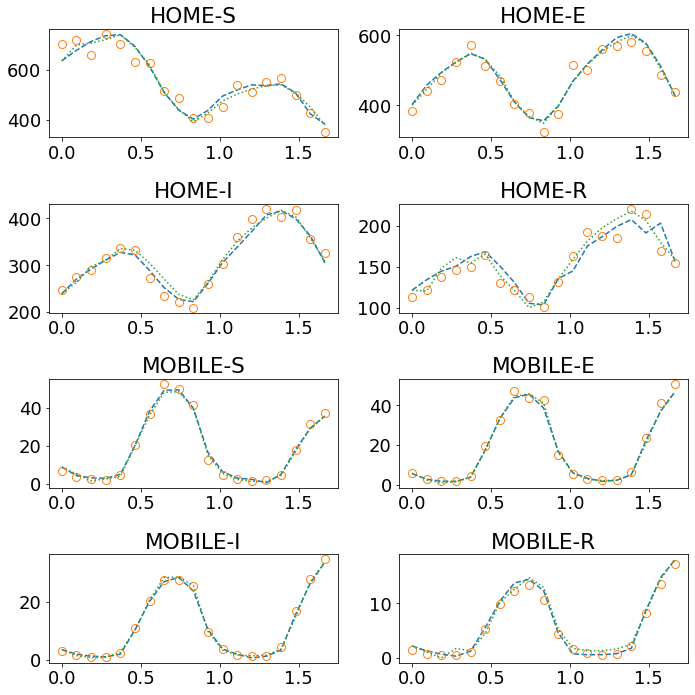

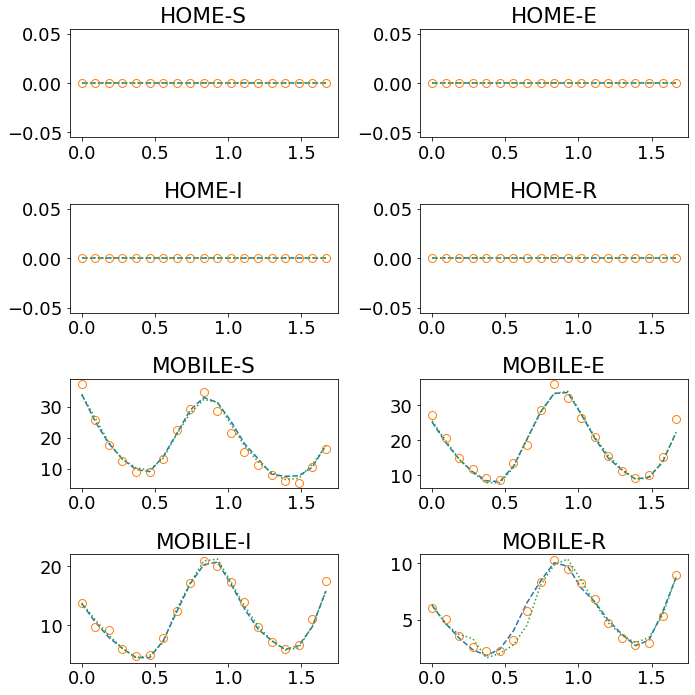

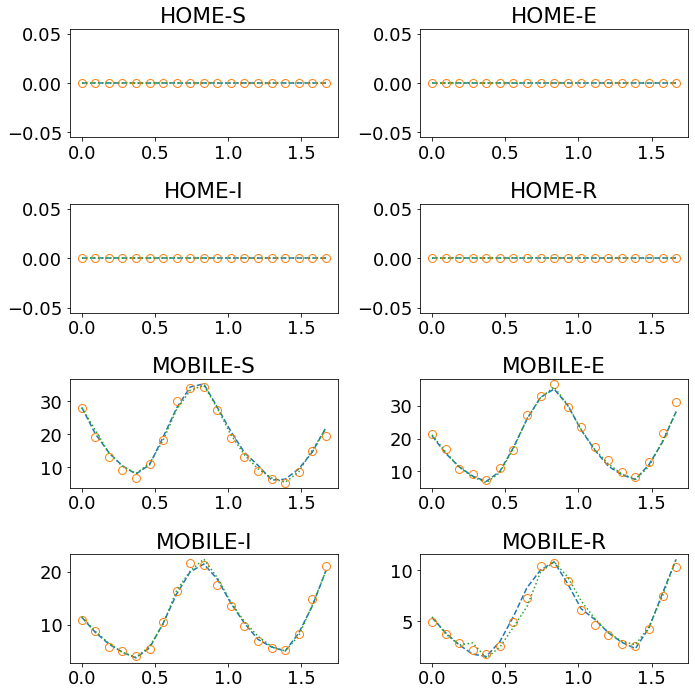

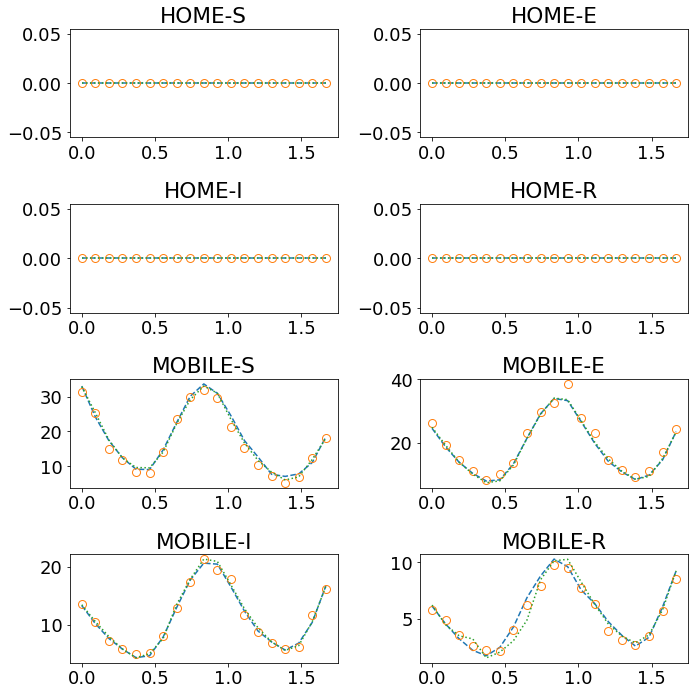

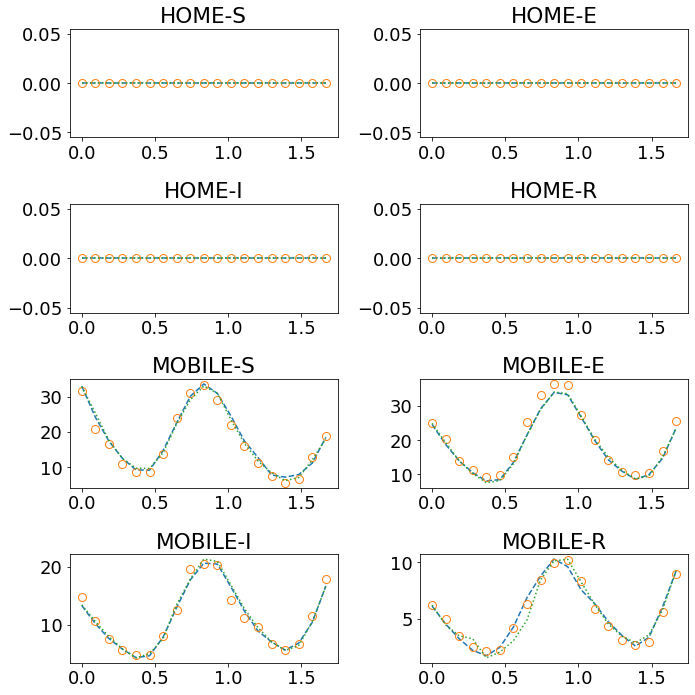


Iteration 8: forward and backward
-- Forward March --
Loss iteration 0: ['1.76e-02', '1.77e-03', '4.04e-05', '1.58e-02']
Loss iteration 1: ['1.43e-02', '1.37e-03', '1.20e-05', '1.29e-02'] - 1s
Loss iteration 2: ['1.41e-02', '8.75e-04', '4.63e-05', '1.32e-02'] - 1s
Loss iteration 3: ['1.41e-02', '1.79e-03', '2.94e-05', '1.23e-02'] - 1s
Loss iteration 4: ['1.58e-02', '1.05e-03', '2.02e-05', '1.47e-02'] - 2s
Loss iteration 5: ['1.83e-02', '2.31e-03', '2.58e-05', '1.59e-02'] - 4s
Loss iteration 6: ['1.26e-02', '1.06e-03', '1.69e-05', '1.15e-02'] - 4s
Loss iteration 7: ['1.32e-02', '2.03e-03', '1.59e-05', '1.11e-02'] - 1s
Loss iteration 8: ['1.33e-02', '1.88e-03', '2.73e-05', '1.14e-02'] - 1s
Loss iteration 9: ['1.15e-02', '2.06e-03', '7.53e-05', '9.33e-03'] - 1s
Loss iteration mean: ['1.45e-02', '1.62e-03', '3.09e-05', '1.28e-02']
-- Backward March --
Loss iteration 0: ['1.13e-02', '1.77e-03', '2.44e-05', '9.53e-03']
Loss iteration 1: ['1.34e-02', '1.68e-03', '5.95e-05', '1.17e-02'] - 1s


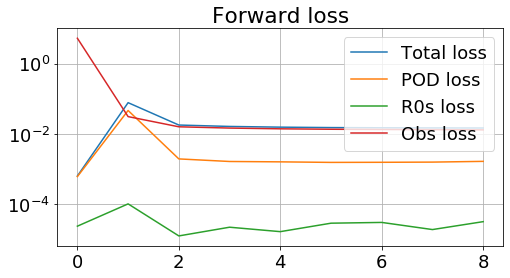

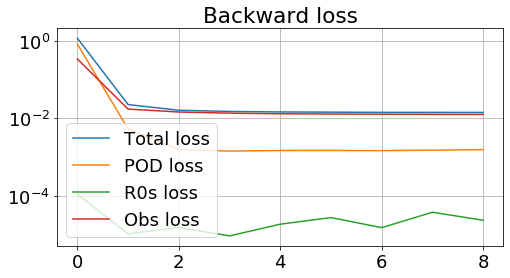

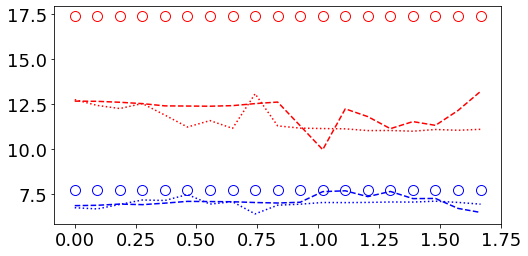

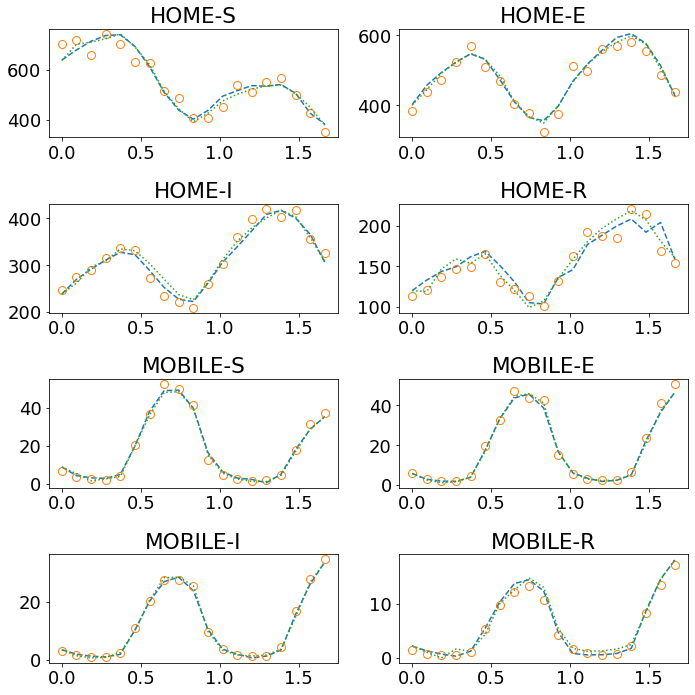

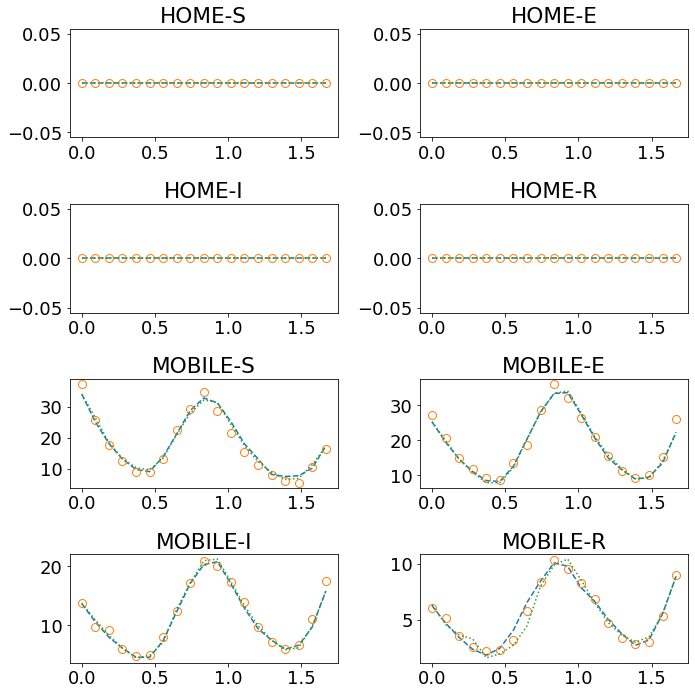

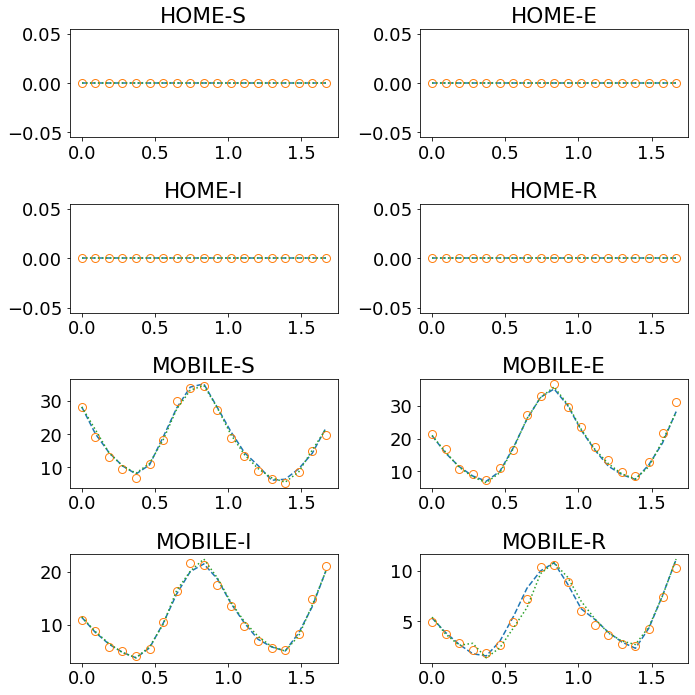

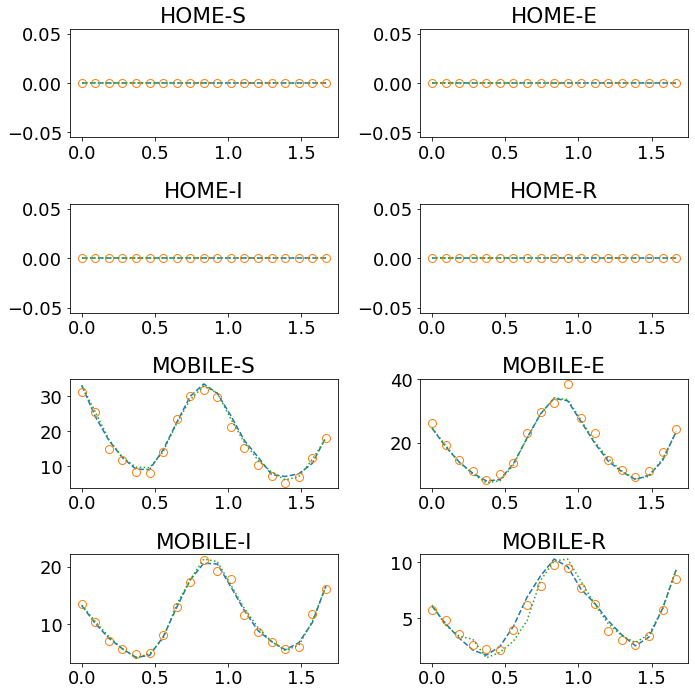

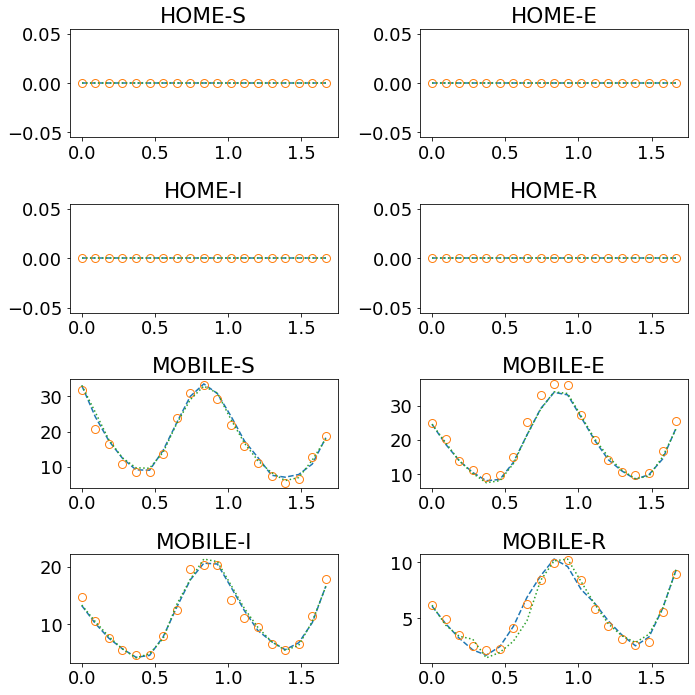


Iteration 9: forward and backward
-- Forward March --
Loss iteration 0: ['1.74e-02', '1.84e-03', '2.11e-05', '1.55e-02']
Loss iteration 1: ['1.43e-02', '1.41e-03', '1.80e-05', '1.29e-02'] - 4s
Loss iteration 2: ['1.41e-02', '9.33e-04', '1.42e-05', '1.31e-02'] - 2s
Loss iteration 3: ['1.41e-02', '1.89e-03', '2.92e-05', '1.22e-02'] - 1s
Loss iteration 4: ['1.59e-02', '1.19e-03', '1.66e-05', '1.46e-02'] - 4s
Loss iteration 5: ['1.83e-02', '2.45e-03', '2.58e-05', '1.58e-02'] - 4s
Loss iteration 6: ['1.27e-02', '1.07e-03', '1.25e-05', '1.16e-02'] - 4s
Loss iteration 7: ['1.33e-02', '2.10e-03', '1.09e-05', '1.12e-02'] - 1s
Loss iteration 8: ['1.35e-02', '2.04e-03', '1.69e-05', '1.14e-02'] - 1s
Loss iteration 9: ['1.14e-02', '2.01e-03', '1.47e-05', '9.41e-03'] - 4s
Loss iteration mean: ['1.45e-02', '1.69e-03', '1.80e-05', '1.28e-02']
-- Backward March --
Loss iteration 0: ['1.15e-02', '1.81e-03', '9.93e-06', '9.67e-03']
Loss iteration 1: ['1.36e-02', '1.75e-03', '4.70e-05', '1.18e-02'] - 1s


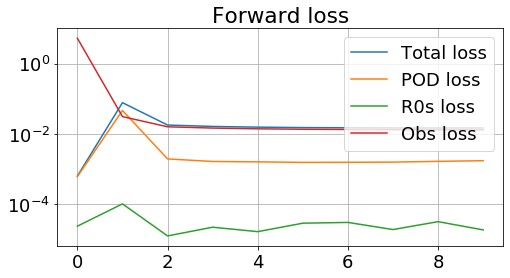

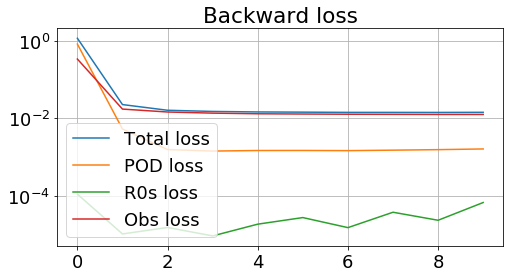

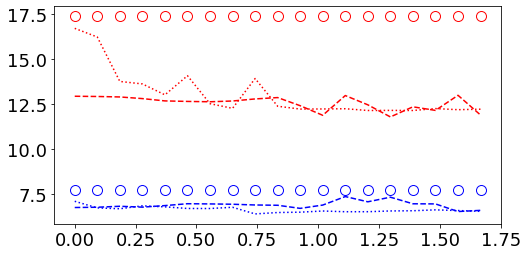

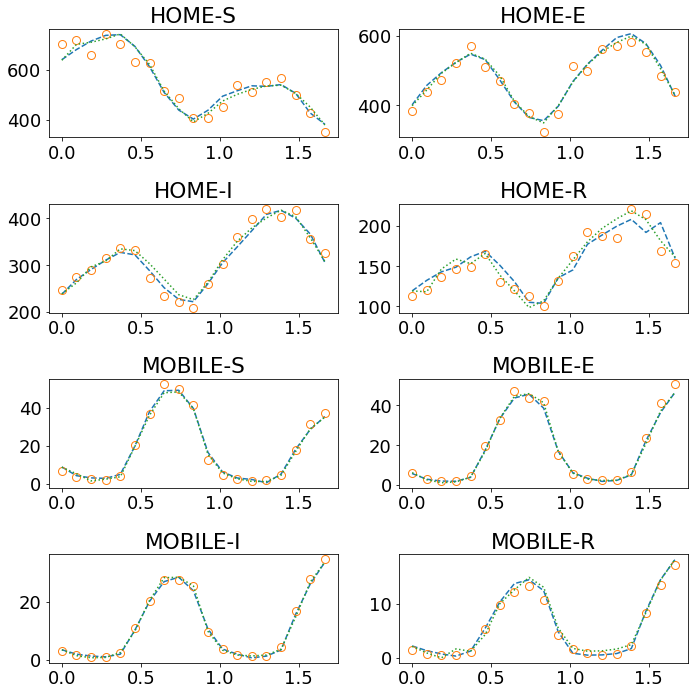

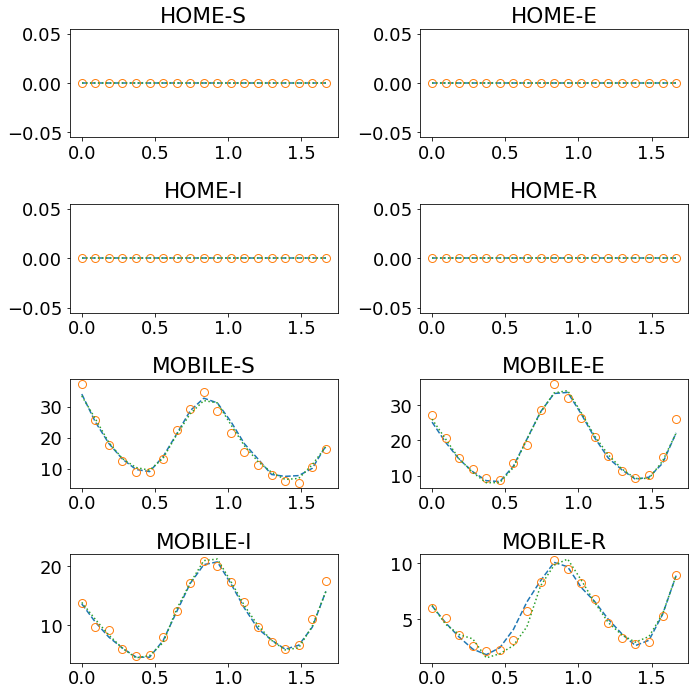

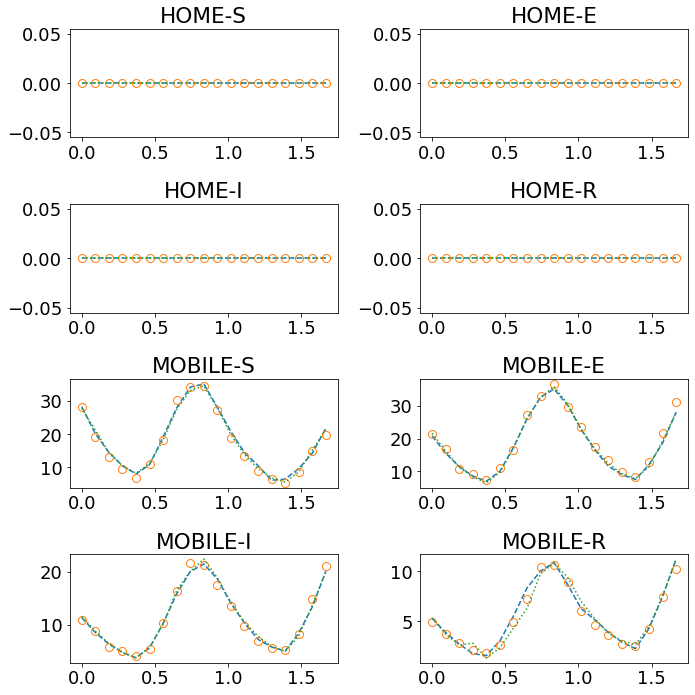

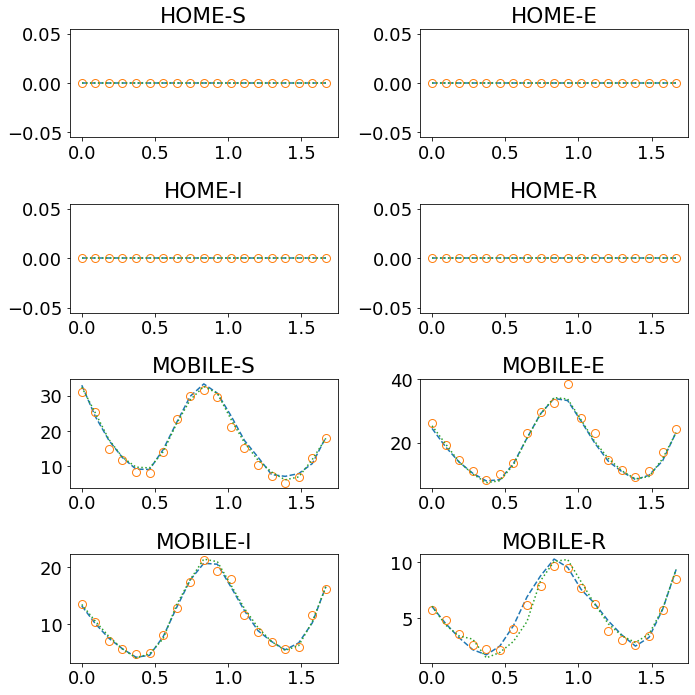

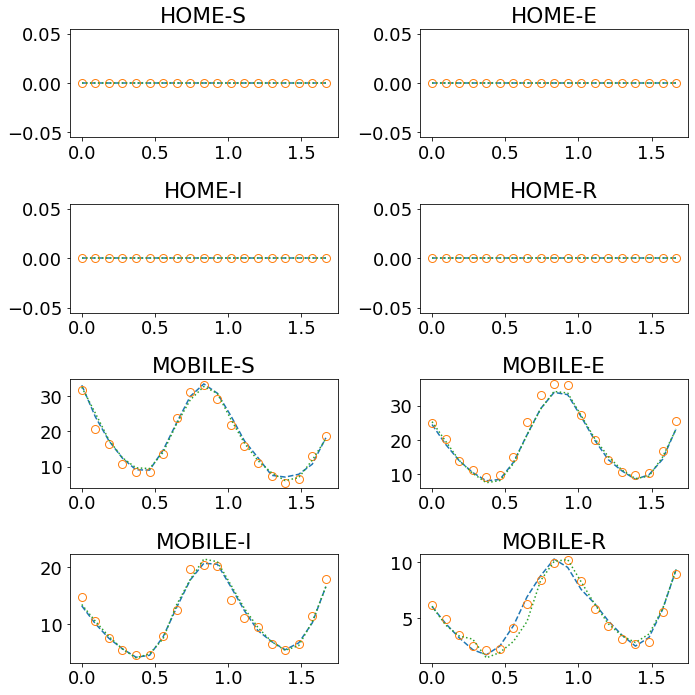


Iteration 10: forward and backward
-- Forward March --
Loss iteration 0: ['1.73e-02', '1.90e-03', '2.73e-04', '1.52e-02']
Loss iteration 1: ['1.44e-02', '1.61e-03', '2.30e-04', '1.26e-02'] - 4s
Loss iteration 2: ['1.42e-02', '1.06e-03', '2.07e-04', '1.29e-02'] - 1s
Loss iteration 3: ['1.38e-02', '1.99e-03', '3.28e-04', '1.15e-02'] - 4s
Loss iteration 4: ['1.61e-02', '1.30e-03', '2.16e-04', '1.46e-02'] - 4s
Loss iteration 5: ['1.86e-02', '2.45e-03', '1.15e-04', '1.60e-02'] - 4s
Loss iteration 6: ['1.32e-02', '1.20e-03', '1.27e-04', '1.18e-02'] - 1s
Loss iteration 7: ['1.38e-02', '2.25e-03', '7.36e-05', '1.14e-02'] - 2s
Loss iteration 8: ['1.36e-02', '2.14e-03', '3.97e-05', '1.14e-02'] - 2s
Loss iteration 9: ['1.17e-02', '2.10e-03', '4.24e-05', '9.60e-03'] - 1s
Loss iteration mean: ['1.47e-02', '1.80e-03', '1.65e-04', '1.27e-02']
-- Backward March --
Loss iteration 0: ['1.18e-02', '1.95e-03', '3.51e-05', '9.85e-03']
Loss iteration 1: ['1.33e-02', '1.85e-03', '2.10e-05', '1.14e-02'] - 2s

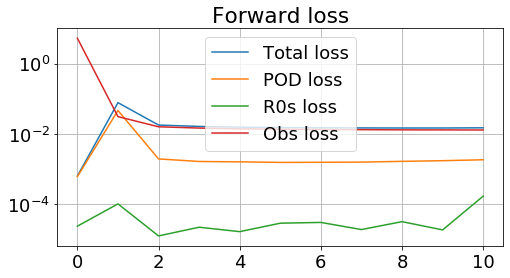

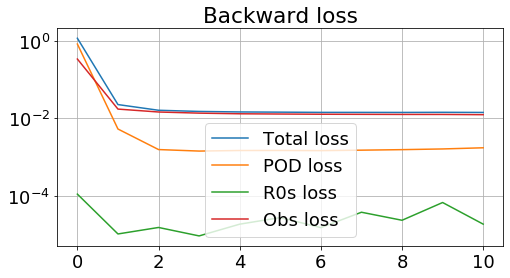

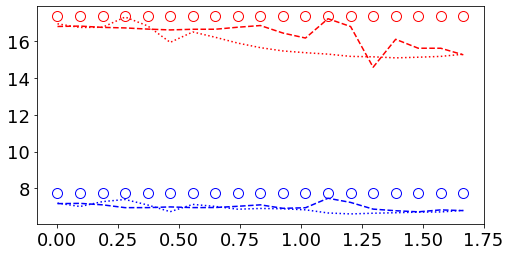

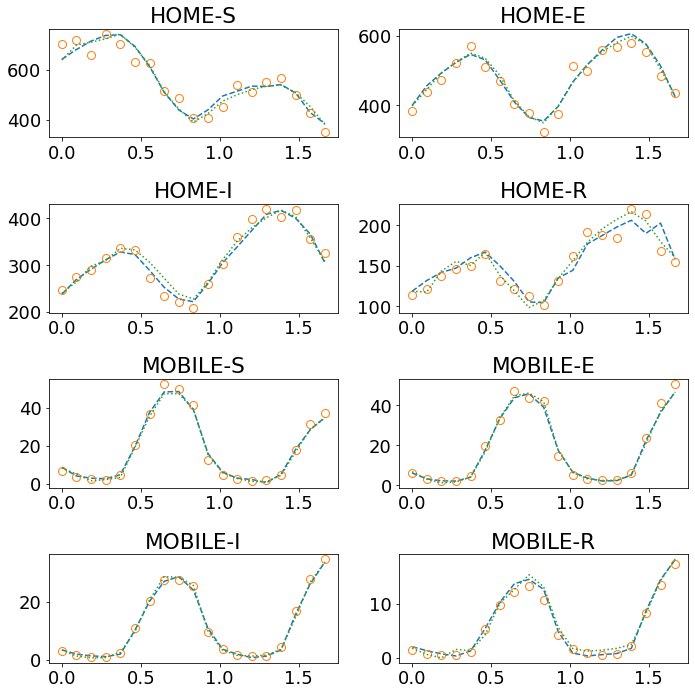

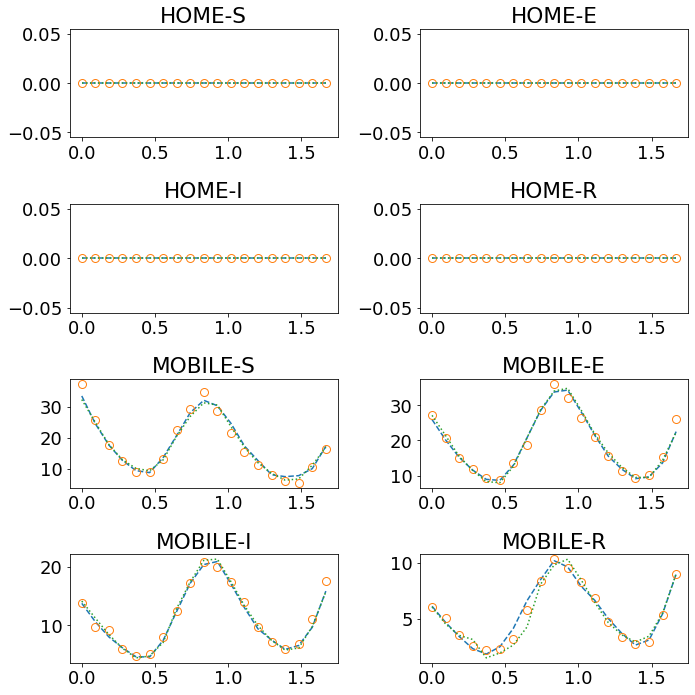

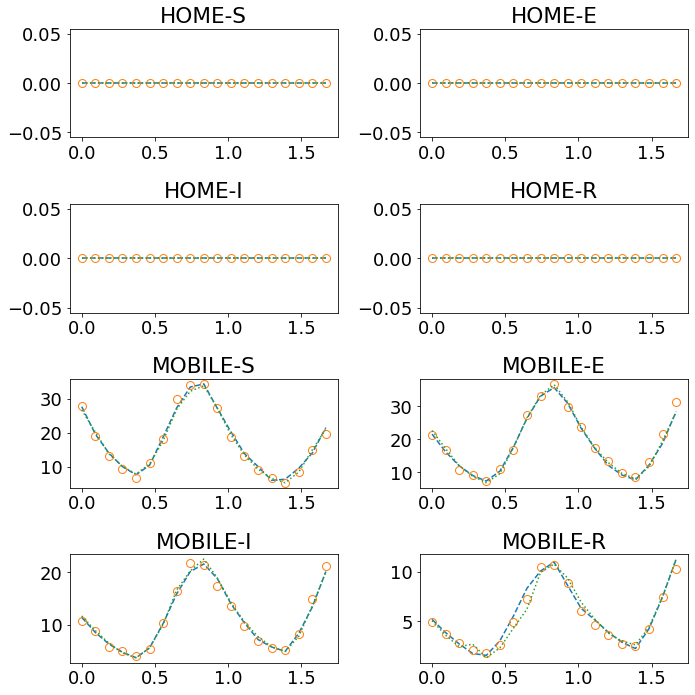

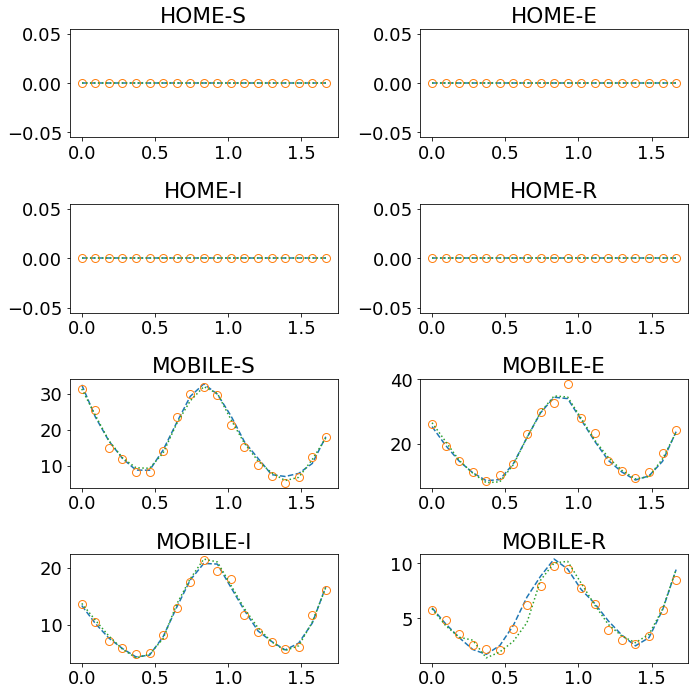

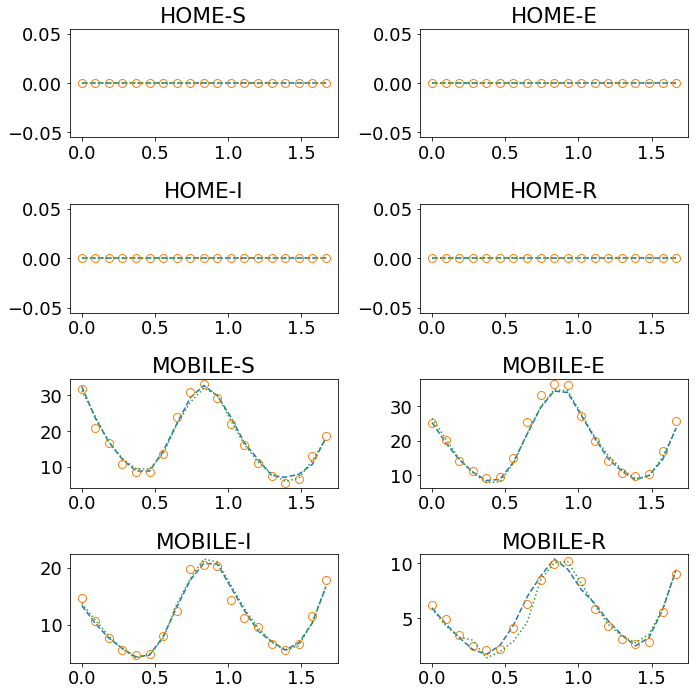


Iteration 11: forward and backward
-- Forward March --
Loss iteration 0: ['1.68e-02', '2.03e-03', '1.62e-05', '1.47e-02']
Loss iteration 1: ['1.41e-02', '1.68e-03', '8.50e-06', '1.24e-02'] - 1s
Loss iteration 2: ['1.38e-02', '1.15e-03', '7.39e-06', '1.26e-02'] - 1s
Loss iteration 3: ['1.31e-02', '2.18e-03', '3.98e-05', '1.09e-02'] - 4s
Loss iteration 4: ['1.59e-02', '1.46e-03', '1.51e-05', '1.45e-02'] - 4s
Loss iteration 5: ['1.87e-02', '2.49e-03', '1.26e-05', '1.62e-02'] - 4s
Loss iteration 6: ['1.33e-02', '1.28e-03', '1.02e-05', '1.20e-02'] - 1s
Loss iteration 7: ['1.41e-02', '2.32e-03', '1.03e-05', '1.17e-02'] - 1s
Loss iteration 8: ['1.39e-02', '2.35e-03', '5.13e-05', '1.15e-02'] - 1s
Loss iteration 9: ['1.20e-02', '2.17e-03', '8.55e-05', '9.73e-03'] - 1s
Loss iteration mean: ['1.46e-02', '1.91e-03', '2.57e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.21e-02', '1.97e-03', '7.34e-05', '1.01e-02']
Loss iteration 1: ['1.36e-02', '2.00e-03', '4.35e-05', '1.15e-02'] - 1s

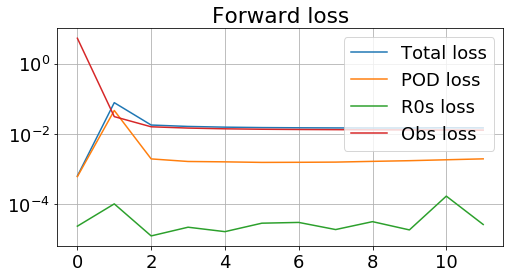

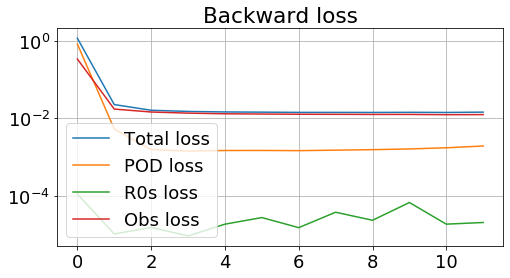

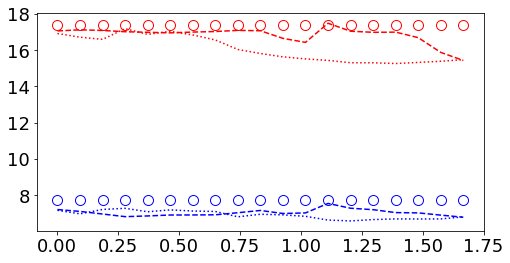

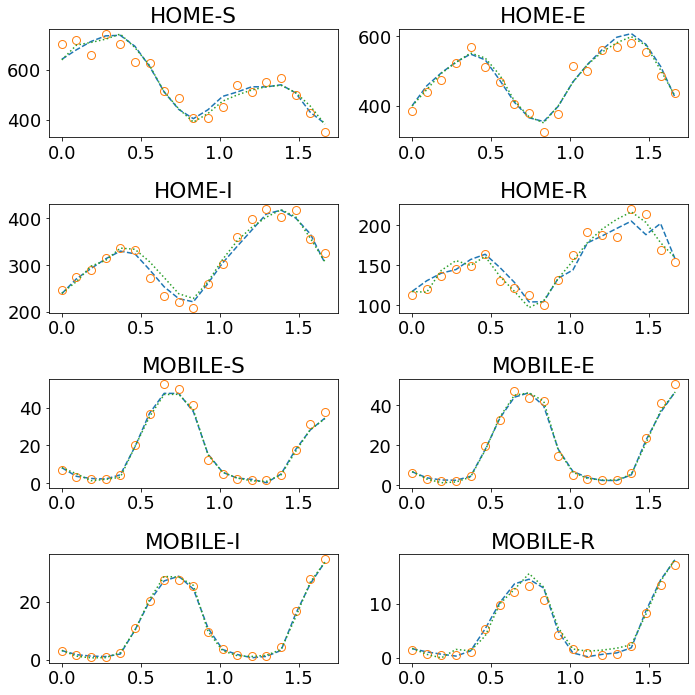

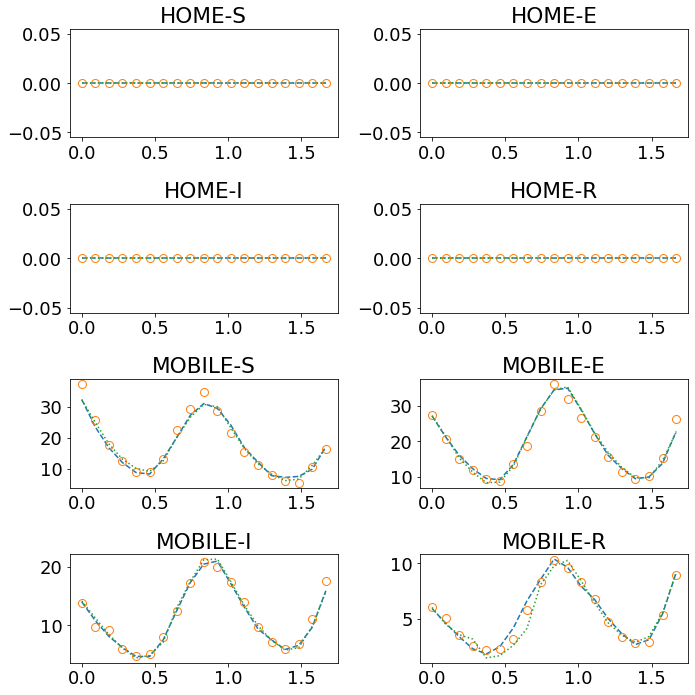

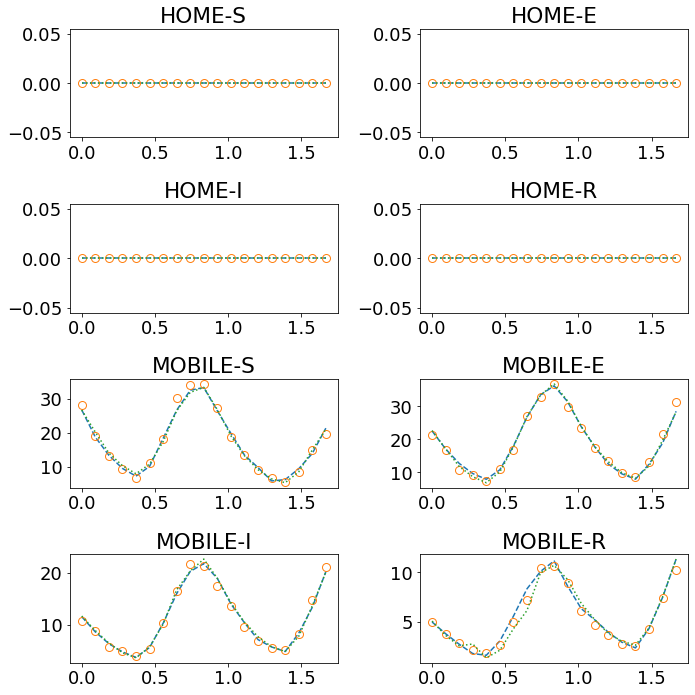

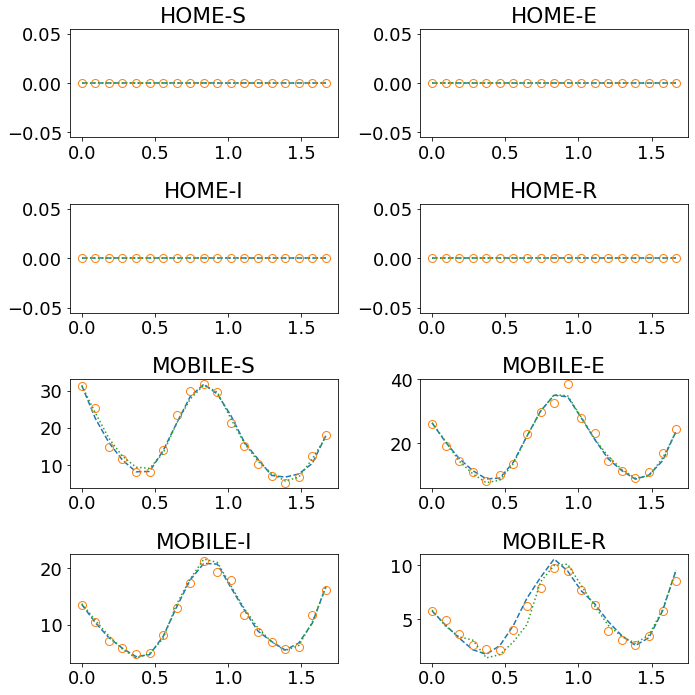

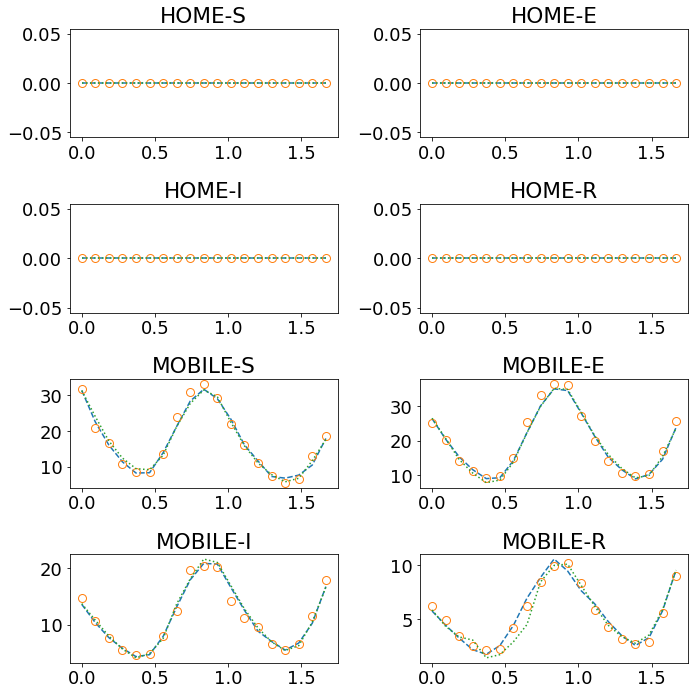


Iteration 12: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.18e-03', '1.04e-05', '1.46e-02']
Loss iteration 1: ['1.42e-02', '1.82e-03', '7.53e-06', '1.23e-02'] - 4s
Loss iteration 2: ['1.37e-02', '1.30e-03', '1.01e-05', '1.24e-02'] - 1s
Loss iteration 3: ['1.32e-02', '2.31e-03', '2.55e-05', '1.09e-02'] - 1s
Loss iteration 4: ['1.62e-02', '1.75e-03', '1.35e-05', '1.44e-02'] - 1s
Loss iteration 5: ['1.88e-02', '2.60e-03', '1.05e-05', '1.62e-02'] - 4s
Loss iteration 6: ['1.34e-02', '1.27e-03', '1.27e-05', '1.21e-02'] - 1s
Loss iteration 7: ['1.43e-02', '2.38e-03', '1.13e-05', '1.19e-02'] - 1s
Loss iteration 8: ['1.39e-02', '2.26e-03', '2.35e-05', '1.16e-02'] - 4s
Loss iteration 9: ['1.23e-02', '2.35e-03', '3.92e-05', '9.95e-03'] - 2s
Loss iteration mean: ['1.47e-02', '2.02e-03', '1.64e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.26e-02', '2.10e-03', '3.57e-05', '1.04e-02']
Loss iteration 1: ['1.34e-02', '2.08e-03', '1.36e-05', '1.13e-02'] - 1s

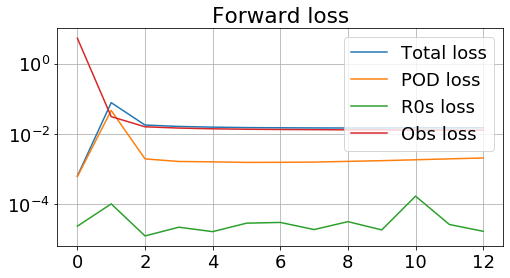

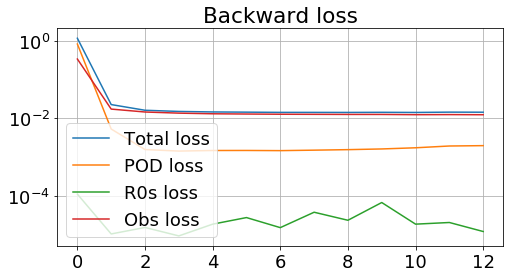

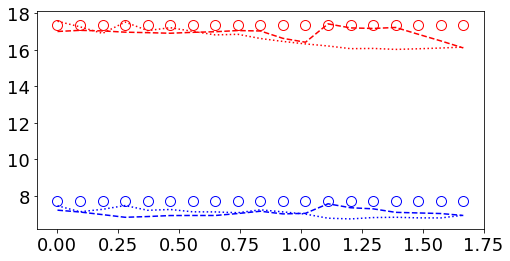

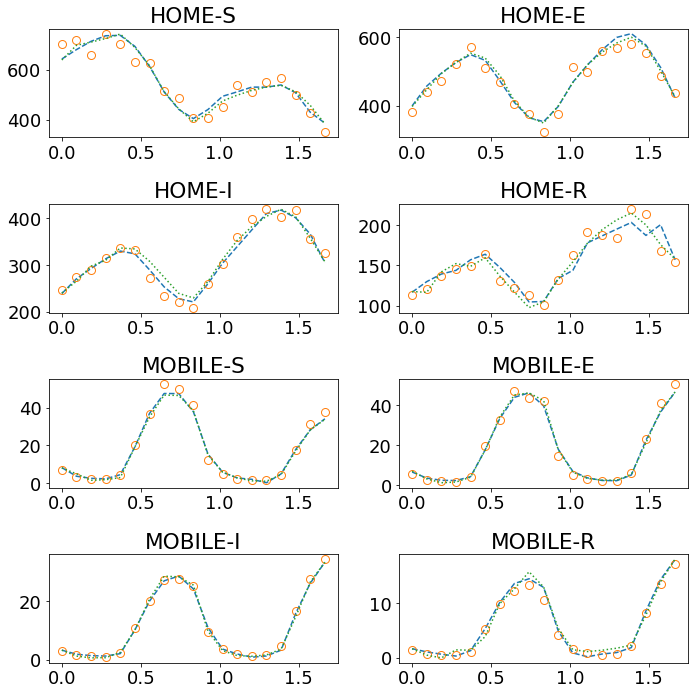

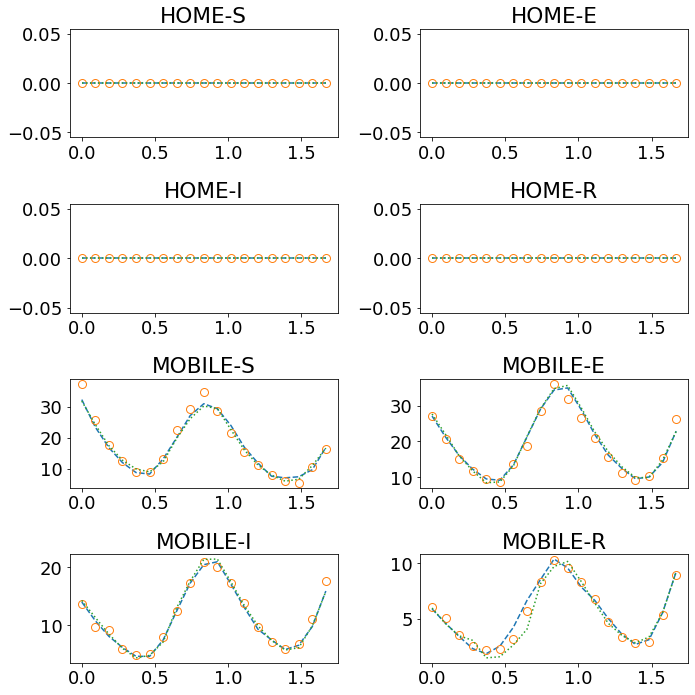

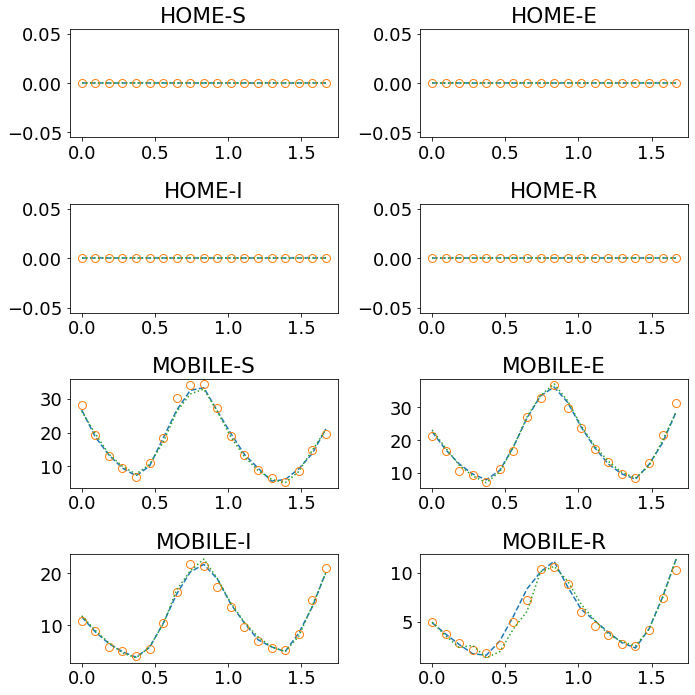

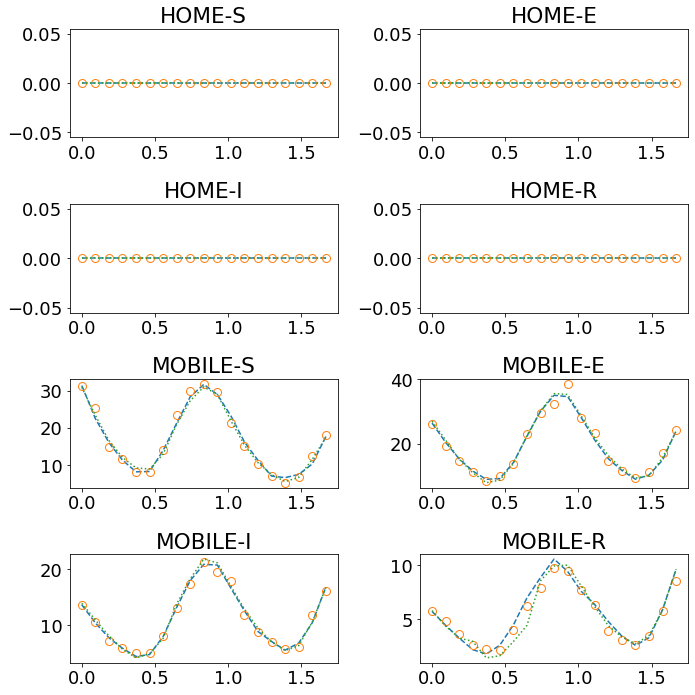

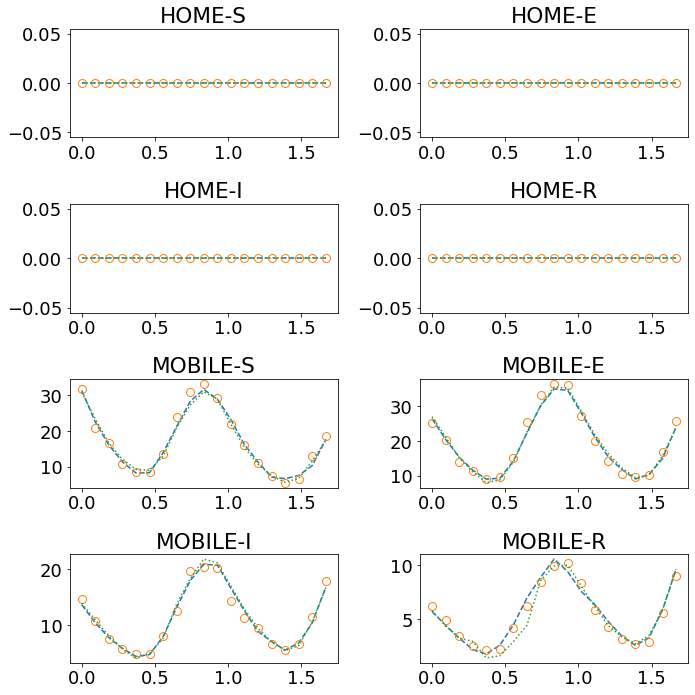


Iteration 13: forward and backward
-- Forward March --
Loss iteration 0: ['1.65e-02', '2.16e-03', '1.84e-05', '1.43e-02']
Loss iteration 1: ['1.41e-02', '1.82e-03', '5.96e-06', '1.23e-02'] - 1s
Loss iteration 2: ['1.36e-02', '1.38e-03', '5.27e-06', '1.22e-02'] - 1s
Loss iteration 3: ['1.31e-02', '2.45e-03', '1.83e-05', '1.06e-02'] - 1s
Loss iteration 4: ['1.62e-02', '1.75e-03', '5.87e-06', '1.44e-02'] - 4s
Loss iteration 5: ['1.87e-02', '2.69e-03', '6.24e-06', '1.60e-02'] - 4s
Loss iteration 6: ['1.36e-02', '1.35e-03', '7.97e-06', '1.22e-02'] - 2s
Loss iteration 7: ['1.44e-02', '2.39e-03', '1.43e-05', '1.20e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.31e-03', '7.40e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.23e-02', '2.25e-03', '8.09e-05', '1.00e-02'] - 5s
Loss iteration mean: ['1.46e-02', '2.05e-03', '1.71e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.26e-02', '1.90e-03', '6.23e-05', '1.06e-02']
Loss iteration 1: ['1.37e-02', '2.17e-03', '1.93e-05', '1.15e-02'] - 1s

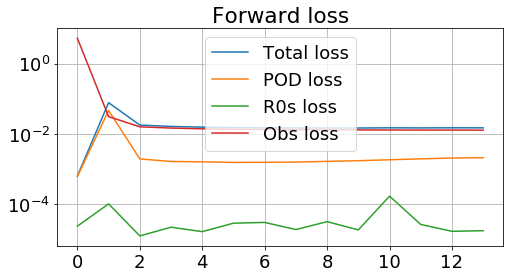

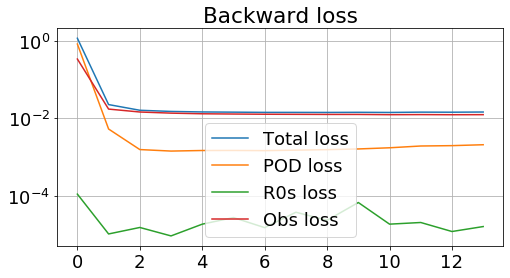

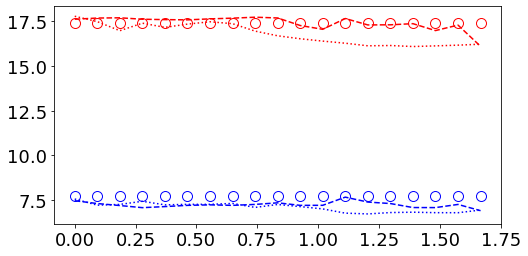

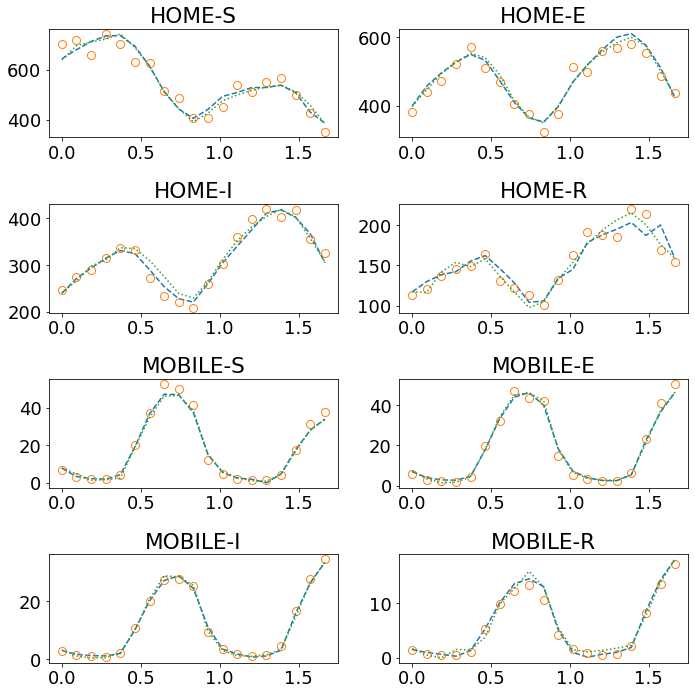

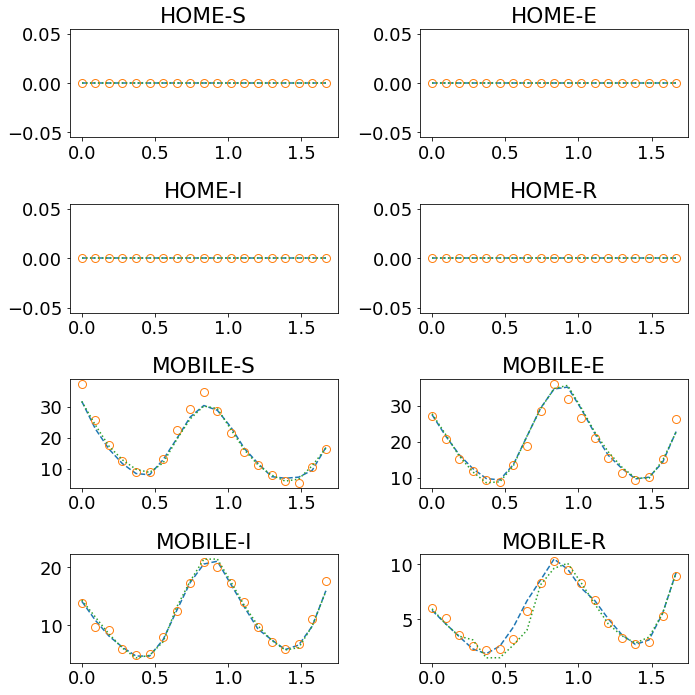

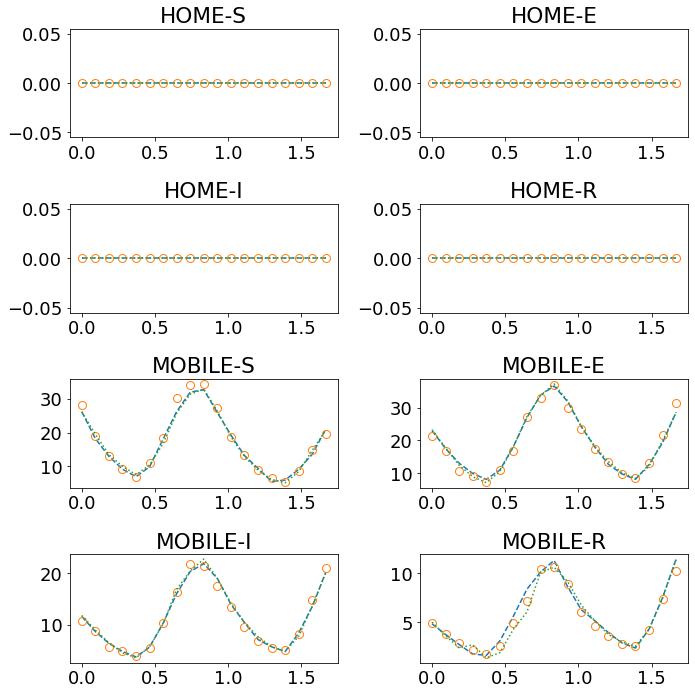

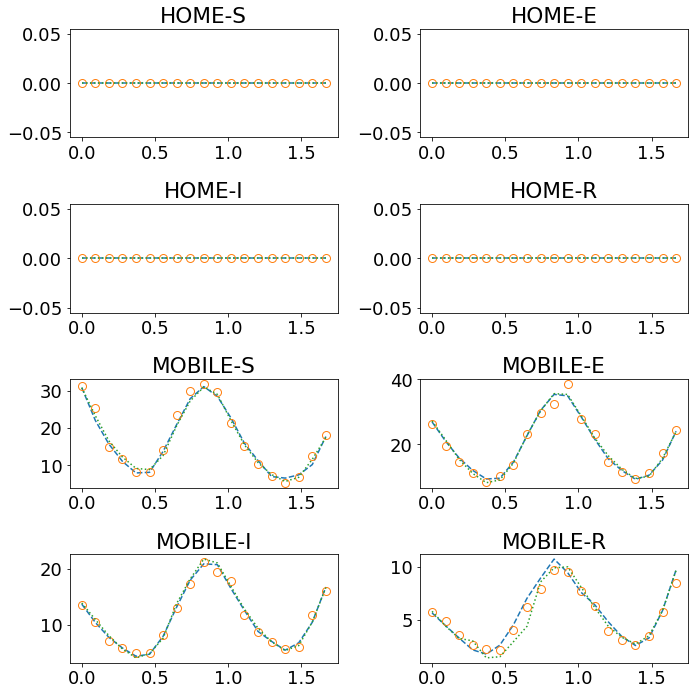

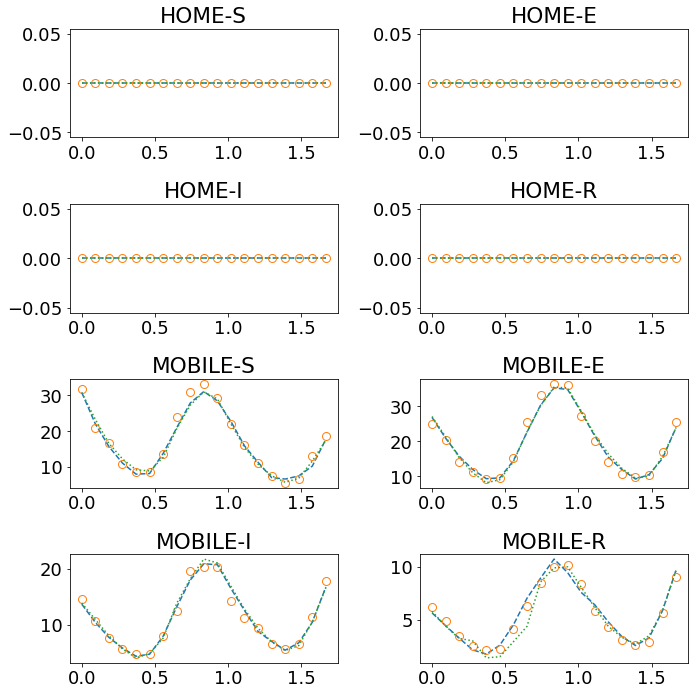


Iteration 14: forward and backward
-- Forward March --
Loss iteration 0: ['1.66e-02', '2.37e-03', '2.21e-05', '1.42e-02']
Loss iteration 1: ['1.42e-02', '1.89e-03', '8.27e-06', '1.23e-02'] - 1s
Loss iteration 2: ['1.36e-02', '1.45e-03', '6.81e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.32e-02', '2.61e-03', '2.18e-05', '1.05e-02'] - 1s
Loss iteration 4: ['1.63e-02', '1.82e-03', '7.53e-06', '1.45e-02'] - 4s
Loss iteration 5: ['1.88e-02', '2.90e-03', '9.89e-06', '1.59e-02'] - 4s
Loss iteration 6: ['1.37e-02', '1.36e-03', '1.11e-05', '1.23e-02'] - 3s
Loss iteration 7: ['1.45e-02', '2.47e-03', '1.56e-05', '1.20e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.40e-03', '9.57e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.25e-02', '2.27e-03', '8.93e-05', '1.02e-02'] - 4s
Loss iteration mean: ['1.47e-02', '2.15e-03', '2.02e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.27e-02', '1.99e-03', '7.27e-05', '1.06e-02']
Loss iteration 1: ['1.34e-02', '2.15e-03', '1.68e-05', '1.12e-02'] - 4s

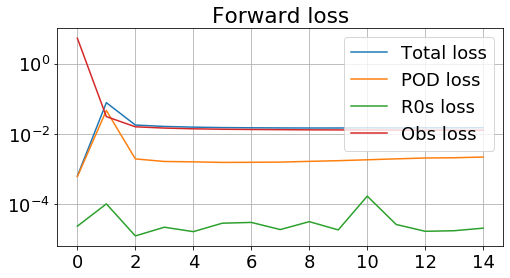

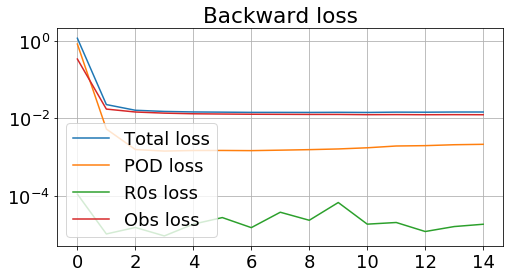

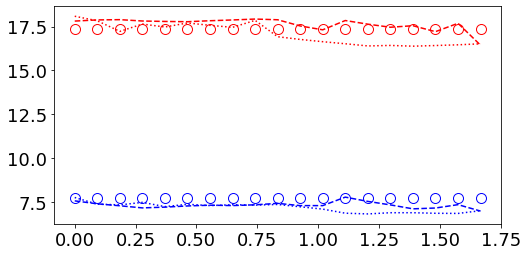

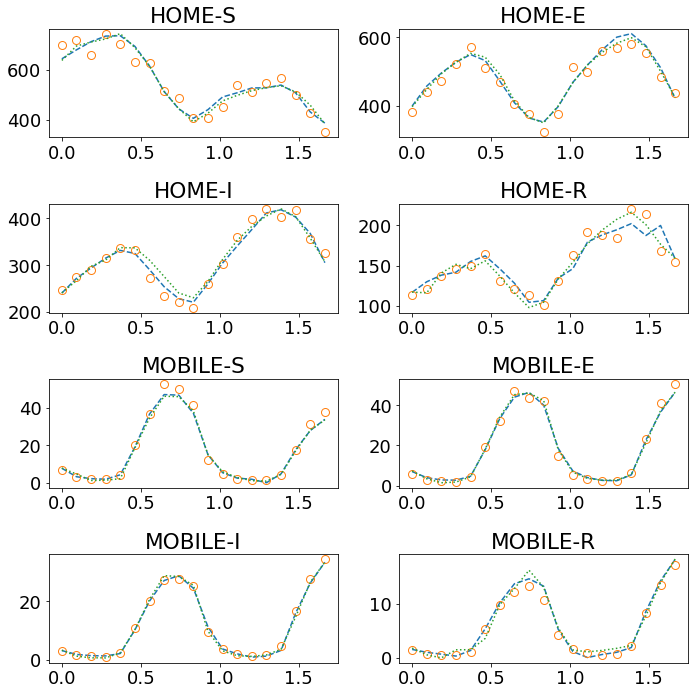

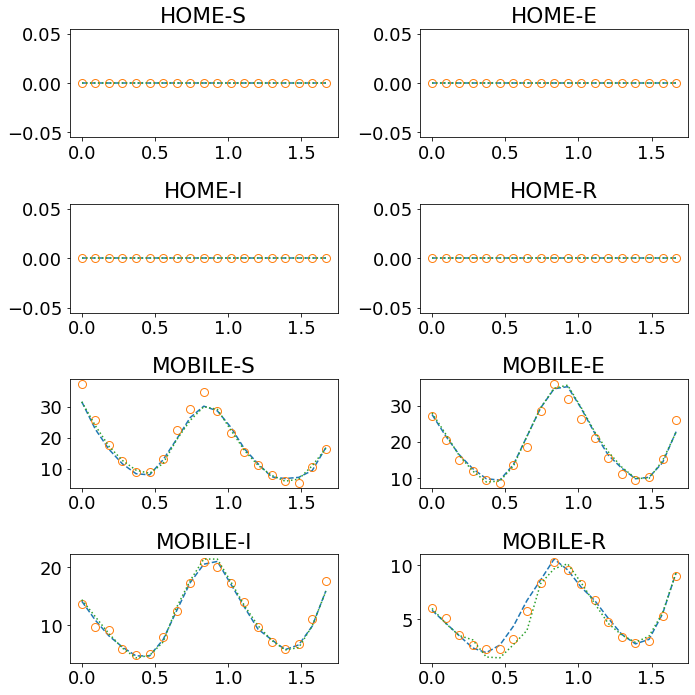

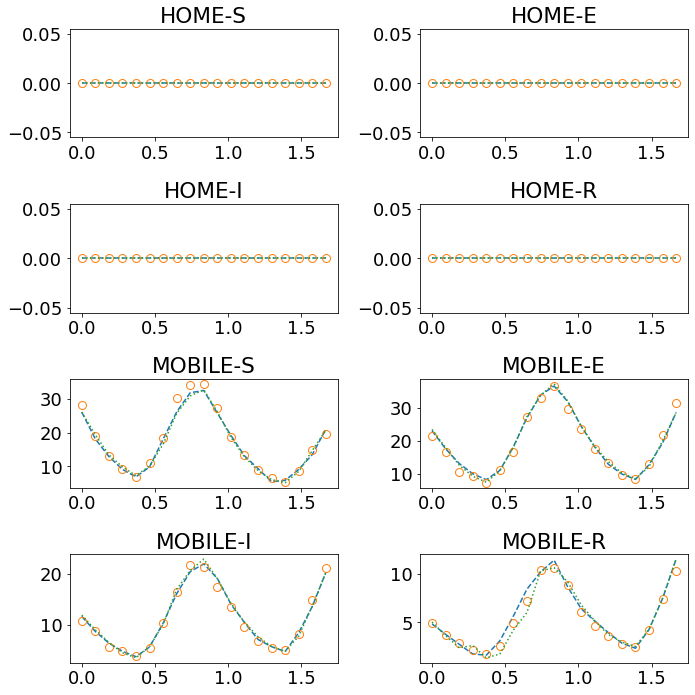

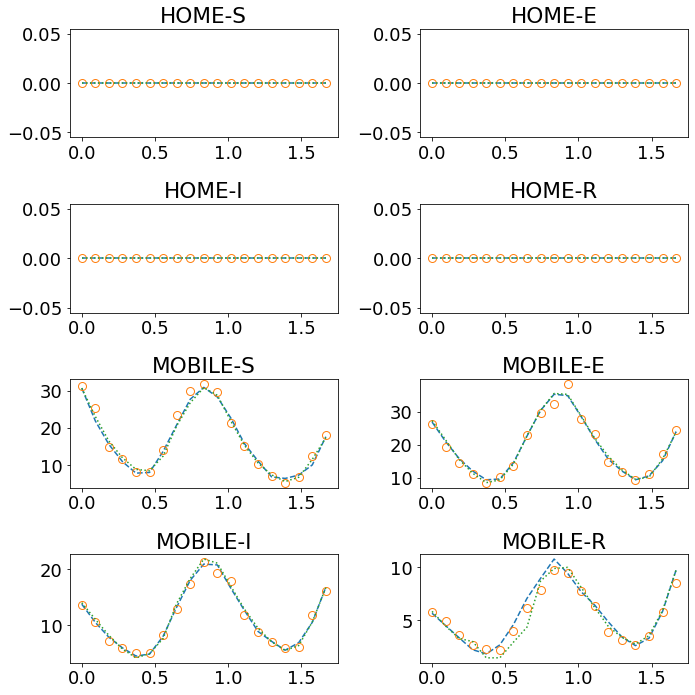

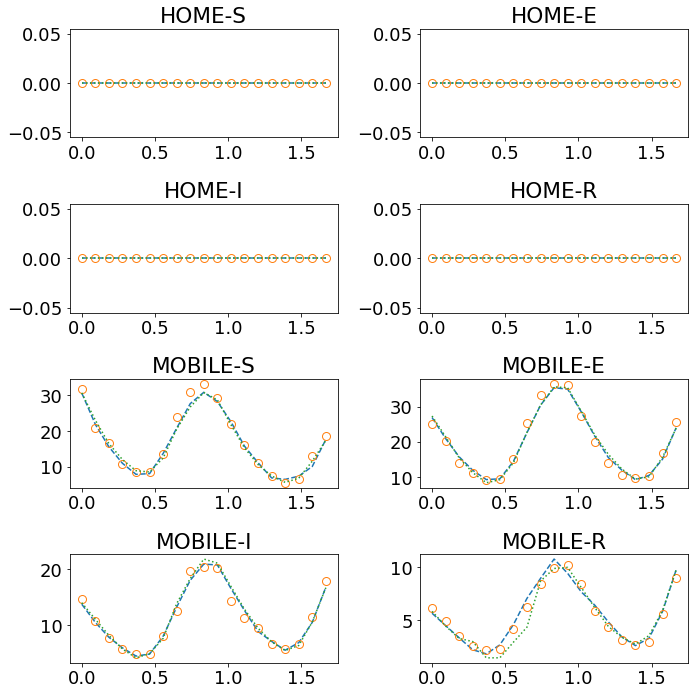


Iteration 15: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.35e-03', '2.37e-05', '1.43e-02']
Loss iteration 1: ['1.40e-02', '1.90e-03', '2.14e-05', '1.20e-02'] - 4s
Loss iteration 2: ['1.36e-02', '1.61e-03', '1.61e-05', '1.20e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.78e-03', '3.80e-05', '1.05e-02'] - 1s
Loss iteration 4: ['1.67e-02', '1.90e-03', '4.03e-05', '1.48e-02'] - 1s
Loss iteration 5: ['1.95e-02', '3.00e-03', '2.01e-05', '1.65e-02'] - 4s
Loss iteration 6: ['1.38e-02', '1.39e-03', '1.53e-05', '1.24e-02'] - 4s
Loss iteration 7: ['1.49e-02', '2.56e-03', '1.42e-05', '1.23e-02'] - 1s
Loss iteration 8: ['1.44e-02', '2.49e-03', '2.90e-05', '1.19e-02'] - 1s
Loss iteration 9: ['1.29e-02', '2.38e-03', '1.11e-04', '1.04e-02'] - 3s
Loss iteration mean: ['1.50e-02', '2.24e-03', '3.29e-05', '1.27e-02']
-- Backward March --
Loss iteration 0: ['1.31e-02', '2.07e-03', '1.09e-04', '1.09e-02']
Loss iteration 1: ['1.35e-02', '2.24e-03', '2.41e-05', '1.13e-02'] - 4s

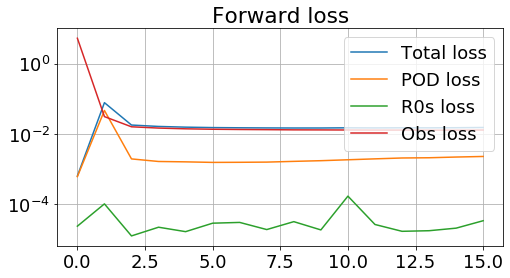

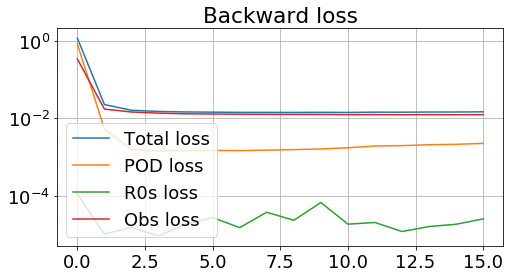

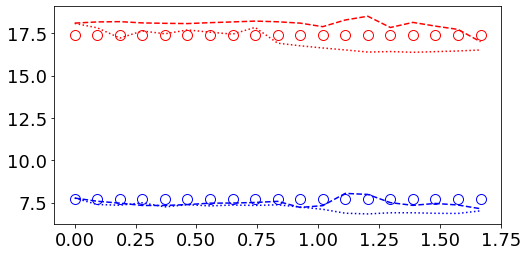

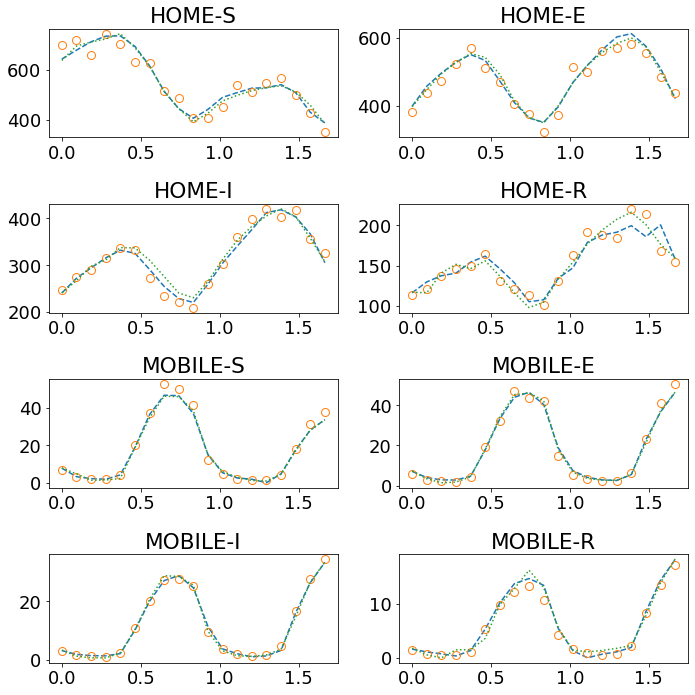

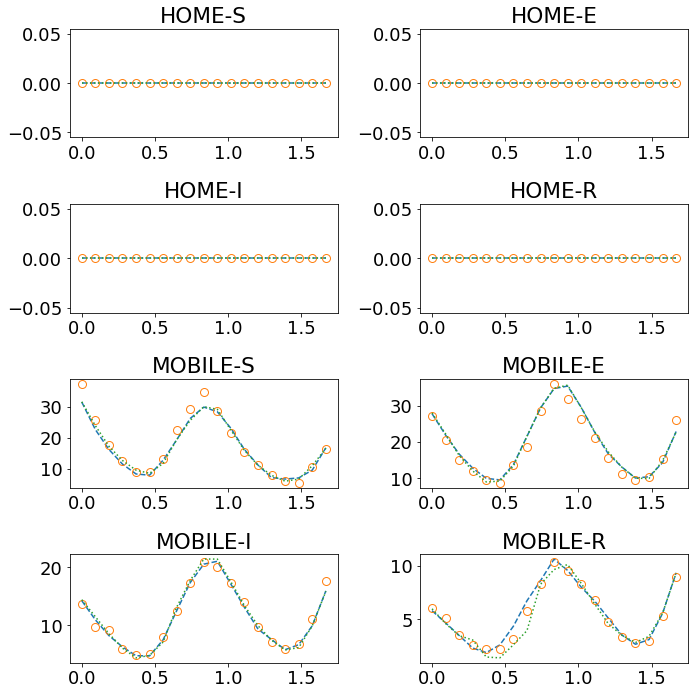

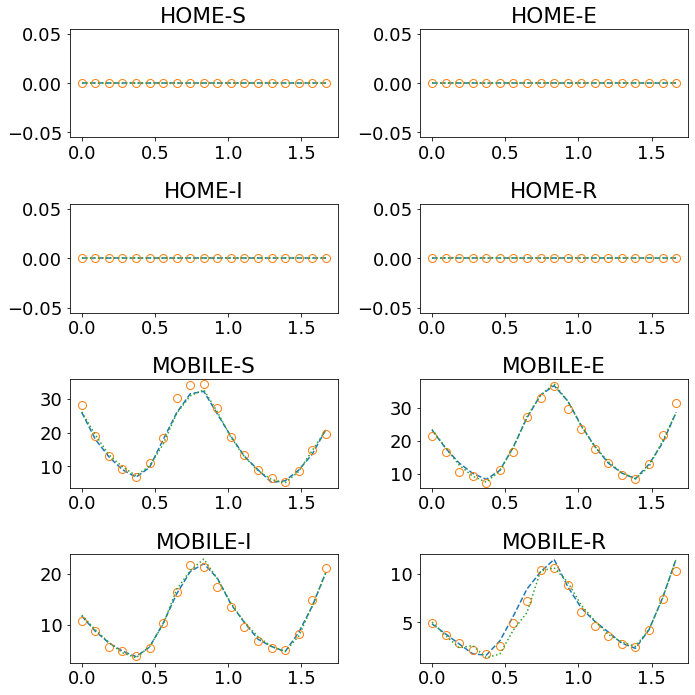

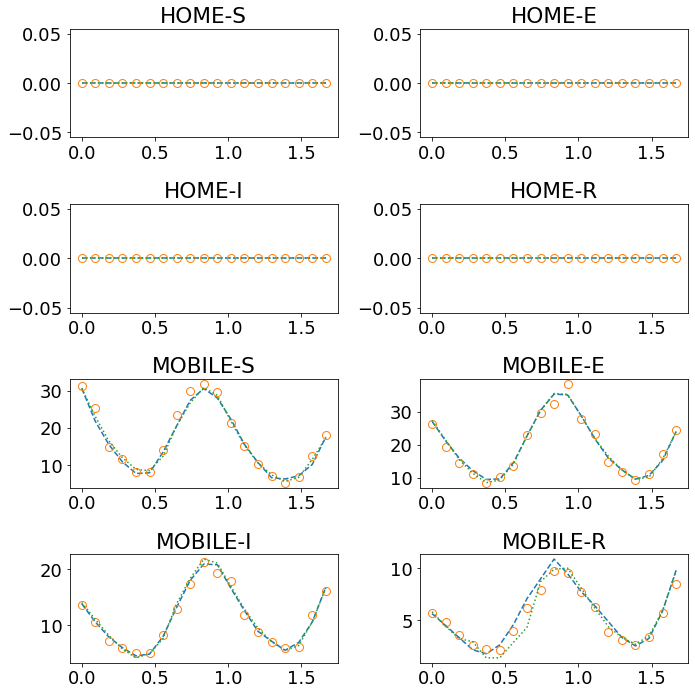

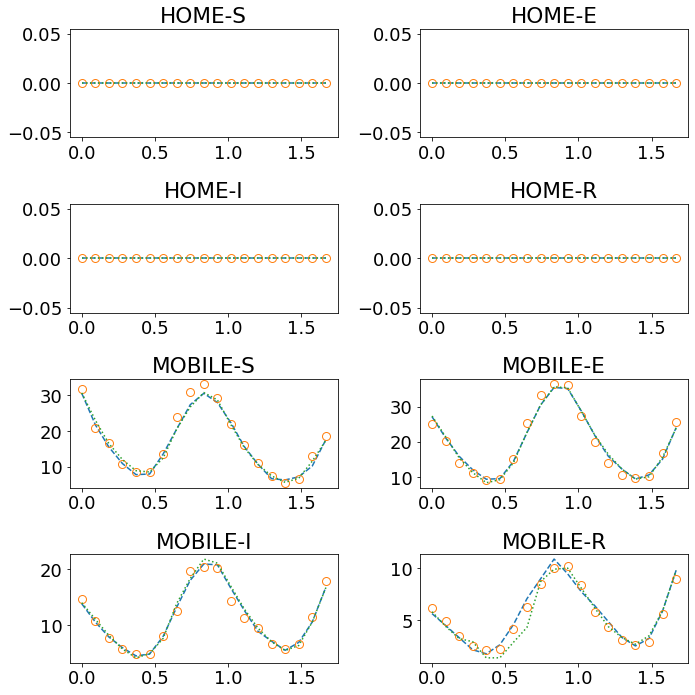


Iteration 16: forward and backward
-- Forward March --
Loss iteration 0: ['1.66e-02', '2.41e-03', '3.19e-05', '1.42e-02']
Loss iteration 1: ['1.41e-02', '1.90e-03', '6.25e-06', '1.22e-02'] - 1s
Loss iteration 2: ['1.36e-02', '1.52e-03', '8.15e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.76e-03', '1.18e-05', '1.05e-02'] - 1s
Loss iteration 4: ['1.67e-02', '1.92e-03', '1.55e-05', '1.48e-02'] - 1s
Loss iteration 5: ['1.91e-02', '3.01e-03', '1.62e-05', '1.61e-02'] - 4s
Loss iteration 6: ['1.39e-02', '1.47e-03', '2.46e-05', '1.24e-02'] - 1s
Loss iteration 7: ['1.46e-02', '2.50e-03', '3.00e-05', '1.21e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.41e-03', '1.01e-05', '1.16e-02'] - 4s
Loss iteration 9: ['1.30e-02', '2.56e-03', '9.99e-06', '1.04e-02'] - 1s
Loss iteration mean: ['1.49e-02', '2.25e-03', '1.64e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.26e-02', '1.93e-03', '1.20e-04', '1.06e-02']
Loss iteration 1: ['1.41e-02', '2.34e-03', '3.49e-05', '1.17e-02'] - 1s

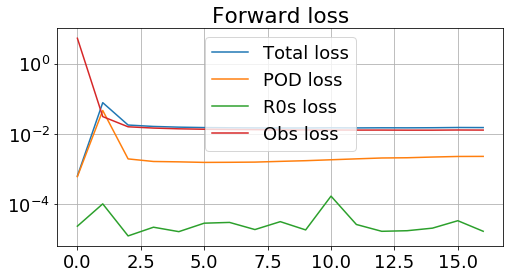

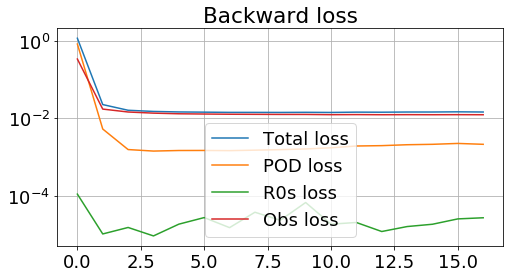

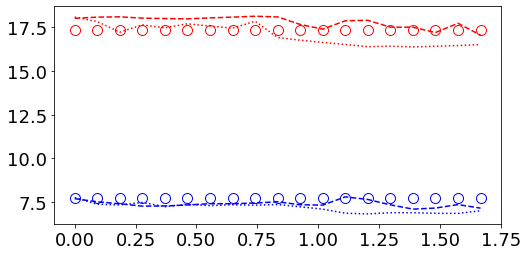

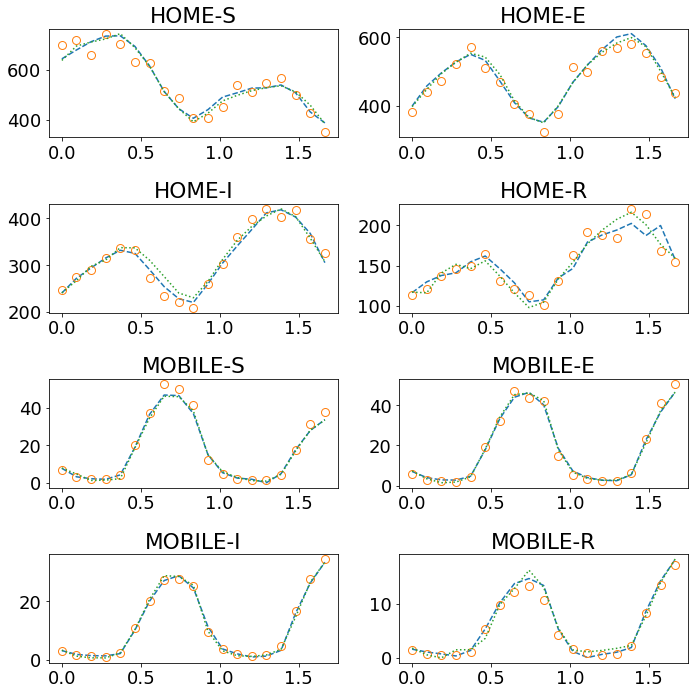

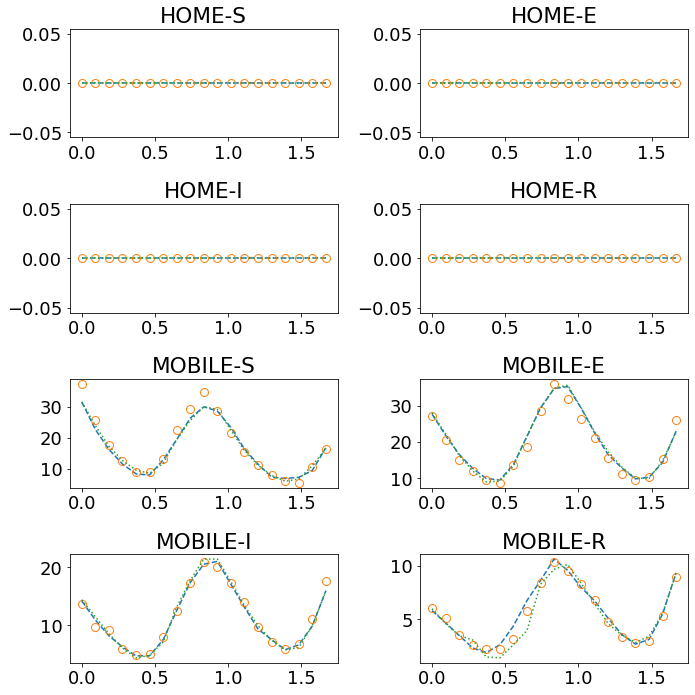

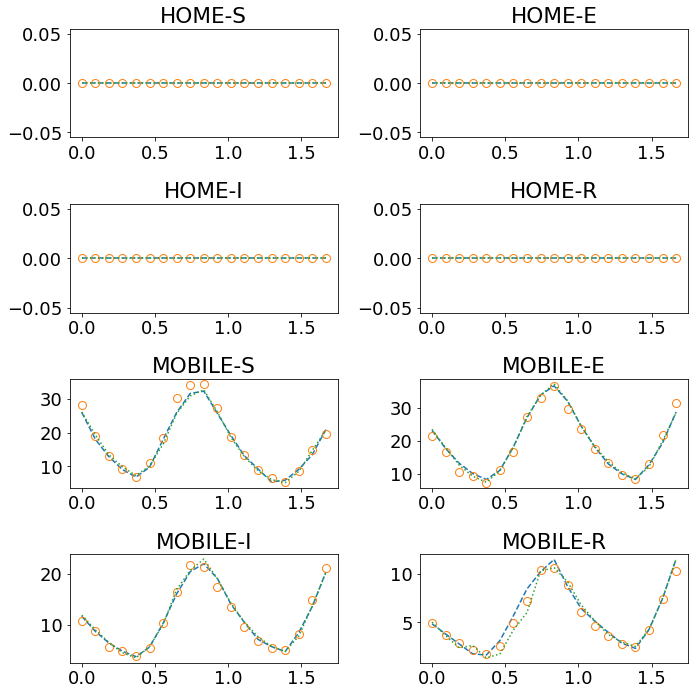

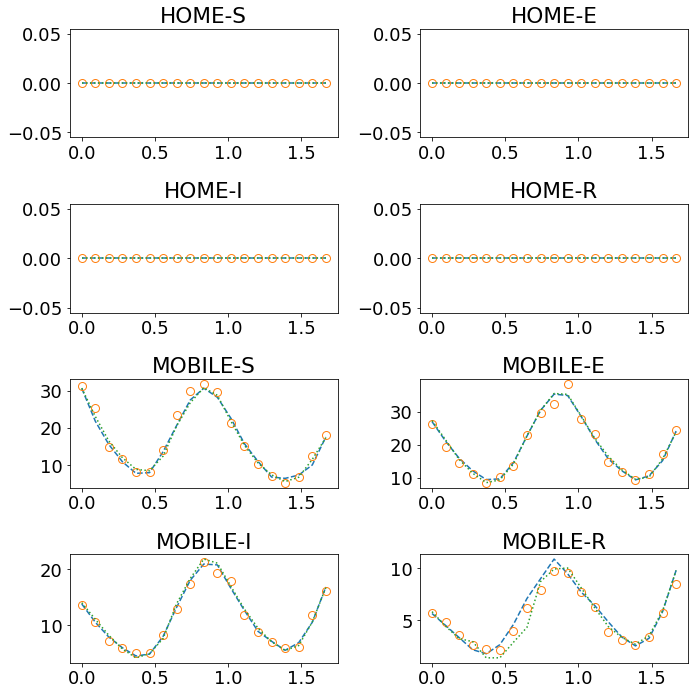

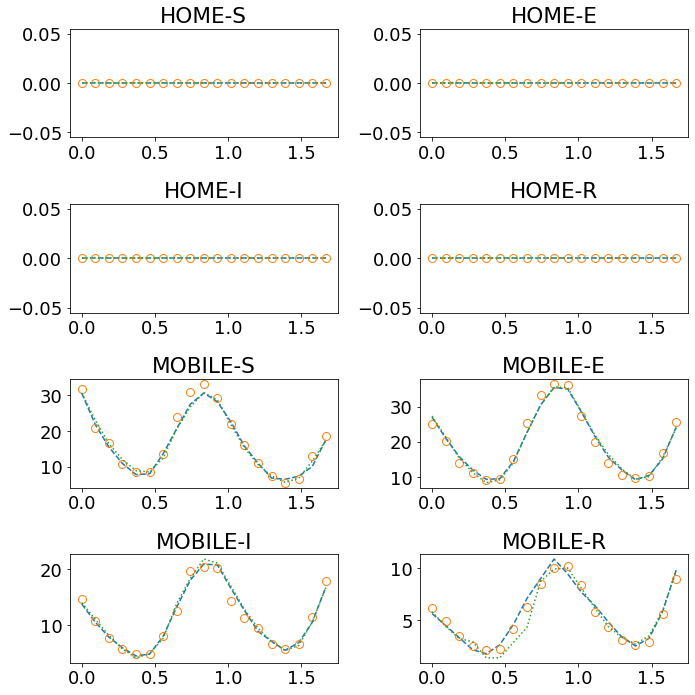


Iteration 17: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.35e-03', '2.44e-05', '1.43e-02']
Loss iteration 1: ['1.41e-02', '1.87e-03', '4.54e-06', '1.23e-02'] - 1s
Loss iteration 2: ['1.36e-02', '1.50e-03', '8.78e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.75e-03', '1.01e-05', '1.05e-02'] - 1s
Loss iteration 4: ['1.64e-02', '1.85e-03', '4.26e-06', '1.46e-02'] - 4s
Loss iteration 5: ['1.91e-02', '2.98e-03', '1.42e-05', '1.61e-02'] - 4s
Loss iteration 6: ['1.39e-02', '1.47e-03', '2.04e-05', '1.24e-02'] - 1s
Loss iteration 7: ['1.46e-02', '2.47e-03', '2.39e-05', '1.21e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.39e-03', '8.32e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.26e-02', '2.26e-03', '9.94e-05', '1.02e-02'] - 4s
Loss iteration mean: ['1.48e-02', '2.19e-03', '2.18e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.26e-02', '1.92e-03', '1.16e-04', '1.06e-02']
Loss iteration 1: ['1.40e-02', '2.29e-03', '2.71e-05', '1.17e-02'] - 1s

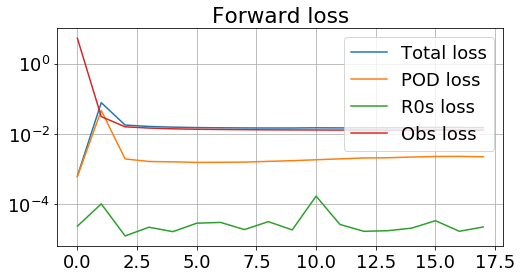

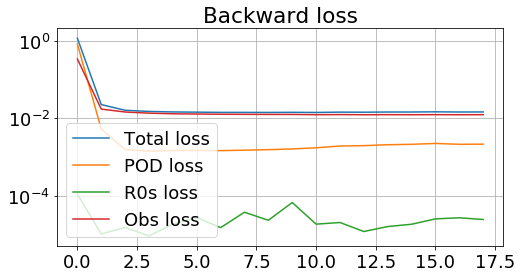

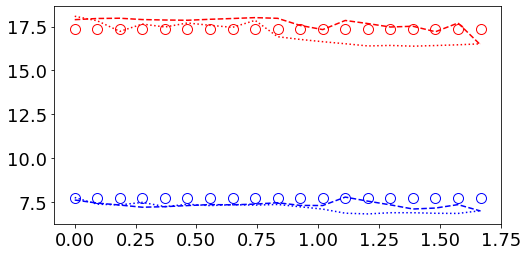

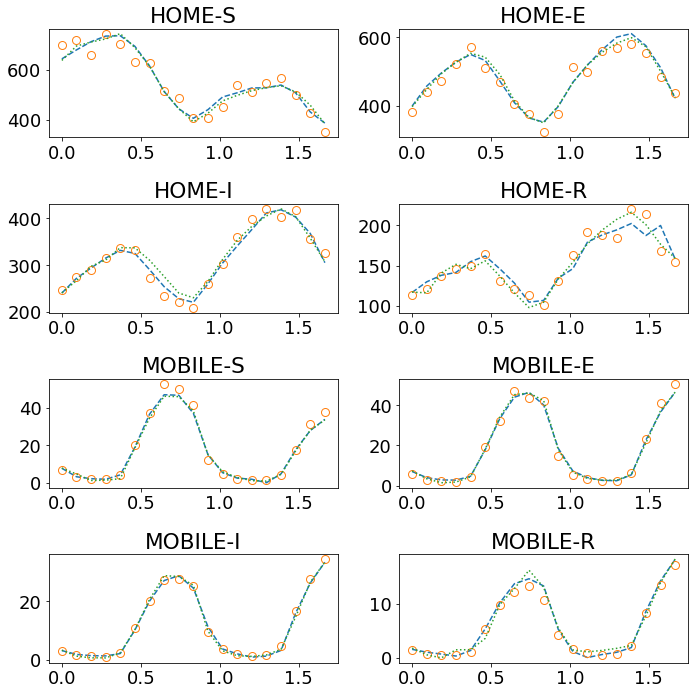

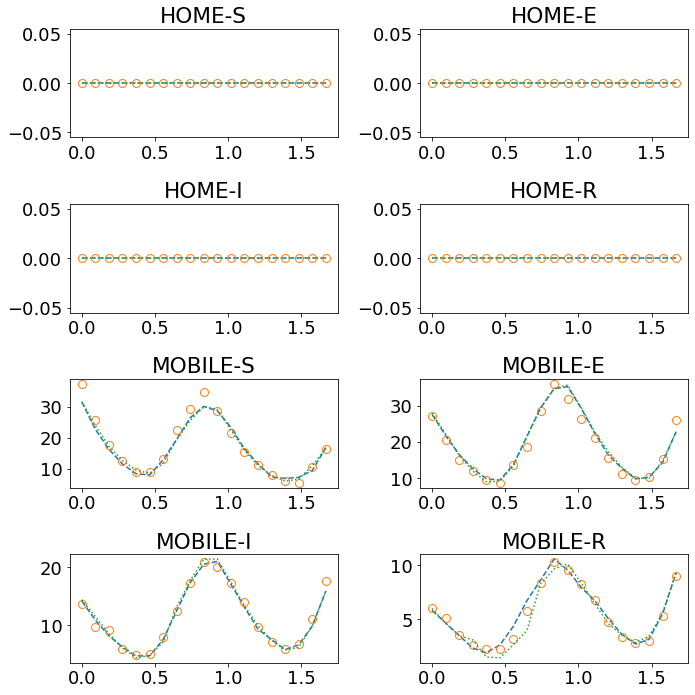

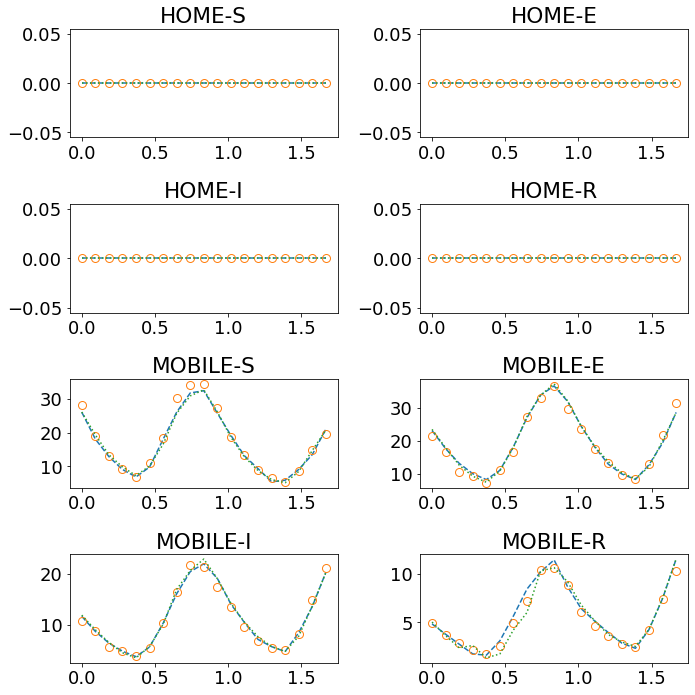

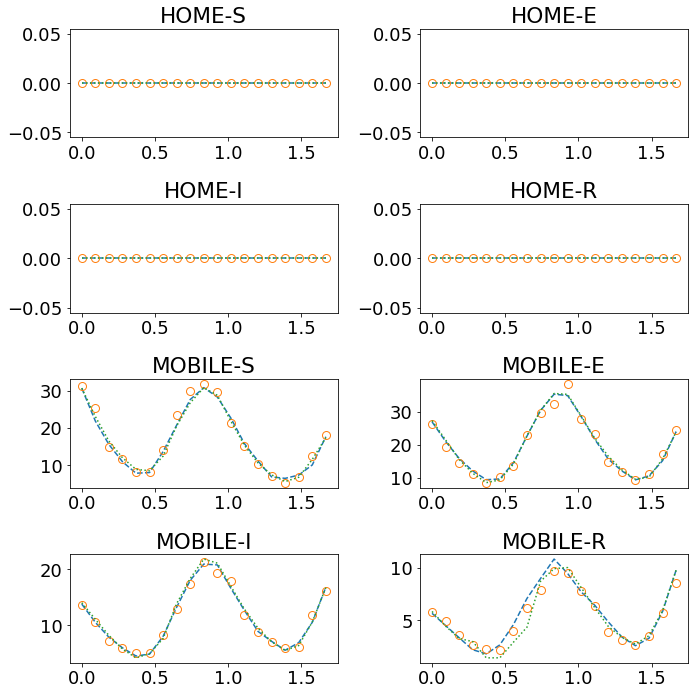

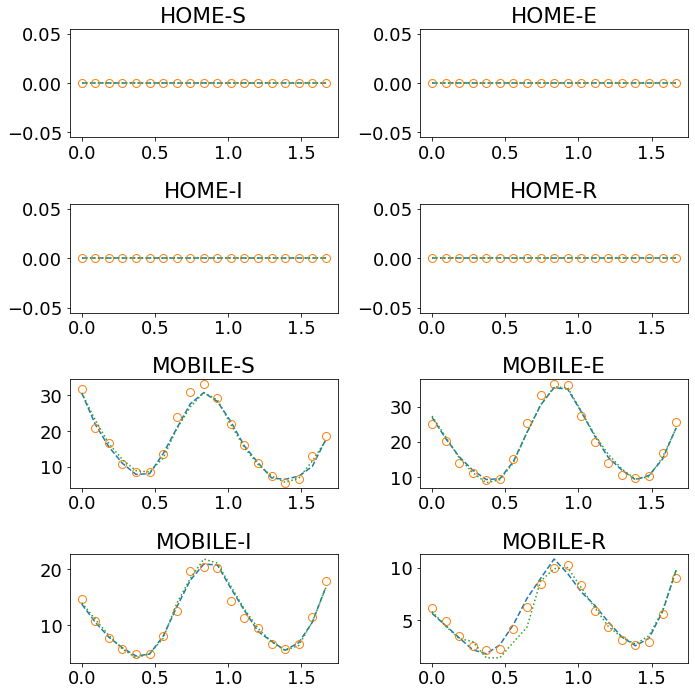


Iteration 18: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.35e-03', '2.37e-05', '1.43e-02']
Loss iteration 1: ['1.39e-02', '1.87e-03', '1.59e-05', '1.21e-02'] - 4s
Loss iteration 2: ['1.36e-02', '1.50e-03', '7.35e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.75e-03', '1.01e-05', '1.05e-02'] - 1s
Loss iteration 4: ['1.67e-02', '1.91e-03', '1.45e-05', '1.48e-02'] - 1s
Loss iteration 5: ['1.90e-02', '2.98e-03', '1.37e-05', '1.61e-02'] - 4s
Loss iteration 6: ['1.36e-02', '1.38e-03', '1.19e-05', '1.22e-02'] - 4s
Loss iteration 7: ['1.45e-02', '2.47e-03', '2.14e-05', '1.20e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.40e-03', '8.00e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.26e-02', '2.27e-03', '1.00e-04', '1.02e-02'] - 4s
Loss iteration mean: ['1.48e-02', '2.19e-03', '2.27e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.27e-02', '1.93e-03', '1.17e-04', '1.06e-02']
Loss iteration 1: ['1.34e-02', '2.16e-03', '2.01e-05', '1.12e-02'] - 4s

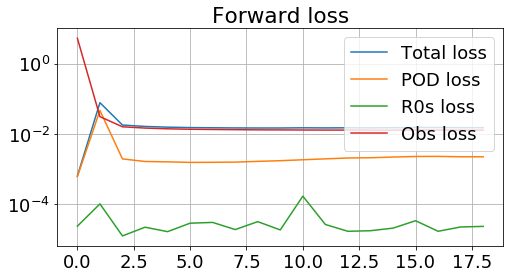

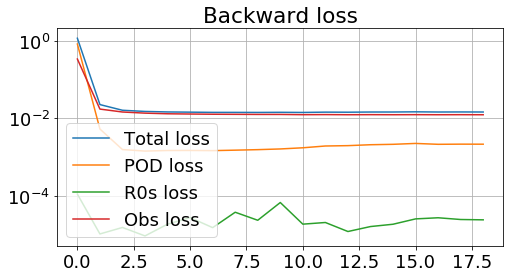

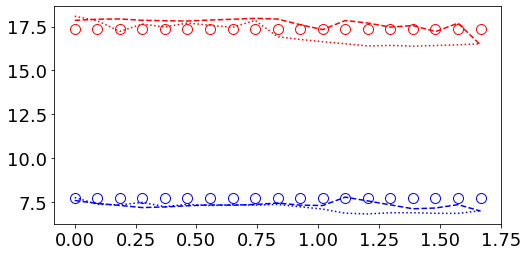

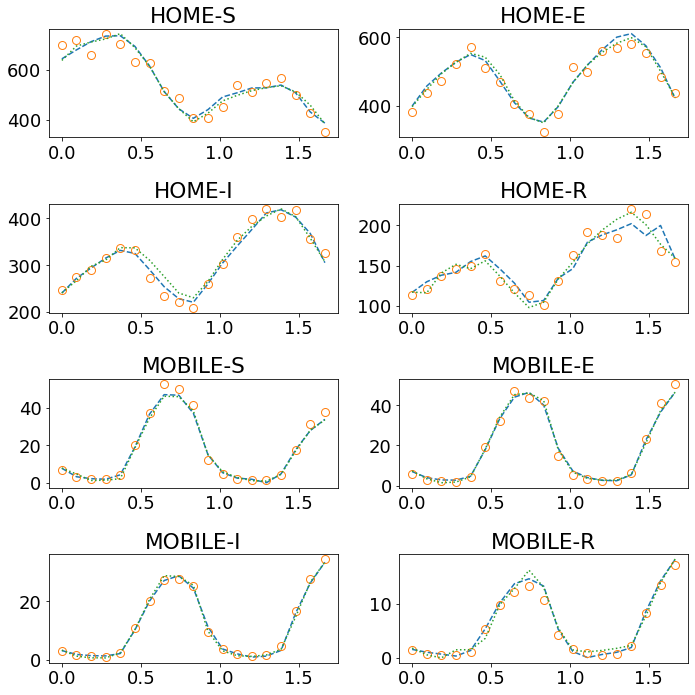

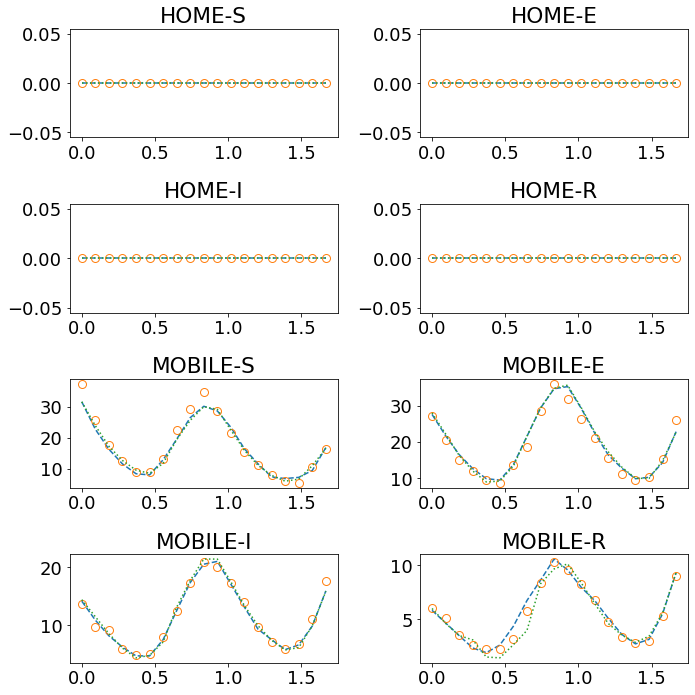

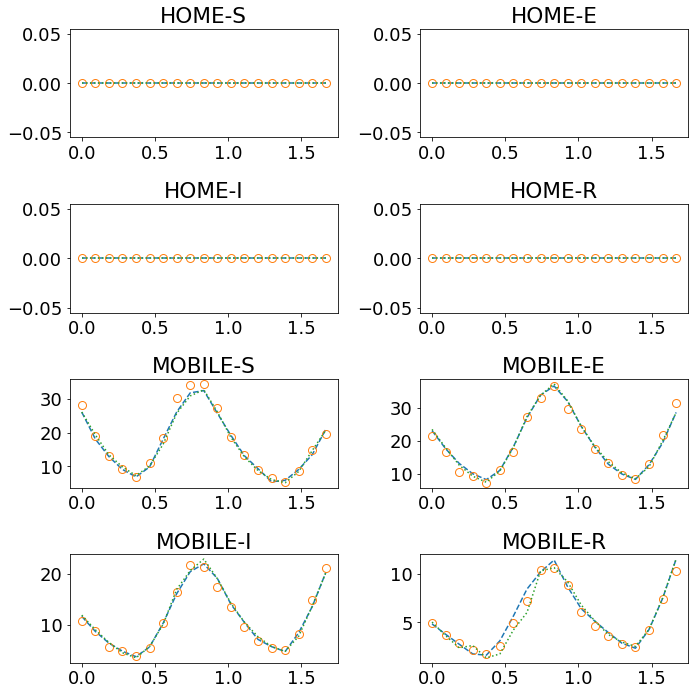

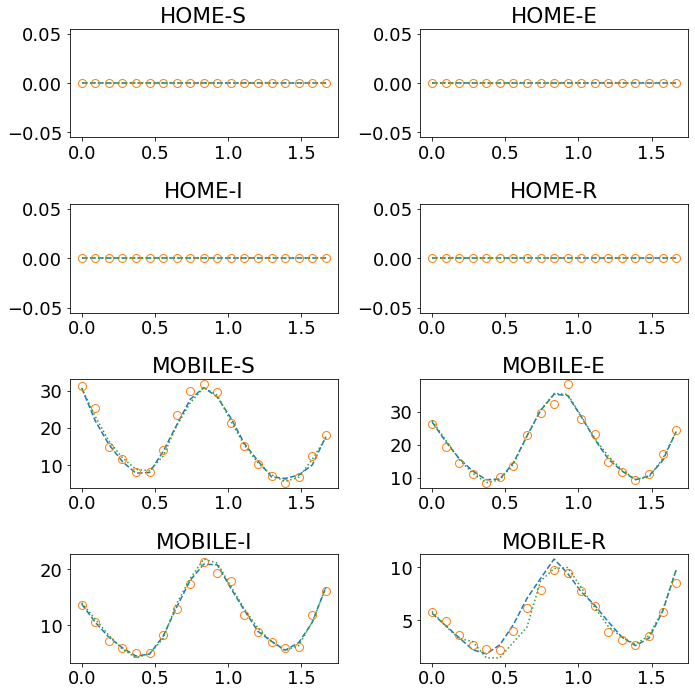

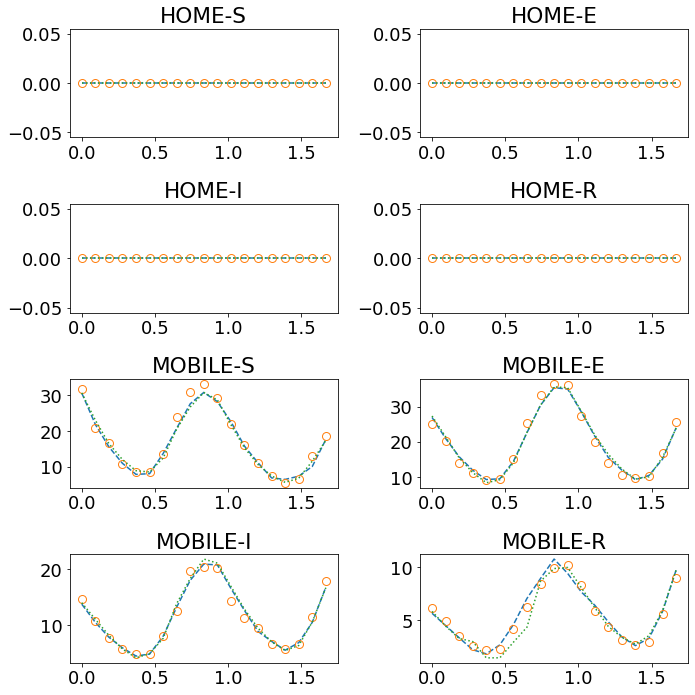


Iteration 19: forward and backward
-- Forward March --
Loss iteration 0: ['1.66e-02', '2.33e-03', '1.32e-05', '1.42e-02']
Loss iteration 1: ['1.39e-02', '1.87e-03', '1.51e-05', '1.21e-02'] - 4s
Loss iteration 2: ['1.36e-02', '1.50e-03', '7.80e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.76e-03', '9.69e-06', '1.05e-02'] - 1s
Loss iteration 4: ['1.64e-02', '1.85e-03', '3.88e-06', '1.46e-02'] - 4s
Loss iteration 5: ['1.90e-02', '3.00e-03', '1.38e-05', '1.60e-02'] - 4s
Loss iteration 6: ['1.36e-02', '1.38e-03', '1.17e-05', '1.23e-02'] - 4s
Loss iteration 7: ['1.45e-02', '2.47e-03', '2.07e-05', '1.20e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.40e-03', '7.78e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.25e-02', '2.26e-03', '9.95e-05', '1.02e-02'] - 4s
Loss iteration mean: ['1.48e-02', '2.18e-03', '2.03e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.27e-02', '1.97e-03', '8.77e-05', '1.07e-02']
Loss iteration 1: ['1.39e-02', '2.27e-03', '2.48e-05', '1.16e-02'] - 1s

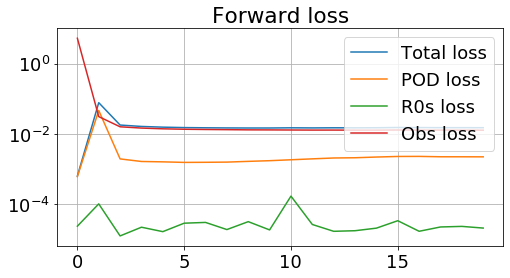

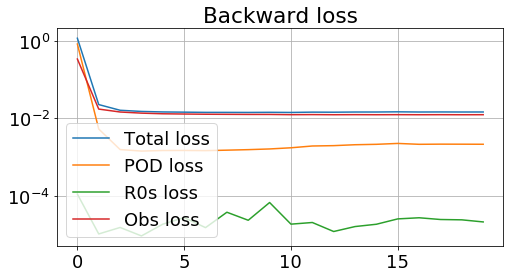

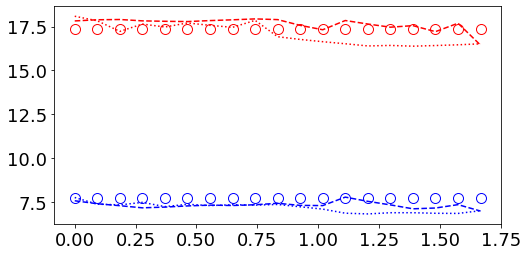

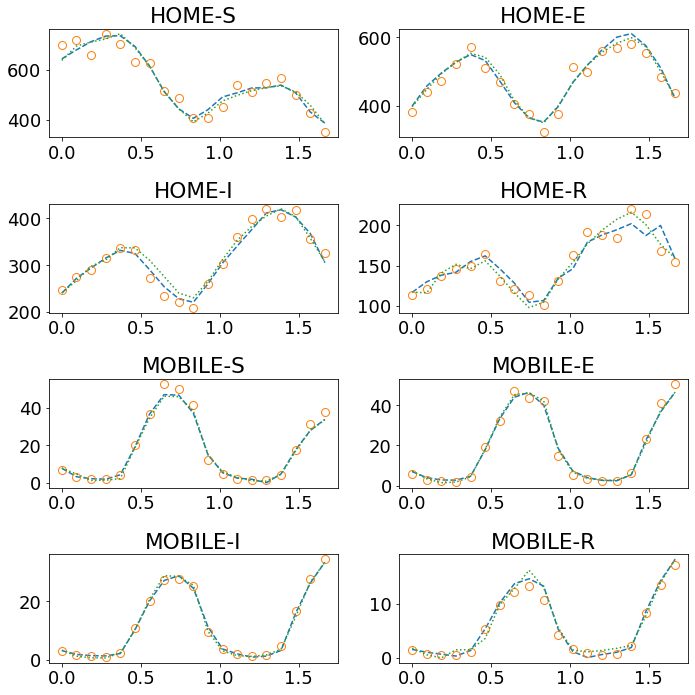

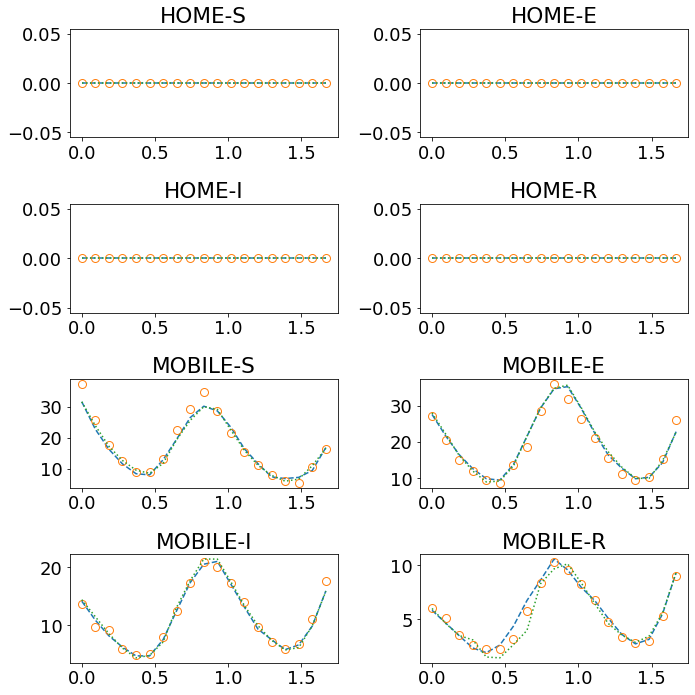

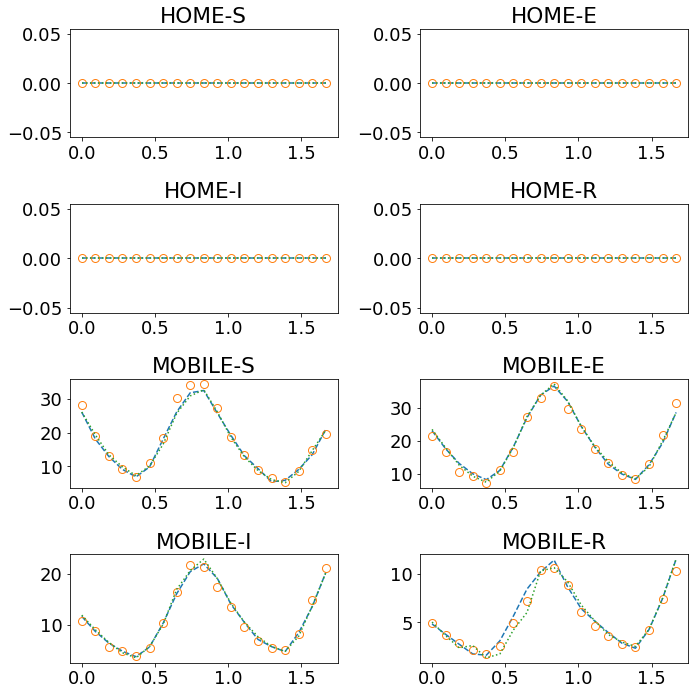

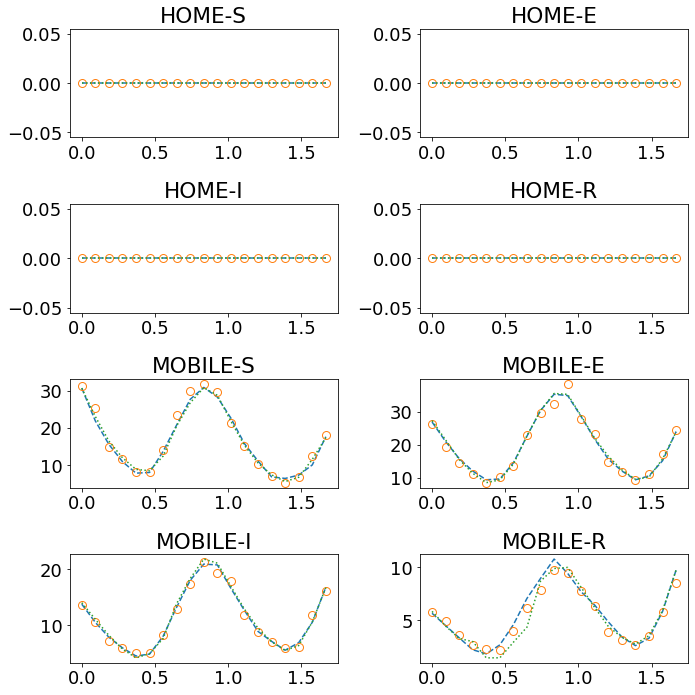

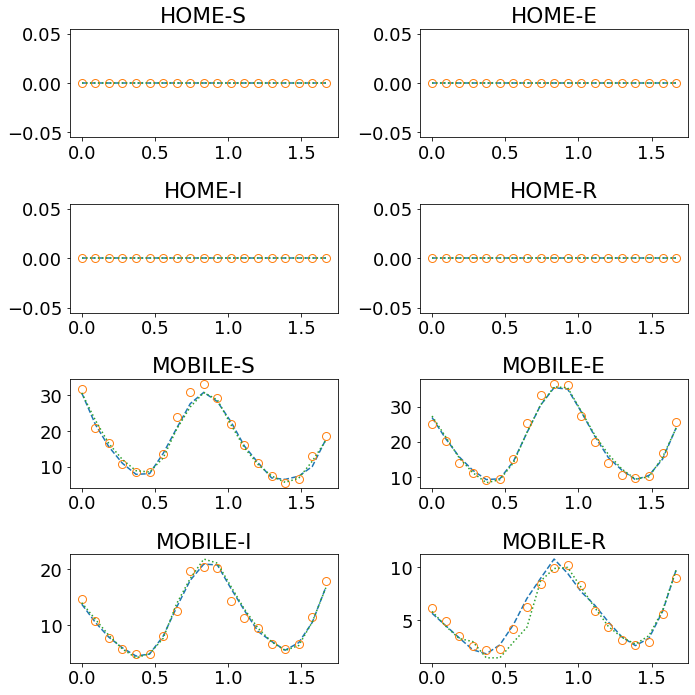


Iteration 20: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.35e-03', '2.36e-05', '1.43e-02']
Loss iteration 1: ['1.39e-02', '1.87e-03', '1.52e-05', '1.21e-02'] - 3s
Loss iteration 2: ['1.36e-02', '1.50e-03', '8.19e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.76e-03', '9.73e-06', '1.05e-02'] - 1s
Loss iteration 4: ['1.67e-02', '1.92e-03', '1.50e-05', '1.48e-02'] - 1s
Loss iteration 5: ['1.90e-02', '2.99e-03', '1.37e-05', '1.60e-02'] - 4s
Loss iteration 6: ['1.36e-02', '1.38e-03', '1.17e-05', '1.23e-02'] - 4s
Loss iteration 7: ['1.45e-02', '2.47e-03', '1.93e-05', '1.21e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.40e-03', '7.86e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.30e-02', '2.54e-03', '7.76e-06', '1.04e-02'] - 1s
Loss iteration mean: ['1.48e-02', '2.22e-03', '1.32e-05', '1.26e-02']
-- Backward March --
Loss iteration 0: ['1.26e-02', '1.93e-03', '1.14e-04', '1.06e-02']
Loss iteration 1: ['1.34e-02', '2.15e-03', '2.01e-05', '1.12e-02'] - 4s

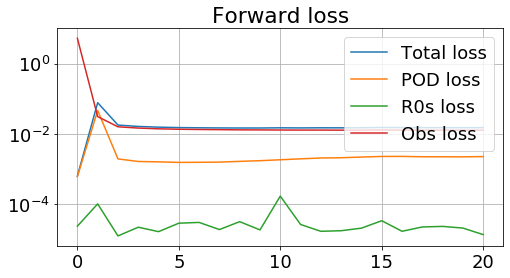

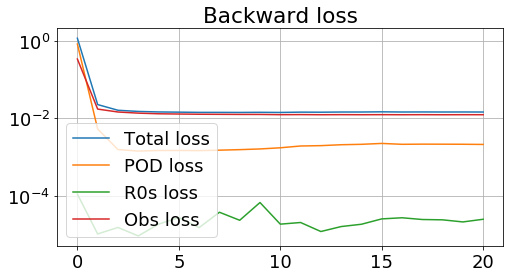

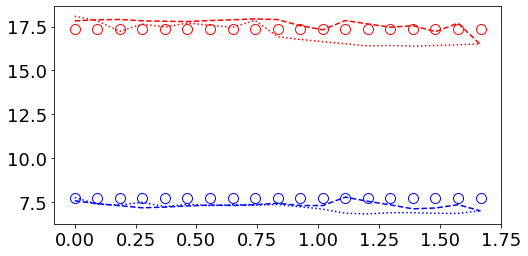

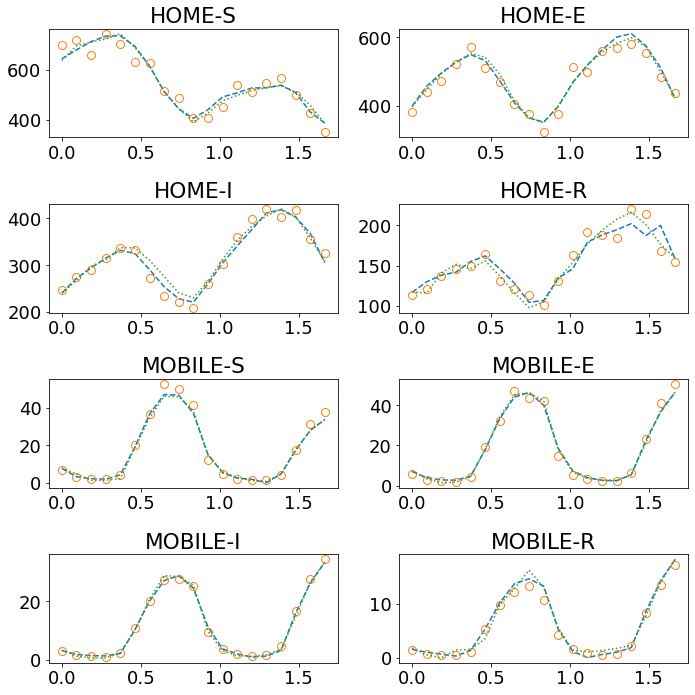

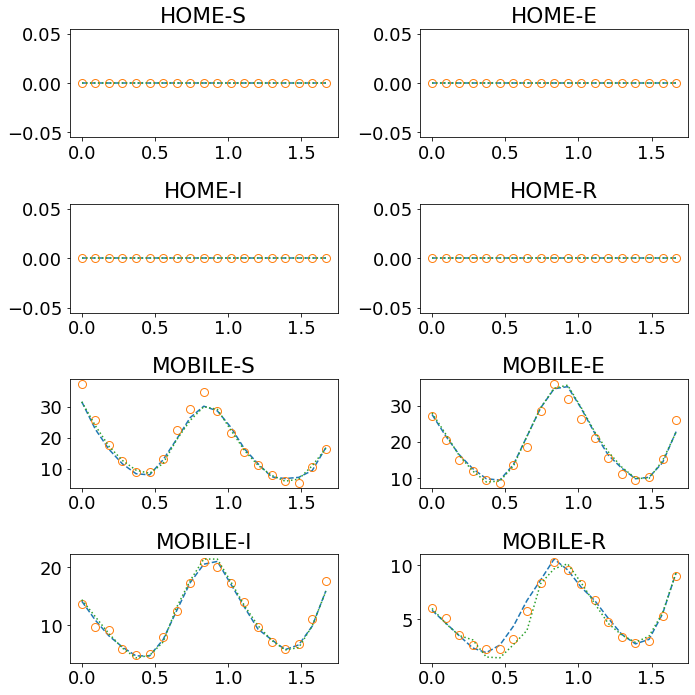

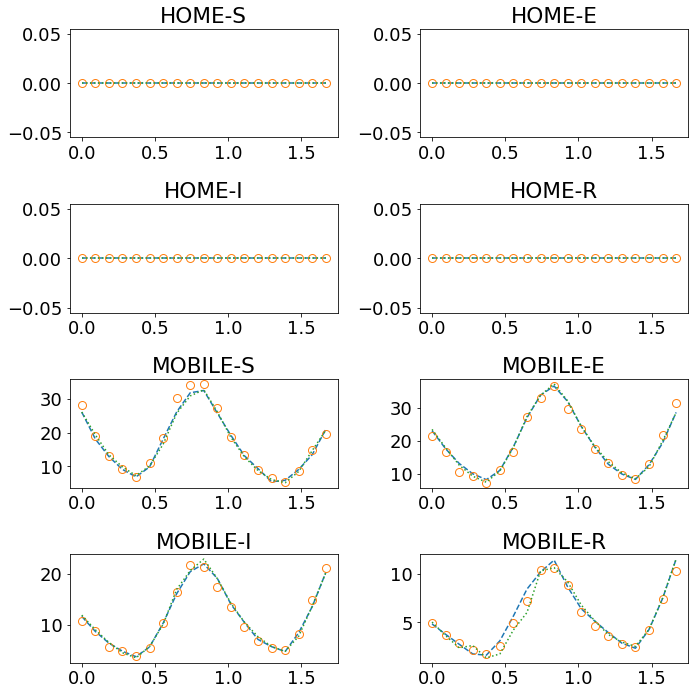

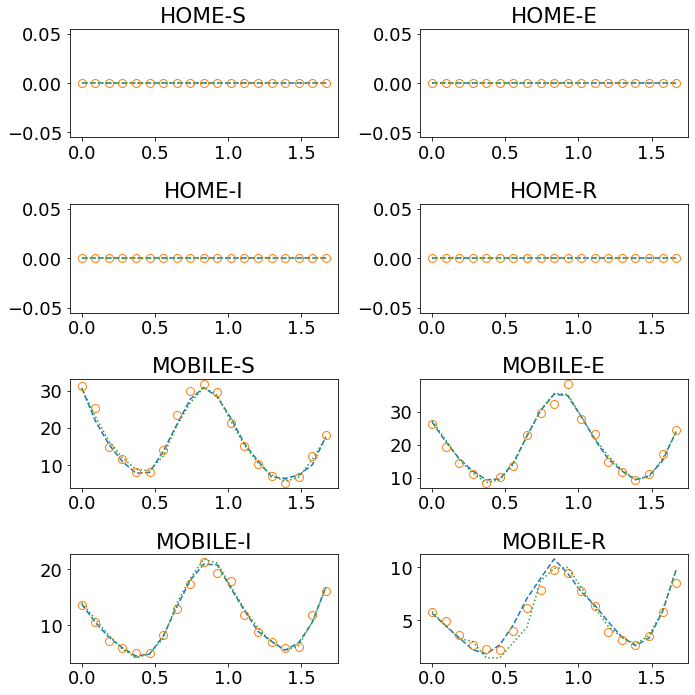

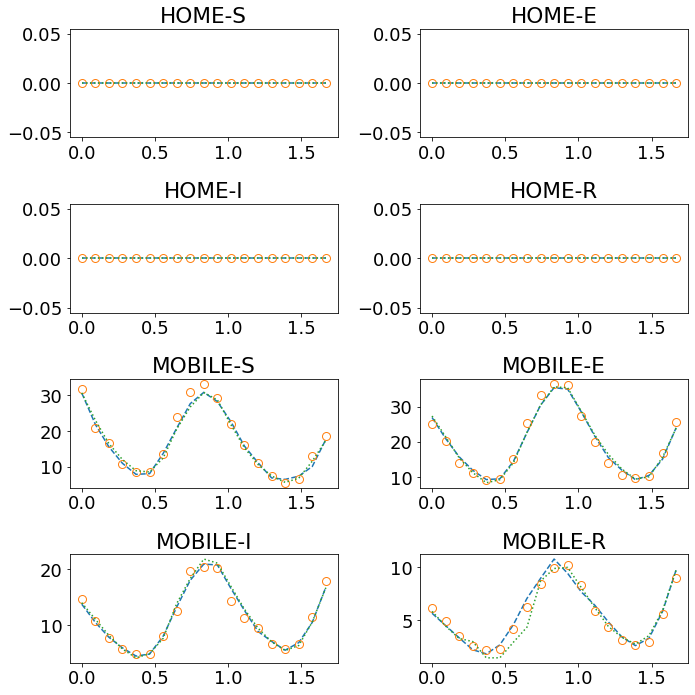


Iteration 21: forward and backward
-- Forward March --
Loss iteration 0: ['1.67e-02', '2.35e-03', '2.37e-05', '1.43e-02']
Loss iteration 1: ['1.39e-02', '1.87e-03', '1.51e-05', '1.21e-02'] - 4s
Loss iteration 2: ['1.36e-02', '1.49e-03', '8.37e-06', '1.21e-02'] - 1s
Loss iteration 3: ['1.33e-02', '2.76e-03', '9.73e-06', '1.05e-02'] - 1s
Loss iteration 4: ['1.67e-02', '1.92e-03', '1.51e-05', '1.48e-02'] - 1s
Loss iteration 5: ['1.93e-02', '2.97e-03', '1.11e-05', '1.63e-02'] - 3s
Loss iteration 6: ['1.39e-02', '1.47e-03', '1.74e-05', '1.24e-02'] - 1s
Loss iteration 7: ['1.45e-02', '2.47e-03', '2.05e-05', '1.21e-02'] - 1s
Loss iteration 8: ['1.40e-02', '2.40e-03', '7.85e-06', '1.16e-02'] - 4s
Loss iteration 9: ['1.29e-02', '2.54e-03', '7.73e-06', '1.04e-02'] - 1s
Loss iteration mean: ['1.49e-02', '2.22e-03', '1.36e-05', '1.27e-02']
-- Backward March --
Loss iteration 0: ['1.27e-02', '1.97e-03', '8.48e-05', '1.07e-02']
Loss iteration 1: ['1.34e-02', '2.15e-03', '2.01e-05', '1.12e-02'] - 4s

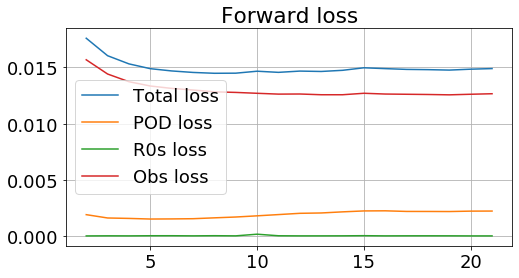

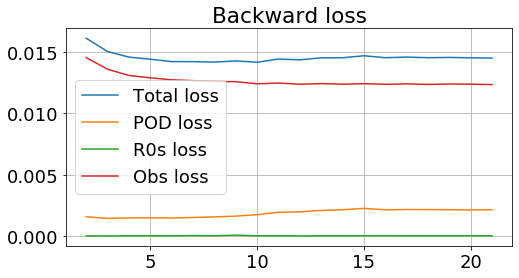

In [18]:
np.random.seed(0)
tf.random.set_seed(0)

# Variables for debugging and plotting
#list_latent_values_forward = []
#list_latent_values_backward = []
#list_obs_data_forward = []
#list_obs_data_backward = []
#list_points_inrange_forward = []
#list_points_inrange_backward = []
list_X_predict_forward = []
list_X_predict_backward = []
list_relax = []

# Forward and backward march   
forward_loss = []
backward_loss = []
forward_noObs_loss = []
relax = 1.0
for j in range(100):    
    print(f'\nIteration {j}: forward and backward')
    latent_values_forward = []
    latent_values_backward = []
    
    #===========================================
    # Forward march 
    #===========================================
    print('-- Forward March --')
    
    march_range = np.arange(0,(ntimes-1))
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
    loss_iteration = []
    
    if j == 0: # If the first forward march
        # For the first forward march
        weight_R0.assign(weight_R0_p)
        real_coding = X_test_concat[n]
        real_coding = real_coding[:-1,:]
        R0s_run = real_coding[0,-2:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        
        list_latent_values = []
        list_loss = []
        for _ in range(10):
            latent_values = tf.random.normal([1, latent_size], mean=0.0, stddev=0.01)  
            latent_values = tf.Variable(latent_values) 
            latent_values, loss = optimize_coding_forward_noObs(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
            list_latent_values.append(latent_values)
            list_loss.append(loss)
        latent_values = list_latent_values[np.argmin(list_loss,axis=0)[0]]
        loss_iteration.append(list(map(float,list_loss[np.argmin(list_loss,axis=0)[0]])))
        print('Initial point losses: ', end='\n')
        for l in list_loss:
            print(['{0:1.2e}'.format(float(x)) for x in l])
        print()
        print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in list_loss[np.argmin(list_loss,axis=0)[0]]]), end='\n')        

        latent_values_forward.append(latent_values.value())
        X_predict_forward = list(generator(latent_values).numpy().reshape(-1,codings_size))
        gen_predict = X_predict_forward[-1]
        gen_predict[-2:] = R0s_run  
    
    else: # If not the first forward march
        real_coding = X_predict_backward[0:(ntimes-1),:].copy()
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)  
        
        latent_values, loss = optimize_coding_forward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        if j != 0:
            latent_values = tf.Variable((1-relax)*latent_values_forward_old[0] + relax*latent_values.value())
        loss_iteration.append(list(map(float,loss)))
        print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')
    
        latent_values_forward.append(latent_values.value())
        X_predict_forward = list(generator(latent_values).numpy().reshape(-1,codings_size))
        gen_predict = X_predict_forward[-1]

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    
    for i in range(1, forward_steps): 
        march_range = np.arange(i,(ntimes-1)+i)
        obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
        
        start = time.time()
        if j == 0:    
            latent_values, loss = optimize_coding_forward_noObs(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        
            loss_iteration.append(list(map(float,loss)))
            print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

            latent_values_forward.append(latent_values.value())
            gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[-1]
            X_predict_forward.append(gen_predict.copy())
            gen_predict[-2:] = R0s_run       
        
        else:
            latent_values, loss = optimize_coding_forward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
            latent_values = tf.Variable((1-relax)*latent_values_forward_old[i] + relax*latent_values.value())
        
            loss_iteration.append(list(map(float,loss)))
            print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

            latent_values_forward.append(latent_values.value())
            gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[-1]
            X_predict_forward.append(gen_predict.copy())

        real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
    X_predict_forward = np.array(X_predict_forward)
    if j == 0:
        X_predict_forward_first = X_predict_forward
        weight_R0.assign(weight_R0_da)
    forward_loss.append(np.array(loss_iteration).mean(axis=0))
    print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])
    
    # Only for debugging
    #list_obs_data_forward.append(obs_data.numpy().copy()) 
    #list_points_inrange_forward.append(obs_points_inrange.numpy().copy())
    #list_latent_values_forward.append(latent_values.numpy().copy()) 
    

    #===========================================
    # Backward march
    #===========================================
    print('-- Backward March --')
    
    march_range = np.arange(time_steps-(ntimes-1),time_steps)
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)    
    loss_iteration = []
    
    real_coding = X_predict_forward[time_steps-(ntimes-1):time_steps,:].copy()
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)  
    
    latent_values, loss = optimize_coding_backward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
    if j != 0:
        latent_values = tf.Variable((1-relax)*latent_values_backward_old[0] + relax*latent_values.value())
    loss_iteration.append(list(map(float,loss)))
    print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')

    latent_values_backward.append(latent_values.value())
    X_predict_backward = deque(generator(latent_values).numpy().reshape(-1,codings_size))
    gen_predict = X_predict_backward[0]

    real_coding = np.concatenate((gen_predict.reshape(1,-1), real_coding), axis=0)[:-1,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    
    for i in range(1, forward_steps): 
        march_range = np.arange(time_steps-(ntimes-1)-i,time_steps-i)
        obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)        
        
        start = time.time()
        latent_values, loss = optimize_coding_backward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        if j != 0:
            latent_values = tf.Variable((1-relax)*latent_values_backward_old[i] + relax*latent_values.value())
        loss_iteration.append(list(map(float,loss)))
        print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

        latent_values_backward.append(latent_values.value())
        gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[0]
        X_predict_backward.appendleft(gen_predict.copy())

        real_coding = np.concatenate((gen_predict.reshape(1,-1), real_coding), axis=0)[:-1,:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
    X_predict_backward = np.array(X_predict_backward)
    backward_loss.append(np.array(loss_iteration).mean(axis=0))
    print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])
    
    #===========================================
    # Update the R0 weights
    #===========================================
    if j<100:
        weight_R0.assign(weight_R0*1.2)
    print('weight_R0: ', weight_R0)

    
    #===========================================
    # Update Relaxation
    #===========================================
    # Save relaxation
    list_relax.append(relax)
    
    # Calculate relaxation
    epison = 0
    loss_obs = (forward_loss[-1][-1] + backward_loss[-1][-1])/2 
    print(f'Loss obs: {loss_obs}')
    if j == 0:
        loss_obs_old = loss_obs        
        latent_values_forward_old = latent_values_forward.copy()
        latent_values_backward_old = latent_values_backward.copy()
        X_predict_backward_old = X_predict_backward.copy()
        weight_R0_old = tf.identity(weight_R0)
    else:
        print(f'Loss obs old: {loss_obs_old}')
        print(f'Relax old: {relax}, new ', end='')
        if (loss_obs - loss_obs_old) < epison:
            loss_obs_old = loss_obs
            X_predict_backward_old = X_predict_backward.copy()
            latent_values_forward_old = latent_values_forward.copy()
            latent_values_backward_old = latent_values_backward.copy()
            weight_R0_old = tf.identity(weight_R0)
            relax *= 1.5
            if relax > 1.0: 
                relax = 1.0              
        else:
            relax *= 0.5
            if relax < 0.01: 
                print(relax)
                print('Converged!')
                # plot loss functions
                fig, ax = plt.subplots(1,1, figsize=[8,4])
                ax.plot(np.arange(2,len(forward_loss)), forward_loss[2:])
                ax.set_title('Forward loss')
                plt.grid()
                plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])    
                fig, ax = plt.subplots(1,1, figsize=[8,4])
                ax.plot(np.arange(2,len(backward_loss)), backward_loss[2:])
                ax.set_title('Backward loss')
                plt.grid()
                plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])
                break
            X_predict_backward = X_predict_backward_old
            latent_values_forward = latent_values_forward_old
            latent_values_backward = latent_values_backward_old
            weight_R0.assign(weight_R0_old)
        print(relax)
        
            
    # Only for debugging
    #list_obs_data_backward.append(obs_data.numpy().copy()) 
    #list_points_inrange_backward.append(obs_points_inrange.numpy().copy())
    #list_latent_values_backward.append(latent_values.numpy().copy())  
    
    
    list_X_predict_forward.append(X_predict_forward)
    list_X_predict_backward.append(X_predict_backward)
    
    #===========================================
    # Plots
    #===========================================  
    # plot loss function
    fig, ax = plt.subplots(1,1, figsize=[8,4])
    ax.plot(forward_loss)
    ax.set_title('Forward loss')
    ax.set_yscale('log')
    plt.grid()
    plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])    
    fig, ax = plt.subplots(1,1, figsize=[8,4])
    ax.plot(backward_loss)
    ax.set_yscale('log')
    ax.set_title('Backward loss')
    plt.grid()
    plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])
    
    # Plot forward and backward march   
    mpl.rcParams.update({'font.size': 18})
    mpl.rc('xtick', labelsize=18) 
    mpl.rc('ytick', labelsize=18) 
    mpl.rc('axes', labelsize=18)
    
    fig, R0_ax = plt.subplots(1,1, figsize=[8,4])
    fig, X_ax = plt.subplots(4,2, figsize=[10,10])
    plot_data(X_predict_forward, 0, 4, obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax=R0_ax, X_ax=X_ax, label='', mark='--')
    plot_data(X_predict_backward, 0, 4, R0_ax=R0_ax, X_ax=X_ax, label='', mark=':')
    
    fig, X_ax1 = plt.subplots(4,2, figsize=[10,10])
    plot_data(X_predict_forward, 9, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax1, label='', mark='--')
    plot_data(X_predict_backward, 9, 4, X_ax=X_ax1, label='', mark=':')

    fig, X_ax2 = plt.subplots(4,2, figsize=[10,10])
    plot_data(X_predict_forward, 4, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax2, label='', mark='--')
    plot_data(X_predict_backward, 4, 4, X_ax=X_ax2, label='', mark=':')

    fig, X_ax3 = plt.subplots(4,2, figsize=[10,10])
    plot_data(X_predict_forward, 4, 0, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax3, label='', mark='--')
    plot_data(X_predict_backward, 4, 0, X_ax=X_ax3, label='', mark=':')

    fig, X_ax4 = plt.subplots(4,2, figsize=[10,10])
    plot_data(X_predict_forward, 4, 9, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax4, label='', mark='--')
    plot_data(X_predict_backward, 4, 9, X_ax=X_ax4, label='', mark=':')        
    plt.show()     

-- Last time Stepping Forward March --
Loss iteration 0: ['1.87e-03', '1.83e-03', '4.22e-05', '1.57e-02']
Loss iteration 1: ['1.80e-03', '1.75e-03', '4.77e-05', '1.27e-02'] - 1s
Loss iteration 2: ['1.48e-03', '1.41e-03', '7.01e-05', '1.25e-02'] - 4s
Loss iteration 3: ['2.75e-03', '2.67e-03', '7.80e-05', '1.08e-02'] - 1s
Loss iteration 4: ['1.37e-03', '1.31e-03', '5.51e-05', '1.63e-02'] - 3s
Loss iteration 5: ['2.26e-03', '2.21e-03', '4.42e-05', '1.87e-02'] - 4s
Loss iteration 6: ['1.28e-03', '1.21e-03', '7.56e-05', '1.31e-02'] - 2s
Loss iteration 7: ['1.97e-03', '1.92e-03', '5.04e-05', '1.47e-02'] - 3s
Loss iteration 8: ['1.64e-03', '1.60e-03', '4.89e-05', '1.43e-02'] - 3s
Loss iteration 9: ['2.02e-03', '2.00e-03', '1.94e-05', '1.46e-02'] - 1s
Loss iteration mean: ['1.84e-03', '1.79e-03', '5.31e-05', '1.44e-02']


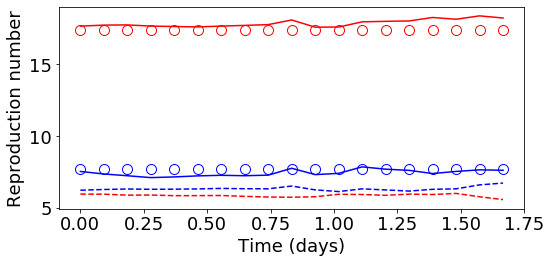

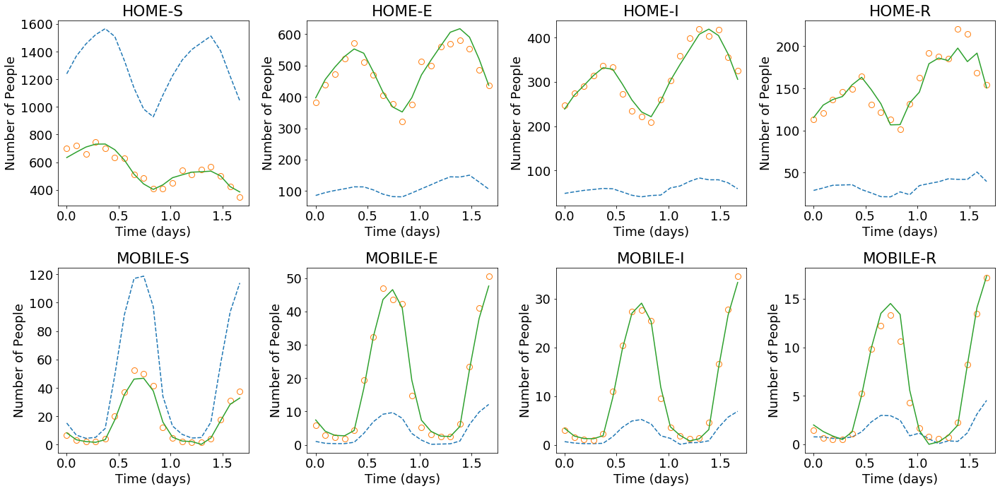

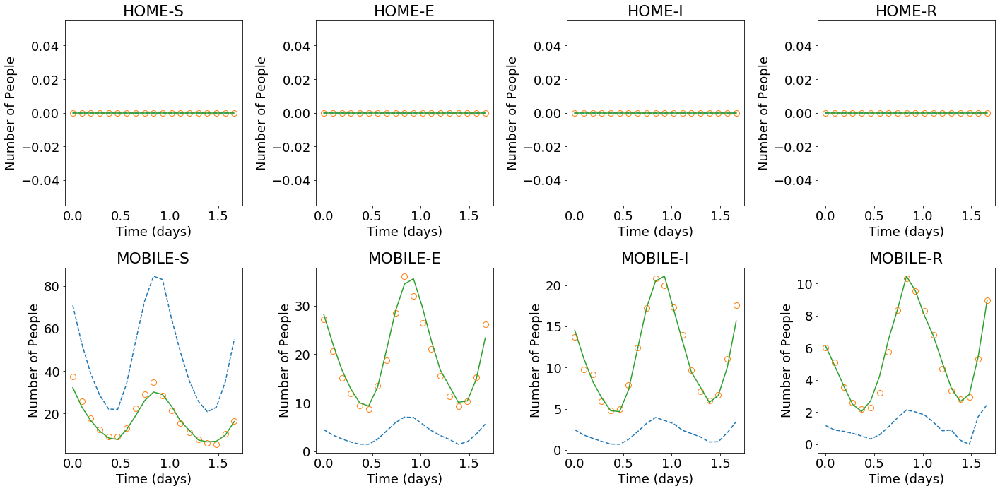

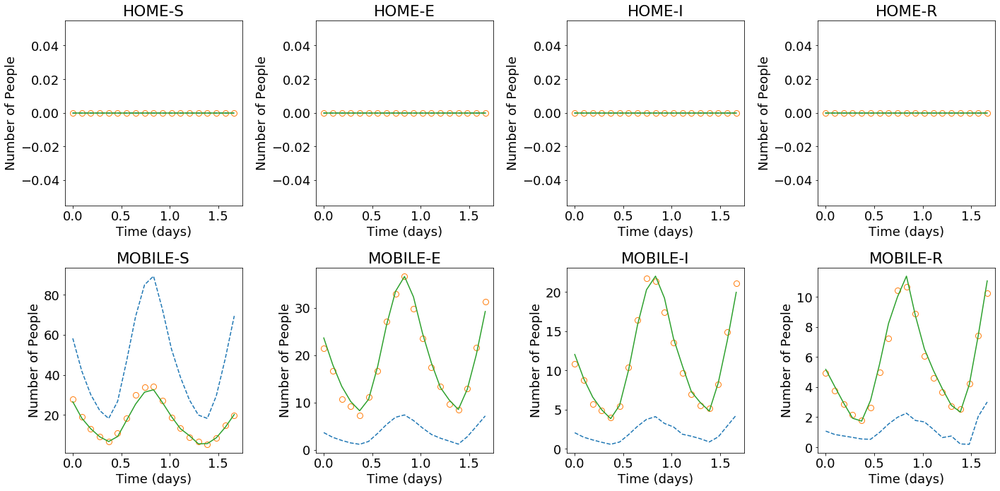

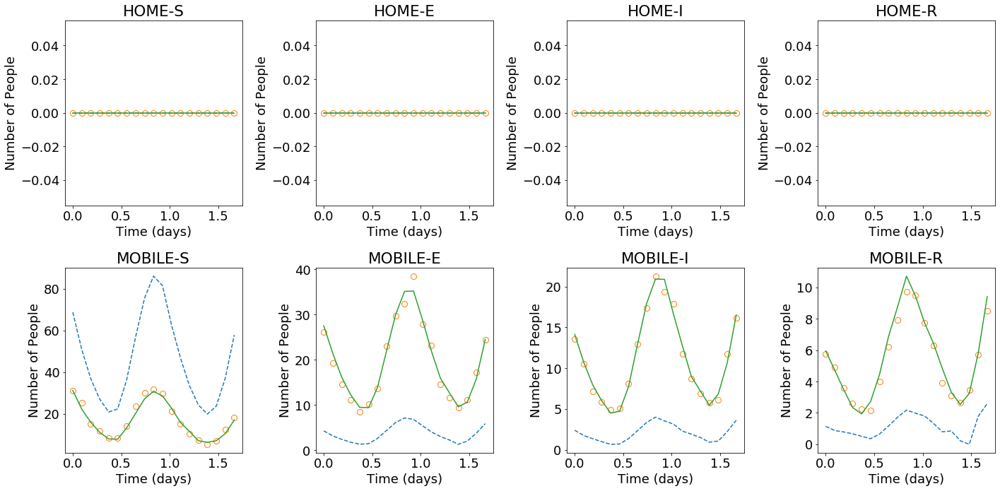

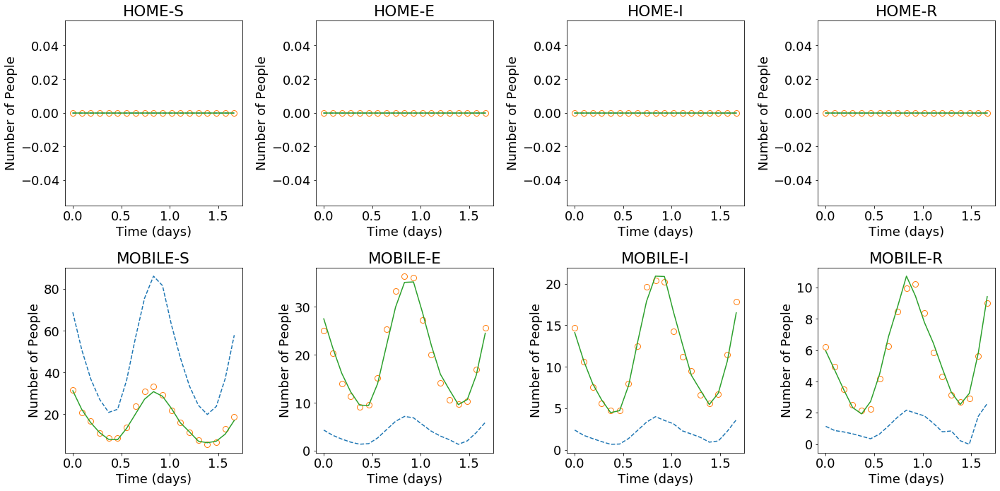

In [19]:
#===========================================
# Last time stepping forward march
#===========================================
print('-- Last time Stepping Forward March --')

weight_R0.assign(weight_R0_p) 
march_range = np.arange(0,(ntimes-1))
obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
loss_iteration = []

real_coding = X_predict_backward[0:(ntimes-1),:].copy()
R0s_run = real_coding[0,-2:]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)  

latent_values_noObs = tf.Variable(latent_values)
latent_values_noObs, loss = optimize_coding_forward_noObs(latent_values_noObs, real_coding, obs_data, obs_points_inrange, epochs=1000)
loss_iteration.append(list(map(float,loss)))
print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')

X_predict_forward_last = list(generator(latent_values_noObs).numpy().reshape(-1,codings_size))
gen_predict = X_predict_forward_last[-1]
gen_predict[-2:] = R0s_run

real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)

for i in range(1, forward_steps): 
    march_range = np.arange(i,(ntimes-1)+i)
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)

    start = time.time()
    latent_values_noObs, loss = optimize_coding_forward_noObs(latent_values_noObs, real_coding, obs_data, obs_points_inrange, epochs=1000)
    loss_iteration.append(list(map(float,loss)))
    print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

    gen_predict = generator(latent_values_noObs).numpy().reshape(-1,codings_size)[-1]
    X_predict_forward_last.append(gen_predict.copy())
    gen_predict[-2:] = R0s_run

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    print ('{:.0f}s'.format( time.time()-start))
X_predict_forward_last = np.array(X_predict_forward_last)
forward_noObs_loss.append(np.array(loss_iteration).mean(axis=0))
print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])

# Plot forward and backward march   
mpl.rcParams.update({'font.size': 18})
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rc('axes', labelsize=18)

fig, R0_ax = plt.subplots(1,1, figsize=[8,4])
plot_data(X_predict_forward_first, 0, 4,  obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax=R0_ax, X_ax='', label='Initial', mark='--')
plot_data(X_predict_forward_last, 0, 4, R0_ax=R0_ax, X_ax='', label='Final', mark='-')

fig, X_ax = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 0, 4, obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax='', X_ax=X_ax, label='Initial', mark='--')
plot_data(X_predict_forward_last, 0, 4, R0_ax='', X_ax=X_ax, label='Final', mark='-')

fig, X_ax1 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 9, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax1, label='Initial', mark='--')
plot_data(X_predict_forward_last, 9, 4, X_ax=X_ax1, label='Final', mark='-')

fig, X_ax2 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax2, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 4, X_ax=X_ax2, label='Final', mark='-')

fig, X_ax3 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 0, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax3, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 0, X_ax=X_ax3, label='Final', mark='-')

fig, X_ax4 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 9, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax4, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 9, X_ax=X_ax4, label='Final', mark='-')        
plt.show() 

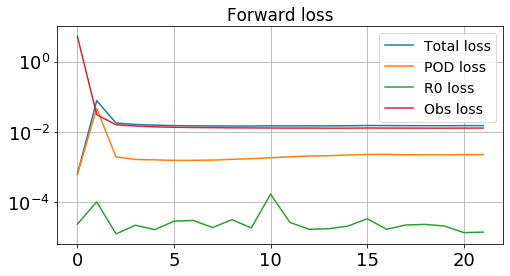

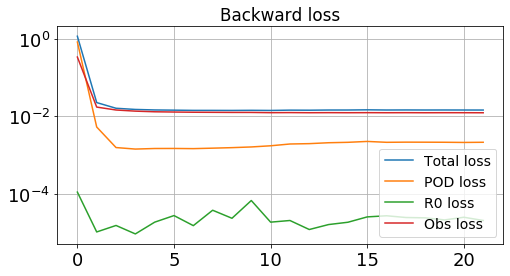

In [20]:
# plot loss function
mpl.rcParams.update({'font.size': 14})
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rc('axes', labelsize=18)

fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(forward_loss)
ax.set_title('Forward loss')
ax.set_yscale('log')
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])    
fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(backward_loss)
ax.set_yscale('log')
ax.set_title('Backward loss')
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])

0 [5.79059122e-01 4.10418861e-01 6.72079708e-05 2.79499586e+00]
1 [4.95429841e-02 2.55351030e-02 5.49389075e-05 2.39529423e-02]
2 [1.68677384e-02 1.73584798e-03 1.37683976e-05 1.51181220e-02]
3 [1.55469514e-02 1.52041357e-03 1.54061736e-05 1.40111317e-02]
4 [1.49589388e-02 1.52578920e-03 1.73976684e-05 1.34157517e-02]
5 [1.46566421e-02 1.50018945e-03 2.78446305e-05 1.31286079e-02]
6 [1.44612048e-02 1.49743129e-03 2.23392797e-05 1.29414342e-02]
7 [1.43918786e-02 1.52782342e-03 2.82244154e-05 1.28358308e-02]
8 [1.43347354e-02 1.58989022e-03 2.72814990e-05 1.27175636e-02]
9 [1.43895323e-02 1.65948124e-03 4.28428833e-05 1.26872081e-02]
10 [1.44217184e-02 1.77055991e-03 9.20080550e-05 1.25591505e-02]
11 [1.45004783e-02 1.92345605e-03 2.31890805e-05 1.25538331e-02]
12 [1.45260894e-02 2.00022284e-03 1.42660963e-05 1.25116005e-02]
13 [1.45907833e-02 2.07072766e-03 1.66648161e-05 1.25033907e-02]
14 [1.46445820e-02 2.14625283e-03 1.94269531e-05 1.24789021e-02]
15 [1.46445820e-02 2.14625283e-03 1

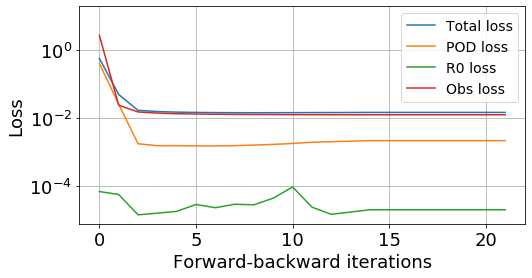

In [21]:
loss = (np.array(backward_loss)+np.array(forward_loss))/2
new_loss = loss.copy()

# Because we discard the forward-backward iteration with loss greater than the minimum
print(0, new_loss[0,:])
for i in range(1,len(new_loss)): 
    if new_loss[i,-1] > new_loss[i-1,-1]:
        new_loss[i,:] = new_loss[i-1,:] 
    print(i, new_loss[i,:])

fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(new_loss)
ax.set_yscale('log')
ax.set_ylim(top=2*10**1)
ax.set_ylabel('Loss') 
ax.set_xlabel('Forward-backward iterations')   
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])

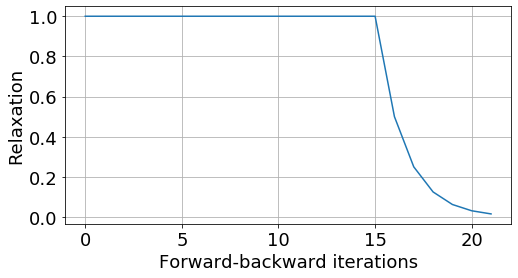

In [22]:
fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(list_relax)
ax.set_ylabel('Relaxation') 
ax.set_xlabel('Forward-backward iterations')   
plt.grid()

## Test case 2

In [23]:
def plot_data(X_predict, nx, ny, obs_times=[], X_obs=[], grid_points=[], R0s_obs=[], R0_ax='', X_ax='', label='', mark='-'):
    X_generated = scaler.inverse_transform(X_predict)
    R0_generated = X_generated[:,pca_size:]
    X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
    X_generated = X_generated.reshape(len(X_predict), len(groups), nl, nc)
    X_generated[X_generated<0] = 0 
    
    # Plot R
    xp = len(R0_generated)
    if R0_ax:
        R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), R0_generated[:,0], 'b'+mark, label='Home '+label)
        R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), R0_generated[:,1], 'r'+mark, label='Mobile '+label)
        if len(R0s_obs):
            R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), [R0s_obs[0]]*len(R0_generated), 'bo', markevery=5, fillstyle='none', markersize = 10, label='Home truth')
            R0_ax.plot(np.linspace(0,(xp-1)*8000/86400,xp), [R0s_obs[1]]*len(R0_generated), 'ro', markevery=5, fillstyle='none', markersize = 10, label='Mobile truth')    
        if len(label):
        #    R0_ax.legend()
            R0_ax.set_xlabel('Time (days)')
            R0_ax.set_ylabel('Reproduction number')
        plt.tight_layout()
        #plt.grid()
        #plt.show()

    
    # Plot groups 
    if len(X_ax): 
        for i, group in enumerate(groups):
            X_ax.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_generated[:,i, nx, ny], mark, label=label)
            if len(X_obs):
                if [i, nx, ny] in grid_points:
                    X_ax.flatten()[i].plot(np.array(obs_times)*8000/86400, X_obs[:, i, nx, ny], 'o', markevery=1, fillstyle='none', markersize = 12, label='Observed data')
                else:
                    X_ax.flatten()[i].plot([],[])
            X_ax.flatten()[i].set_title(group)
            if len(label):
            #    X_ax.flatten()[i].legend()
                X_ax.flatten()[i].set_xlabel('Time (days)')
                X_ax.flatten()[i].set_ylabel('Number of People')
        plt.tight_layout()
        #plt.grid()
        #plt.show()

### Generate data

In [24]:
run = 2
lag = 400
nobs = len(times)*run + lag
length = 100 # length + (ntimes-1) -> len of X_obs

# Get the observed data
X_obs = X_test_1D[nobs:nobs+((ntimes-1)+length)*step:step,:].reshape(-1,len(groups),nl,nc)
R0s_obs = R0s_test[run]
R0s_obs_scaled = X_test_scaled[nobs][-2:]

# Add noise
np.random.seed(0)
noise = 0.05
X_obs = X_obs + np.random.standard_normal(X_obs.shape)*noise*X_obs

# Print values
print('X_obs.shape', X_obs.shape)
print('R0s_obs', R0s_obs)
print('R0s_obs_scaled', R0s_obs_scaled)

# Times of X_obs to be considered for data assimilation
obs_times = list(map(int,map(round,np.arange(5,len(X_obs[:]),21.6))))

# grid points: used to populate the obs_points
#[[group, line, column], 
# [group, line, column], 
# ...                 ]
grid_points = [[2,0,4],[6,0,4],
               [2,9,4],[6,9,4],
               [2,4,4],[6,4,4],
               [2,4,0],[6,4,0],
               [2,4,9],[6,4,9],
               #[0,0,4],[1,0,4],[2,0,4],[3,0,4],[4,0,4],[5,0,4],[6,0,4],[7,0,4],
               #[0,9,4],[1,9,4],[2,9,4],[3,9,4],[4,9,4],[5,9,4],[6,9,4],[7,9,4],
               #[0,4,4],[1,4,4],[2,4,4],[3,4,4],[4,4,4],[5,4,4],[6,4,4],[7,4,4],
               #[0,4,0],[1,4,0],[2,4,0],[3,4,0],[4,4,0],[5,4,0],[6,4,0],[7,4,0],
               #[0,4,9],[1,4,9],[2,4,9],[3,4,9],[4,4,9],[5,4,9],[6,4,9],[7,4,9],
               ]
# obs_points:
#[[time, group, line, column], 
# [time, group, line, column], 
# ...                       ]
obs_points = []
for p in grid_points:
    for t in obs_times:
        obs_points.append([t]+p)
obs_points = np.array(obs_points)
print('obs_points: \n', obs_points)

X_obs.shape (109, 8, 10, 10)
R0s_obs [ 7.72820859 17.37615382]
R0s_obs_scaled [-0.24019399  0.75509446]
obs_points: 
 [[ 5  2  0  4]
 [27  2  0  4]
 [48  2  0  4]
 [70  2  0  4]
 [91  2  0  4]
 [ 5  6  0  4]
 [27  6  0  4]
 [48  6  0  4]
 [70  6  0  4]
 [91  6  0  4]
 [ 5  2  9  4]
 [27  2  9  4]
 [48  2  9  4]
 [70  2  9  4]
 [91  2  9  4]
 [ 5  6  9  4]
 [27  6  9  4]
 [48  6  9  4]
 [70  6  9  4]
 [91  6  9  4]
 [ 5  2  4  4]
 [27  2  4  4]
 [48  2  4  4]
 [70  2  4  4]
 [91  2  4  4]
 [ 5  6  4  4]
 [27  6  4  4]
 [48  6  4  4]
 [70  6  4  4]
 [91  6  4  4]
 [ 5  2  4  0]
 [27  2  4  0]
 [48  2  4  0]
 [70  2  4  0]
 [91  2  4  0]
 [ 5  6  4  0]
 [27  6  4  0]
 [48  6  4  0]
 [70  6  4  0]
 [91  6  4  0]
 [ 5  2  4  9]
 [27  2  4  9]
 [48  2  4  9]
 [70  2  4  9]
 [91  2  4  9]
 [ 5  6  4  9]
 [27  6  4  9]
 [48  6  4  9]
 [70  6  4  9]
 [91  6  4  9]]


In [25]:
# Initial condition
run = 26
lag = 400
n = len(times)*run - ntimes*step*run + lag
nplot = n + run*ntimes*step 
forward_steps = length
time_steps = forward_steps + (ntimes-1)

# Calculate the weights
# Delta variables 
delta_obs = 1200
delta_pod = 2
delta_r0 = 2

# POD coeficients
weight_pod = pca_compress.singular_values_/pca_compress.singular_values_.sum()
weight_pod = tf.constant(weight_pod, dtype=tf.float32)
print('weight_pod: ', weight_pod, end='\n\n')

# R0s
weight_R0_p = 0.01*((delta_pod/delta_r0)**2)/2
weight_R0_p = tf.constant([weight_R0_p]*2, dtype=tf.float32)
print('weight_R0_p: ', weight_R0_p, end='\n\n')
weight_R0_da = 0.0001*((delta_pod/delta_r0)**2)/2
weight_R0_da = tf.constant([weight_R0_da]*2, dtype=tf.float32)
print('weight_R0_da: ', weight_R0_da, end='\n\n')
weight_R0 = tf.Variable(weight_R0_p, dtype=tf.float32)

# Observed data
weight_obs = 10.0*((delta_pod/delta_obs)**2)*ntimes
weight_obs = tf.constant(weight_obs, dtype=tf.float32)
print('weight_obs', weight_obs, end='\n\n')

weight_pod:  tf.Tensor(
[5.56196868e-01 2.03024685e-01 8.77208859e-02 4.96064164e-02
 4.05909568e-02 1.79590061e-02 1.43773295e-02 1.33153498e-02
 4.74109687e-03 3.75490240e-03 3.47938458e-03 2.55672471e-03
 1.36965106e-03 9.87468055e-04 3.19285289e-04], shape=(15,), dtype=float32)

weight_R0_p:  tf.Tensor([0.005 0.005], shape=(2,), dtype=float32)

weight_R0_da:  tf.Tensor([5.e-05 5.e-05], shape=(2,), dtype=float32)

weight_obs tf.Tensor(0.00027777778, shape=(), dtype=float32)



### Run data assimilation


Iteration 0: forward and backward
-- Forward March --
Initial point losses: 
['3.78e-03', '4.80e-04', '3.30e-03', '2.04e+00']
['4.11e-04', '3.09e-04', '1.02e-04', '2.08e+00']
['3.61e-03', '4.79e-04', '3.13e-03', '2.04e+00']
['3.78e-03', '4.81e-04', '3.30e-03', '2.04e+00']
['3.82e-03', '4.92e-04', '3.33e-03', '2.04e+00']
['3.76e-04', '3.45e-04', '3.13e-05', '2.09e+00']
['3.78e-03', '4.80e-04', '3.30e-03', '2.04e+00']
['4.85e-04', '3.01e-04', '1.84e-04', '2.07e+00']
['3.79e-03', '4.83e-04', '3.31e-03', '2.04e+00']
['3.78e-03', '4.83e-04', '3.29e-03', '2.04e+00']

Loss iteration 0: ['3.76e-04', '3.45e-04', '3.13e-05', '2.09e+00']
Loss iteration 1: ['7.24e-04', '7.00e-04', '2.44e-05', '2.05e+00'] - 4s
Loss iteration 2: ['4.18e-04', '3.90e-04', '2.85e-05', '2.06e+00'] - 4s
Loss iteration 3: ['3.72e-04', '3.56e-04', '1.62e-05', '2.06e+00'] - 1s
Loss iteration 4: ['5.55e-04', '5.32e-04', '2.35e-05', '2.09e+00'] - 4s
Loss iteration 5: ['5.07e-04', '4.73e-04', '3.35e-05', '2.05e+00'] - 4s
Loss

Loss iteration 4: ['8.49e-04', '8.48e-04', '7.51e-07', '0.00e+00'] - 3s
Loss iteration 5: ['7.71e-04', '7.63e-04', '7.58e-06', '0.00e+00'] - 3s
Loss iteration 6: ['5.44e-04', '5.40e-04', '3.58e-06', '0.00e+00'] - 1s
Loss iteration 7: ['9.06e-04', '9.04e-04', '1.72e-06', '0.00e+00'] - 1s
Loss iteration 8: ['8.61e-04', '8.59e-04', '1.68e-06', '0.00e+00'] - 3s
Loss iteration 9: ['1.89e-01', '1.35e-01', '3.86e-04', '5.37e-02'] - 4s
Loss iteration 10: ['1.43e-01', '1.09e-01', '9.19e-04', '3.34e-02'] - 4s
Loss iteration 11: ['1.28e-01', '1.03e-01', '9.50e-04', '2.32e-02'] - 4s
Loss iteration 12: ['1.03e-01', '9.06e-02', '8.31e-04', '1.14e-02'] - 4s
Loss iteration 13: ['9.67e-02', '8.67e-02', '7.07e-04', '9.30e-03'] - 4s
Loss iteration 14: ['8.11e-02', '7.02e-02', '5.78e-04', '1.03e-02'] - 4s
Loss iteration 15: ['8.63e-02', '7.44e-02', '4.34e-04', '1.15e-02'] - 1s
Loss iteration 16: ['7.32e-02', '6.64e-02', '2.95e-04', '6.41e-03'] - 4s
Loss iteration 17: ['6.06e-02', '5.31e-02', '1.68e-04', '

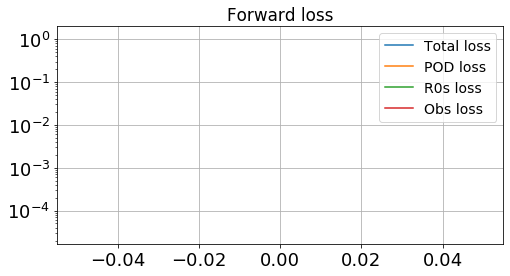

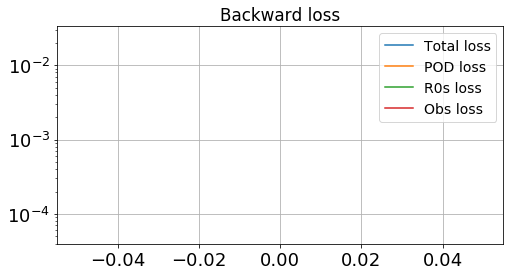

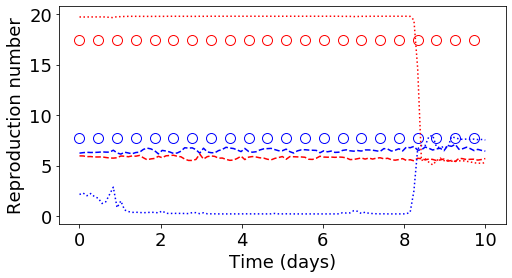

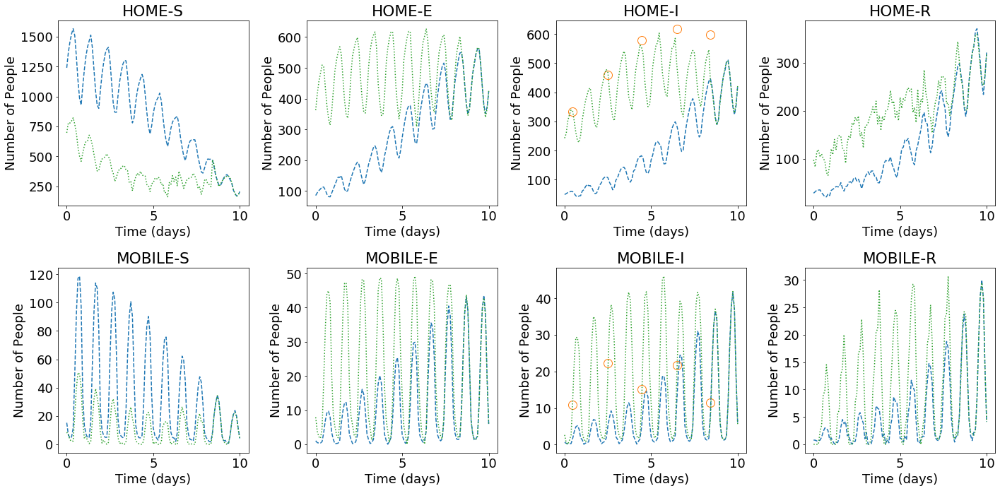

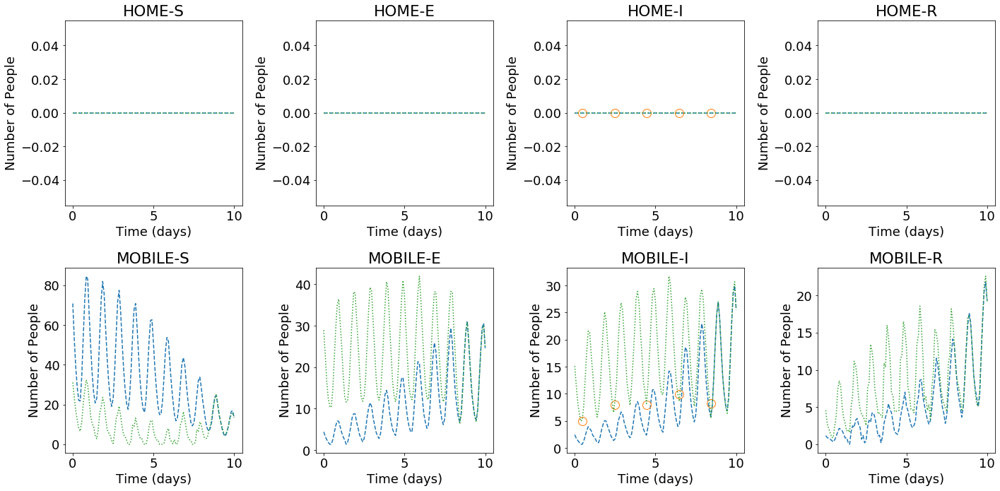

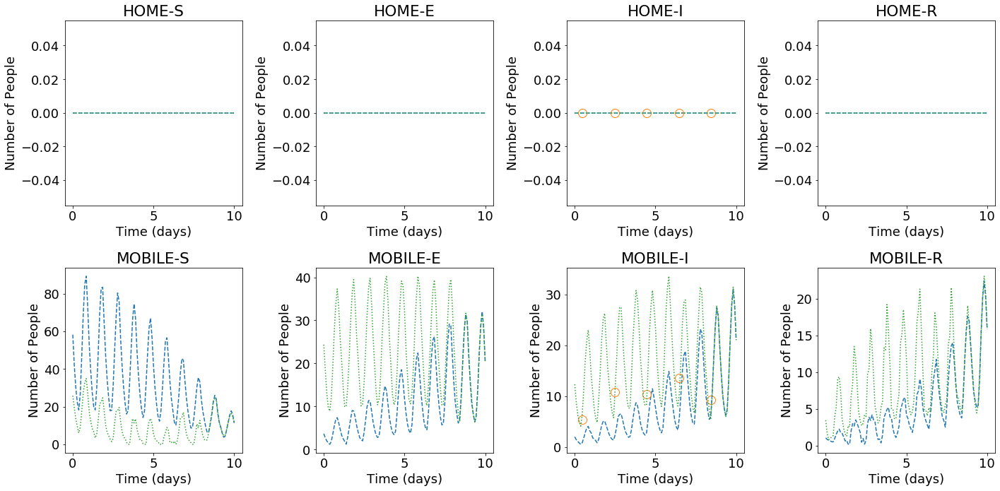

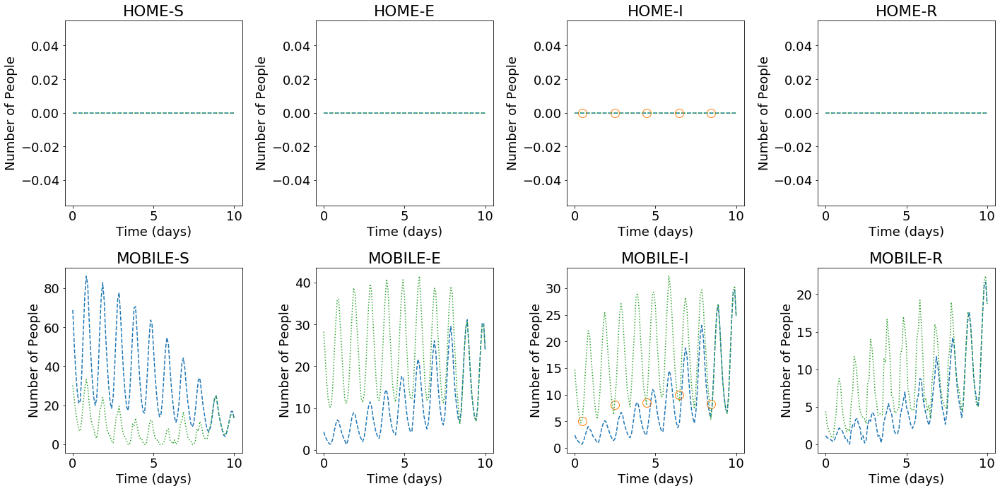

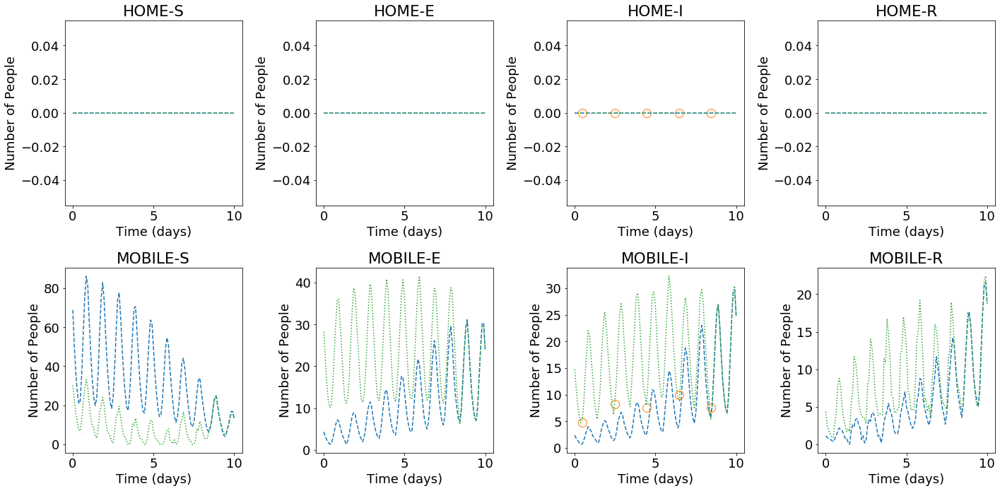


Iteration 1: forward and backward
-- Forward March --
Loss iteration 0: ['4.55e-03', '4.26e-03', '8.61e-07', '2.85e-04']
Loss iteration 1: ['2.95e-03', '2.91e-03', '2.19e-06', '3.13e-05'] - 4s
Loss iteration 2: ['4.52e-03', '4.22e-03', '7.19e-07', '3.03e-04'] - 1s
Loss iteration 3: ['4.19e-03', '3.98e-03', '1.14e-06', '2.17e-04'] - 1s
Loss iteration 4: ['2.56e-03', '2.53e-03', '5.23e-07', '2.54e-05'] - 1s
Loss iteration 5: ['8.96e-03', '8.37e-03', '2.12e-06', '5.83e-04'] - 3s
Loss iteration 6: ['3.68e-03', '3.68e-03', '1.95e-06', '0.00e+00'] - 3s
Loss iteration 7: ['3.90e-03', '3.90e-03', '1.24e-06', '0.00e+00'] - 1s
Loss iteration 8: ['4.08e-03', '4.08e-03', '3.10e-06', '0.00e+00'] - 3s
Loss iteration 9: ['6.31e-03', '6.31e-03', '1.07e-06', '0.00e+00'] - 3s
Loss iteration 10: ['8.21e-03', '8.21e-03', '2.29e-06', '0.00e+00'] - 4s
Loss iteration 11: ['4.82e-03', '4.79e-03', '2.48e-05', '0.00e+00'] - 4s
Loss iteration 12: ['6.00e-03', '5.99e-03', '1.90e-05', '0.00e+00'] - 3s
Loss iterat

Loss iteration 11: ['1.87e-03', '1.47e-03', '5.05e-06', '3.99e-04'] - 4s
Loss iteration 12: ['1.91e-03', '1.46e-03', '1.01e-06', '4.54e-04'] - 2s
Loss iteration 13: ['1.63e-03', '1.23e-03', '2.35e-05', '3.78e-04'] - 4s
Loss iteration 14: ['1.69e-03', '1.27e-03', '2.43e-06', '4.21e-04'] - 3s
Loss iteration 15: ['1.65e-03', '1.22e-03', '3.57e-06', '4.32e-04'] - 3s
Loss iteration 16: ['1.36e-03', '9.26e-04', '1.05e-05', '4.20e-04'] - 4s
Loss iteration 17: ['2.06e-03', '1.56e-03', '7.97e-06', '4.89e-04'] - 4s
Loss iteration 18: ['1.31e-03', '1.30e-03', '4.33e-06', '0.00e+00'] - 3s
Loss iteration 19: ['1.46e-03', '1.45e-03', '6.63e-06', '0.00e+00'] - 4s
Loss iteration 20: ['1.51e-03', '1.50e-03', '8.08e-06', '0.00e+00'] - 2s
Loss iteration 21: ['1.28e-03', '1.27e-03', '1.28e-05', '0.00e+00'] - 2s
Loss iteration 22: ['1.23e-03', '1.22e-03', '1.04e-05', '0.00e+00'] - 2s
Loss iteration 23: ['1.60e-03', '1.59e-03', '9.87e-06', '0.00e+00'] - 3s
Loss iteration 24: ['1.41e-03', '1.39e-03', '1.68e-

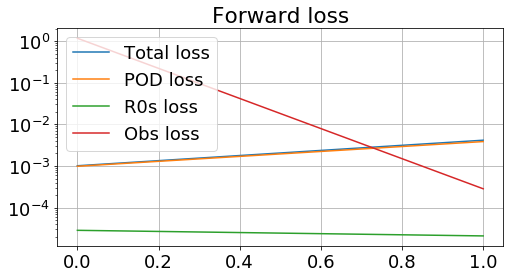

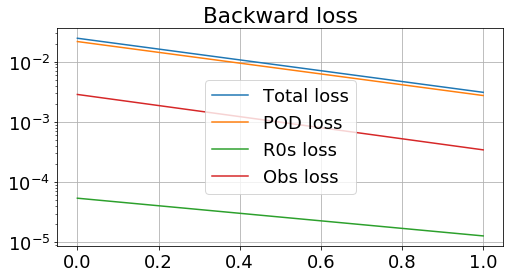

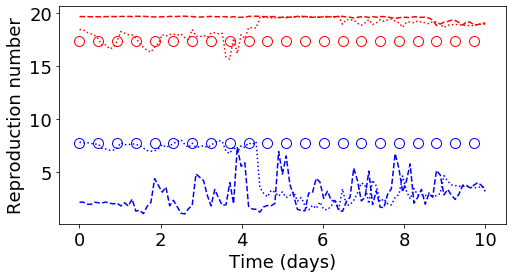

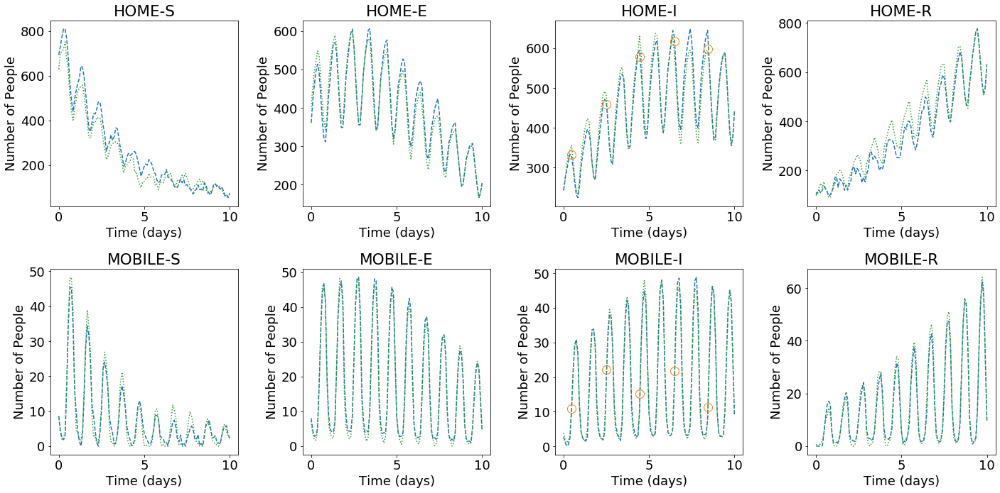

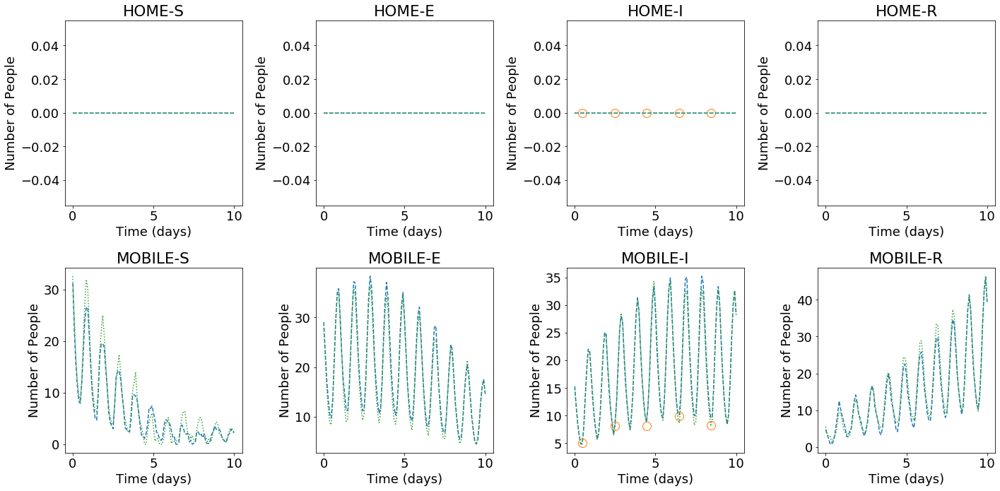

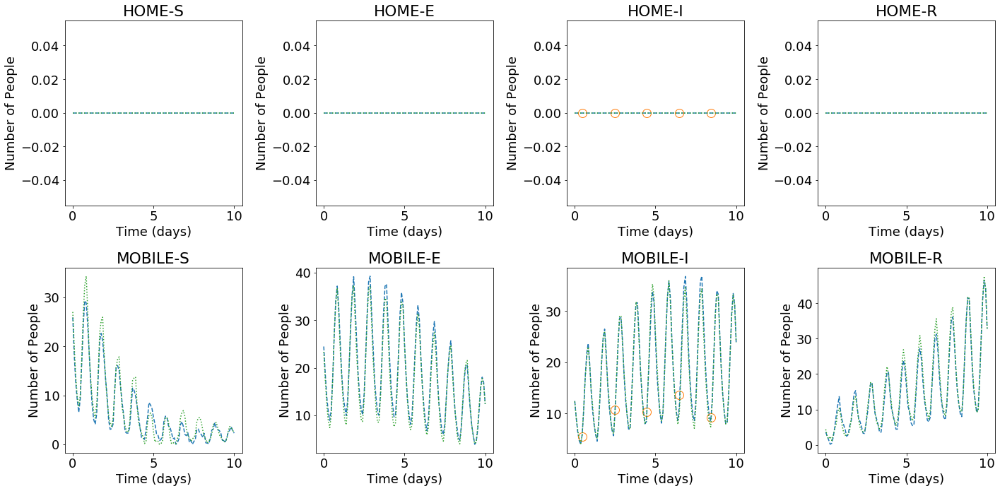

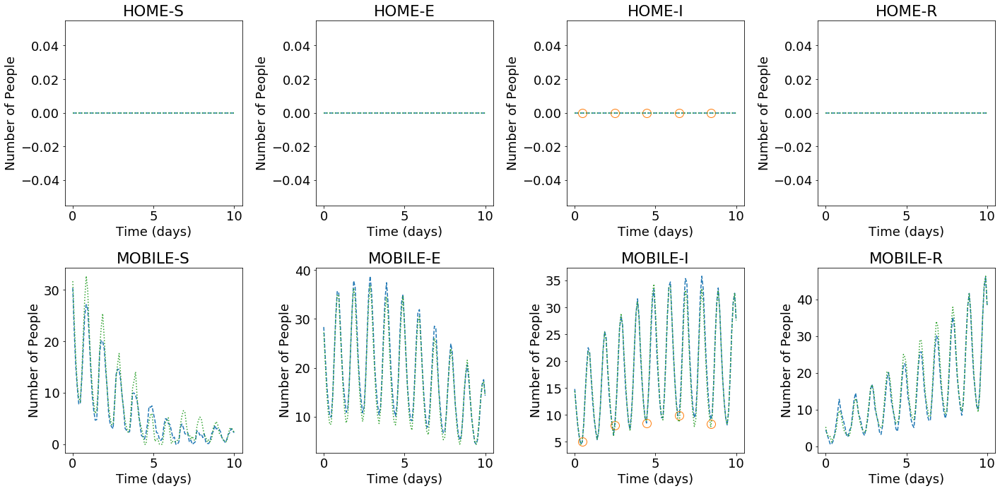

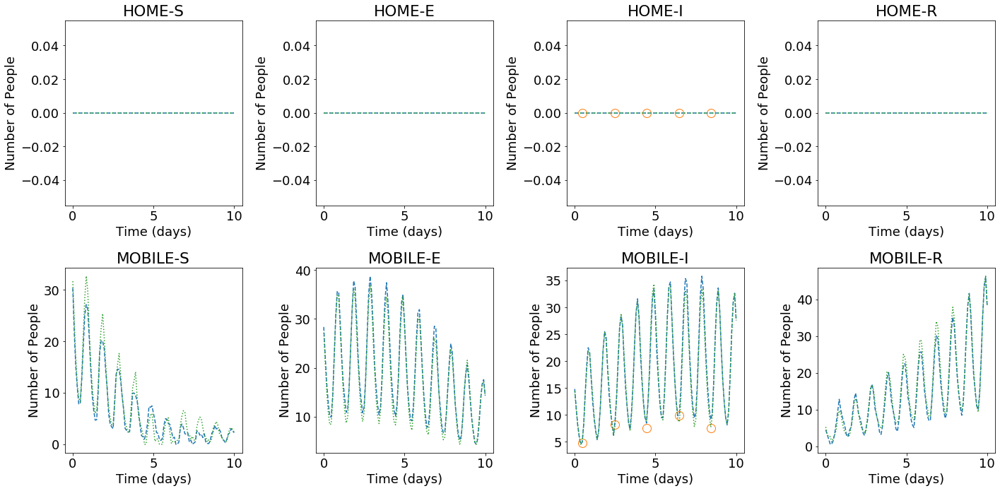


Iteration 2: forward and backward
-- Forward March --
Loss iteration 0: ['2.22e-03', '2.17e-03', '8.10e-06', '4.56e-05']
Loss iteration 1: ['2.27e-03', '2.07e-03', '7.36e-06', '1.90e-04'] - 1s
Loss iteration 2: ['1.98e-03', '1.86e-03', '5.06e-06', '1.19e-04'] - 1s
Loss iteration 3: ['2.35e-03', '2.34e-03', '4.61e-06', '1.20e-05'] - 2s
Loss iteration 4: ['2.84e-03', '2.03e-03', '5.55e-06', '8.03e-04'] - 4s
Loss iteration 5: ['6.29e-03', '5.07e-03', '5.52e-06', '1.21e-03'] - 4s
Loss iteration 6: ['1.38e-03', '1.37e-03', '5.66e-06', '0.00e+00'] - 3s
Loss iteration 7: ['1.90e-03', '1.90e-03', '3.81e-06', '0.00e+00'] - 4s
Loss iteration 8: ['1.71e-03', '1.70e-03', '5.79e-06', '0.00e+00'] - 3s
Loss iteration 9: ['1.68e-03', '1.67e-03', '4.82e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.18e-03', '3.18e-03', '1.28e-06', '0.00e+00'] - 4s
Loss iteration 11: ['1.55e-03', '1.54e-03', '7.20e-06', '0.00e+00'] - 4s
Loss iteration 12: ['2.04e-03', '2.04e-03', '4.59e-06', '0.00e+00'] - 4s
Loss iterat

Loss iteration 11: ['1.08e-03', '9.84e-04', '2.98e-06', '8.98e-05'] - 1s
Loss iteration 12: ['9.51e-04', '9.07e-04', '2.44e-06', '4.17e-05'] - 4s
Loss iteration 13: ['7.49e-04', '7.09e-04', '1.04e-06', '3.90e-05'] - 4s
Loss iteration 14: ['8.03e-04', '7.57e-04', '2.43e-06', '4.30e-05'] - 4s
Loss iteration 15: ['8.73e-04', '8.19e-04', '1.93e-06', '5.14e-05'] - 4s
Loss iteration 16: ['6.71e-04', '6.08e-04', '2.62e-06', '6.00e-05'] - 1s
Loss iteration 17: ['9.62e-04', '9.13e-04', '3.54e-06', '4.47e-05'] - 1s
Loss iteration 18: ['8.58e-04', '8.55e-04', '2.93e-06', '0.00e+00'] - 1s
Loss iteration 19: ['8.38e-04', '8.36e-04', '2.18e-06', '0.00e+00'] - 1s
Loss iteration 20: ['7.91e-04', '7.89e-04', '2.44e-06', '0.00e+00'] - 2s
Loss iteration 21: ['9.36e-04', '9.35e-04', '1.02e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.32e-04', '8.31e-04', '6.79e-07', '0.00e+00'] - 4s
Loss iteration 23: ['8.43e-04', '8.43e-04', '4.98e-07', '0.00e+00'] - 1s
Loss iteration 24: ['6.05e-04', '6.05e-04', '2.61e-

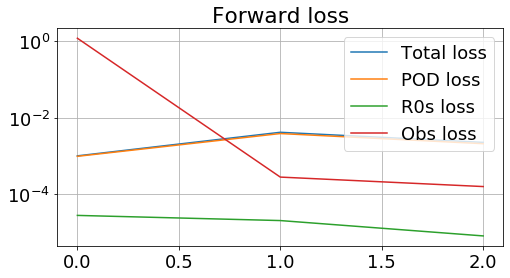

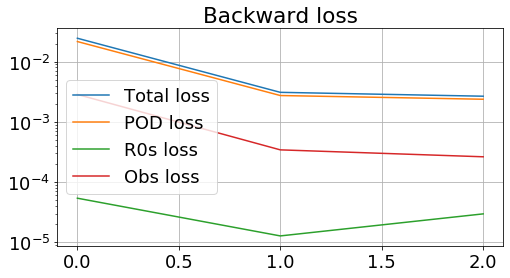

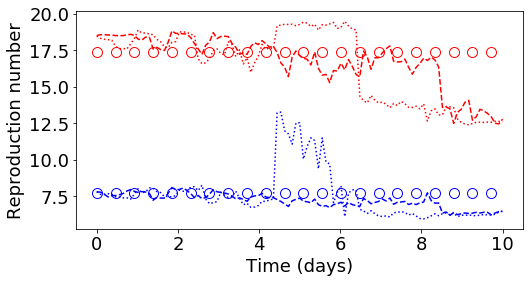

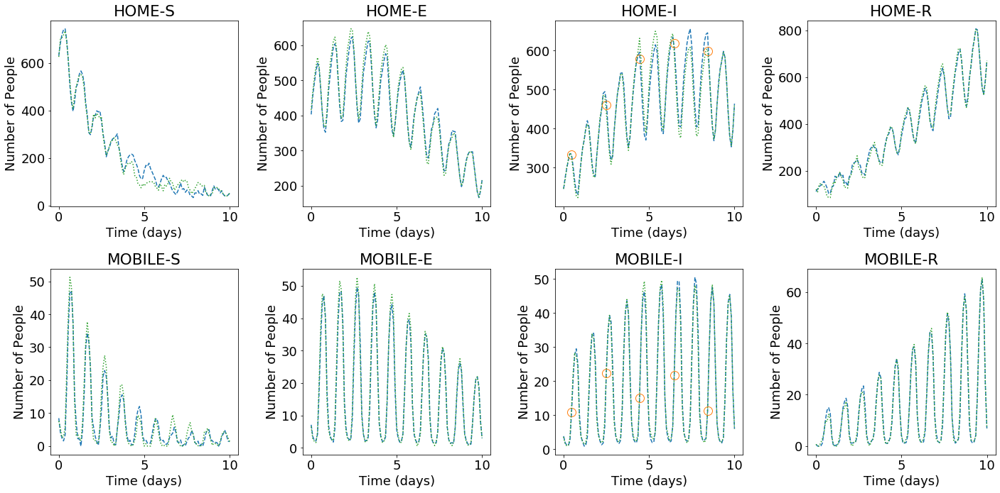

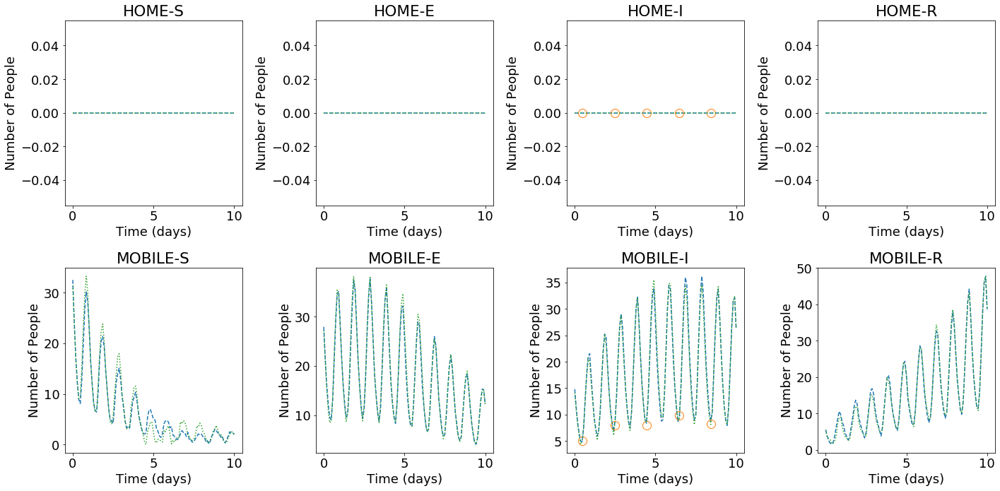

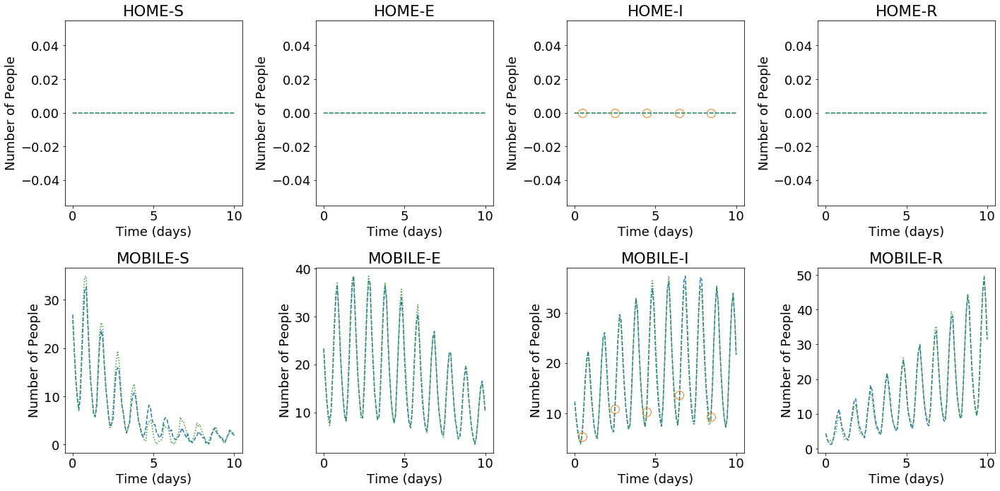

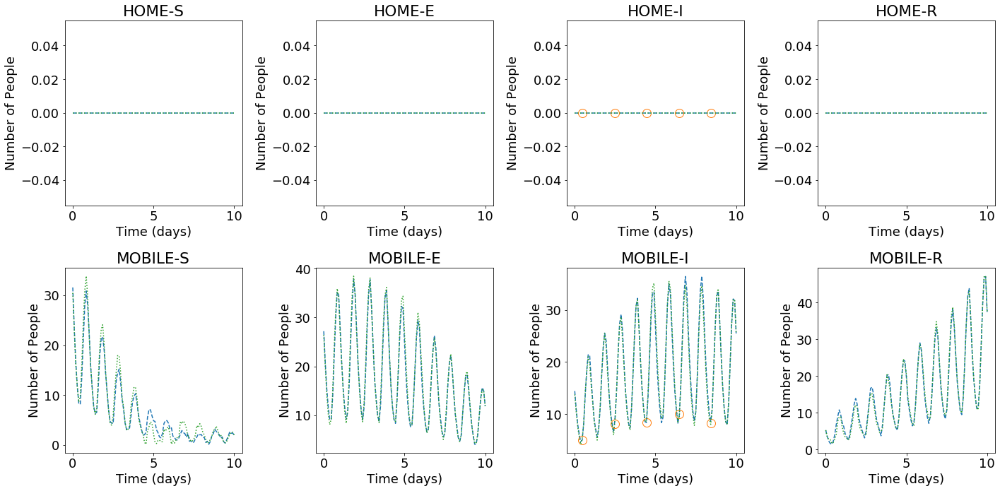

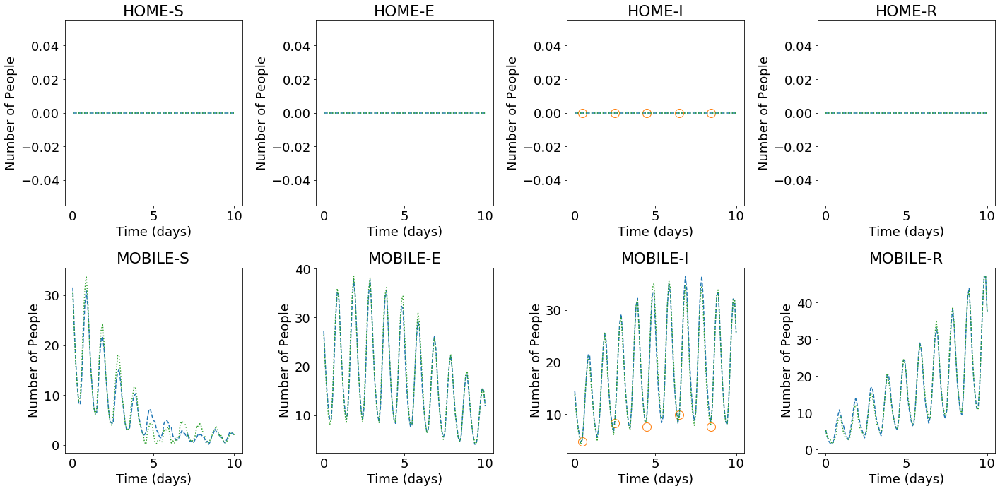


Iteration 3: forward and backward
-- Forward March --
Loss iteration 0: ['3.34e-03', '2.87e-03', '3.10e-06', '4.73e-04']
Loss iteration 1: ['3.04e-03', '2.86e-03', '1.66e-06', '1.79e-04'] - 3s
Loss iteration 2: ['2.06e-03', '1.82e-03', '1.25e-06', '2.35e-04'] - 1s
Loss iteration 3: ['2.02e-03', '1.76e-03', '1.11e-06', '2.64e-04'] - 4s
Loss iteration 4: ['1.41e-03', '1.34e-03', '1.26e-06', '6.98e-05'] - 1s
Loss iteration 5: ['3.63e-03', '3.54e-03', '1.32e-06', '9.03e-05'] - 4s
Loss iteration 6: ['1.74e-03', '1.74e-03', '3.16e-06', '0.00e+00'] - 4s
Loss iteration 7: ['1.53e-03', '1.53e-03', '2.48e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.63e-03', '1.62e-03', '6.05e-06', '0.00e+00'] - 3s
Loss iteration 9: ['1.87e-03', '1.87e-03', '2.64e-06', '0.00e+00'] - 1s
Loss iteration 10: ['2.92e-03', '2.92e-03', '9.65e-07', '0.00e+00'] - 1s
Loss iteration 11: ['1.58e-03', '1.57e-03', '8.25e-06', '0.00e+00'] - 3s
Loss iteration 12: ['1.75e-03', '1.75e-03', '3.61e-06', '0.00e+00'] - 1s
Loss iterat

Loss iteration 11: ['9.99e-04', '7.99e-04', '3.08e-06', '1.97e-04'] - 1s
Loss iteration 12: ['9.94e-04', '9.07e-04', '1.25e-06', '8.58e-05'] - 2s
Loss iteration 13: ['7.65e-04', '6.68e-04', '1.66e-06', '9.48e-05'] - 1s
Loss iteration 14: ['7.93e-04', '6.93e-04', '2.06e-06', '9.73e-05'] - 4s
Loss iteration 15: ['7.80e-04', '6.94e-04', '3.44e-06', '8.19e-05'] - 1s
Loss iteration 16: ['8.74e-04', '7.55e-04', '5.53e-06', '1.13e-04'] - 1s
Loss iteration 17: ['8.75e-04', '7.86e-04', '7.39e-06', '8.23e-05'] - 4s
Loss iteration 18: ['7.34e-04', '7.32e-04', '1.93e-06', '0.00e+00'] - 3s
Loss iteration 19: ['7.96e-04', '7.94e-04', '1.96e-06', '0.00e+00'] - 1s
Loss iteration 20: ['5.92e-04', '5.90e-04', '2.78e-06', '0.00e+00'] - 2s
Loss iteration 21: ['1.07e-03', '1.07e-03', '1.87e-06', '0.00e+00'] - 2s
Loss iteration 22: ['6.64e-04', '6.62e-04', '1.59e-06', '0.00e+00'] - 3s
Loss iteration 23: ['8.24e-04', '8.21e-04', '3.08e-06', '0.00e+00'] - 4s
Loss iteration 24: ['7.19e-04', '7.16e-04', '2.57e-

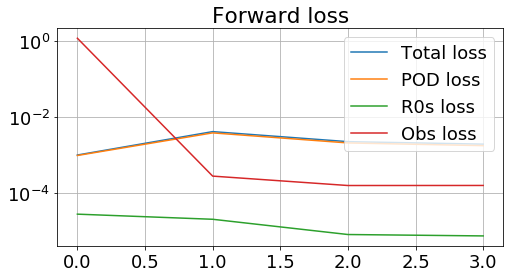

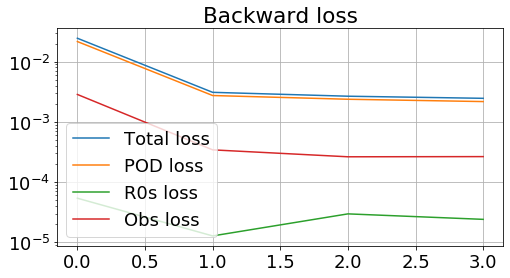

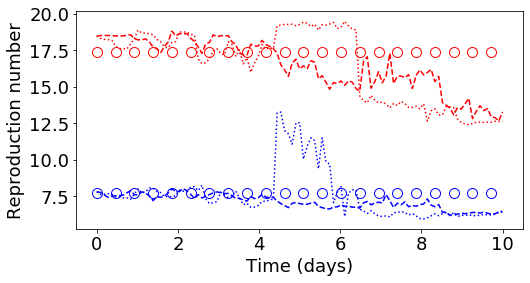

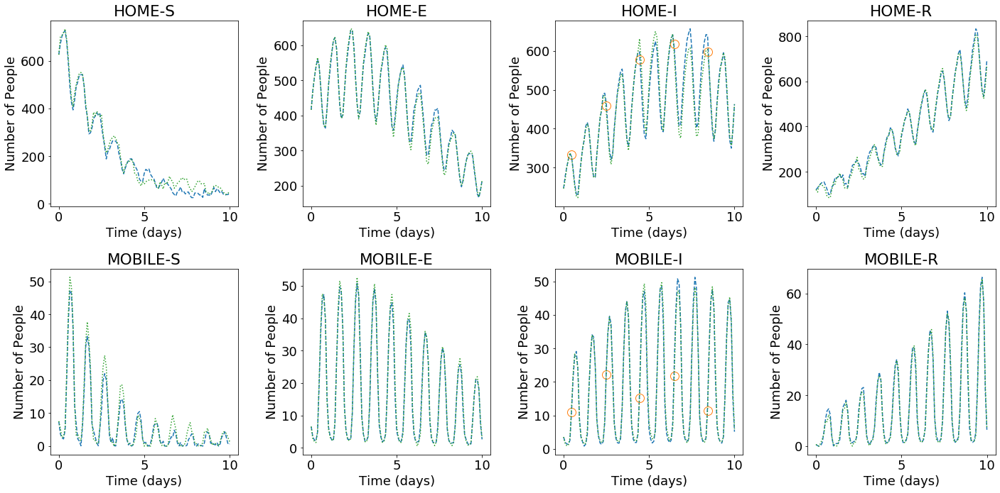

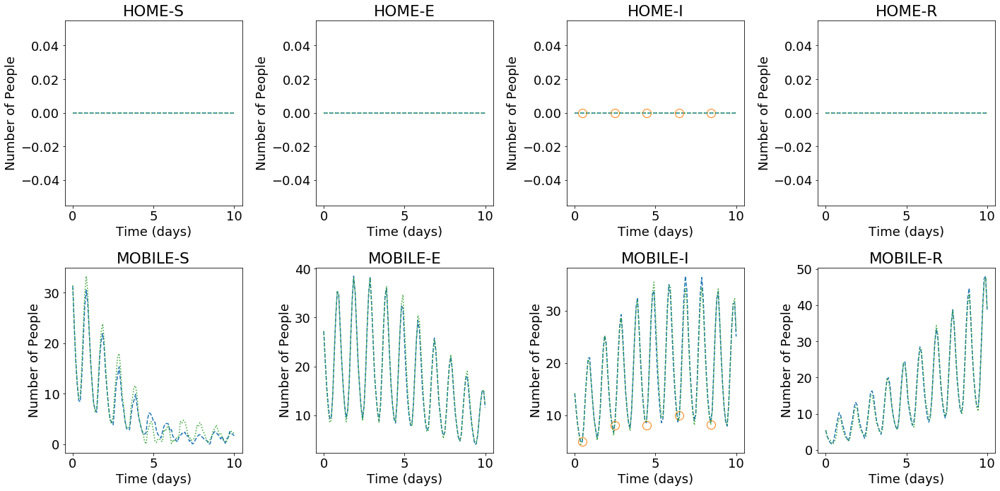

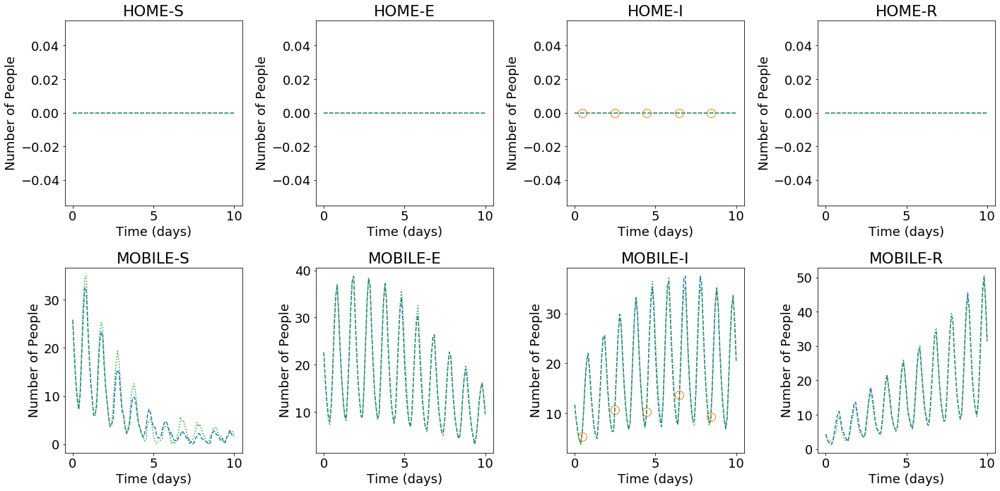

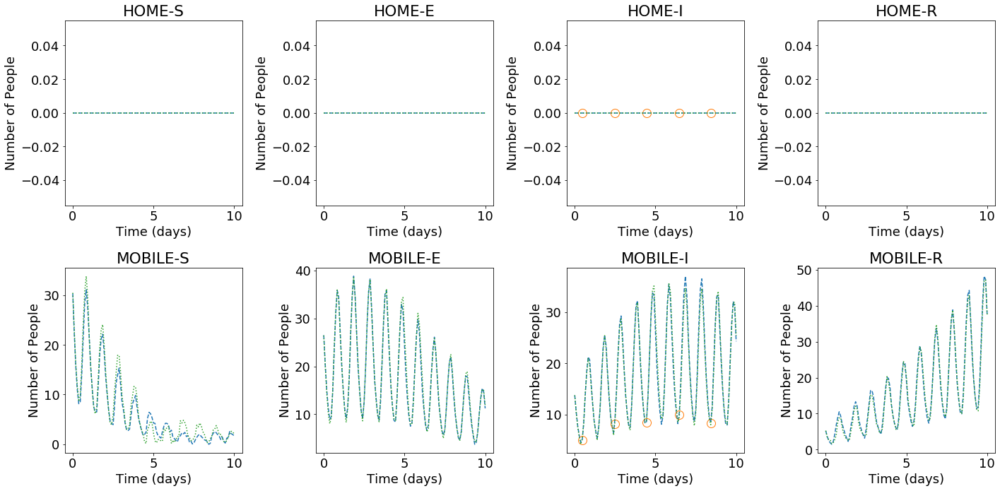

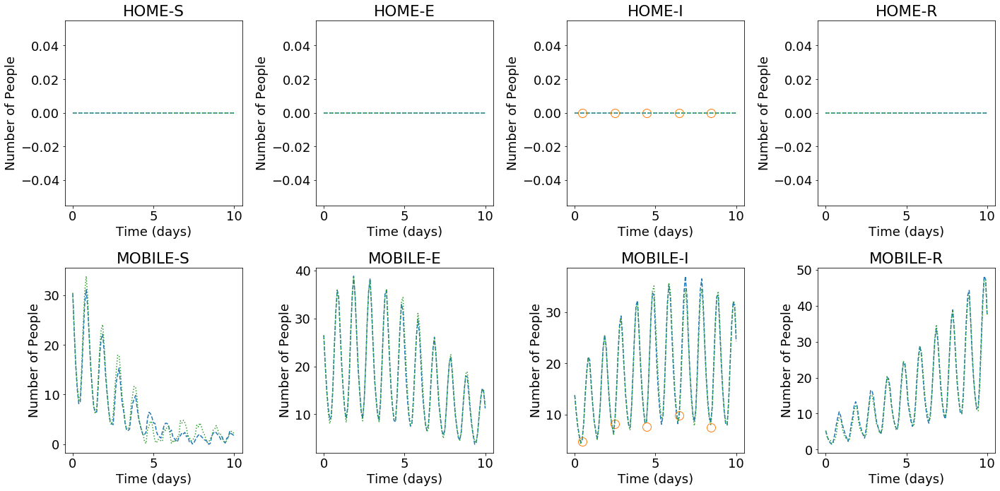


Iteration 4: forward and backward
-- Forward March --
Loss iteration 0: ['5.54e-03', '4.57e-03', '1.89e-06', '9.65e-04']
Loss iteration 1: ['3.08e-03', '2.93e-03', '2.17e-06', '1.53e-04'] - 1s
Loss iteration 2: ['1.92e-03', '1.75e-03', '2.40e-06', '1.68e-04'] - 1s
Loss iteration 3: ['1.58e-03', '1.39e-03', '2.68e-06', '1.84e-04'] - 1s
Loss iteration 4: ['1.61e-03', '1.47e-03', '2.98e-06', '1.29e-04'] - 1s
Loss iteration 5: ['4.86e-03', '4.39e-03', '2.11e-06', '4.67e-04'] - 4s
Loss iteration 6: ['2.10e-03', '2.10e-03', '2.98e-06', '0.00e+00'] - 1s
Loss iteration 7: ['1.97e-03', '1.97e-03', '2.14e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.74e-03', '1.73e-03', '5.14e-06', '0.00e+00'] - 1s
Loss iteration 9: ['1.82e-03', '1.82e-03', '3.10e-06', '0.00e+00'] - 1s
Loss iteration 10: ['3.63e-03', '3.63e-03', '1.67e-06', '0.00e+00'] - 4s
Loss iteration 11: ['1.64e-03', '1.63e-03', '8.94e-06', '0.00e+00'] - 4s
Loss iteration 12: ['1.88e-03', '1.88e-03', '5.34e-06', '0.00e+00'] - 3s
Loss iterat

Loss iteration 11: ['1.04e-03', '9.50e-04', '3.44e-06', '9.10e-05'] - 1s
Loss iteration 12: ['9.48e-04', '9.03e-04', '2.45e-06', '4.24e-05'] - 4s
Loss iteration 13: ['7.42e-04', '7.01e-04', '1.11e-06', '3.92e-05'] - 4s
Loss iteration 14: ['7.94e-04', '7.48e-04', '2.43e-06', '4.33e-05'] - 4s
Loss iteration 15: ['7.39e-04', '6.84e-04', '2.18e-06', '5.27e-05'] - 2s
Loss iteration 16: ['6.71e-04', '6.12e-04', '4.89e-06', '5.44e-05'] - 4s
Loss iteration 17: ['9.43e-04', '8.94e-04', '5.03e-06', '4.40e-05'] - 4s
Loss iteration 18: ['8.36e-04', '8.33e-04', '2.93e-06', '0.00e+00'] - 3s
Loss iteration 19: ['8.15e-04', '8.13e-04', '2.16e-06', '0.00e+00'] - 3s
Loss iteration 20: ['9.79e-04', '9.76e-04', '3.08e-06', '0.00e+00'] - 4s
Loss iteration 21: ['1.07e-03', '1.07e-03', '1.11e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.99e-04', '8.98e-04', '7.95e-07', '0.00e+00'] - 3s
Loss iteration 23: ['9.29e-04', '9.29e-04', '7.68e-07', '0.00e+00'] - 3s
Loss iteration 24: ['6.67e-04', '6.66e-04', '3.39e-

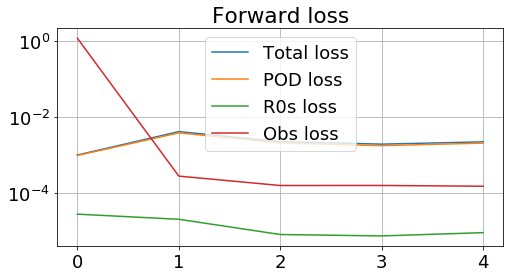

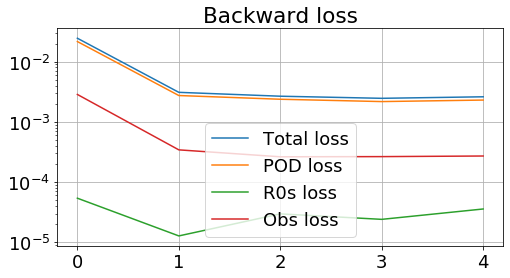

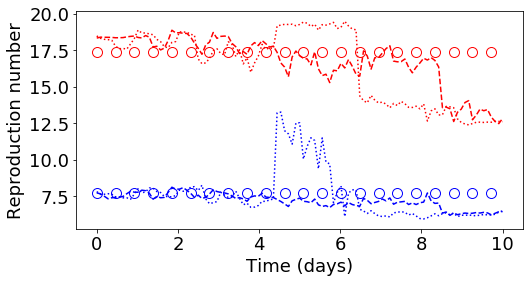

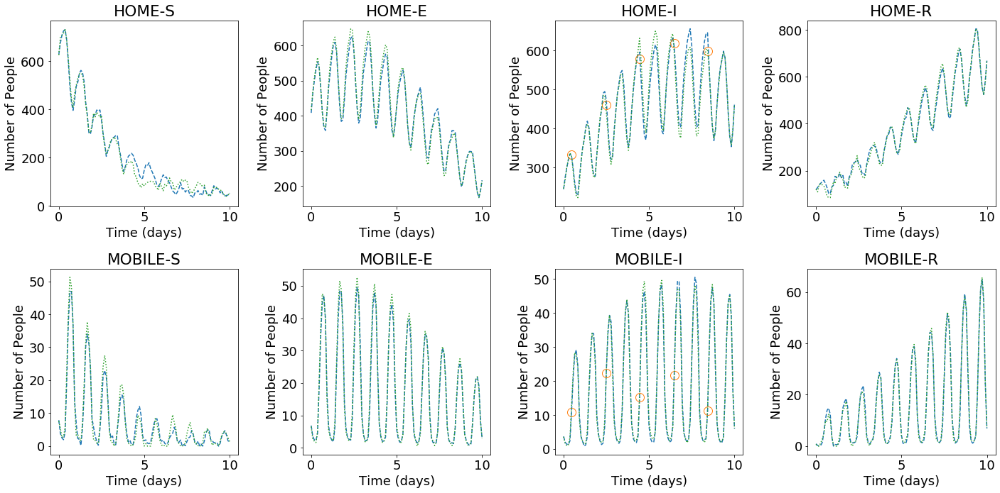

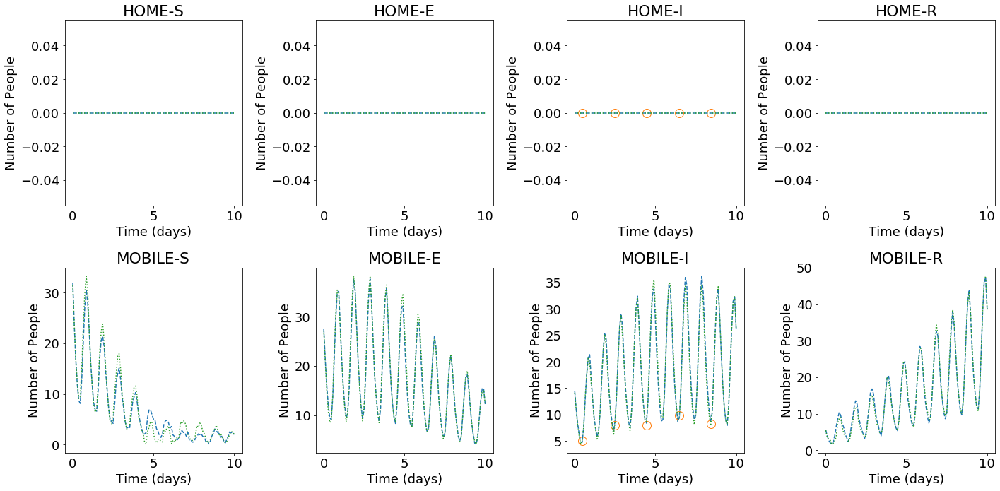

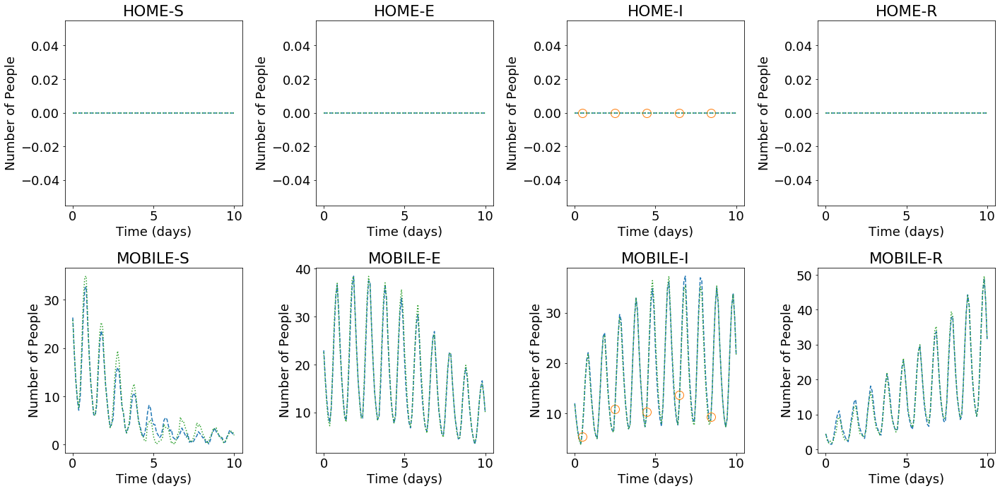

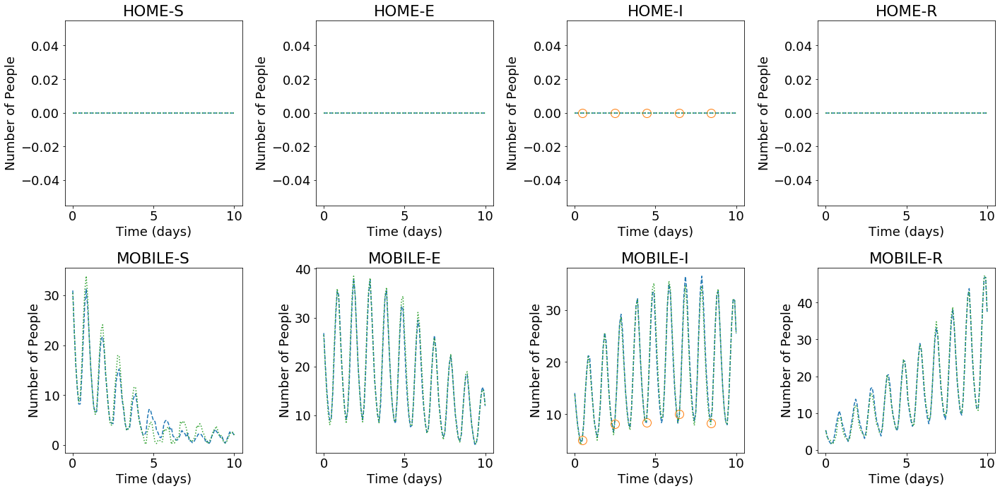

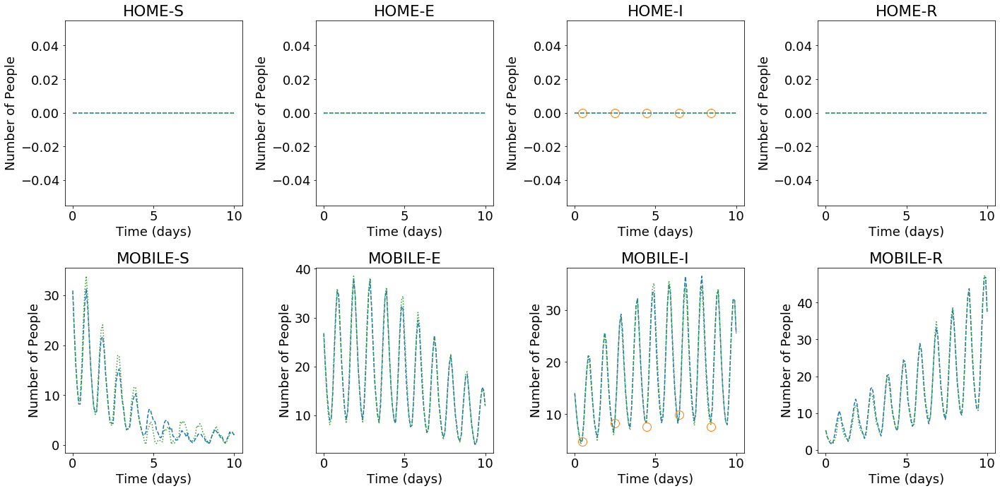


Iteration 5: forward and backward
-- Forward March --
Loss iteration 0: ['3.43e-03', '2.94e-03', '3.20e-06', '4.91e-04']
Loss iteration 1: ['2.84e-03', '2.74e-03', '3.92e-06', '1.04e-04'] - 4s
Loss iteration 2: ['1.95e-03', '1.82e-03', '3.46e-06', '1.20e-04'] - 1s
Loss iteration 3: ['1.59e-03', '1.45e-03', '3.11e-06', '1.40e-04'] - 1s
Loss iteration 4: ['1.79e-03', '1.65e-03', '3.10e-06', '1.38e-04'] - 4s
Loss iteration 5: ['7.70e-03', '3.90e-03', '2.20e-06', '3.80e-03'] - 4s
Loss iteration 6: ['2.20e-03', '2.19e-03', '3.78e-06', '0.00e+00'] - 1s
Loss iteration 7: ['2.17e-03', '2.16e-03', '2.57e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.78e-03', '1.77e-03', '6.05e-06', '0.00e+00'] - 4s
Loss iteration 9: ['1.71e-03', '1.71e-03', '5.31e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.44e-03', '3.43e-03', '1.62e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.58e-03', '1.57e-03', '8.96e-06', '0.00e+00'] - 2s
Loss iteration 12: ['1.94e-03', '1.94e-03', '5.51e-06', '0.00e+00'] - 4s
Loss iterat

Loss iteration 11: ['1.07e-03', '9.70e-04', '3.53e-06', '9.18e-05'] - 1s
Loss iteration 12: ['9.50e-04', '9.05e-04', '2.51e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.69e-04', '7.29e-04', '1.28e-06', '3.89e-05'] - 1s
Loss iteration 14: ['8.08e-04', '7.63e-04', '2.33e-06', '4.26e-05'] - 4s
Loss iteration 15: ['7.64e-04', '7.06e-04', '2.02e-06', '5.61e-05'] - 4s
Loss iteration 16: ['6.84e-04', '6.28e-04', '2.46e-06', '5.34e-05'] - 1s
Loss iteration 17: ['9.76e-04', '9.24e-04', '4.03e-06', '4.76e-05'] - 1s
Loss iteration 18: ['8.72e-04', '8.69e-04', '3.23e-06', '0.00e+00'] - 1s
Loss iteration 19: ['8.32e-04', '8.30e-04', '2.06e-06', '0.00e+00'] - 4s
Loss iteration 20: ['8.06e-04', '8.03e-04', '2.76e-06', '0.00e+00'] - 2s
Loss iteration 21: ['1.21e-03', '1.20e-03', '1.17e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.82e-04', '8.81e-04', '9.93e-07', '0.00e+00'] - 1s
Loss iteration 23: ['8.84e-04', '8.83e-04', '6.42e-07', '0.00e+00'] - 4s
Loss iteration 24: ['6.19e-04', '6.19e-04', '3.79e-

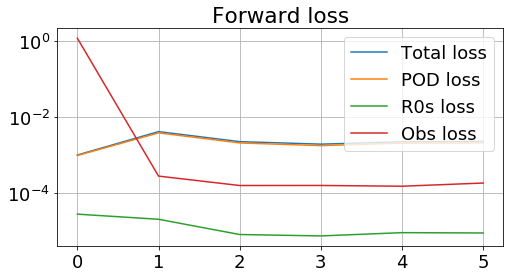

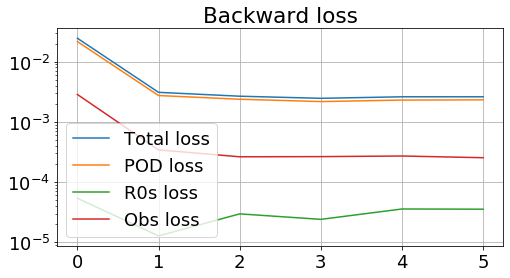

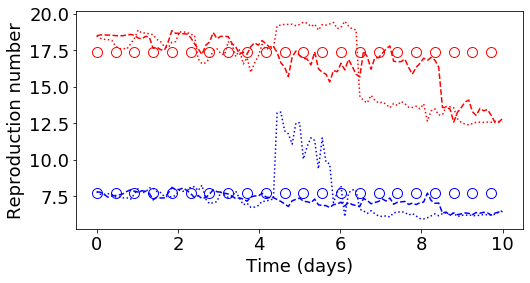

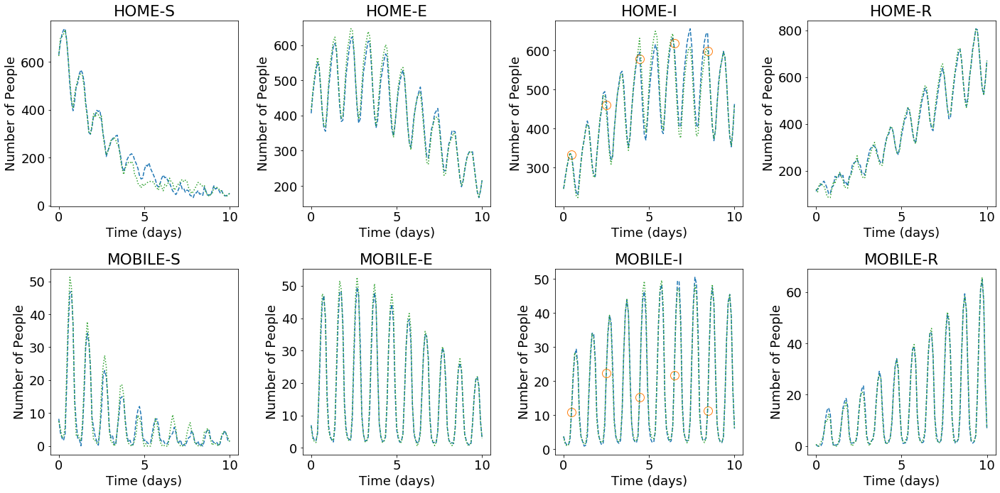

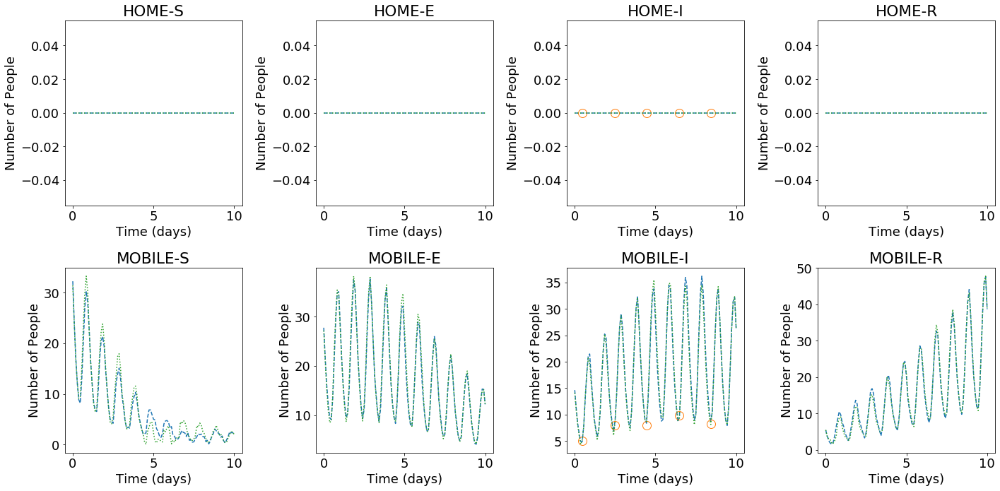

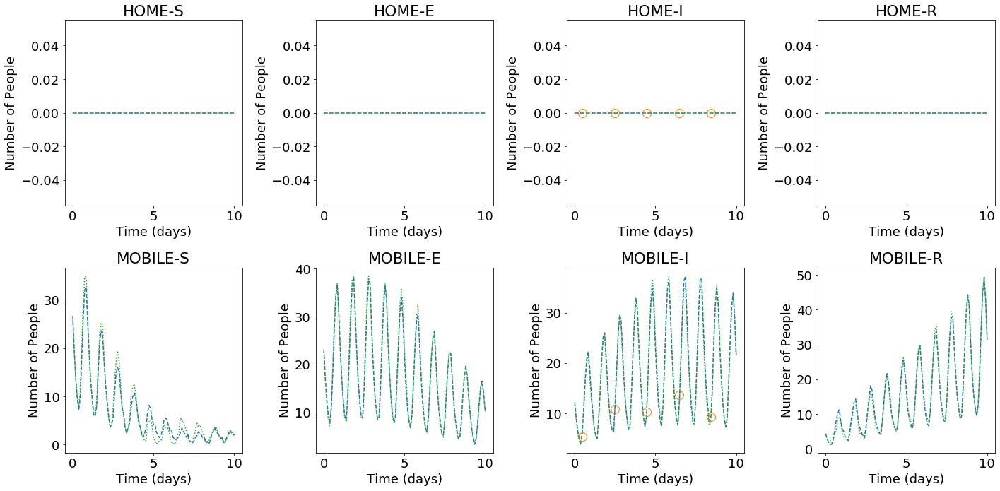

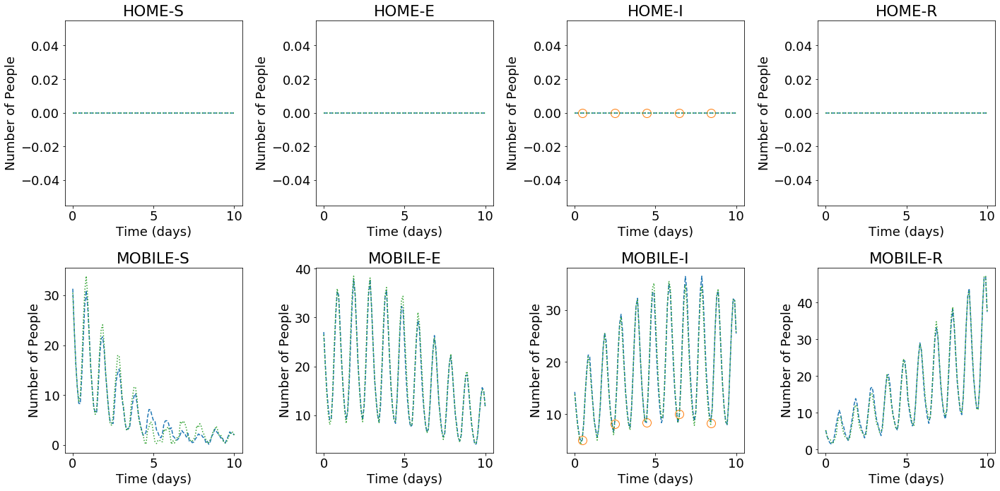

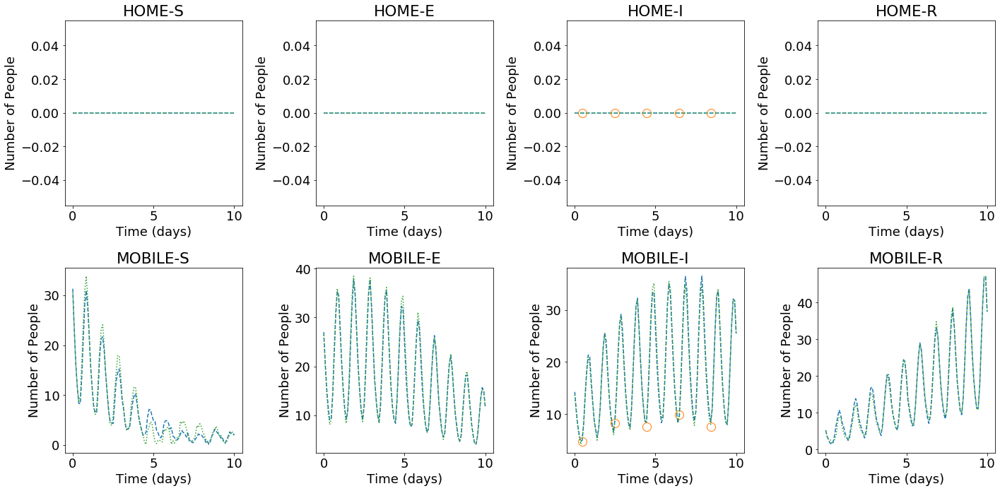


Iteration 6: forward and backward
-- Forward March --
Loss iteration 0: ['3.44e-03', '2.96e-03', '3.23e-06', '4.75e-04']
Loss iteration 1: ['5.79e-03', '3.43e-03', '5.25e-06', '2.36e-03'] - 4s
Loss iteration 2: ['2.07e-03', '1.96e-03', '3.65e-06', '1.06e-04'] - 1s
Loss iteration 3: ['1.67e-03', '1.55e-03', '3.01e-06', '1.23e-04'] - 1s
Loss iteration 4: ['2.03e-03', '1.86e-03', '2.86e-06', '1.65e-04'] - 1s
Loss iteration 5: ['6.49e-03', '5.73e-03', '2.83e-06', '7.58e-04'] - 1s
Loss iteration 6: ['2.37e-03', '2.37e-03', '3.71e-06', '0.00e+00'] - 1s
Loss iteration 7: ['2.32e-03', '2.31e-03', '2.51e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.89e-03', '1.89e-03', '6.58e-06', '0.00e+00'] - 1s
Loss iteration 9: ['1.84e-03', '1.84e-03', '4.17e-06', '0.00e+00'] - 1s
Loss iteration 10: ['3.48e-03', '3.48e-03', '1.61e-06', '0.00e+00'] - 2s
Loss iteration 11: ['1.56e-03', '1.55e-03', '8.71e-06', '0.00e+00'] - 4s
Loss iteration 12: ['2.00e-03', '2.00e-03', '5.51e-06', '0.00e+00'] - 3s
Loss iterat

Loss iteration 11: ['1.07e-03', '9.77e-04', '3.46e-06', '8.90e-05'] - 1s
Loss iteration 12: ['9.49e-04', '9.05e-04', '2.75e-06', '4.17e-05'] - 4s
Loss iteration 13: ['7.70e-04', '7.29e-04', '1.48e-06', '3.90e-05'] - 1s
Loss iteration 14: ['8.04e-04', '7.58e-04', '2.74e-06', '4.30e-05'] - 4s
Loss iteration 15: ['7.61e-04', '7.07e-04', '2.20e-06', '5.21e-05'] - 4s
Loss iteration 16: ['6.73e-04', '6.12e-04', '2.94e-06', '5.81e-05'] - 1s
Loss iteration 17: ['1.82e-03', '1.74e-03', '4.82e-06', '7.76e-05'] - 3s
Loss iteration 18: ['8.74e-04', '8.71e-04', '3.02e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.18e-04', '8.16e-04', '2.24e-06', '0.00e+00'] - 3s
Loss iteration 20: ['8.05e-04', '8.02e-04', '2.89e-06', '0.00e+00'] - 2s
Loss iteration 21: ['9.21e-04', '9.19e-04', '1.17e-06', '0.00e+00'] - 3s
Loss iteration 22: ['1.11e-03', '1.11e-03', '8.03e-07', '0.00e+00'] - 4s
Loss iteration 23: ['8.64e-04', '8.63e-04', '8.06e-07', '0.00e+00'] - 4s
Loss iteration 24: ['5.99e-04', '5.98e-04', '3.13e-

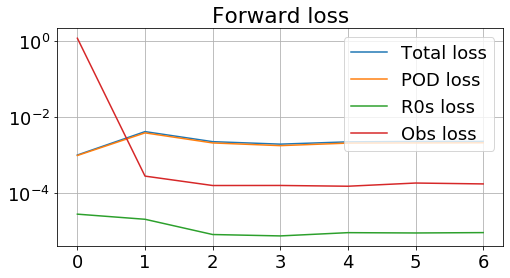

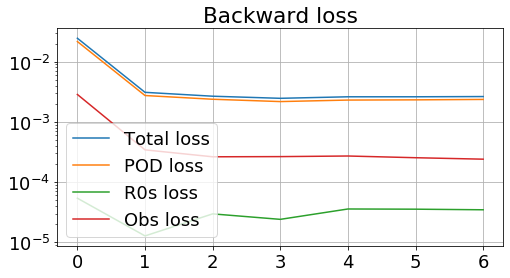

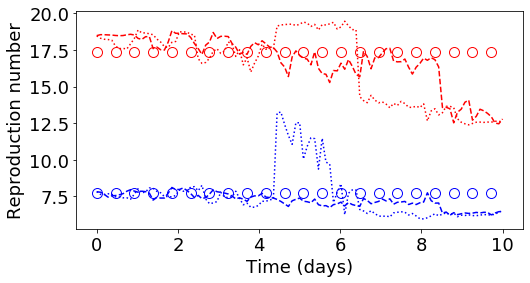

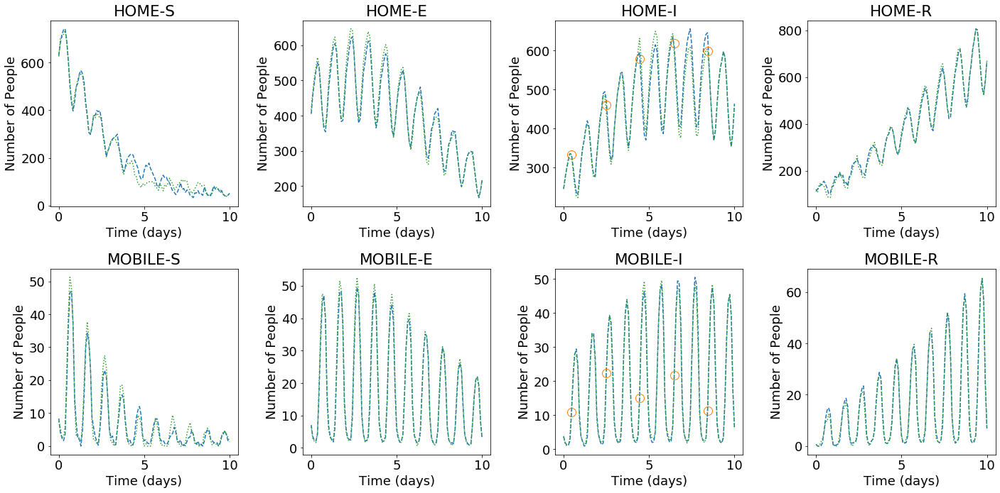

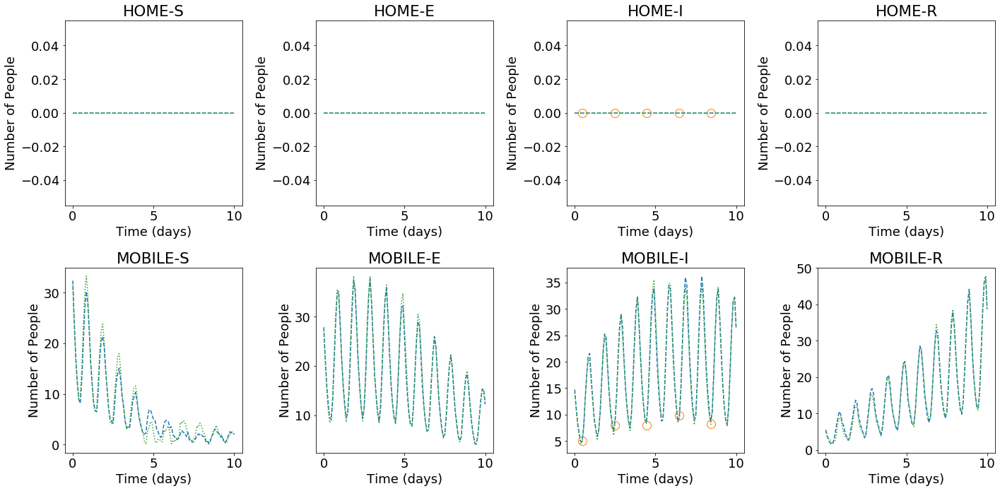

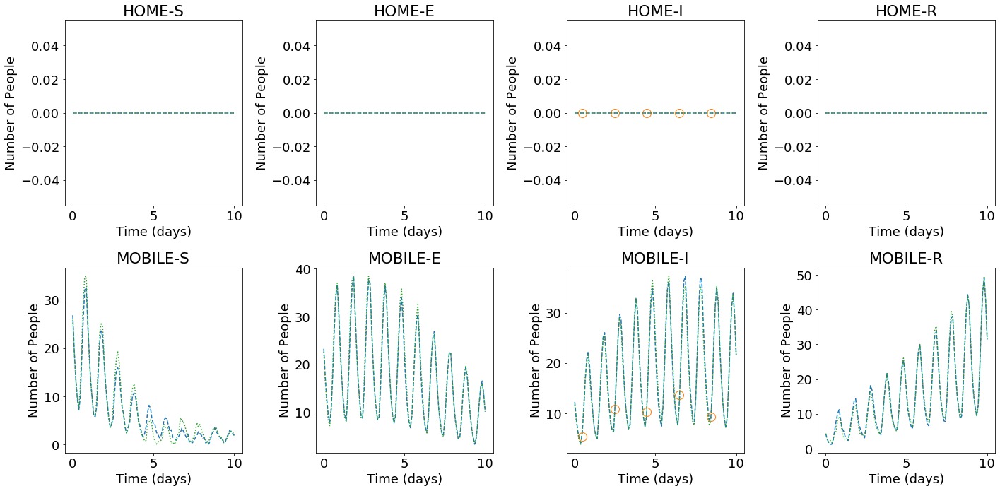

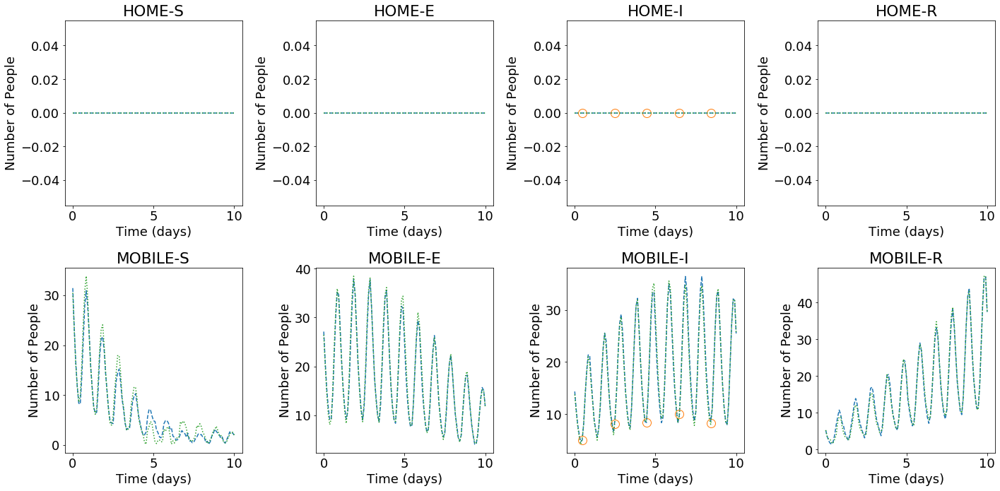

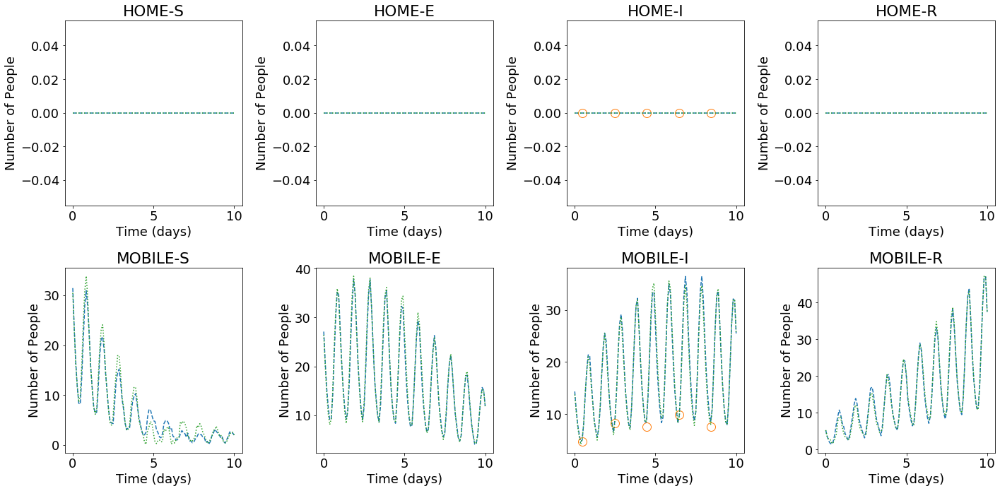


Iteration 7: forward and backward
-- Forward March --
Loss iteration 0: ['3.45e-03', '2.96e-03', '3.90e-06', '4.89e-04']
Loss iteration 1: ['2.85e-03', '2.72e-03', '4.46e-06', '1.20e-04'] - 4s
Loss iteration 2: ['1.94e-03', '1.82e-03', '4.13e-06', '1.17e-04'] - 1s
Loss iteration 3: ['1.58e-03', '1.44e-03', '3.78e-06', '1.36e-04'] - 2s
Loss iteration 4: ['1.80e-03', '1.66e-03', '3.80e-06', '1.41e-04'] - 4s
Loss iteration 5: ['5.10e-03', '4.85e-03', '2.55e-06', '2.47e-04'] - 4s
Loss iteration 6: ['2.25e-03', '2.24e-03', '4.08e-06', '0.00e+00'] - 1s
Loss iteration 7: ['2.16e-03', '2.15e-03', '3.15e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.77e-03', '1.76e-03', '7.26e-06', '0.00e+00'] - 4s
Loss iteration 9: ['1.70e-03', '1.70e-03', '6.32e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.51e-03', '3.51e-03', '1.98e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.57e-03', '1.56e-03', '1.07e-05', '0.00e+00'] - 3s
Loss iteration 12: ['1.93e-03', '1.92e-03', '6.59e-06', '0.00e+00'] - 3s
Loss iterat

Loss iteration 11: ['1.05e-03', '9.53e-04', '4.25e-06', '9.00e-05'] - 4s
Loss iteration 12: ['9.53e-04', '9.08e-04', '2.59e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.72e-04', '7.31e-04', '1.69e-06', '3.88e-05'] - 1s
Loss iteration 14: ['8.11e-04', '7.65e-04', '3.22e-06', '4.31e-05'] - 4s
Loss iteration 15: ['8.28e-04', '7.74e-04', '2.64e-06', '5.14e-05'] - 4s
Loss iteration 16: ['6.59e-04', '6.00e-04', '6.04e-06', '5.34e-05'] - 3s
Loss iteration 17: ['1.07e-03', '1.02e-03', '5.65e-06', '4.99e-05'] - 4s
Loss iteration 18: ['8.31e-04', '8.27e-04', '3.45e-06', '0.00e+00'] - 3s
Loss iteration 19: ['8.29e-04', '8.27e-04', '2.74e-06', '0.00e+00'] - 3s
Loss iteration 20: ['7.97e-04', '7.93e-04', '3.30e-06', '0.00e+00'] - 2s
Loss iteration 21: ['9.48e-04', '9.47e-04', '1.28e-06', '0.00e+00'] - 2s
Loss iteration 22: ['8.20e-04', '8.19e-04', '9.30e-07', '0.00e+00'] - 3s
Loss iteration 23: ['9.25e-04', '9.24e-04', '9.22e-07', '0.00e+00'] - 3s
Loss iteration 24: ['5.89e-04', '5.89e-04', '3.61e-

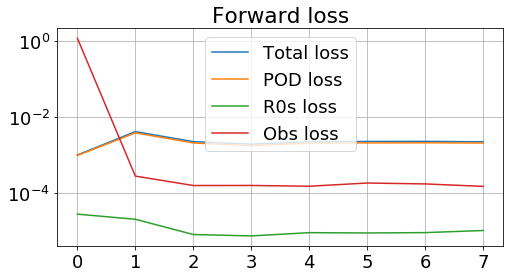

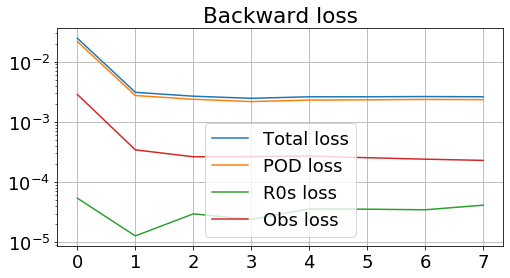

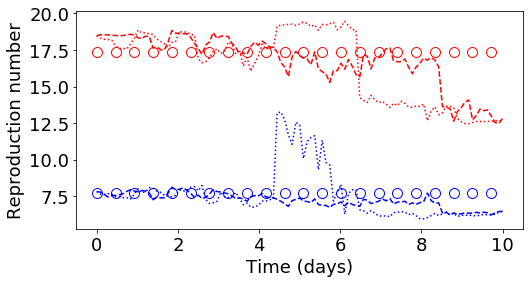

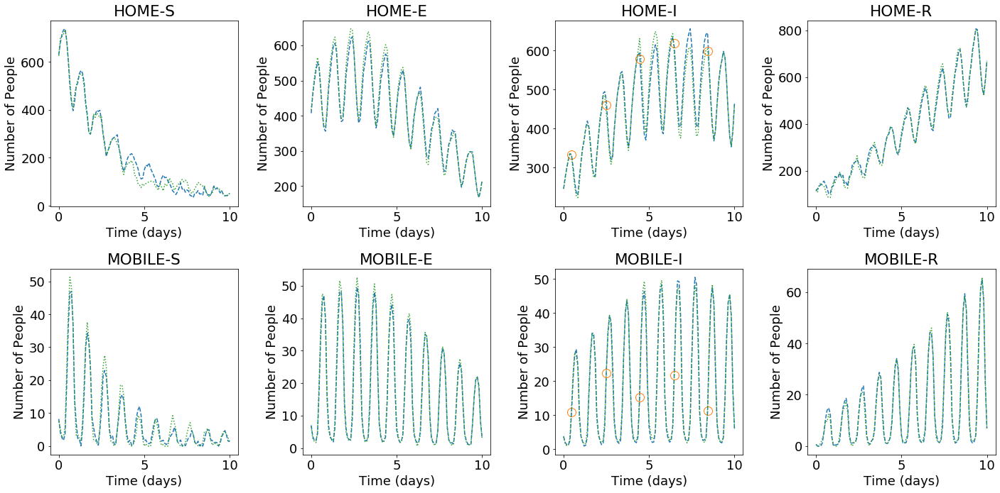

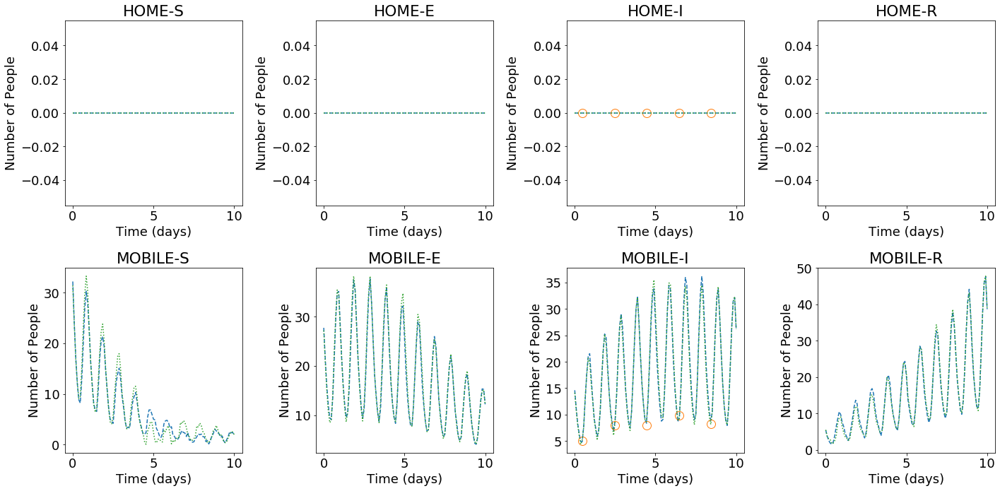

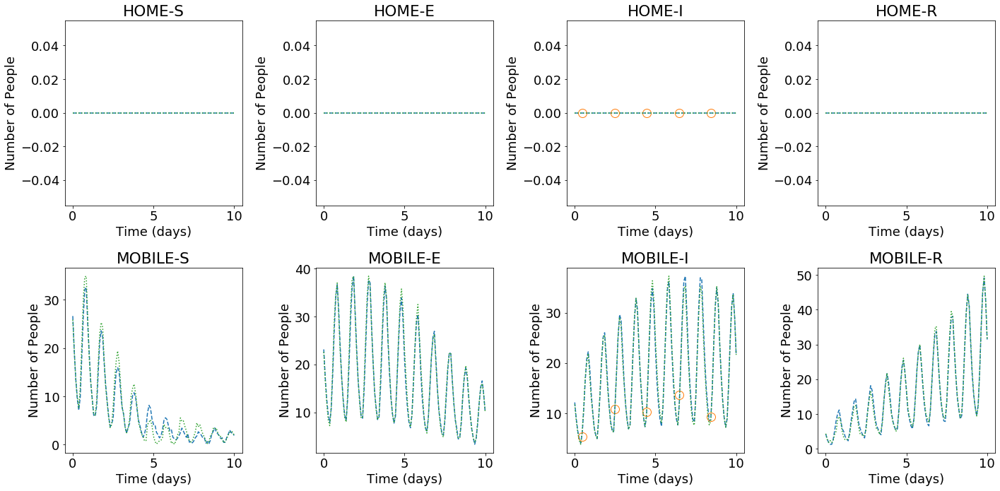

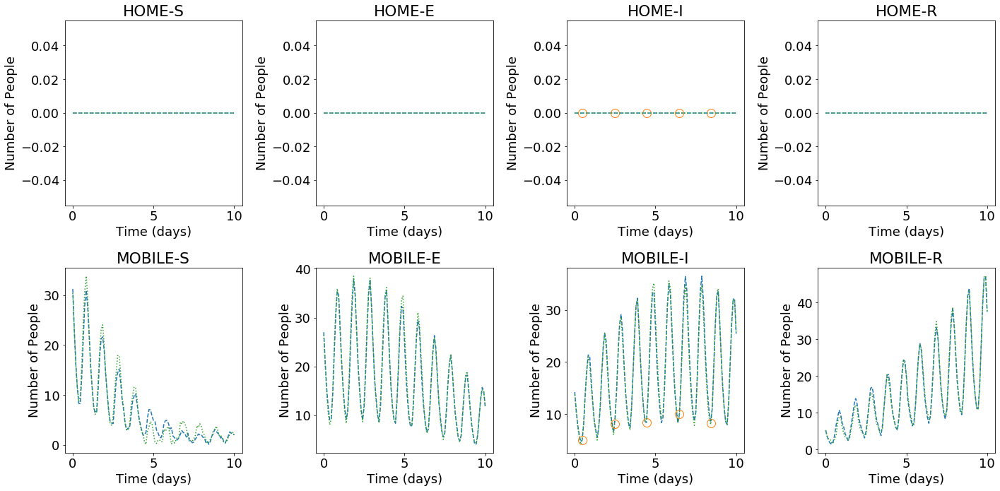

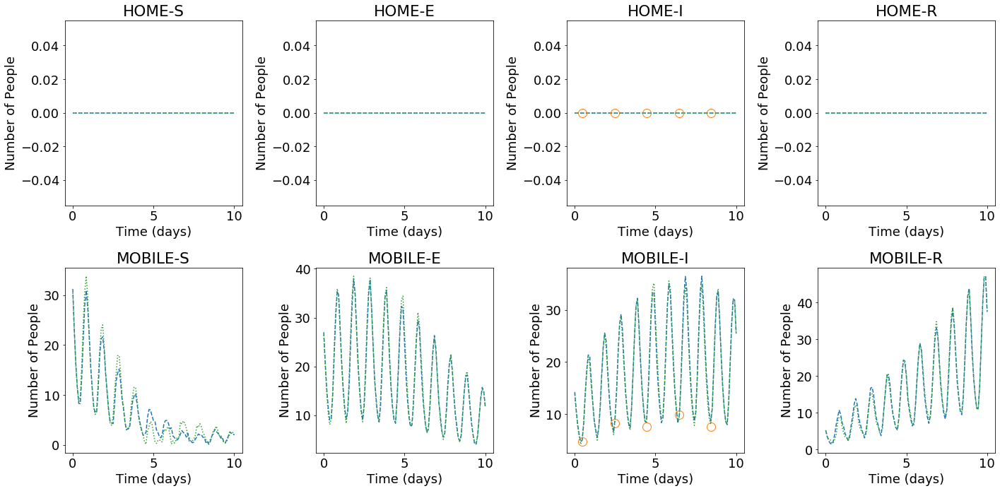


Iteration 8: forward and backward
-- Forward March --
Loss iteration 0: ['3.46e-03', '2.97e-03', '4.69e-06', '4.88e-04']
Loss iteration 1: ['2.87e-03', '2.72e-03', '4.37e-06', '1.44e-04'] - 3s
Loss iteration 2: ['1.83e-03', '1.69e-03', '4.35e-06', '1.36e-04'] - 1s
Loss iteration 3: ['1.52e-03', '1.36e-03', '4.47e-06', '1.55e-04'] - 1s
Loss iteration 4: ['1.72e-03', '1.57e-03', '4.74e-06', '1.46e-04'] - 1s
Loss iteration 5: ['4.94e-03', '4.44e-03', '3.21e-06', '4.99e-04'] - 4s
Loss iteration 6: ['2.14e-03', '2.14e-03', '4.67e-06', '0.00e+00'] - 1s
Loss iteration 7: ['1.96e-03', '1.96e-03', '3.53e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.76e-03', '1.75e-03', '8.04e-06', '0.00e+00'] - 2s
Loss iteration 9: ['1.76e-03', '1.75e-03', '6.72e-06', '0.00e+00'] - 4s
Loss iteration 10: ['3.91e-03', '3.91e-03', '2.32e-06', '0.00e+00'] - 1s
Loss iteration 11: ['1.65e-03', '1.64e-03', '1.28e-05', '0.00e+00'] - 4s
Loss iteration 12: ['1.88e-03', '1.87e-03', '7.82e-06', '0.00e+00'] - 4s
Loss iterat

Loss iteration 11: ['1.07e-03', '9.70e-04', '4.53e-06', '9.09e-05'] - 1s
Loss iteration 12: ['9.45e-04', '9.00e-04', '2.58e-06', '4.20e-05'] - 4s
Loss iteration 13: ['7.43e-04', '7.02e-04', '1.68e-06', '3.90e-05'] - 4s
Loss iteration 14: ['8.70e-04', '8.20e-04', '1.77e-06', '4.75e-05'] - 1s
Loss iteration 15: ['7.74e-04', '7.13e-04', '3.11e-06', '5.80e-05'] - 4s
Loss iteration 16: ['6.77e-04', '6.17e-04', '6.75e-06', '5.36e-05'] - 4s
Loss iteration 17: ['9.48e-04', '8.97e-04', '6.76e-06', '4.40e-05'] - 4s
Loss iteration 18: ['1.15e-03', '1.14e-03', '4.15e-06', '0.00e+00'] - 3s
Loss iteration 19: ['8.62e-04', '8.58e-04', '3.60e-06', '0.00e+00'] - 1s
Loss iteration 20: ['8.27e-04', '8.22e-04', '4.98e-06', '0.00e+00'] - 1s
Loss iteration 21: ['9.67e-04', '9.66e-04', '1.63e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.07e-04', '8.06e-04', '1.06e-06', '0.00e+00'] - 3s
Loss iteration 23: ['8.77e-04', '8.76e-04', '9.99e-07', '0.00e+00'] - 4s
Loss iteration 24: ['6.33e-04', '6.33e-04', '4.98e-

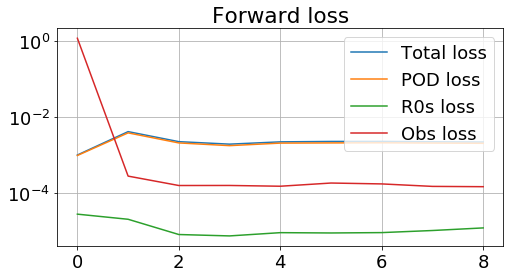

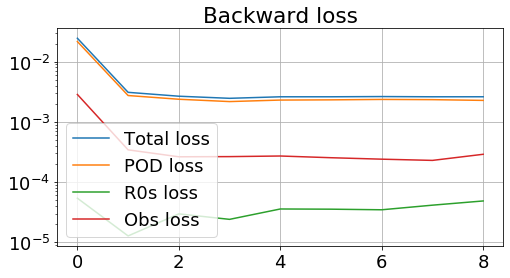

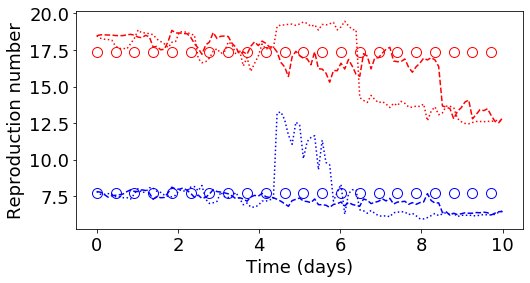

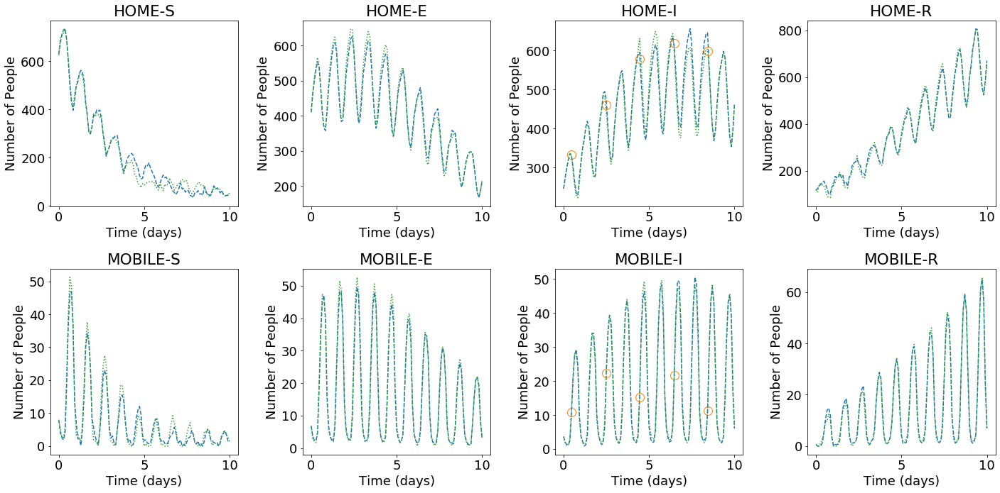

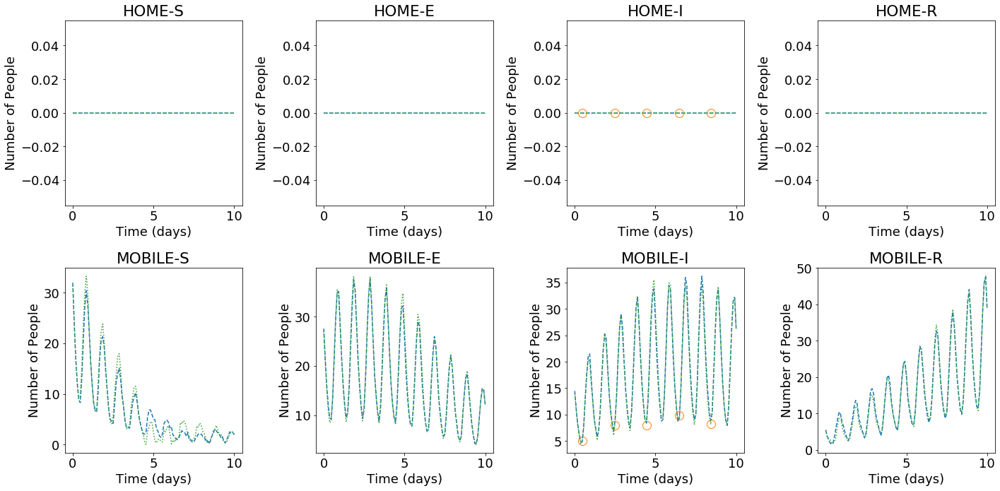

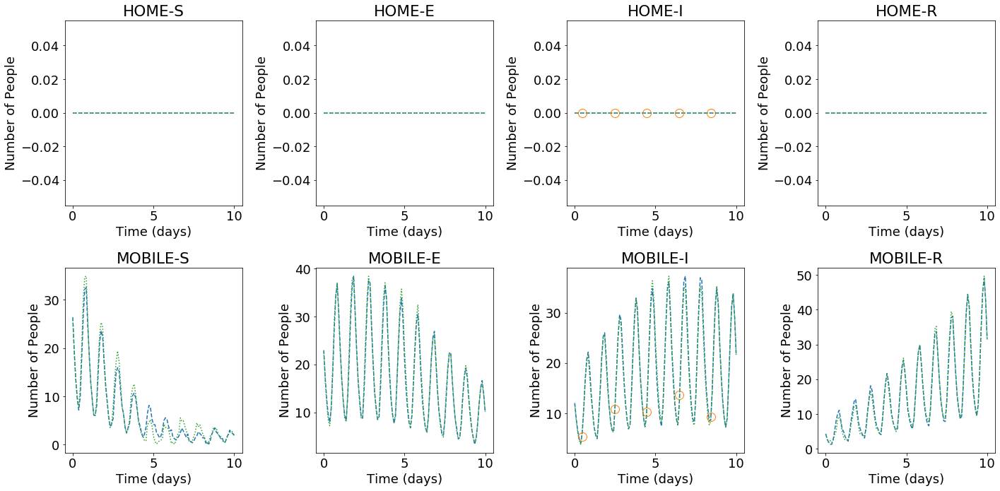

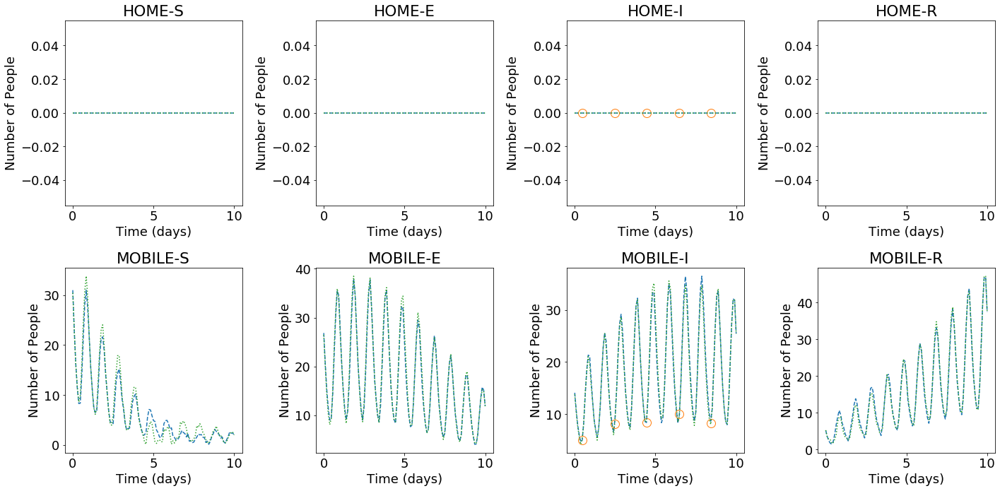

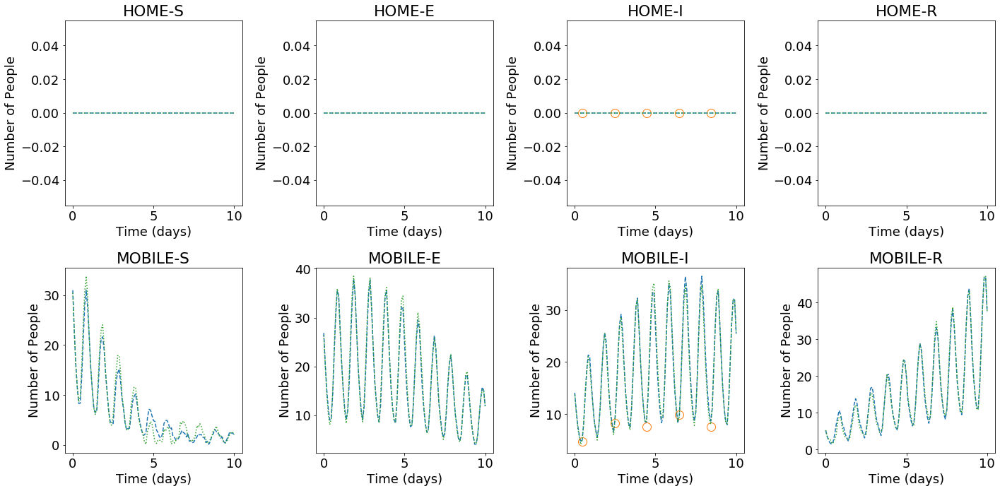


Iteration 9: forward and backward
-- Forward March --
Loss iteration 0: ['3.45e-03', '2.97e-03', '4.66e-06', '4.78e-04']
Loss iteration 1: ['2.84e-03', '2.71e-03', '4.76e-06', '1.23e-04'] - 4s
Loss iteration 2: ['1.88e-03', '1.75e-03', '4.67e-06', '1.24e-04'] - 1s
Loss iteration 3: ['1.54e-03', '1.39e-03', '4.52e-06', '1.46e-04'] - 1s
Loss iteration 4: ['1.73e-03', '1.58e-03', '4.71e-06', '1.41e-04'] - 4s
Loss iteration 5: ['5.20e-03', '4.04e-03', '3.09e-06', '1.16e-03'] - 4s
Loss iteration 6: ['2.12e-03', '2.12e-03', '4.89e-06', '0.00e+00'] - 4s
Loss iteration 7: ['2.04e-03', '2.04e-03', '3.66e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.79e-03', '1.78e-03', '8.66e-06', '0.00e+00'] - 1s
Loss iteration 9: ['1.74e-03', '1.73e-03', '7.16e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.60e-03', '3.60e-03', '2.47e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.61e-03', '1.60e-03', '1.30e-05', '0.00e+00'] - 2s
Loss iteration 12: ['1.90e-03', '1.90e-03', '7.86e-06', '0.00e+00'] - 4s
Loss iterat

Loss iteration 11: ['1.07e-03', '9.71e-04', '5.29e-06', '8.99e-05'] - 1s
Loss iteration 12: ['9.49e-04', '9.04e-04', '3.45e-06', '4.17e-05'] - 4s
Loss iteration 13: ['7.69e-04', '7.29e-04', '1.83e-06', '3.88e-05'] - 1s
Loss iteration 14: ['8.11e-04', '7.64e-04', '3.39e-06', '4.30e-05'] - 4s
Loss iteration 15: ['8.60e-04', '8.06e-04', '2.99e-06', '5.12e-05'] - 4s
Loss iteration 16: ['6.71e-04', '6.16e-04', '3.53e-06', '5.16e-05'] - 1s
Loss iteration 17: ['9.29e-04', '8.78e-04', '6.60e-06', '4.42e-05'] - 4s
Loss iteration 18: ['8.26e-04', '8.22e-04', '3.97e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.35e-04', '8.31e-04', '3.52e-06', '0.00e+00'] - 1s
Loss iteration 20: ['8.04e-04', '8.00e-04', '3.98e-06', '0.00e+00'] - 2s
Loss iteration 21: ['9.12e-04', '9.11e-04', '1.52e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.33e-04', '8.32e-04', '1.11e-06', '0.00e+00'] - 3s
Loss iteration 23: ['8.17e-04', '8.16e-04', '1.12e-06', '0.00e+00'] - 4s
Loss iteration 24: ['5.88e-04', '5.88e-04', '4.27e-

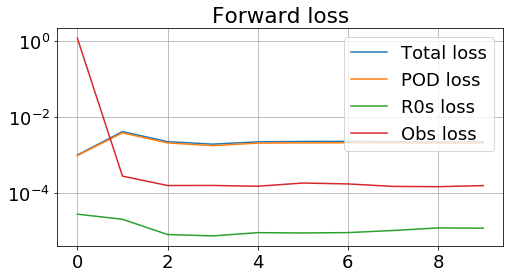

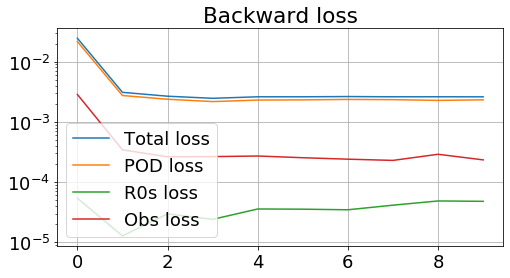

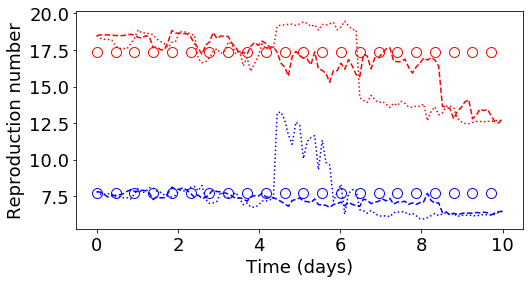

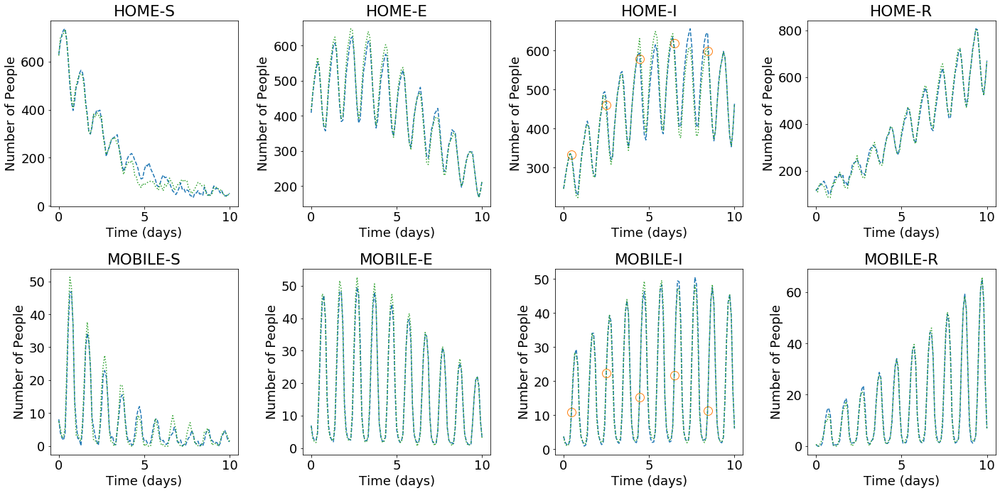

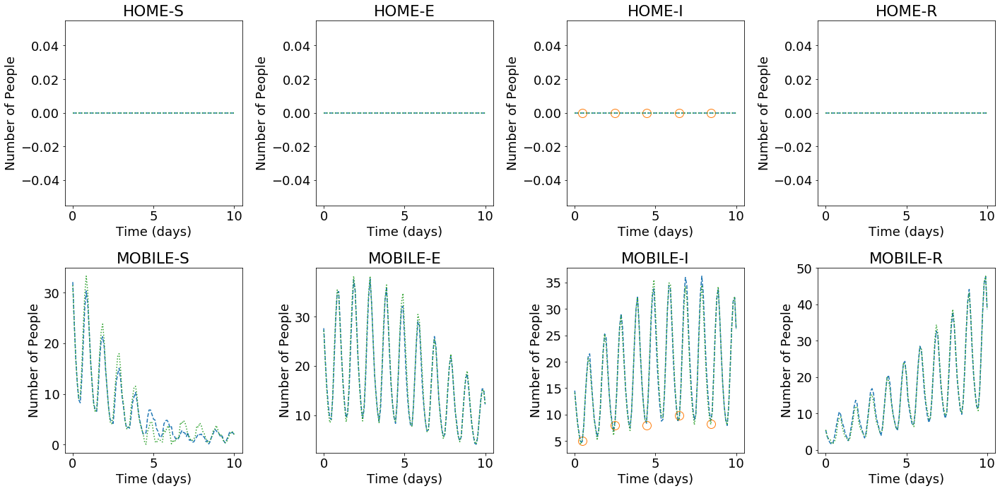

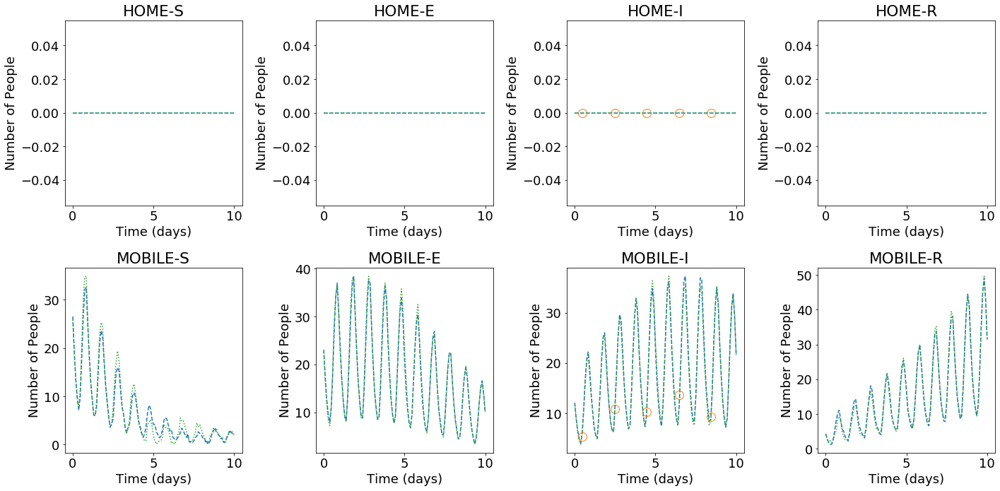

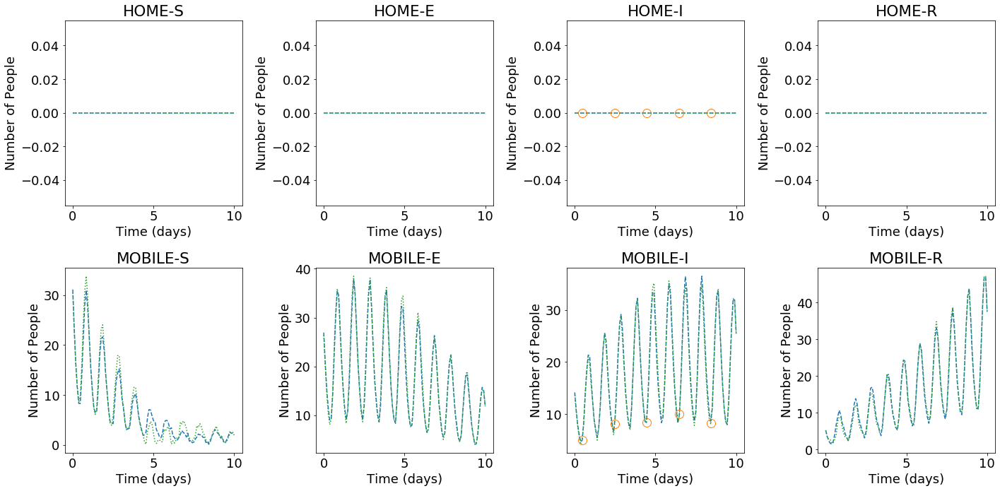

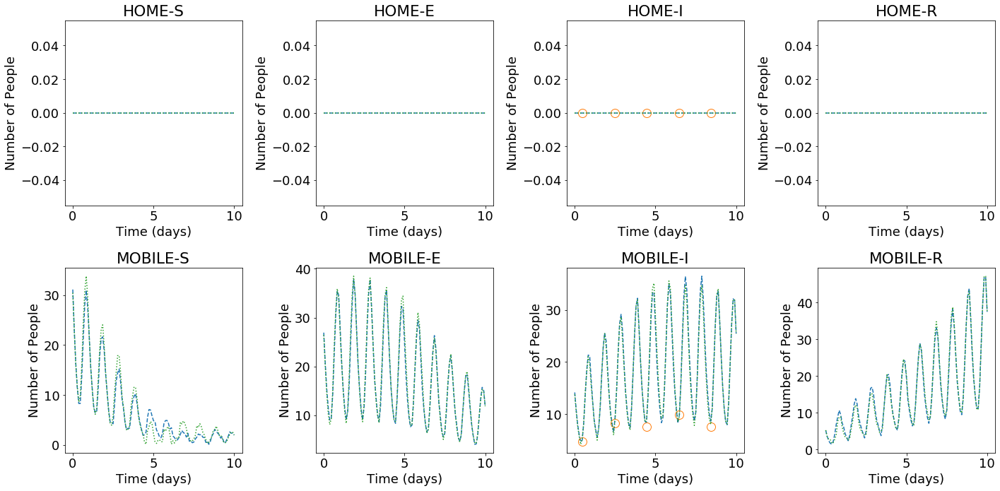


Iteration 10: forward and backward
-- Forward March --
Loss iteration 0: ['3.37e-03', '2.89e-03', '4.47e-06', '4.76e-04']
Loss iteration 1: ['2.97e-03', '2.86e-03', '6.03e-06', '1.04e-04'] - 1s
Loss iteration 2: ['1.91e-03', '1.78e-03', '4.88e-06', '1.20e-04'] - 1s
Loss iteration 3: ['1.56e-03', '1.41e-03', '4.47e-06', '1.41e-04'] - 1s
Loss iteration 4: ['1.76e-03', '1.62e-03', '4.62e-06', '1.41e-04'] - 4s
Loss iteration 5: ['5.00e-03', '4.50e-03', '3.10e-06', '4.95e-04'] - 4s
Loss iteration 6: ['2.15e-03', '2.15e-03', '5.03e-06', '0.00e+00'] - 3s
Loss iteration 7: ['2.07e-03', '2.06e-03', '3.83e-06', '0.00e+00'] - 4s
Loss iteration 8: ['1.75e-03', '1.74e-03', '8.56e-06', '0.00e+00'] - 3s
Loss iteration 9: ['1.71e-03', '1.70e-03', '7.42e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.56e-03', '3.55e-03', '2.45e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.58e-03', '1.56e-03', '1.27e-05', '0.00e+00'] - 4s
Loss iteration 12: ['1.91e-03', '1.90e-03', '7.83e-06', '0.00e+00'] - 4s
Loss itera

Loss iteration 11: ['1.05e-03', '9.54e-04', '4.19e-06', '9.03e-05'] - 4s
Loss iteration 12: ['9.54e-04', '9.10e-04', '2.63e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.51e-04', '7.11e-04', '1.73e-06', '3.89e-05'] - 4s
Loss iteration 14: ['8.14e-04', '7.68e-04', '3.83e-06', '4.30e-05'] - 4s
Loss iteration 15: ['8.18e-04', '7.63e-04', '3.15e-06', '5.16e-05'] - 4s
Loss iteration 16: ['6.63e-04', '6.03e-04', '6.28e-06', '5.38e-05'] - 3s
Loss iteration 17: ['9.39e-04', '8.88e-04', '6.75e-06', '4.40e-05'] - 3s
Loss iteration 18: ['8.30e-04', '8.26e-04', '4.13e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.34e-04', '8.31e-04', '3.24e-06', '0.00e+00'] - 3s
Loss iteration 20: ['8.21e-04', '8.16e-04', '5.02e-06', '0.00e+00'] - 1s
Loss iteration 21: ['9.12e-04', '9.11e-04', '1.53e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.22e-04', '8.21e-04', '1.11e-06', '0.00e+00'] - 4s
Loss iteration 23: ['8.37e-04', '8.37e-04', '8.38e-07', '0.00e+00'] - 1s
Loss iteration 24: ['5.90e-04', '5.90e-04', '4.22e-

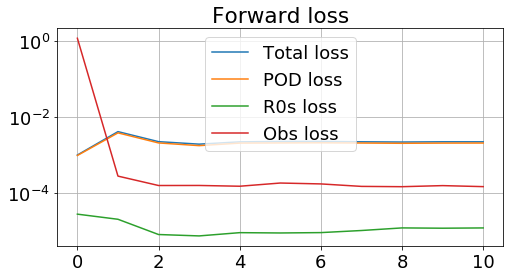

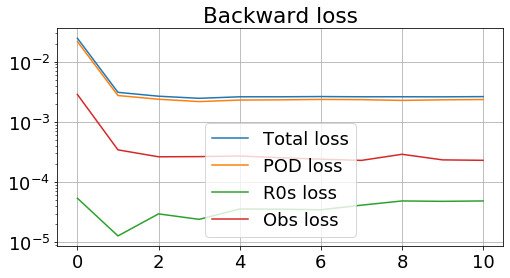

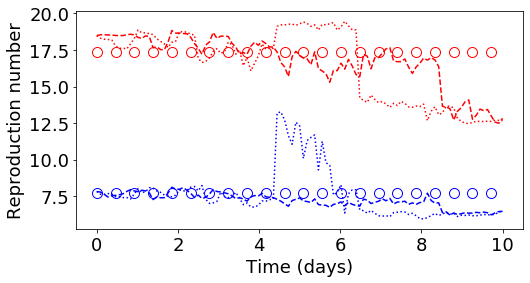

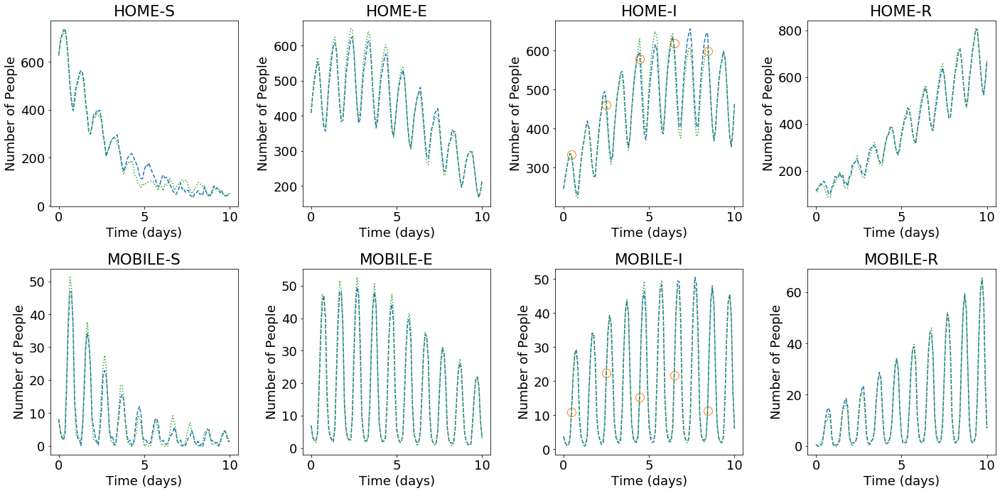

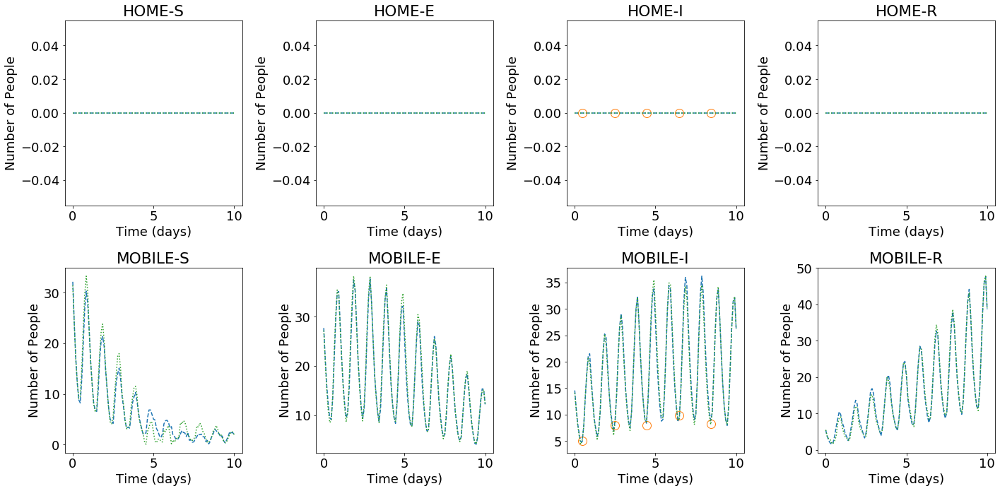

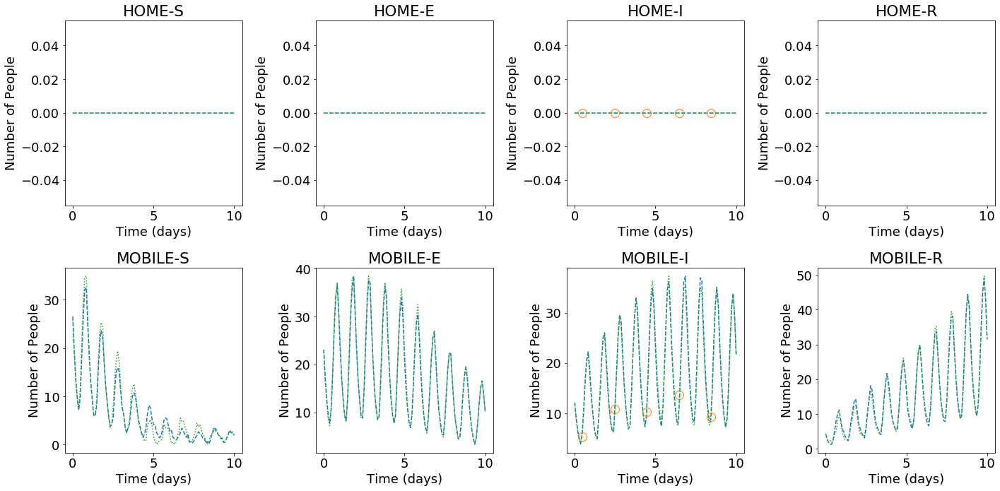

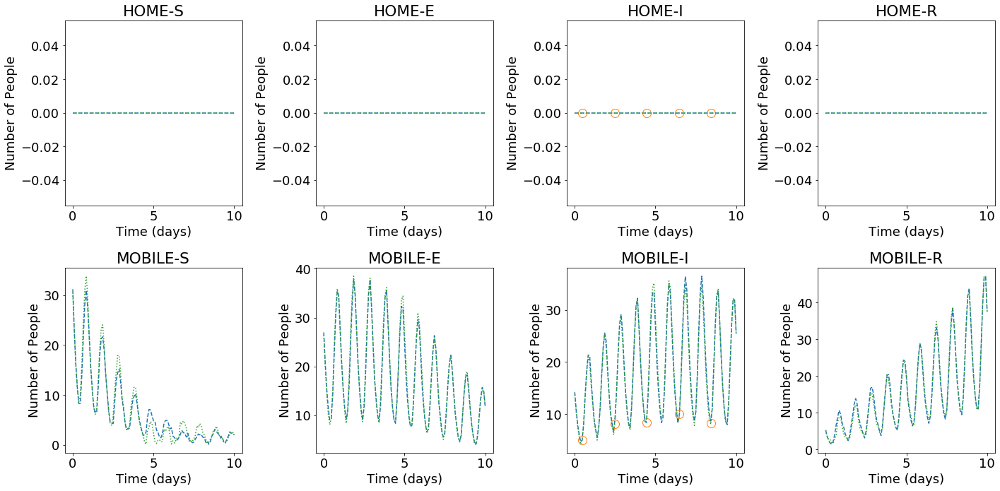

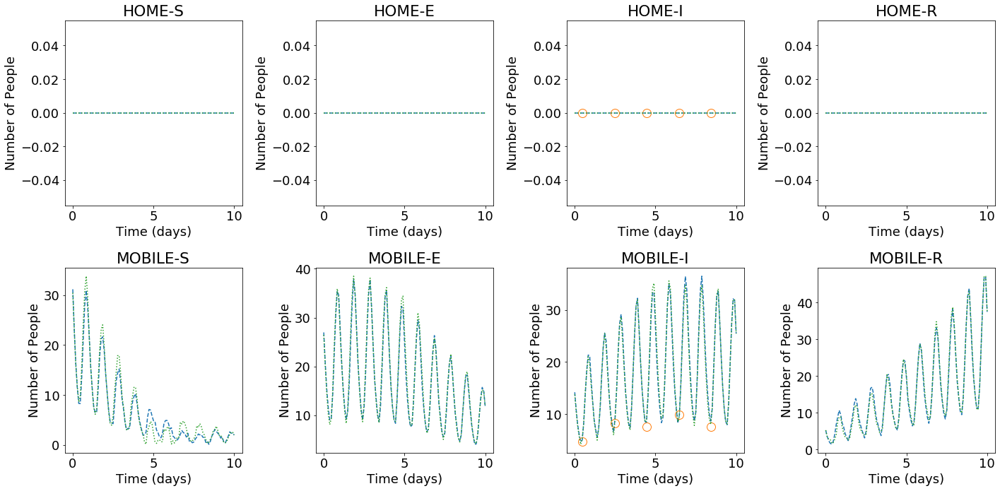


Iteration 11: forward and backward
-- Forward March --
Loss iteration 0: ['3.46e-03', '2.95e-03', '5.58e-06', '5.05e-04']
Loss iteration 1: ['2.84e-03', '2.71e-03', '5.54e-06', '1.26e-04'] - 4s
Loss iteration 2: ['1.86e-03', '1.73e-03', '5.57e-06', '1.28e-04'] - 1s
Loss iteration 3: ['1.54e-03', '1.39e-03', '5.39e-06', '1.43e-04'] - 1s
Loss iteration 4: ['1.78e-03', '1.63e-03', '5.62e-06', '1.50e-04'] - 1s
Loss iteration 5: ['4.97e-03', '4.55e-03', '3.73e-06', '4.18e-04'] - 4s
Loss iteration 6: ['2.18e-03', '2.17e-03', '5.69e-06', '0.00e+00'] - 1s
Loss iteration 7: ['2.03e-03', '2.03e-03', '4.36e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.74e-03', '1.73e-03', '1.00e-05', '0.00e+00'] - 3s
Loss iteration 9: ['1.73e-03', '1.72e-03', '8.67e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.63e-03', '3.62e-03', '2.97e-06', '0.00e+00'] - 4s
Loss iteration 11: ['1.61e-03', '1.59e-03', '1.54e-05', '0.00e+00'] - 3s
Loss iteration 12: ['2.02e-03', '2.01e-03', '9.04e-06', '0.00e+00'] - 1s
Loss itera

Loss iteration 11: ['1.07e-03', '9.72e-04', '5.13e-06', '9.32e-05'] - 1s
Loss iteration 12: ['9.51e-04', '9.07e-04', '2.99e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.70e-04', '7.29e-04', '2.33e-06', '3.89e-05'] - 1s
Loss iteration 14: ['8.11e-04', '7.64e-04', '4.51e-06', '4.30e-05'] - 4s
Loss iteration 15: ['7.85e-04', '7.30e-04', '3.77e-06', '5.18e-05'] - 4s
Loss iteration 16: ['6.74e-04', '6.14e-04', '5.03e-06', '5.47e-05'] - 1s
Loss iteration 17: ['9.33e-04', '8.81e-04', '7.96e-06', '4.43e-05'] - 4s
Loss iteration 18: ['8.29e-04', '8.24e-04', '4.82e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.24e-04', '8.21e-04', '3.71e-06', '0.00e+00'] - 4s
Loss iteration 20: ['7.98e-04', '7.93e-04', '5.21e-06', '0.00e+00'] - 4s
Loss iteration 21: ['1.03e-03', '1.03e-03', '1.90e-06', '0.00e+00'] - 4s
Loss iteration 22: ['8.55e-04', '8.54e-04', '1.32e-06', '0.00e+00'] - 4s
Loss iteration 23: ['8.37e-04', '8.36e-04', '1.00e-06', '0.00e+00'] - 1s
Loss iteration 24: ['6.07e-04', '6.06e-04', '6.04e-

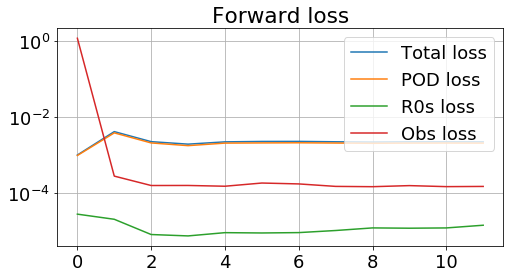

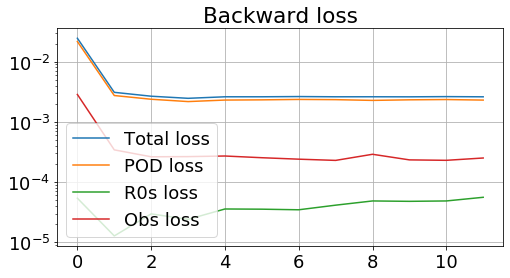

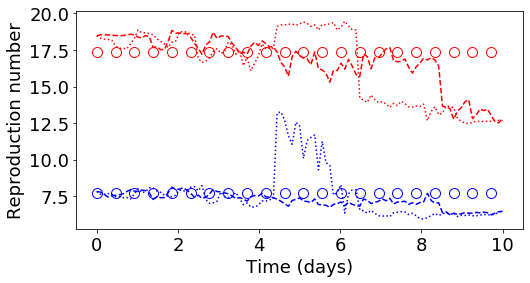

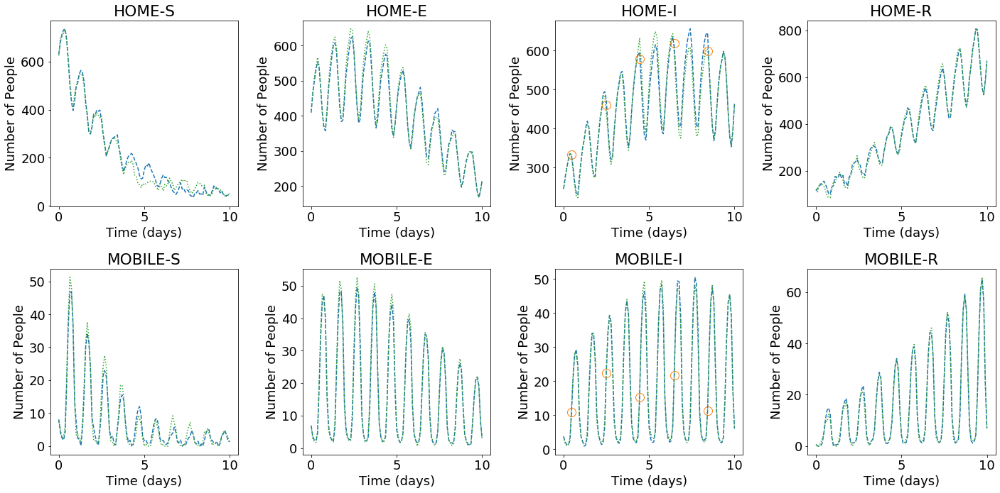

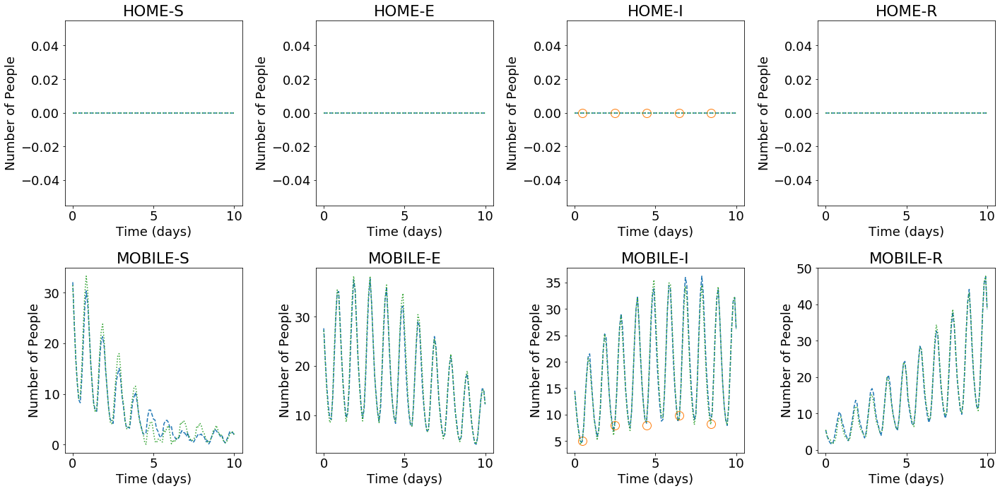

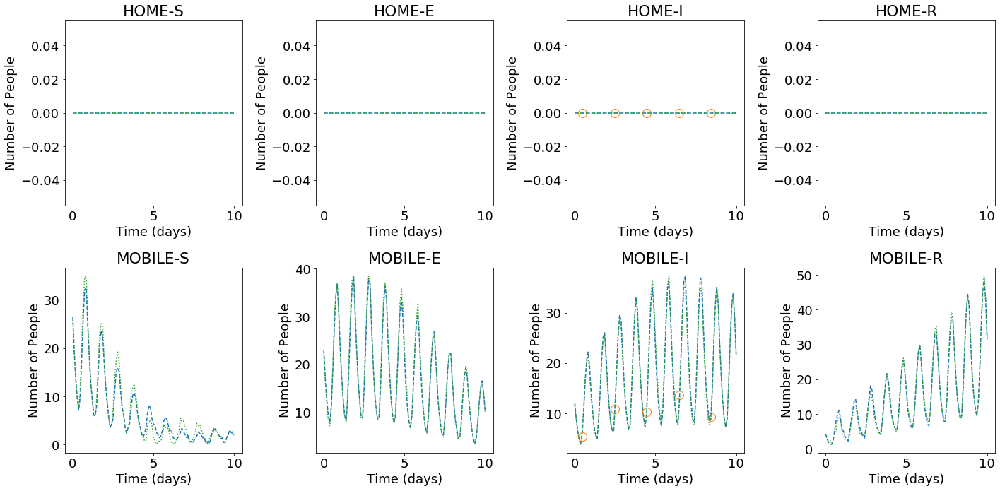

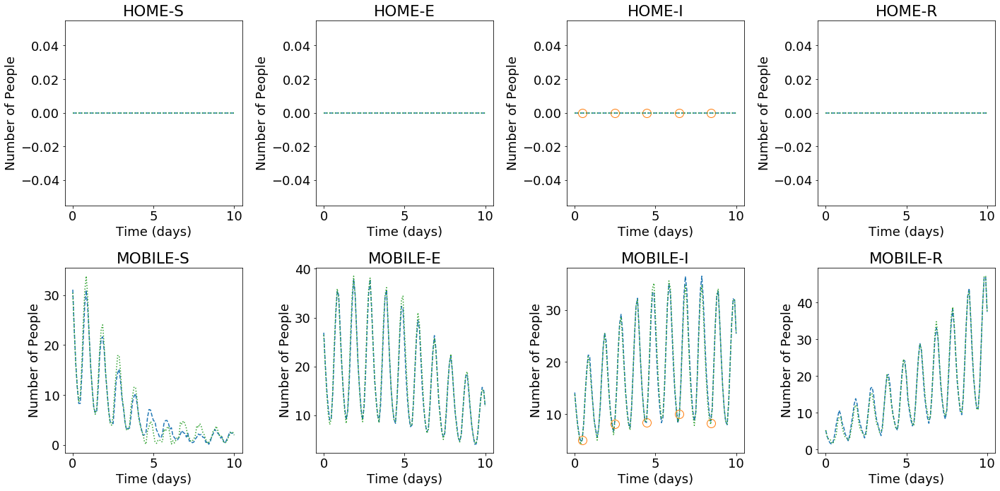

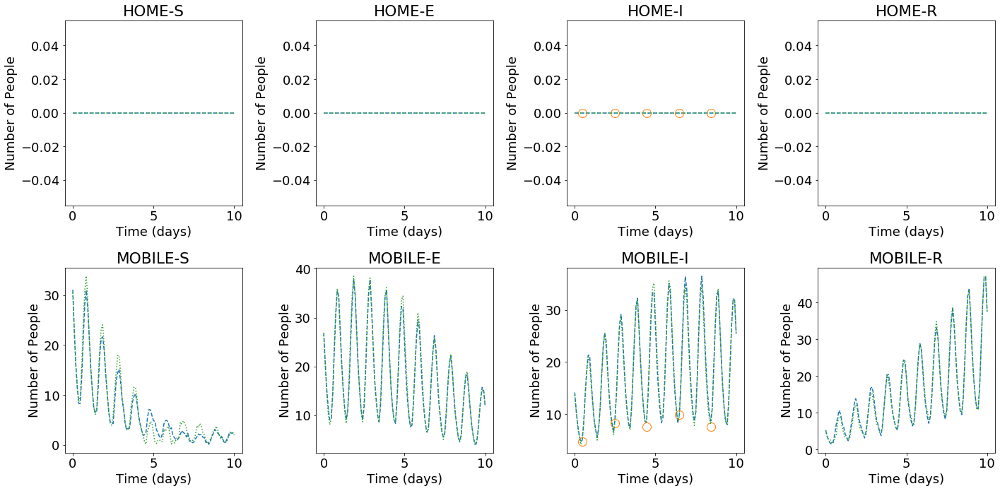


Iteration 12: forward and backward
-- Forward March --
Loss iteration 0: ['3.47e-03', '2.98e-03', '5.59e-06', '4.81e-04']
Loss iteration 1: ['2.83e-03', '2.70e-03', '5.76e-06', '1.29e-04'] - 4s
Loss iteration 2: ['1.89e-03', '1.76e-03', '5.70e-06', '1.22e-04'] - 1s
Loss iteration 3: ['1.55e-03', '1.40e-03', '5.35e-06', '1.40e-04'] - 1s
Loss iteration 4: ['1.74e-03', '1.59e-03', '5.58e-06', '1.42e-04'] - 4s
Loss iteration 5: ['4.98e-03', '4.47e-03', '3.73e-06', '5.06e-04'] - 4s
Loss iteration 6: ['2.13e-03', '2.13e-03', '5.91e-06', '0.00e+00'] - 4s
Loss iteration 7: ['2.06e-03', '2.06e-03', '4.41e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.77e-03', '1.76e-03', '1.02e-05', '0.00e+00'] - 2s
Loss iteration 9: ['1.72e-03', '1.71e-03', '8.80e-06', '0.00e+00'] - 4s
Loss iteration 10: ['3.59e-03', '3.59e-03', '2.95e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.59e-03', '1.58e-03', '1.54e-05', '0.00e+00'] - 4s
Loss iteration 12: ['2.03e-03', '2.02e-03', '9.03e-06', '0.00e+00'] - 1s
Loss itera

Loss iteration 11: ['1.07e-03', '9.71e-04', '4.45e-06', '9.12e-05'] - 2s
Loss iteration 12: ['9.54e-04', '9.09e-04', '2.97e-06', '4.19e-05'] - 4s
Loss iteration 13: ['7.74e-04', '7.33e-04', '2.26e-06', '3.88e-05'] - 1s
Loss iteration 14: ['8.14e-04', '7.66e-04', '4.39e-06', '4.31e-05'] - 4s
Loss iteration 15: ['7.93e-04', '7.31e-04', '3.70e-06', '5.80e-05'] - 4s
Loss iteration 16: ['6.65e-04', '6.04e-04', '7.69e-06', '5.34e-05'] - 4s
Loss iteration 17: ['9.65e-04', '9.13e-04', '7.39e-06', '4.47e-05'] - 1s
Loss iteration 18: ['8.35e-04', '8.31e-04', '4.63e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.31e-04', '8.28e-04', '3.58e-06', '0.00e+00'] - 4s
Loss iteration 20: ['8.77e-04', '8.72e-04', '5.19e-06', '0.00e+00'] - 4s
Loss iteration 21: ['9.45e-04', '9.43e-04', '1.86e-06', '0.00e+00'] - 4s
Loss iteration 22: ['8.17e-04', '8.16e-04', '1.33e-06', '0.00e+00'] - 4s
Loss iteration 23: ['8.81e-04', '8.80e-04', '1.33e-06', '0.00e+00'] - 4s
Loss iteration 24: ['5.93e-04', '5.93e-04', '5.05e-

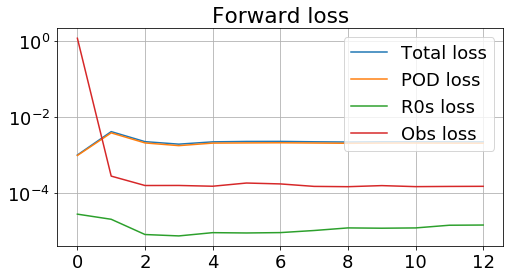

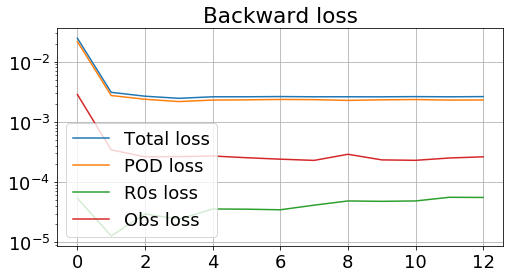

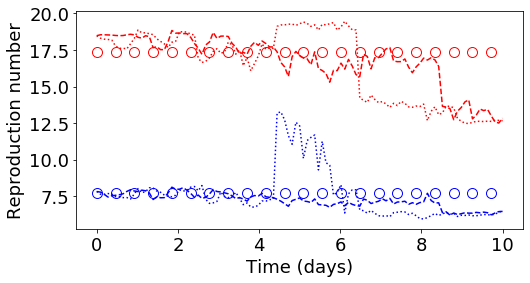

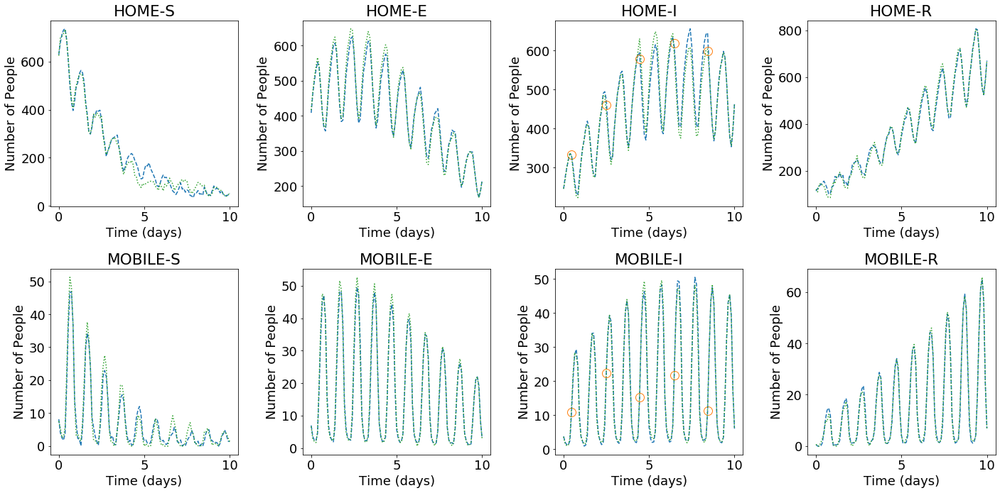

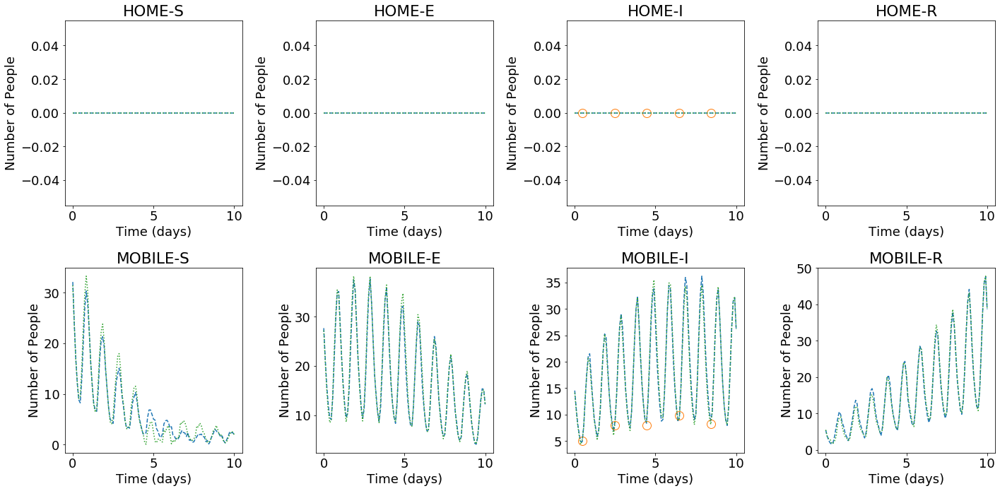

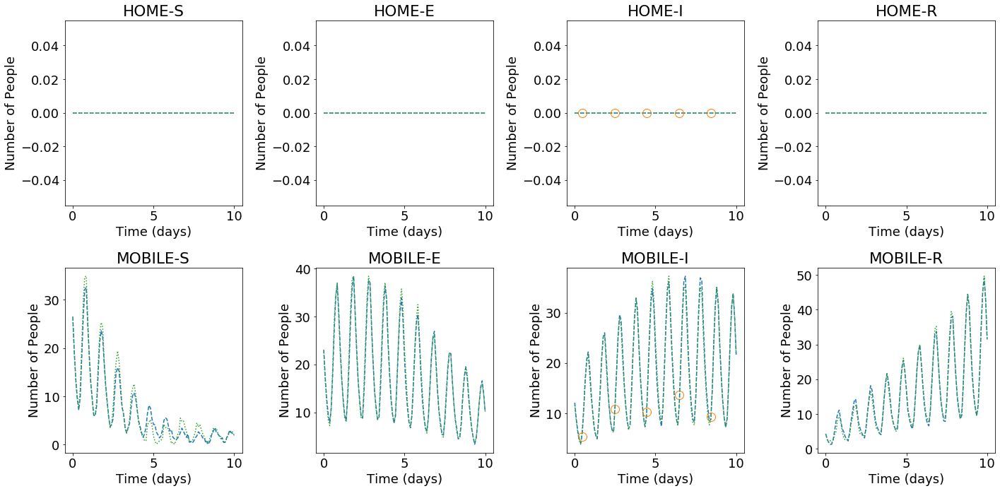

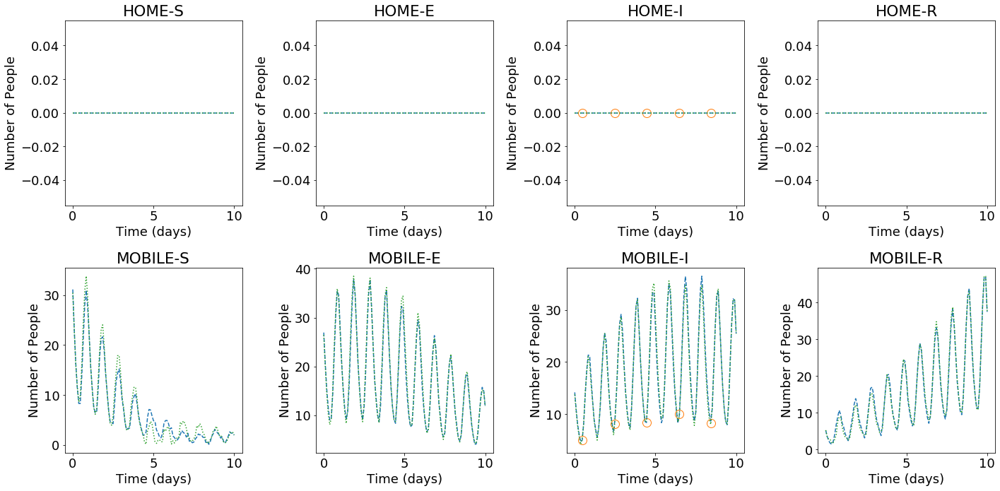

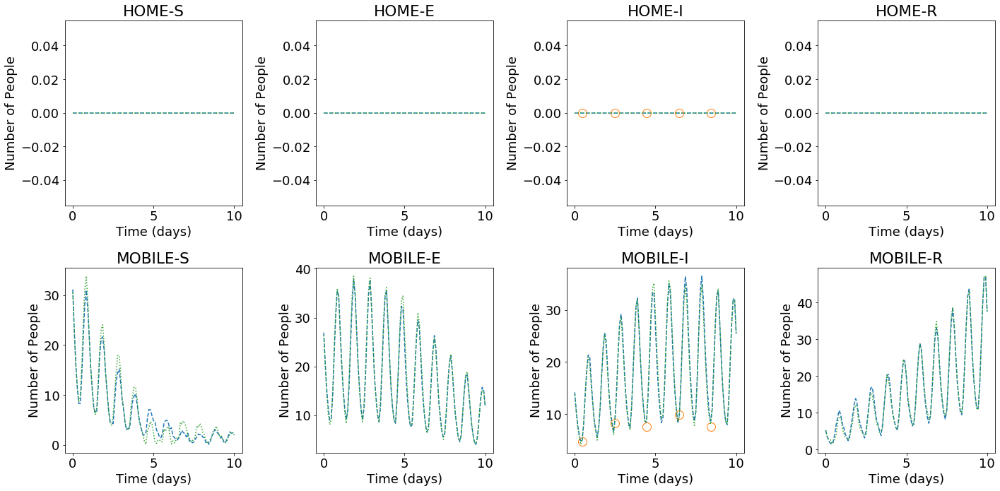


Iteration 13: forward and backward
-- Forward March --
Loss iteration 0: ['3.36e-03', '2.88e-03', '5.33e-06', '4.74e-04']
Loss iteration 1: ['2.84e-03', '2.69e-03', '5.88e-06', '1.38e-04'] - 4s
Loss iteration 2: ['1.90e-03', '1.77e-03', '5.74e-06', '1.22e-04'] - 1s
Loss iteration 3: ['1.55e-03', '1.41e-03', '5.39e-06', '1.39e-04'] - 1s
Loss iteration 4: ['1.75e-03', '1.61e-03', '5.53e-06', '1.42e-04'] - 4s
Loss iteration 5: ['4.98e-03', '4.48e-03', '3.70e-06', '4.96e-04'] - 4s
Loss iteration 6: ['2.14e-03', '2.14e-03', '5.97e-06', '0.00e+00'] - 3s
Loss iteration 7: ['2.08e-03', '2.08e-03', '4.47e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.79e-03', '1.77e-03', '1.05e-05', '0.00e+00'] - 1s
Loss iteration 9: ['1.83e-03', '1.82e-03', '6.62e-06', '0.00e+00'] - 1s
Loss iteration 10: ['3.57e-03', '3.57e-03', '2.94e-06', '0.00e+00'] - 4s
Loss iteration 11: ['1.59e-03', '1.58e-03', '1.54e-05', '0.00e+00'] - 3s
Loss iteration 12: ['1.91e-03', '1.90e-03', '9.38e-06', '0.00e+00'] - 3s
Loss itera

Loss iteration 11: ['1.05e-03', '9.57e-04', '4.30e-06', '8.84e-05'] - 4s
Loss iteration 12: ['9.55e-04', '9.10e-04', '2.96e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.52e-04', '7.11e-04', '2.08e-06', '3.89e-05'] - 4s
Loss iteration 14: ['8.15e-04', '7.67e-04', '4.55e-06', '4.31e-05'] - 4s
Loss iteration 15: ['7.69e-04', '7.12e-04', '5.02e-06', '5.22e-05'] - 1s
Loss iteration 16: ['6.78e-04', '6.21e-04', '5.02e-06', '5.14e-05'] - 1s
Loss iteration 17: ['9.37e-04', '8.85e-04', '8.04e-06', '4.41e-05'] - 4s
Loss iteration 18: ['8.33e-04', '8.28e-04', '4.90e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.34e-04', '8.30e-04', '3.72e-06', '0.00e+00'] - 4s
Loss iteration 20: ['8.06e-04', '8.01e-04', '4.82e-06', '0.00e+00'] - 2s
Loss iteration 21: ['1.02e-03', '1.02e-03', '1.95e-06', '0.00e+00'] - 1s
Loss iteration 22: ['8.41e-04', '8.40e-04', '1.02e-06', '0.00e+00'] - 2s
Loss iteration 23: ['8.39e-04', '8.38e-04', '9.25e-07', '0.00e+00'] - 1s
Loss iteration 24: ['5.89e-04', '5.89e-04', '4.55e-

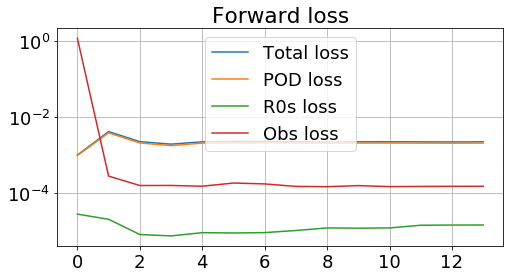

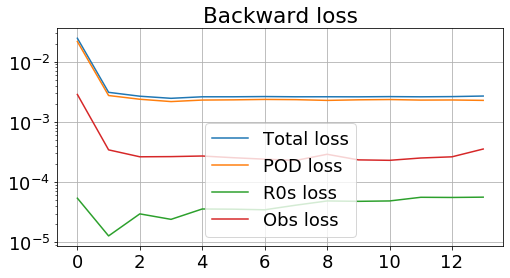

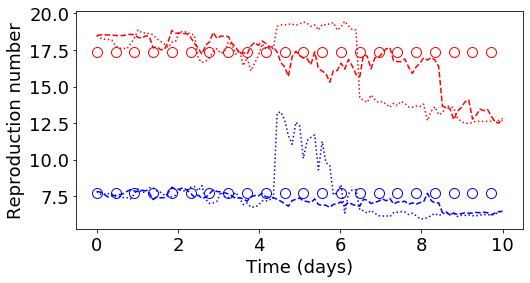

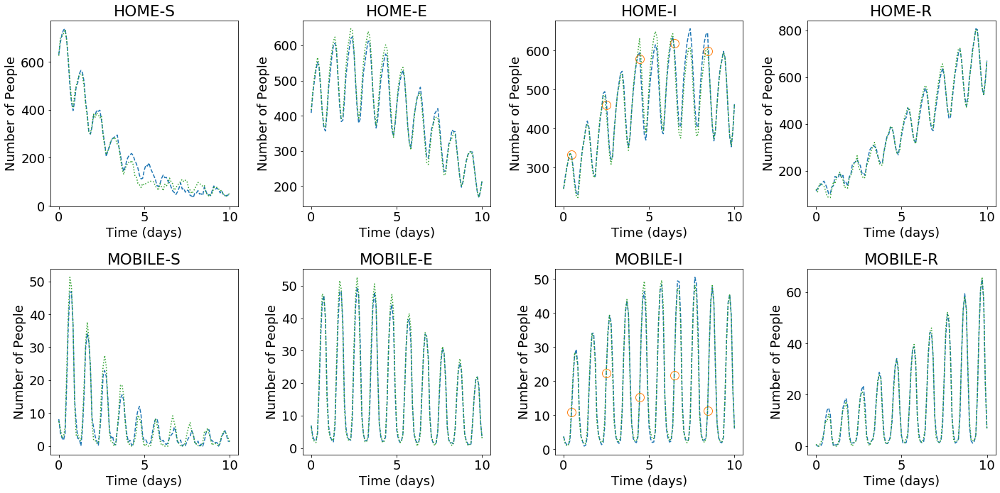

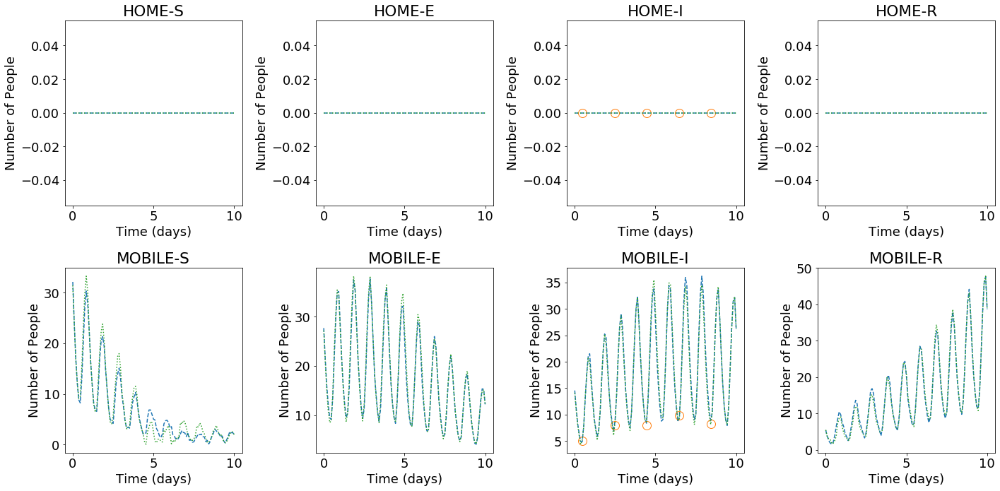

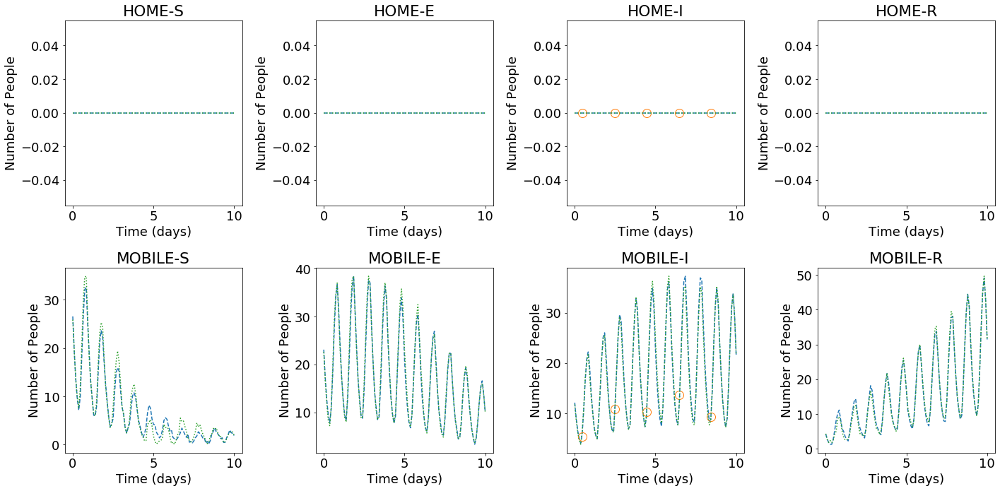

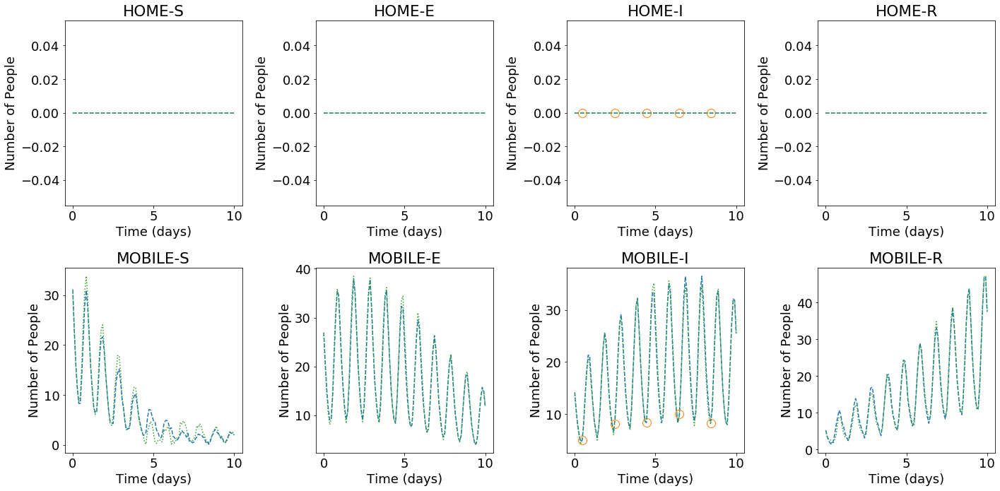

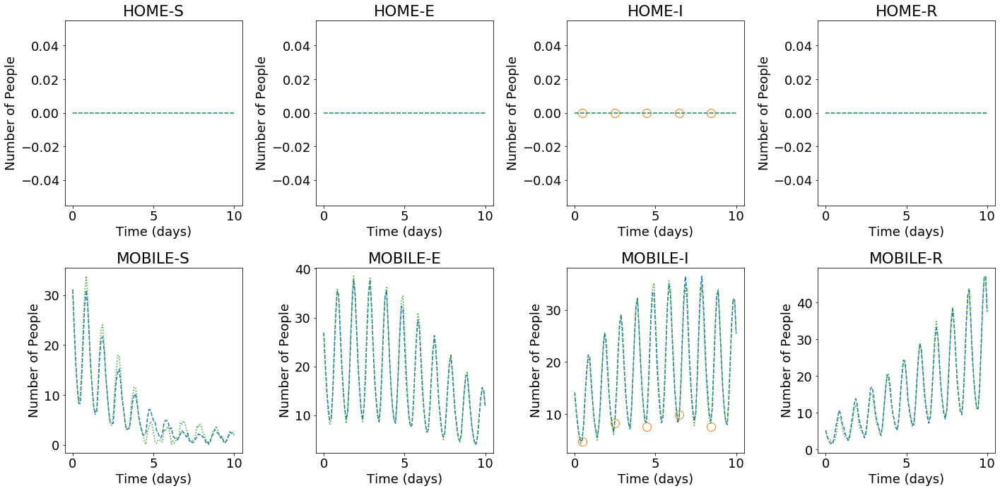


Iteration 14: forward and backward
-- Forward March --
Loss iteration 0: ['3.46e-03', '2.94e-03', '5.58e-06', '5.08e-04']
Loss iteration 1: ['2.97e-03', '2.86e-03', '7.05e-06', '1.03e-04'] - 1s
Loss iteration 2: ['1.90e-03', '1.78e-03', '5.81e-06', '1.21e-04'] - 1s
Loss iteration 3: ['1.56e-03', '1.41e-03', '5.38e-06', '1.39e-04'] - 1s
Loss iteration 4: ['1.76e-03', '1.61e-03', '5.51e-06', '1.41e-04'] - 4s
Loss iteration 5: ['5.68e-03', '5.08e-03', '4.78e-06', '5.96e-04'] - 2s
Loss iteration 6: ['2.21e-03', '2.20e-03', '5.86e-06', '0.00e+00'] - 1s
Loss iteration 7: ['2.09e-03', '2.09e-03', '4.47e-06', '0.00e+00'] - 1s
Loss iteration 8: ['1.79e-03', '1.78e-03', '1.05e-05', '0.00e+00'] - 1s
Loss iteration 9: ['1.71e-03', '1.71e-03', '8.86e-06', '0.00e+00'] - 3s
Loss iteration 10: ['3.56e-03', '3.56e-03', '2.94e-06', '0.00e+00'] - 3s
Loss iteration 11: ['1.59e-03', '1.58e-03', '1.55e-05', '0.00e+00'] - 3s
Loss iteration 12: ['1.91e-03', '1.90e-03', '9.38e-06', '0.00e+00'] - 3s
Loss itera

Loss iteration 11: ['1.07e-03', '9.75e-04', '5.30e-06', '9.25e-05'] - 1s
Loss iteration 12: ['9.55e-04', '9.10e-04', '2.96e-06', '4.18e-05'] - 4s
Loss iteration 13: ['7.52e-04', '7.11e-04', '2.06e-06', '3.89e-05'] - 4s
Loss iteration 14: ['8.14e-04', '7.67e-04', '4.52e-06', '4.31e-05'] - 4s
Loss iteration 15: ['8.15e-04', '7.52e-04', '3.75e-06', '5.93e-05'] - 4s
Loss iteration 16: ['6.64e-04', '6.02e-04', '7.90e-06', '5.37e-05'] - 3s
Loss iteration 17: ['9.36e-04', '8.84e-04', '8.01e-06', '4.41e-05'] - 4s
Loss iteration 18: ['8.48e-04', '8.43e-04', '4.86e-06', '0.00e+00'] - 4s
Loss iteration 19: ['8.30e-04', '8.26e-04', '3.70e-06', '0.00e+00'] - 3s
Loss iteration 20: ['8.33e-04', '8.28e-04', '5.22e-06', '0.00e+00'] - 3s
Loss iteration 21: ['1.17e-03', '1.17e-03', '1.92e-06', '0.00e+00'] - 3s
Loss iteration 22: ['8.46e-04', '8.45e-04', '1.33e-06', '0.00e+00'] - 3s
Loss iteration 23: ['9.30e-04', '9.29e-04', '1.37e-06', '0.00e+00'] - 3s
Loss iteration 24: ['5.88e-04', '5.88e-04', '5.11e-

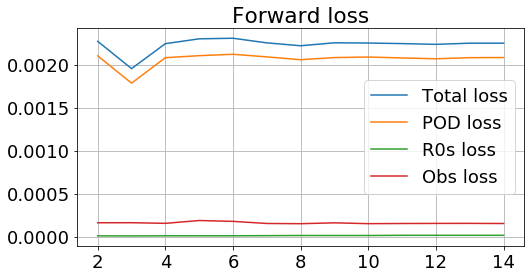

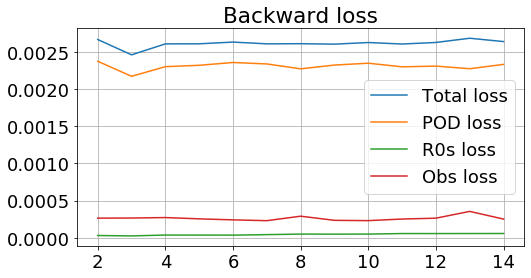

In [26]:
np.random.seed(0)
tf.random.set_seed(0)

# Variables for debugging and plotting
#list_latent_values_forward = []
#list_latent_values_backward = []
#list_obs_data_forward = []
#list_obs_data_backward = []
#list_points_inrange_forward = []
#list_points_inrange_backward = []
list_X_predict_forward = []
list_X_predict_backward = []
list_relax = []

# Forward and backward march   
forward_loss = []
backward_loss = []
forward_noObs_loss = []
relax = 1.0
for j in range(100):    
    print(f'\nIteration {j}: forward and backward')
    latent_values_forward = []
    latent_values_backward = []
    
    #===========================================
    # Forward march 
    #===========================================
    print('-- Forward March --')
    
    march_range = np.arange(0,(ntimes-1))
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
    loss_iteration = []
    
    if j == 0: # If the first forward march
        # For the first forward march
        weight_R0.assign(weight_R0_p)
        real_coding = X_test_concat[n]
        real_coding = real_coding[:-1,:]
        R0s_run = real_coding[0,-2:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        
        list_latent_values = []
        list_loss = []
        for _ in range(10):
            latent_values = tf.random.normal([1, latent_size], mean=0.0, stddev=0.01)  
            latent_values = tf.Variable(latent_values) 
            latent_values, loss = optimize_coding_forward_noObs(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
            list_latent_values.append(latent_values)
            list_loss.append(loss)
        #latent_values = list_latent_values[np.argmin(list_loss)]
        latent_values = list_latent_values[np.argmin(list_loss,axis=0)[0]]
        loss_iteration.append(list(map(float,list_loss[np.argmin(list_loss,axis=0)[0]])))
        print('Initial point losses: ', end='\n')
        for l in list_loss:
            print(['{0:1.2e}'.format(float(x)) for x in l])
        print()
        print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in list_loss[np.argmin(list_loss,axis=0)[0]]]), end='\n')        

        latent_values_forward.append(latent_values.value())
        X_predict_forward = list(generator(latent_values).numpy().reshape(-1,codings_size))
        gen_predict = X_predict_forward[-1]
        gen_predict[-2:] = R0s_run  
    
    else: # If not the first forward march
        real_coding = X_predict_backward[0:(ntimes-1),:].copy()
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)  
        
        latent_values, loss = optimize_coding_forward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        if j != 0:
            latent_values = tf.Variable((1-relax)*latent_values_forward_old[0] + relax*latent_values.value())
        loss_iteration.append(list(map(float,loss)))
        print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')
    
        latent_values_forward.append(latent_values.value())
        X_predict_forward = list(generator(latent_values).numpy().reshape(-1,codings_size))
        gen_predict = X_predict_forward[-1]

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    
    for i in range(1, forward_steps): 
        march_range = np.arange(i,(ntimes-1)+i)
        obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
        
        start = time.time()
        if j == 0:    
            latent_values, loss = optimize_coding_forward_noObs(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        
            loss_iteration.append(list(map(float,loss)))
            print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

            latent_values_forward.append(latent_values.value())
            gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[-1]
            X_predict_forward.append(gen_predict.copy())
            gen_predict[-2:] = R0s_run       
        
        else:
            latent_values, loss = optimize_coding_forward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
            latent_values = tf.Variable((1-relax)*latent_values_forward_old[i] + relax*latent_values.value())
        
            loss_iteration.append(list(map(float,loss)))
            print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

            latent_values_forward.append(latent_values.value())
            gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[-1]
            X_predict_forward.append(gen_predict.copy())

        real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
    X_predict_forward = np.array(X_predict_forward)
    if j == 0:
        X_predict_forward_first = X_predict_forward
        weight_R0.assign(weight_R0_da)
    forward_loss.append(np.array(loss_iteration).mean(axis=0))
    print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])
    
    # Only for debugging
    #list_obs_data_forward.append(obs_data.numpy().copy()) 
    #list_points_inrange_forward.append(obs_points_inrange.numpy().copy())
    #list_latent_values_forward.append(latent_values.numpy().copy()) 
    

    #===========================================
    # Backward march
    #===========================================
    print('-- Backward March --')
    
    march_range = np.arange(time_steps-(ntimes-1),time_steps)
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)    
    loss_iteration = []
    
    real_coding = X_predict_forward[time_steps-(ntimes-1):time_steps,:].copy()
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)  
    
    latent_values, loss = optimize_coding_backward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
    if j != 0:
        latent_values = tf.Variable((1-relax)*latent_values_backward_old[0] + relax*latent_values.value())
    loss_iteration.append(list(map(float,loss)))
    print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')

    latent_values_backward.append(latent_values.value())
    X_predict_backward = deque(generator(latent_values).numpy().reshape(-1,codings_size))
    gen_predict = X_predict_backward[0]

    real_coding = np.concatenate((gen_predict.reshape(1,-1), real_coding), axis=0)[:-1,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    
    for i in range(1, forward_steps): 
        march_range = np.arange(time_steps-(ntimes-1)-i,time_steps-i)
        obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)        
        
        start = time.time()
        latent_values, loss = optimize_coding_backward(latent_values, real_coding, obs_data, obs_points_inrange, epochs=1000)
        if j != 0:
            latent_values = tf.Variable((1-relax)*latent_values_backward_old[i] + relax*latent_values.value())
        loss_iteration.append(list(map(float,loss)))
        print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

        latent_values_backward.append(latent_values.value())
        gen_predict = generator(latent_values).numpy().reshape(-1,codings_size)[0]
        X_predict_backward.appendleft(gen_predict.copy())

        real_coding = np.concatenate((gen_predict.reshape(1,-1), real_coding), axis=0)[:-1,:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
    X_predict_backward = np.array(X_predict_backward)
    backward_loss.append(np.array(loss_iteration).mean(axis=0))
    print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])
    
    #===========================================
    # Update the R0 weights
    #===========================================
    if j<100:
        weight_R0.assign(weight_R0*1.2)
    print('weight_R0: ', weight_R0)

    
    #===========================================
    # Update Relaxation
    #===========================================
    # Save relaxation
    list_relax.append(relax)
    
    # Calculate relaxation
    epison = 0
    loss_obs = (forward_loss[-1][-1] + backward_loss[-1][-1])/2 
    print(f'Loss obs: {loss_obs}')
    if j == 0:
        loss_obs_old = loss_obs        
        latent_values_forward_old = latent_values_forward.copy()
        latent_values_backward_old = latent_values_backward.copy()
        X_predict_backward_old = X_predict_backward.copy()
        weight_R0_old = tf.identity(weight_R0)
    else:
        print(f'Loss obs old: {loss_obs_old}')
        print(f'Relax old: {relax}, new ', end='')
        if (loss_obs - loss_obs_old) < epison:
            loss_obs_old = loss_obs
            X_predict_backward_old = X_predict_backward.copy()
            latent_values_forward_old = latent_values_forward.copy()
            latent_values_backward_old = latent_values_backward.copy()
            weight_R0_old = tf.identity(weight_R0)
            relax *= 1.5
            if relax > 1.0: 
                relax = 1.0              
        else:
            relax *= 0.5
            if relax < 0.01: 
                print(relax)
                print('Converged!')
                # plot loss functions
                fig, ax = plt.subplots(1,1, figsize=[8,4])
                ax.plot(np.arange(2,len(forward_loss)), forward_loss[2:])
                ax.set_title('Forward loss')
                #ax.set_yscale('log')
                #ax.set_ylim([0,20000])
                plt.grid()
                plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])    
                fig, ax = plt.subplots(1,1, figsize=[8,4])
                ax.plot(np.arange(2,len(backward_loss)), backward_loss[2:])
                #ax.set_yscale('log')
                ax.set_title('Backward loss')
                #ax.set_ylim([0,20000])
                plt.grid()
                plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])
                break
            X_predict_backward = X_predict_backward_old
            latent_values_forward = latent_values_forward_old
            latent_values_backward = latent_values_backward_old
            weight_R0.assign(weight_R0_old)
        print(relax)
        
            
    # Only for debugging
    #list_obs_data_backward.append(obs_data.numpy().copy()) 
    #list_points_inrange_backward.append(obs_points_inrange.numpy().copy())
    #list_latent_values_backward.append(latent_values.numpy().copy())  
    
    
    list_X_predict_forward.append(X_predict_forward)
    list_X_predict_backward.append(X_predict_backward)
    
    #===========================================
    # Plots
    #===========================================  
    # plot loss function
    fig, ax = plt.subplots(1,1, figsize=[8,4])
    ax.plot(forward_loss)
    ax.set_title('Forward loss')
    ax.set_yscale('log')
    plt.grid()
    plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])    
    fig, ax = plt.subplots(1,1, figsize=[8,4])
    ax.plot(backward_loss)
    ax.set_yscale('log')
    ax.set_title('Backward loss')
    plt.grid()
    plt.legend(['Total loss','POD loss','R0s loss','Obs loss'])
    
    # Plot forward and backward march   
    mpl.rcParams.update({'font.size': 18})
    mpl.rc('xtick', labelsize=18) 
    mpl.rc('ytick', labelsize=18) 
    mpl.rc('axes', labelsize=18)
 
    fig, R0_ax = plt.subplots(1,1, figsize=[8,4])
    fig, X_ax = plt.subplots(2,4, figsize=[20,10])
    plot_data(X_predict_forward, 0, 4, obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax=R0_ax, X_ax=X_ax, label='Forward', mark='--')
    plot_data(X_predict_backward, 0, 4, R0_ax=R0_ax, X_ax=X_ax, label='Backward', mark=':')
    
    fig, X_ax1 = plt.subplots(2,4, figsize=[20,10])
    plot_data(X_predict_forward, 9, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax1, label='Forward', mark='--')
    plot_data(X_predict_backward, 9, 4, X_ax=X_ax1, label='Backward', mark=':')

    fig, X_ax2 = plt.subplots(2,4, figsize=[20,10])
    plot_data(X_predict_forward, 4, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax2, label='Forward', mark='--')
    plot_data(X_predict_backward, 4, 4, X_ax=X_ax2, label='Backward', mark=':')

    fig, X_ax3 = plt.subplots(2,4, figsize=[20,10])
    plot_data(X_predict_forward, 4, 0, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax3, label='Forward', mark='--')
    plot_data(X_predict_backward, 4, 0, X_ax=X_ax3, label='Backward', mark=':')

    fig, X_ax4 = plt.subplots(2,4, figsize=[20,10])
    plot_data(X_predict_forward, 4, 9, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax4, label='Forward', mark='--')
    plot_data(X_predict_backward, 4, 9, X_ax=X_ax4, label='Backward', mark=':')        
    plt.show() 

-- Last time Stepping Forward March --
Loss iteration 0: ['2.04e-03', '1.84e-03', '2.04e-04', '4.85e-03']
Loss iteration 1: ['2.40e-03', '2.33e-03', '7.88e-05', '2.02e-03'] - 4s
Loss iteration 2: ['1.24e-03', '1.16e-03', '7.83e-05', '2.95e-03'] - 1s
Loss iteration 3: ['1.24e-03', '1.16e-03', '7.80e-05', '3.37e-03'] - 2s
Loss iteration 4: ['1.18e-03', '1.09e-03', '8.77e-05', '5.87e-04'] - 1s
Loss iteration 5: ['2.85e-03', '2.75e-03', '9.78e-05', '3.88e-04'] - 1s
Loss iteration 6: ['1.82e-03', '1.64e-03', '1.84e-04', '0.00e+00'] - 4s
Loss iteration 7: ['1.48e-03', '1.33e-03', '1.49e-04', '0.00e+00'] - 4s
Loss iteration 8: ['1.91e-03', '1.66e-03', '2.47e-04', '0.00e+00'] - 4s
Loss iteration 9: ['1.82e-03', '1.72e-03', '9.82e-05', '0.00e+00'] - 3s
Loss iteration 10: ['2.49e-03', '2.49e-03', '7.59e-06', '0.00e+00'] - 1s
Loss iteration 11: ['1.74e-03', '1.58e-03', '1.58e-04', '0.00e+00'] - 1s
Loss iteration 12: ['1.68e-03', '1.64e-03', '3.63e-05', '0.00e+00'] - 1s
Loss iteration 13: ['1.94e-

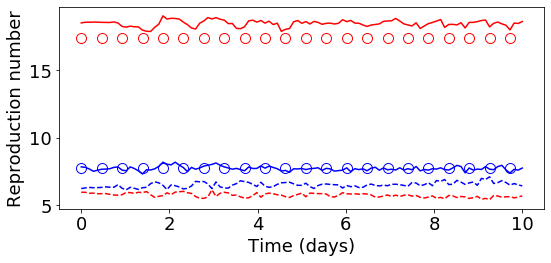

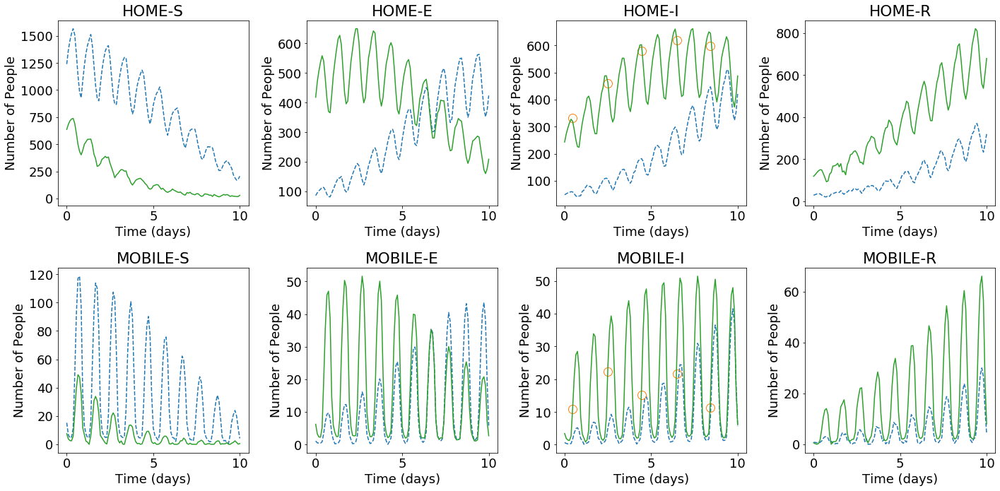

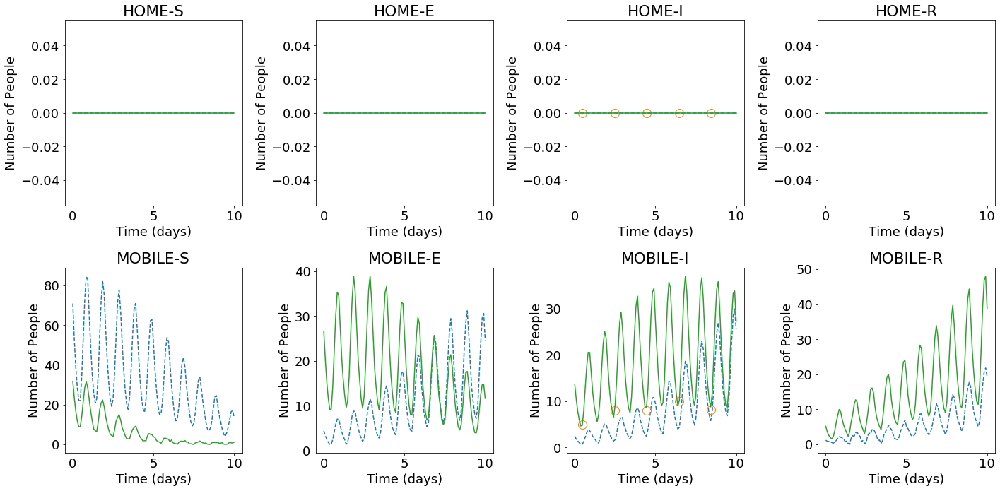

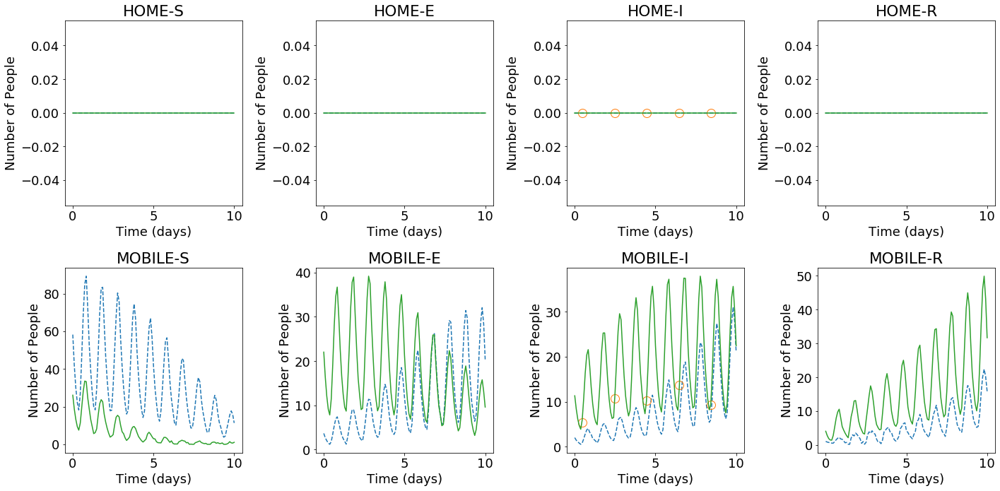

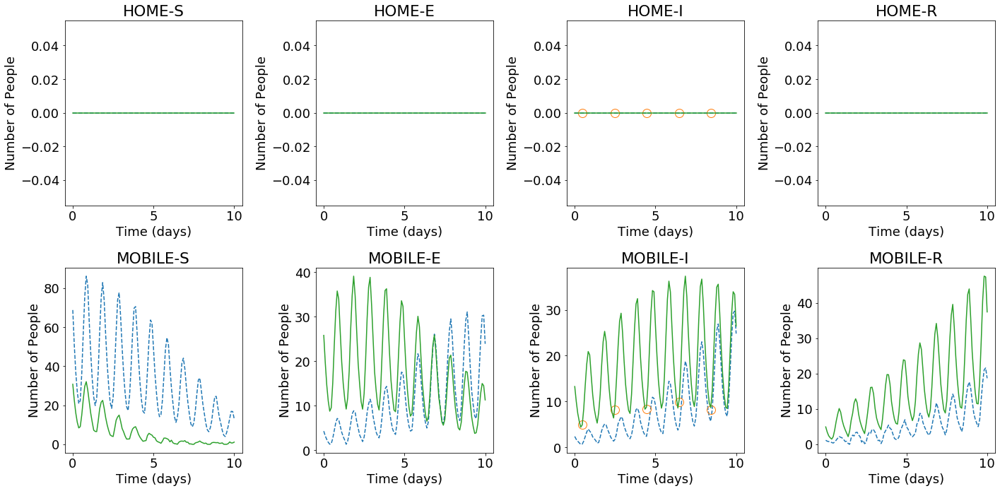

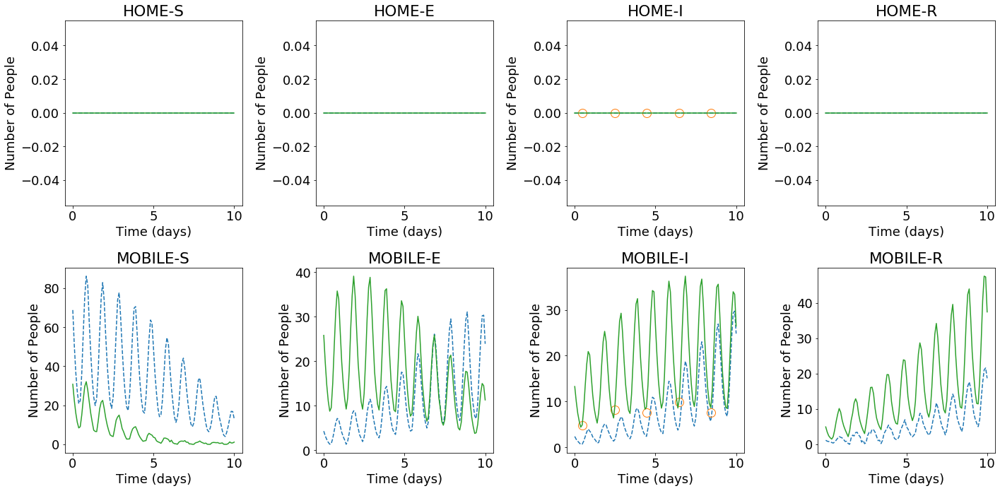

In [27]:
#===========================================
# Last time stepping forward march
#===========================================
print('-- Last time Stepping Forward March --')

weight_R0.assign(weight_R0_p) 
march_range = np.arange(0,(ntimes-1))
obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)
loss_iteration = []

real_coding = X_predict_backward[0:(ntimes-1),:].copy()
R0s_run = real_coding[0,-2:]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)  

latent_values_noObs = tf.Variable(latent_values)
latent_values_noObs, loss = optimize_coding_forward_noObs(latent_values_noObs, real_coding, obs_data, obs_points_inrange, epochs=1000)
loss_iteration.append(list(map(float,loss)))
print('Loss iteration 0: '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end='\n')

X_predict_forward_last = list(generator(latent_values_noObs).numpy().reshape(-1,codings_size))
gen_predict = X_predict_forward_last[-1]
gen_predict[-2:] = R0s_run

real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)

for i in range(1, forward_steps): 
    march_range = np.arange(i,(ntimes-1)+i)
    obs_data, obs_points_inrange = process_obs_data(march_range, X_obs, obs_points)

    start = time.time()
    latent_values_noObs, loss = optimize_coding_forward_noObs(latent_values_noObs, real_coding, obs_data, obs_points_inrange, epochs=1000)
    loss_iteration.append(list(map(float,loss)))
    print('Loss iteration '+str(i)+': '+str(['{0:1.2e}'.format(float(x)) for x in loss]), end=' - ')

    gen_predict = generator(latent_values_noObs).numpy().reshape(-1,codings_size)[-1]
    X_predict_forward_last.append(gen_predict.copy())
    gen_predict[-2:] = R0s_run

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=0)[1:,:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    print ('{:.0f}s'.format( time.time()-start))
X_predict_forward_last = np.array(X_predict_forward_last)
forward_noObs_loss.append(np.array(loss_iteration).mean(axis=0))
print('Loss iteration mean:', ['{0:1.2e}'.format(float(x)) for x in np.array(loss_iteration).mean(axis=0)])

# Plot forward and backward march   
mpl.rcParams.update({'font.size': 18})
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rc('axes', labelsize=18)

fig, R0_ax = plt.subplots(1,1, figsize=[8,4])
plot_data(X_predict_forward_first, 0, 4,  obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax=R0_ax, X_ax='', label='Initial', mark='--')
plot_data(X_predict_forward_last, 0, 4, R0_ax=R0_ax, X_ax='', label='Final', mark='-')

fig, X_ax = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 0, 4, obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax='', X_ax=X_ax, label='Initial', mark='--')
plot_data(X_predict_forward_last, 0, 4, R0_ax='', X_ax=X_ax, label='Final', mark='-')

fig, X_ax1 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 9, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax1, label='Initial', mark='--')
plot_data(X_predict_forward_last, 9, 4, X_ax=X_ax1, label='Final', mark='-')

fig, X_ax2 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 4, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax2, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 4, X_ax=X_ax2, label='Final', mark='-')

fig, X_ax3 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 0, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax3, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 0, X_ax=X_ax3, label='Final', mark='-')

fig, X_ax4 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 4, 9, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax4, label='Initial', mark='--')
plot_data(X_predict_forward_last, 4, 9, X_ax=X_ax4, label='Final', mark='-')        
plt.show() 

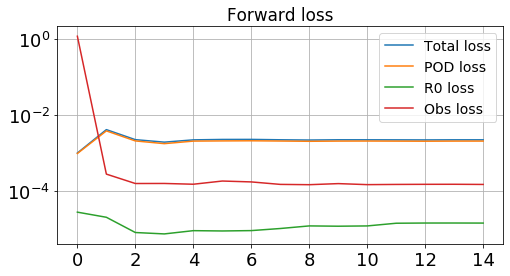

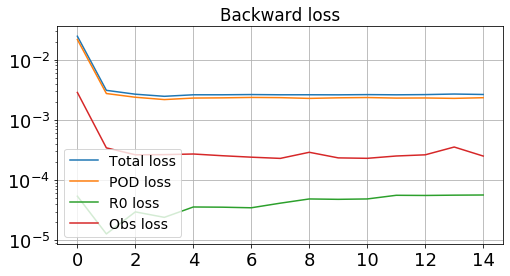

In [28]:
# plot loss function 
mpl.rcParams.update({'font.size': 14})
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rc('axes', labelsize=18)

fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(forward_loss)
ax.set_title('Forward loss')
ax.set_yscale('log')
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])    
fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(backward_loss)
ax.set_yscale('log')
ax.set_title('Backward loss')
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])

0 [1.27351645e-02 1.12688534e-02 4.12239238e-05 5.85509601e-01]
1 [3.62535897e-03 3.29553069e-03 1.68364793e-05 3.12991814e-04]
2 [2.46719929e-03 2.23649615e-03 1.89763417e-05 2.11726795e-04]
3 [2.46719929e-03 2.23649615e-03 1.89763417e-05 2.11726795e-04]
4 [2.46719929e-03 2.23649615e-03 1.89763417e-05 2.11726795e-04]
5 [2.46719929e-03 2.23649615e-03 1.89763417e-05 2.11726795e-04]
6 [2.46798418e-03 2.23760183e-03 2.20009566e-05 2.08381391e-04]
7 [2.42930911e-03 2.21269197e-03 2.59698916e-05 1.90647244e-04]
8 [2.42930911e-03 2.21269197e-03 2.59698916e-05 1.90647244e-04]
9 [2.42930911e-03 2.21269197e-03 2.59698916e-05 1.90647244e-04]
10 [2.43714424e-03 2.21678809e-03 3.04811480e-05 1.89875003e-04]
11 [2.43714424e-03 2.21678809e-03 3.04811480e-05 1.89875003e-04]
12 [2.43714424e-03 2.21678809e-03 3.04811480e-05 1.89875003e-04]
13 [2.43714424e-03 2.21678809e-03 3.04811480e-05 1.89875003e-04]
14 [2.43714424e-03 2.21678809e-03 3.04811480e-05 1.89875003e-04]


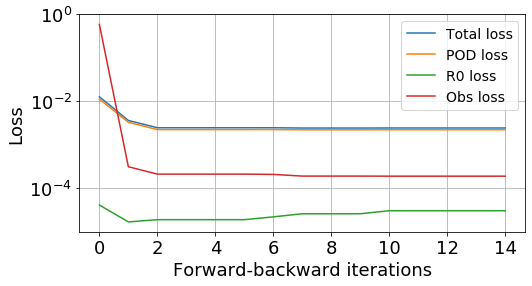

In [29]:
loss = (np.array(backward_loss)+np.array(forward_loss))/2
new_loss = loss.copy()

# Because we discard the forward-backward iteration with loss greater than the minimum
print(0, new_loss[0,:])
for i in range(1,len(new_loss)):
    if new_loss[i,-1] > new_loss[i-1,-1]:
        new_loss[i,:] = new_loss[i-1,:] 
    print(i, new_loss[i,:])
    
fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(new_loss)
ax.set_yscale('log')
ax.set_ylim(top=10**0)
ax.set_ylabel('Loss') 
ax.set_xlabel('Forward-backward iterations')   
plt.grid()
plt.legend(['Total loss','POD loss','R0 loss','Obs loss'])

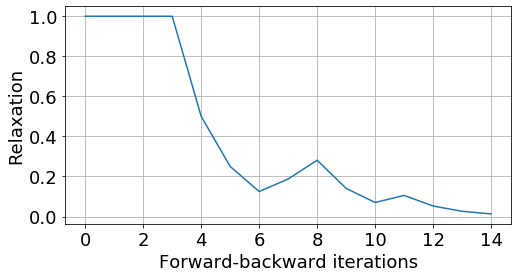

In [30]:
fig, ax = plt.subplots(1,1, figsize=[8,4])
ax.plot(list_relax)
ax.set_ylabel('Relaxation') 
ax.set_xlabel('Forward-backward iterations')   
plt.grid()

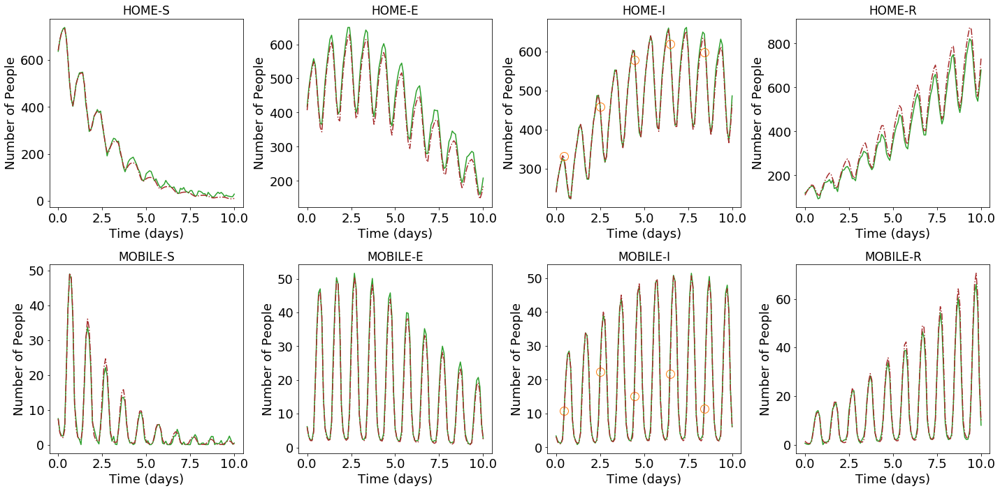

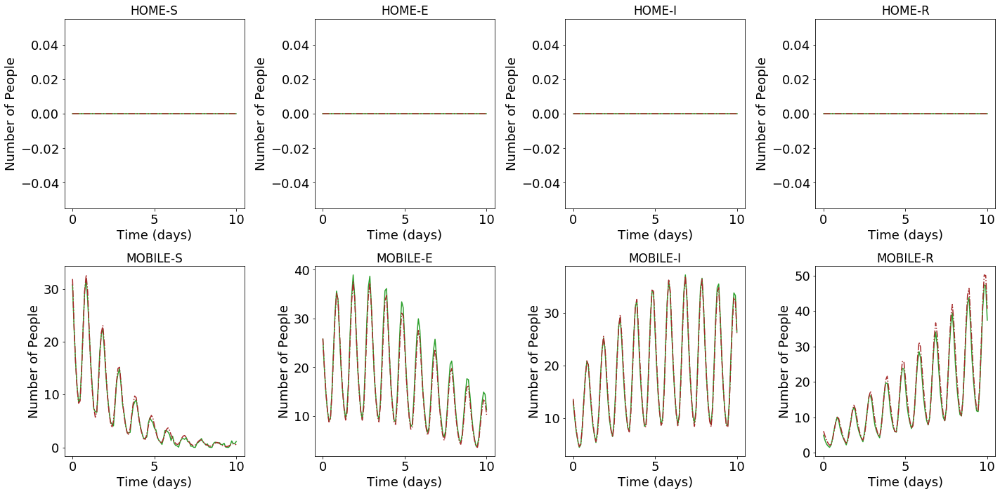

In [31]:
# Compare with the numerical simulation used to generate the observed data 
#

X_obs_all = X_test_1D[nobs:nobs+((ntimes-1)+length)*step:step,:].reshape(-1,len(groups),nl,nc)

def plot_data_true(X_predict, nx, ny, X_ax, X_obs_all, obs_times=[], X_obs=[], grid_points=[]):
    X_generated = scaler.inverse_transform(X_predict)
    R0_generated = X_generated[:,pca_size:]
    X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
    X_generated = X_generated.reshape(len(X_predict), len(groups), nl, nc)
    X_generated[X_generated<0] = 0 
    
    
    # Plot groups 
    xp = len(X_generated)
    for i, group in enumerate(groups):
        
        X_ax.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_generated[:,i, nx, ny], '-', color='#2ca02c')
        if len(X_obs):
            if [i, nx, ny] in grid_points:
                X_ax.flatten()[i].plot(np.array(obs_times)*8000/86400, X_obs[:, i, nx, ny],'o', color='#ff7f0e', markevery=1, fillstyle='none', markersize = 12)
        X_ax.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_obs_all[:,i, nx, ny], '-.', color='brown')        
        
        X_ax.flatten()[i].set_title(group)
        #X_ax.flatten()[i].legend()
        X_ax.flatten()[i].set_xlabel('Time (days)')
        X_ax.flatten()[i].set_ylabel('Number of People')
    plt.tight_layout()
    #plt.show()
    
fig, X_ax = plt.subplots(2,4, figsize=[20,10])
plot_data_true(X_predict_forward_last, 0, 4, X_ax, X_obs_all, obs_times, X_obs[obs_times], grid_points)  

fig, X_ax1 = plt.subplots(2,4, figsize=[20,10])
plot_data_true(X_predict_forward_last, 7, 5, X_ax1, X_obs_all, obs_times, X_obs[obs_times], grid_points) 
plt.show()

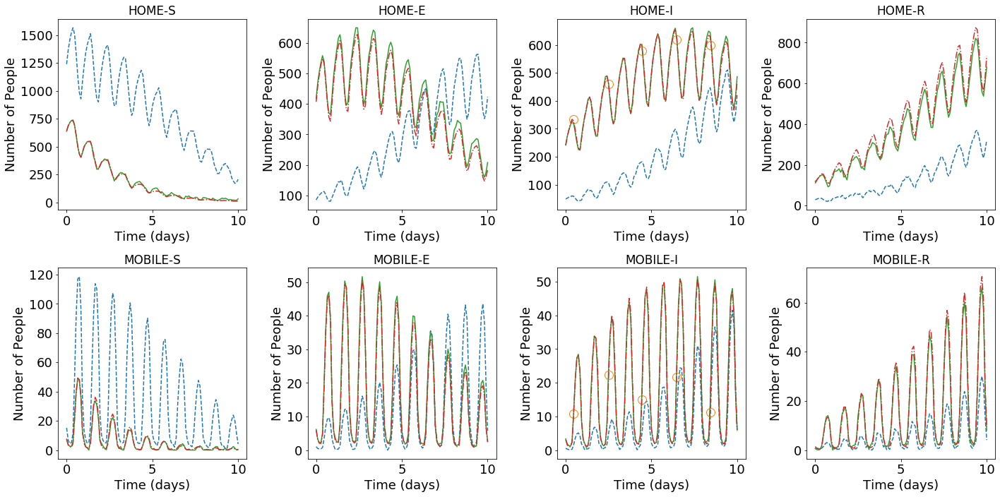

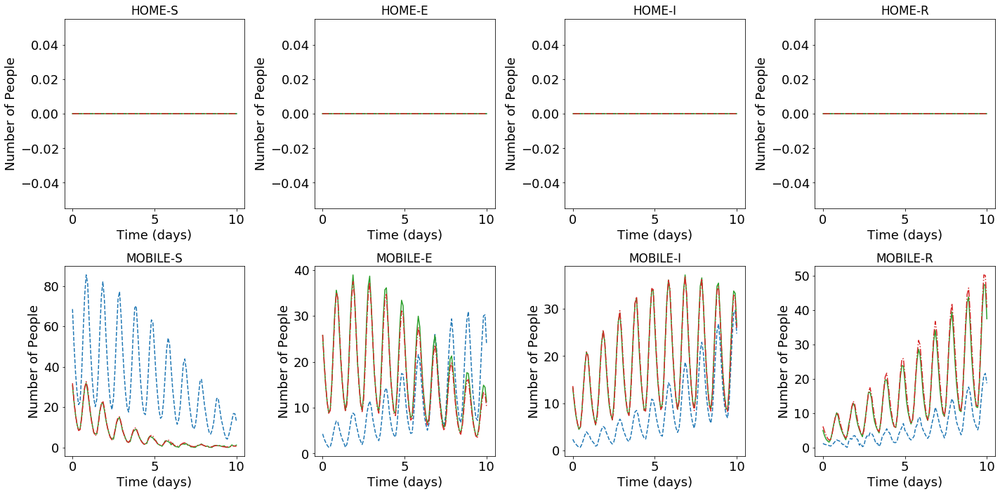

In [32]:
X_obs_all = X_test_1D[nobs:nobs+((ntimes-1)+length)*step:step,:].reshape(-1,len(groups),nl,nc)
xp = len(X_obs)

fig, X_ax = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 0, 4, obs_times, X_obs[obs_times], grid_points, R0s_obs, R0_ax='', X_ax=X_ax, label='Initial', mark='--')
plot_data(X_predict_forward_last, 0, 4, R0_ax='', X_ax=X_ax, label='Final', mark='-') 
for i, group in enumerate(groups):
    X_ax.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_obs_all[:,i, 0, 4], '-.', label='True')

fig, X_ax1 = plt.subplots(2,4, figsize=[20,10])
plot_data(X_predict_forward_first, 7, 5, obs_times, X_obs[obs_times], grid_points, R0_ax='', X_ax=X_ax1, label='Initial', mark='--')
plot_data(X_predict_forward_last, 7, 5, X_ax=X_ax1, label='Final', mark='-')
for i, group in enumerate(groups):
    X_ax1.flatten()[i].plot(np.linspace(0,(xp-1)*8000/86400,xp), X_obs_all[:,i, 7, 5], '-.', label='True')

plt.show() 